# Adversarial Architectures


## Initial setup

Here we import libraries and set up the dataset

In [ ]:
# os stuff
import sys
from os import makedirs, listdir, mkdir
from os.path import join, basename, splitext, exists, split, normpath, sep, isdir
from shutil import copytree, rmtree
# progress bar
from tqdm.auto import tqdm
# colab drive
from google.colab import drive
# mathematic library
import numpy as np
# cv
import cv2
from google.colab.patches import cv2_imshow
# matplotlib
import matplotlib.pyplot as plt
# some functions from sklearn
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
# pandas for classifcation report
import pandas as pd
# set precision
pd.set_option('precision', 2)
from IPython.display import display_html 
# torch related libraries
import torch
import torch.utils.data
from torch import nn, Tensor
from torch.nn import functional as F
import torch.autograd as autograd
from torch.autograd import Variable, Function
import torchvision
from torchvision import datasets, transforms, models
from scipy.special import softmax
# color and image manipulation
import colorsys
from PIL import Image, ImageDraw
# typing
from typing import Dict, Iterable, Callable, Tuple, Any, List, Optional
# seed
import random
from pprint import pprint
# future
from __future__ import division
#math
import math
from scipy.stats import entropy
# set the device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

 Here we also set the random seed. 
 The reason is that this way we can get always the same split between train and test. 
 There are some images that are just more difficult than others and depending on whether we get them in the train or test set, they affect the results significantly. 
 We also set the seed for torch, to get reproducible results

In [ ]:
seed = 0
random.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)

In [ ]:
#@title Configuration
#@markdown Insert the number of classes
N_CLASSES = 31 # @param {type: "integer", min: 2}
#@markdown Insert size of training batches
BATCH_SIZE = 128 # @param {type: "slider", min:32, max:128, step:32}
#@markdown Insert path to the Adaptiope.zip file in your google drive folder
dataset_path = "gdrive/My Drive/office31.zip" # @param {type: "string"}
#dataset_path = "gdrive/MyDrive/TACV Project/datasets/office31" # @param {type: "string"}
#@markdown Insert path to the serialized binary of trained models
#models_basepath = "gdrive/My Drive/trained_models" # @param {type: "string"}
models_basepath = "gdrive/MyDrive/temp/" # @param {type: "string"}

## Dataset preparation

In this part we will import the dataset `Office31.zip` from our google drive storage into the local storage of colab.

The dataset used is Office31. It is composed of 3 domains, Amazon, Webcam (as said before) and DLSR (not used in this framework). The two domains are quite unbalanced and we will see the problems derived in the following.


In [ ]:
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# Prepare trained models serialized binaries basepath
if not isdir(models_basepath):
    try:
        makedirs(models_basepath)
    except FileNotFoundError:
      print("Something went wrong in creating models base dir, assert sanity of path", file=sys.stderr)

In [ ]:
## pretrained models file names for saving or loading to save time.

# source only
resnet18_ex_w_path = "resnet18_ex_w.pth"
resnet18_cl_w_path = "resnet18_cl_w.pth"
resnet18_ex_a_path = "resnet18_ex_a.pth"
resnet18_cl_a_path = "resnet18_cl_a.pth"

# dann
resnet18_dann_extractor_w_a_path = "resnet18_dann_extractor_w_a.pth"
resnet18_dann_classifier_w_a_path = "resnet18_dann_classifier_w_a.pth"
resnet18_dann_extractor_a_w_path = "resnet18_dann_extractor_a_w.pth"
resnet18_dann_classifier_a_w_path = "resnet18_dann_classifier_a_w.pth"


# dann + coral
resnet18_dann_coral_ex_a_w_path = "resnet18_dann_coral_ex_a_w.pth"
resnet18_dann_coral_cl_a_w_path = "resnet18_dann_coral_cl_a_w.pth"
resnet18_dann_coral_ex_w_a_path = "resnet18_dann_coral_ex_w_a.pth"
resnet18_dann_coral_cl_w_a_path = "resnet18_dann_coral_cl_w_a.pth"

# dann + mmd
resnet18_dann_mmd_ex_a_w_path = "resnet18_dann_mmd_ex_a_w.pth"
resnet18_dann_mmd_cl_a_w_path = "resnet18_dann_mmd_cl_a_w.pth"
resnet18_dann_mmd_ex_w_a_path = "resnet18_dann_mmd_ex_w_a.pth"
resnet18_dann_mmd_cl_w_a_path = "resnet18_dann_mmd_cl_w_a.pth"

# dann + daln
resnet18_dann_daln_extractor_w_a_path = "resnet18_dann_daln_extractor_w_a.pth"
resnet18_dann_daln_classifier_w_a_path = "resnet18_dann_daln_classifier_w_a.pth"
resnet18_dann_daln_extractor_a_w_path = "resnet18_dann_daln_extractor_a_w.pth"
resnet18_dann_daln_classifier_a_w_path = "resnet18_dann_daln_classifier_a_w.pth"

# dann + sdat
resnet18_dann_sdat_extractor_w_a_path = "resnet18_dann_sdat_extractor_w_a.pth"
resnet18_dann_sdat_classifier_w_a_path = "resnet18_dann_sdat_classifier_w_a.pth"
resnet18_dann_sdat_extractor_a_w_path = "resnet18_dann_sdat_extractor_a_w.pth"
resnet18_dann_sdat_classifier_a_w_path = "resnet18_dann_sdat_classifier_a_w.pth"

# dann + jacobian regularization
resnet18_dann_jreg_extractor_w_a_path = "resnet18_dann_jreg_extractor_w_a.pth"
resnet18_dann_jreg_classifier_w_a_path = "resnet18_dann_jreg_classifier_w_a.pth"
resnet18_dann_jreg_extractor_a_w_path = "resnet18_dann_jreg_extractor_a_w.pth"
resnet18_dann_jreg_classifier_a_w_path = "resnet18_dann_jreg_classifier_a_w.pth"

# dann + fgda
resnet18_dann_fgda_extractor_w_a_path = "resnet18_dann_fgda_extractor_w_a.pth"
resnet18_dann_fgda_classifier_w_a_path = "resnet18_dann_fgda_classifier_w_a.pth"
resnet18_dann_fgda_extractor_a_w_path = "resnet18_dann_fgda_extractor_a_w.pth"
resnet18_dann_fgda_classifier_a_w_path = "resnet18_dann_fgda_classifier_a_w.pth"

# dann + rada
resnet18_dann_rada_extractor_w_a_path = "resnet18_dann_rada_extractor_w_a.pth"
resnet18_dann_rada_classifier_w_a_path = "resnet18_dann_rada_classifier_w_a.pth"
resnet18_dann_rada_extractor_a_w_path = "resnet18_dann_rada_extractor_a_w.pth"
resnet18_dann_rada_classifier_a_w_path = "resnet18_dann_rada_classifier_a_w.pth"

# dann + fgda + daln
resnet18_dann_fgda_daln_extractor_w_a_path = "resnet18_dann_fgda_daln_extractor_w_a.pth"
resnet18_dann_fgda_daln_classifier_w_a_path = "resnet18_dann_fgda_daln_classifier_w_a.pth"
resnet18_dann_fgda_daln_extractor_a_w_path = "resnet18_dann_fgda_daln_extractor_a_w.pth"
resnet18_dann_fgda_daln_classifier_a_w_path = "resnet18_dann_fgda_daln_classifier_a_w.pth"

# dann + daln + sdat
resnet18_dann_daln_sdat_extractor_w_a_path = "resnet18_dann_daln_sdat_extractor_w_a.pth"
resnet18_dann_daln_sdat_classifier_w_a_path = "resnet18_dann_daln_sdat_classifier_w_a.pth"
resnet18_dann_daln_sdat_extractor_a_w_path = "resnet18_dann_daln_sdat_extractor_a_w.pth"
resnet18_dann_daln_sdat_classifier_a_w_path = "resnet18_dann_daln_sdat_classifier_a_w.pth"

# dann + fgda + sdat
resnet18_dann_fgda_sdat_extractor_w_a_path = "resnet18_dann_fgda_sdat_extractor_w_a.pth"
resnet18_dann_fgda_sdat_classifier_w_a_path = "resnet18_dann_fgda_sdat_classifier_w_a.pth"
resnet18_dann_fgda_sdat_extractor_a_w_path = "resnet18_dann_fgda_sdat_extractor_a_w.pth"
resnet18_dann_fgda_sdat_classifier_a_w_path = "resnet18_dann_fgda_sdat_classifier_a_w.pth"

# dann + fgda + daln + sdat
resnet18_dann_fgda_daln_sdat_extractor_w_a_path = "resnet18_dann_fgda_daln_sdat_extractor_w_a.pth"
resnet18_dann_fgda_daln_sdat_classifier_w_a_path = "resnet18_dann_fgda_daln_sdat_classifier_w_a.pth"
resnet18_dann_fgda_daln_sdat_extractor_a_w_path = "resnet18_dann_fgda_daln_sdat_extractor_a_w.pth"
resnet18_dann_fgda_daln_sdat_classifier_a_w_path = "resnet18_dann_fgda_daln_sdat_classifier_a_w.pth"

# dann + rada + sdat
resnet18_dann_rada_sdat_extractor_w_a_path = "resnet18_dann_rada_sdat_extractor_w_a.pth"
resnet18_dann_rada_sdat_classifier_w_a_path = "resnet18_dann_rada_sdat_classifier_w_a.pth"
resnet18_dann_rada_sdat_extractor_a_w_path = "resnet18_dann_rada_sdat_extractor_a_w.pth"
resnet18_dann_rada_sdat_classifier_a_w_path = "resnet18_dann_rada_sdat_classifier_a_w.pth"

# dann + rada + fgda
resnet18_dann_rada_fgda_extractor_w_a_path = "resnet18_dann_rada_fgda_extractor_w_a.pth"
resnet18_dann_rada_fgda_classifier_w_a_path = "resnet18_dann_rada_fgda_classifier_w_a.pth"
resnet18_dann_rada_fgda_extractor_a_w_path = "resnet18_dann_rada_fgda_extractor_a_w.pth"
resnet18_dann_rada_fgda_classifier_a_w_path = "resnet18_dann_rada_fgda_classifier_a_w.pth"

# dann + rada + fgda + sdat
resnet18_dann_rada_fgda_sdat_extractor_w_a_path = "resnet18_dann_rada_fgda_sdat_extractor_w_a.pth"
resnet18_dann_rada_fgda_sdat_classifier_w_a_path = "resnet18_dann_rada_fgda_sdat_classifier_w_a.pth"
resnet18_dann_rada_fgda_sdat_extractor_a_w_path = "resnet18_dann_rada_fgda_sdat_extractor_a_w.pth"
resnet18_dann_rada_fgda_sdat_classifier_a_w_path = "resnet18_dann_rada_fgda_sdat_classifier_a_w.pth"


# incremental dann
resnet18_incremental_dann_extractor_a_w_path = "resnet18_incremental_dann_extractor_a_w.pth"
resnet18_incremental_dann_classifier_a_w_path = "resnet18_incremental_dann_classifier_a_w.pth"
resnet18_incremental_dann_extractor_w_a_path = "resnet18_incremental_dann_extractor_w_a.pth"
resnet18_incremental_dann_classifier_w_a_path = "resnet18_incremental_dann_classifier_w_a.pth"

# incremental dann+daln
resnet18_incremental_dann_daln_extractor_a_w_path = "resnet18_incremental_dann_daln_extractor_a_w.pth"
resnet18_incremental_dann_daln_classifier_a_w_path = "resnet18_incremental_dann_daln_classifier_a_w.pth"
resnet18_incremental_dann_daln_extractor_w_a_path = "resnet18_incremental_dann_daln_extractor_w_a.pth"
resnet18_incremental_dann_daln_classifier_w_a_path = "resnet18_incremental_dann_daln_classifier_w_a.pth"

# incremental dann+jreg
resnet18_incremental_dann_jreg_extractor_a_w_path = "resnet18_incremental_dann_jreg_extractor_a_w.pth"
resnet18_incremental_dann_jreg_classifier_a_w_path = "resnet18_incremental_dann_jreg_classifier_a_w.pth"
resnet18_incremental_dann_jreg_extractor_w_a_path = "resnet18_incremental_dann_jreg_extractor_w_a.pth"
resnet18_incremental_dann_jreg_classifier_w_a_path = "resnet18_incremental_dann_jreg_classifier_w_a.pth"

# incremental dann+rada
resnet18_incremental_dann_rada_extractor_a_w_path = "resnet18_incremental_dann_rada_extractor_a_w.pth"
resnet18_incremental_dann_rada_classifier_a_w_path = "resnet18_incremental_dann_rada_classifier_a_w.pth"
resnet18_incremental_dann_rada_extractor_w_a_path = "resnet18_incremental_dann_rada_extractor_w_a.pth"
resnet18_incremental_dann_rada_classifier_w_a_path = "resnet18_incremental_dann_rada_classifier_w_a.pth"

# incremental dann+fgda+daln
resnet18_incremental_dann_fgda_daln_extractor_a_w_path = "resnet18_incremental_dann_fgda_daln_extractor_a_w.pth"
resnet18_incremental_dann_fgda_daln_classifier_a_w_path = "resnet18_incremental_dann_fgda_daln_classifier_a_w.pth"
resnet18_incremental_dann_fgda_daln_extractor_w_a_path = "resnet18_incremental_dann_fgda_daln_extractor_w_a.pth"
resnet18_incremental_dann_fgda_daln_classifier_w_a_path = "resnet18_incremental_dann_fgda_daln_classifier_w_a.pth"

# incremental dann+rada+sdat
resnet18_incremental_dann_rada_sdat_extractor_a_w_path = "resnet18_incremental_dann_rada_sdat_extractor_a_w.pth"
resnet18_incremental_dann_rada_sdat_classifier_a_w_path = "resnet18_incremental_dann_rada_sdat_classifier_a_w.pth"
resnet18_incremental_dann_rada_sdat_extractor_w_a_path = "resnet18_incremental_dann_rada_sdat_extractor_w_a.pth"
resnet18_incremental_dann_rada_sdat_classifier_w_a_path = "resnet18_incremental_dann_rada_sdat_classifier_w_a.pth"

# incremental dann+rada+fgda
resnet18_incremental_dann_rada_fgda_extractor_a_w_path = "resnet18_incremental_dann_rada_fgda_extractor_a_w.pth"
resnet18_incremental_dann_rada_fgda_classifier_a_w_path = "resnet18_incremental_dann_rada_fgda_classifier_a_w.pth"
resnet18_incremental_dann_rada_fgda_extractor_w_a_path = "resnet18_incremental_dann_rada_fgda_extractor_w_a.pth"
resnet18_incremental_dann_rada_fgda_classifier_w_a_path = "resnet18_incremental_dann_rada_fgda_classifier_w_a.pth"


# assert basepath is all set up
assert exists(models_basepath), f'directory {models_basepath} does not exists'

In [ ]:
assert exists(dataset_path), f'file {dataset_path} does not exists'

In [ ]:
# remove blank spaces
dataset_path = dataset_path.replace(' ','\ ')

In [ ]:
# where to store temporary files for this run ./ for base
temp_dataset_path = './'
temp_dataset_zip = join(temp_dataset_path,basename(dataset_path))
temp_dataset_zip = temp_dataset_zip.replace(' ','\ ')

In [ ]:
!rm -rf $temp_dataset_zip
!cp $dataset_path $temp_dataset_path

In [ ]:
unzipped_dataset = splitext(temp_dataset_zip)[0]

In [ ]:
%%capture
!rm -rf $unzipped_dataset
!unzip $temp_dataset_zip

In [ ]:
classes = listdir(join(unzipped_dataset,"amazon"))
domains = ["amazon", "webcam"]
for dir in listdir(unzipped_dataset):
  if dir not in set(domains):
    rmtree(join(unzipped_dataset, dir))

pprint(classes)

['desktop_computer',
 'scissors',
 'mug',
 'mobile_phone',
 'tape_dispenser',
 'punchers',
 'projector',
 'bike',
 'laptop_computer',
 'back_pack',
 'pen',
 'trash_can',
 'bookcase',
 'letter_tray',
 'ring_binder',
 'bottle',
 'desk_chair',
 'headphones',
 'desk_lamp',
 'ruler',
 'printer',
 'speaker',
 'monitor',
 'bike_helmet',
 'phone',
 'mouse',
 'calculator',
 'keyboard',
 'file_cabinet',
 'paper_notebook',
 'stapler']


In [ ]:
def show_images(dataset_path: str, category: str, quantity: int=1) -> None:
    pth = join(dataset_path,category)
    images = listdir(pth)
    images.sort(key = lambda a: int(normpath(a).split('/')[-1].split('.')[0][-3:]))
    img = np.zeros((1))
    for i in range(quantity):
        img_1 = cv2.imread(join(pth,images[i]))
        img_1 = cv2.resize(img_1, (224,224))
        if img.any():
            img = np.concatenate((img,img_1),axis=1)
        else:
            img = img_1
    cv2_imshow(img)

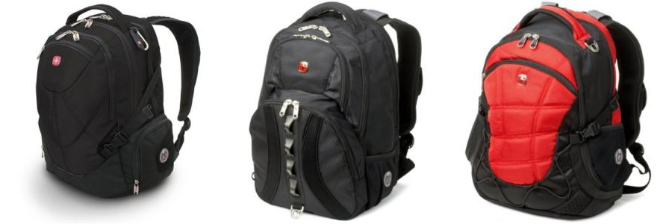

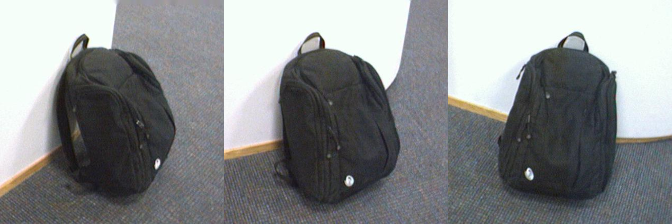

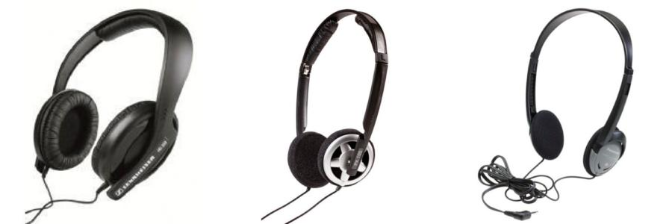

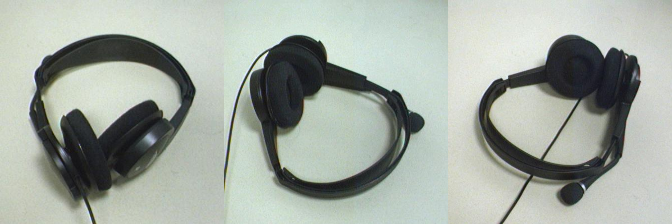

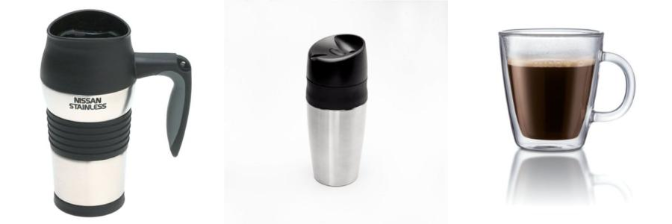

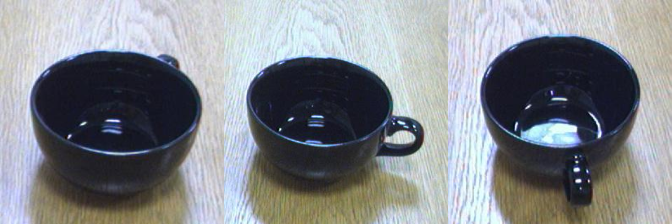

In [ ]:
show_images(f'{unzipped_dataset}/amazon','back_pack',3)
show_images(f'{unzipped_dataset}/webcam','back_pack',3)
show_images(f'{unzipped_dataset}/amazon','headphones',3)
show_images(f'{unzipped_dataset}/webcam','headphones',3)
show_images(f'{unzipped_dataset}/amazon','mug',3)
show_images(f'{unzipped_dataset}/webcam','mug',3)

In [ ]:
!cp -r "gdrive/MyDrive/TACV_Project/trained_models/"* ./temp/

cp: target './temp/' is not a directory


In [ ]:
!mkdir ./temp

## Mean and Standard deviance


In [ ]:
def compute_mean_std(dataset_path: str):
    ####### COMPUTE MEAN / STD
    #params
    device      = torch.device('cpu') 
    num_workers = 4
    image_size  = 512 
    batch_size  = 8

    # Define crop + resize transformation 
    # prepare data transformations for the train loader
    transformations_sequence = list()
    transformations_sequence.append(transforms.Resize((image_size, image_size)))         
    transformations_sequence.append(transforms.ToTensor())                               
    transformations_sequence.append(transforms.Normalize(mean=(0, 0, 0), std=(1, 1, 1))) 
    composed_transformation = transforms.Compose(transformations_sequence)               # compose the above transformations into one


    # Load the datasets with ImageFolder

    amazon_img_datasets = torchvision.datasets.ImageFolder(
        root = dataset_path + "/amazon", 
        transform = composed_transformation
    )
    webcam_img_datasets = torchvision.datasets.ImageFolder(
        root = dataset_path + "/webcam", 
        transform = composed_transformation
    )

    # Split amazon data for training and test
    amazon_num_samples = len(amazon_img_datasets)
    print("DEBUG amazon loader", amazon_num_samples)

    # Split webcam data for training and test
    webcam_num_samples = len(webcam_img_datasets)
    print("DEBUG webcam loader", webcam_num_samples)

    img_datasets = torch.utils.data.ConcatDataset([amazon_img_datasets, webcam_img_datasets])

    # Initialize dataloaders for product
    train_loader = torch.utils.data.DataLoader(img_datasets, batch_size, shuffle=True, num_workers=num_workers)

    # placeholders
    psum    = torch.tensor([0.0, 0.0, 0.0])
    psum_sq = torch.tensor([0.0, 0.0, 0.0])

    # loop through images
    for (inputs, labels) in tqdm(train_loader):
        psum    += inputs.sum(axis        = [0, 2, 3])
        psum_sq += (inputs ** 2).sum(axis = [0, 2, 3])

    ####### FINAL CALCULATIONS

    # pixel count
    count = (amazon_num_samples + webcam_num_samples) * image_size * image_size

    # mean and std
    total_mean = psum / count
    total_var  = (psum_sq / count) - (total_mean ** 2)
    total_std  = torch.sqrt(total_var)

    # output
    print('mean: '  + str(total_mean))
    print('std:  '  + str(total_std))

    return total_mean, total_std

In [ ]:
#mean: tensor([0.7527, 0.7494, 0.7474])
#std:  tensor([0.3120, 0.3136, 0.3154])
total_mean, total_std = compute_mean_std('./office31')

DEBUG amazon loader 2817
DEBUG webcam loader 795


  0%|          | 0/452 [00:00<?, ?it/s]

mean: tensor([0.7527, 0.7494, 0.7474])
std:  tensor([0.3120, 0.3136, 0.3154])


## Data Loaders

We will need to instantiate our `Dataloader` classes for both `amazon` and `webcam`. In his case we use `ImageFolder` as dataset class and `train_test_split`in order to get a stratified dataset divison in train and test sets. Batch sizes of 128 are used. The dataset is split in 80% for training and 20% for testing. No validation set is used as the dataset we have is already very small.

In [ ]:
class ImageFolderWithIndices_old(datasets.DatasetFolder):

    def __init__(
        self,
        root: str,
        transform: Optional[Callable] = None,
        target_transform: Optional[Callable] = None,
        loader: Callable[[str], Any] = datasets.folder.default_loader,
        is_valid_file: Optional[Callable[[str], bool]] = None,
    ):
        super().__init__(
            root,
            loader,
            datasets.folder.IMG_EXTENSIONS if is_valid_file is None else None,
            transform=transform,
            target_transform=target_transform,
            is_valid_file=is_valid_file,
        )
        self.imgs = self.samples

    def __getitem__(self, index: int) -> Tuple[Any, Any]:
        path, target = self.samples[index]
        sample = self.loader(path)
        if self.transform is not None:
            sample = self.transform(sample)
        if self.target_transform is not None:
            target = self.target_transform(target)

        return sample, target, index



class ImageFolderWithIndices(datasets.ImageFolder):
    def __init__(
        self,
        root: str,
        transform: Optional[Callable] = None,
    ):
        super().__init__(
            root,
            transform=transform,
        )

    def __getitem__(self, index: int) -> Tuple[Any, Any]:
        input,output = super().__getitem__(index)
        return input,output,index

In [ ]:
# function to divide the load the dataset and divide in train and test
def get_data(batch_size: int, img_root: str, train_percentage: float = 0.8, 
             val_percentage: float = 0.0, test_percentage: float = 0.2, 
             random_state: int = None, collate_fn = None):
    
    # prepare data transformations for the train loader
    transform = list()
    transform.append(transforms.Resize((256, 256)))                     # resize each PIL image to 256 x 256
    transform.append(transforms.RandomCrop((224, 224)))                 # randomly crop a 224 x 224 patch
    transform.append(transforms.RandomHorizontalFlip(0.5))              # random mirroring
    transform.append(transforms.ToTensor())                             # convert Numpy to Pytorch Tensor
    transform.append(transforms.Normalize(mean=[0.7527, 0.7494, 0.7474], 
                                std=[0.3120, 0.3136, 0.3154]))             # normalize 

    # test_transforms_map = [
    #     True,   # resize
    #     False,  # random crop
    #     False,  # random horizontal flip
    #     True,   # to tensor
    #     True    # normalize
    #     ]

    transform_train = transforms.Compose(transform)
    # transform_test = transforms.Compose([t for (t, _) in enumerate(transform) if test_transforms_map[t]])                           
    # load data
    #office31_train = datasets.ImageFolder(root=img_root, transform=transform_train)
    office31_train = ImageFolderWithIndices(root=img_root, transform=transform_train)
    # office31_test = datasets.ImageFolder(root=img_root, transform=transform_test)
    dataset_size = len(office31_train.samples)
    print(f"dataset size {dataset_size}")
    train_size = int(dataset_size*train_percentage)
    print(f"train set size {train_size}")
    val_size = int(dataset_size*val_percentage)
    print(f"val set size {val_size}")
    test_size = dataset_size - val_size - train_size 
    print(f"test set size {test_size}")
    train_data, test_data = train_test_split(office31_train,train_size=train_size+val_size,test_size=test_size,random_state=0,
                                           shuffle=True,stratify=office31_train.targets)
    # _,test_data = train_test_split(office31_train,train_size=train_size+val_size,test_size=test_size,random_state=0,
    #                                        shuffle=True,stratify=office31_train.targets)
    # initialize dataloaders
    train_loader = torch.utils.data.DataLoader(train_data, batch_size, shuffle=True, collate_fn=collate_fn)
    test_loader = torch.utils.data.DataLoader(test_data, batch_size, shuffle=False, collate_fn=collate_fn)

    #if val_size==0:
    #    return train_loader, test_loader, office31_train.class_to_idx
    #
    #else: 
    #    targets = [j for i,j in train_data]
    #    train_data, val_data = train_test_split(train_data,train_size=train_size,test_size=val_size,
    #                                        shuffle=True,stratify=targets)   
    #    train_loader = torch.utils.data.DataLoader(train_data, batch_size, shuffle=False,collate_fn=collate_fn)
    #    val_loader = torch.utils.data.DataLoader(val_data, batch_size, shuffle=False, collate_fn=collate_fn)
    #    return train_loader, val_loader, test_loader, office31_train.class_to_idx
    val_loader = None
    if val_size != 0:
        targets = [j for i,j in train_data]
        train_data, val_data = train_test_split(train_data,train_size=train_size,test_size=val_size,
                                            shuffle=True,stratify=targets)   
        train_loader = torch.utils.data.DataLoader(train_data, batch_size, shuffle=False,collate_fn=collate_fn)
        val_loader = torch.utils.data.DataLoader(val_data, batch_size, shuffle=False, collate_fn=collate_fn)
    return train_loader, val_loader, test_loader, office31_train.class_to_idx


In [ ]:
train_loader_a, _, test_loader_a, class_mapping = get_data(BATCH_SIZE,img_root = f"{unzipped_dataset}/amazon",train_percentage=0.8,test_percentage=0.2,random_state=seed)

dataset size 2817
train set size 2253
val set size 0
test set size 564


In [ ]:
train_loader_w, _, test_loader_w, class_mapping = get_data(BATCH_SIZE,img_root = f"{unzipped_dataset}/webcam",train_percentage=0.8,test_percentage=0.2,random_state=seed)

dataset size 795
train set size 636
val set size 0
test set size 159


## Plotting
This section contains plotting functions for error analysis. In particular we plot:

* TSNE It uses the t-distributed stochastic neighbour embedding. https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding 


<!---${\displaystyle p_{j\mid i}={\frac{\exp(-\lVert \mathbf {x} _{i}-\mathbf {x} _{j}\rVert ^{2}/2\sigma _{i}^{2})}{\sum _{k\neq i}\exp(-\lVert \mathbf {x} _{i}-\mathbf {x} _{k}\rVert ^{2}/2\sigma _{i}^{2})}}}$

${\displaystyle p_{ij}={\frac {p_{j\mid i}+p_{i\mid j}}{2N}}}$

${\displaystyle q_{ij}={\frac {(1+\lVert \mathbf {y} _{i}-\mathbf {y} _{j}\rVert ^{2})^{-1}}{\sum _{k}\sum _{l\neq k}(1+\lVert \mathbf {y} _{k}-\mathbf {y} _{l}\rVert ^{2})^{-1}}}}$

${\displaystyle \mathrm {KL} \left(P\parallel Q\right)=\sum _{i\neq j}p_{ij}\log {\frac {p_{ij}}{q_{ij}}}}$--->

* Confusion matrixes
* Confidence for class prediction

In [ ]:
def ref_labels(loader: Iterable) -> Iterable:
    data = []
    for i in loader:
        data.append(i[1])
    return np.concatenate(data,axis=0)

In [ ]:
def color_map(class_labels: Dict[str,int]) -> Dict[int,Tuple[int,int,int]]:
    colormap = {}
    for k,i in class_labels.items():
        i = i/len(class_labels)
        (h, s, v) = (0.0+i, 0.5, 1)
        (r, g, b) = colorsys.hsv_to_rgb(h, s, v)
        colormap[int (i * len(class_labels))] = (round(r,2),round(g,2),round(b,2))
    return colormap

In [ ]:
def color(labels: Iterable[str], colormap: Dict[int,Tuple[int,int,int]]) -> Iterable[Tuple[int,int,int]]:
    colors = []
    for i in labels:
        colors.append(colormap[i])
    return colors

In [ ]:
colormap = color_map(class_mapping)

In [ ]:
def eval_plot_source_target(extractor: nn.Module,
                            classifier: nn.Module,
                            source_loader: Iterable,
                            target_loader: Iterable,
                            cost_function: nn.Module,
                            class_mapping: Dict[str,int],
                            layers: Iterable[str] = ['avgpool'],
                            device: str ='cuda:0') -> Tuple[float,float,Iterable[Iterable],Iterable[Iterable],Tuple[Iterable,Iterable,Iterable],Tuple[Iterable,Iterable,Iterable]]:

    colormap = color_map(class_mapping)

    source_test_loss, source_test_accuracy, source_emb, source_out = test_step(extractor,classifier, source_loader, cost_function,device='cuda:0',features = layers,net_outputs=True)
    
    # source_test_loss = source_test_loss.cpu().detach().numpy()
    # source_test_accuracy = source_test_accuracy.cpu().detach().numpy()
    # source_emb = source_emb.cpu().detach().numpy()
    source_out = source_out.cpu().detach().numpy()
    ref_source = ref_labels(source_loader)
    # out_source = source_out.cpu().detach().numpy()
    e_source = source_emb[-1].squeeze().cpu().detach().numpy()

    target_test_loss, target_test_accuracy, target_emb, target_out = test_step(extractor,classifier, target_loader, cost_function,device='cuda:0',features = layers,net_outputs=True)
    # target_test_loss = target_test_loss.cpu().detach().numpy()
    # target_test_accuracy = target_test_accuracy.cpu().detach().numpy()
    # target_emb = target_emb.cpu().detach().numpy()
    target_out = target_out.cpu().detach().numpy()
    ref_target = ref_labels(target_loader)
    # out_target = target_out.cpu().detach().numpy()
    e_target = target_emb[-1].squeeze().cpu().detach().numpy()

    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(10, 10))

  
    tsne = TSNE(n_components=2,  learning_rate='auto', init='pca')
    tsne_out = tsne.fit_transform(np.concatenate((e_source,e_target),axis=0))
    tsne_out_source,tsne_out_target = tsne_out[:len(e_source)],tsne_out[-len(e_target):]
    # source
    # get ref labels
    source_ref_colors = color(ref_source,colormap)
    # get hyp labels
    source_hyp_colors = color(source_out,colormap)
    # compute TSNE
    # plot features
    ax1.scatter(tsne_out_source[:,0], tsne_out_source[:,1],c=source_ref_colors)
    ax1.set_title('Reference Embedding')
    # plot features
    ax2.scatter(tsne_out_source[:,0], tsne_out_source[:,1],c=source_hyp_colors)
    ax2.set_title('Hypothesis Embedding')
    # target
    # get ref labels
    target_ref_colors = color(ref_target,colormap)
    # get hyp labels
    target_hyp_colors = color(target_out,colormap)
    # compute TSNE
    #tsne = TSNE(n_components=2,  learning_rate='auto', init='pca')
    #tsne_out = tsne.fit_transform(target_features)
    # plot features
    ax3.scatter(tsne_out_target[:,0], tsne_out_target[:,1],c=target_ref_colors)
    ax3.set_title('Reference Embedding')
    # plot features
    ax4.scatter(tsne_out_target[:,0], tsne_out_target[:,1],c=target_hyp_colors)
    ax4.set_title('Hypothesis Embedding')
    
    
    plt.figtext(-0.25, 0.75, 'Source', fontsize = 14)
    plt.figtext(-0.25, 0.7, f'Accuracy: {source_test_accuracy:.2f}', fontsize = 14)
    plt.figtext(-0.25, 0.65, f'Loss: {source_test_loss:.2f}', fontsize = 14)
    plt.figtext(-0.25, 0.25, 'Target', fontsize = 14)
    plt.figtext(-0.25, 0.2, f'Accuracy: {target_test_accuracy:.2f}', fontsize = 14)
    plt.figtext(-0.25, 0.15, f'Loss: {target_test_loss:.2f}', fontsize = 14)

    markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for idx,color in colormap.items()]
    inv_map = {v: k for k, v in class_mapping.items()}
    plt.legend(markers, [inv_map[k] for k,v in colormap.items()], numpoints=1,loc=(1.25,0))
    
    fig.suptitle("TSNE of the embeddings", fontsize=14)
    plt.show()

    # classification report
    names = [k for k,v in class_mapping.items()]

    report_source = classification_report(ref_source,source_out,target_names=names,output_dict=True)
    df_source = pd.DataFrame(report_source).transpose()
    df_source=df_source.round(2)

    report_target = classification_report(ref_target,target_out,target_names=names,output_dict=True)
    df_target = pd.DataFrame(report_target).transpose()
    df_target = df_target.round(2)

    df1_styler = df_source.style.set_table_attributes("style='display:inline'").set_caption('source').set_table_styles([{
            'selector': 'caption',
            'props': [
                ('color', 'black'),
                ('font-size', '15px'),
                ('font-style', 'italic'),
                ('font-weight', 'bold'),
                ('text-align', 'center')
                ]
            }])
    
    df2_styler = df_target.style.set_table_attributes("style='display:inline'").set_caption('target').set_table_styles([{
            'selector': 'caption',
            'props': [
                ('color', 'black'),
                ('font-size', '15px'),
                ('font-style', 'italic'),
                ('font-weight', 'bold'),
                ('text-align', 'center')
                ]
            }])
    space = "\xa0" * 10
    display_html(df1_styler._repr_html_() + df2_styler._repr_html_(), raw=True)
    
    # confusion matrixes
    ground_source = torch.cat([j for i,j,_ in source_loader]).cpu().detach().numpy()
    ground_target = torch.cat([j for i,j,_ in target_loader]).cpu().detach().numpy()
    matrix_source = confusion_matrix(ground_source,source_out,labels=[v for k,v in class_mapping.items()])
    matrix_target = confusion_matrix(ground_target,target_out,labels=[v for k,v in class_mapping.items()])
    # return list of error images
    source_errors = np.not_equal(ground_source,source_out)
    source_errors_index = np.asarray(range(ground_source.shape[0]))[source_errors]
    source_predicted_error = source_out[source_errors]
    source_ground_error = ground_source[source_errors]

    target_errors = np.not_equal(ground_target,target_out)
    target_errors_index = np.asarray(range(ground_target.shape[0]))[target_errors]
    target_predicted_error = target_out[target_errors]
    target_ground_error = ground_target[target_errors]
    return source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,(source_errors_index,source_ground_error,source_predicted_error),(target_errors_index,target_ground_error,target_predicted_error)

In [ ]:
def confusion_matrix_plotter(matrix_source: Iterable[Iterable], matrix_target: Iterable[Iterable], class_mapping: Dict[str,int]) -> None:
    labels = [k for k,v in class_mapping.items()]
    fig = plt.figure(dpi=100)
    fig.set_figheight(10)
    fig.set_figwidth(20)
    plt.subplots_adjust(left=0.1,
                        bottom=0.1,
                        right=0.9,
                        top=0.9,
                        wspace=0.4,
                        hspace=0.4)
    for (i,j),name in zip(enumerate([matrix_source,matrix_target]),['Source','Target']):
        matrix = j
        ax = plt.subplot(1, 2, i+1)
        ax.xaxis.set_ticks_position('top')
        ax.title.set_text(name+ ' Confusion Matrix')
        heatmap = ax.pcolormesh(matrix, cmap=plt.cm.Blues)
        for i in range(matrix.shape[0]):
            if np.sum(matrix[i]) > 0.0:
                for j in range(matrix.shape[1]):
                    color = "white" if matrix[i, j] >= 0.5 else "black"
                    number = f"{matrix[i, j]:.0f}" 
                    plt.text(j+0.5, i+0.5, number, ha="center", va="center", color=color,) 
        plt.xticks([ i+0.5 for i in list(range(len(labels)))], labels,fontsize=12,rotation=90)
        plt.yticks([ i+0.5 for i in list(range(len(labels)))], labels,fontsize=12,rotation=0)
        plt.gca().invert_yaxis()
    plt.show()

In [ ]:
def prediction_confidence(extractor: nn.Module,
                          classifier: nn.Module,
                          loader: Iterable,
                          class_mapping: Dict[str,int],
                          colormap: Dict[int,Tuple[int,int,int]],
                          title: str = None,
                          device = 'cuda:0') -> None:
    outputs = {}
    for input,target,_ in loader:
        out = extractor(input.to(device))
        out = classifier(out)
        for k,v in class_mapping.items():
            if k not in outputs:
                outputs[k] = [out[target==v].cpu().detach().numpy()]
            else:
                outputs[k].append(out[target==v].cpu().detach().numpy())
    for k,v in outputs.items():
        outputs[k] = np.concatenate(outputs[k],axis=0)
        outputs[k] = softmax(outputs[k],axis=1)
    labels = list(class_mapping.keys())
    x = np.arange(len(labels))
    width = 0.35  # the width of the bars
    fig = plt.figure(dpi=100)
    fig.set_figheight(50)
    fig.set_figwidth(50)
    fig.suptitle(title,size=48)
    for i,(label,v) in enumerate(class_mapping.items()):
        mean = np.mean(outputs[label],axis=0)
        min = np.min(outputs[label],axis=0)
        max = np.max(outputs[label],axis=0)
        std = np.std(outputs[label],axis=0)
        ax = plt.subplot(5, 4, i+1)
        plt.ylim([0, 1.0])
        plt.bar(x, mean, yerr=2*std, width=width,label='mean', align='center',alpha=0.5,color=colormap[v], ecolor='grey', capsize=3)
        # Add some text for labels, title and custom x-axis tick labels, etc.
        ax.set_title(label)
        ax.set_xticks(x)
        ax.set_xticklabels(labels)
        plt.xticks(rotation=90)
        ax.legend()
    plt.show()

In [ ]:
def show_error_images(loader: Iterable,
                      indexes: Iterable[int],
                      ground: Iterable[int],
                      predicted: Iterable[int],
                      class_mapping: Dict[str,int],
                      max_images: int = None) -> None:
    if max_images!=None:
        indexes = indexes[:max_images]
        ground = ground[:max_images]
        predicted = predicted[:max_images]
    inv_map = {v: k for k, v in class_mapping.items()}
    def get_concat_h(im1, im2):
        dst = Image.new('RGB', (im1.width + im2.width, im1.height))
        dst.paste(im1, (0, 0))
        dst.paste(im2, (im1.width, 0))
        return dst
    W, H = (224,224)
    mean=[0.485, 0.456, 0.406]
    std=[0.229, 0.224, 0.225]
    wrap = [i for i,j,_ in loader]
    count = 0
    batch_size=-1
    for i,j,_ in loader:
        count+=i.shape[0]
        if batch_size==-1:
            batch_size=i.shape[0]
    # from index to batch position
    for i,gr,pr in zip(indexes,ground,predicted):
        batch = i // batch_size
        in_batch = i % batch_size
        #print(batch)
        #print(in_batch)
        tensor = wrap[batch][in_batch]
        #print(tensor.shape)
        z = tensor * torch.tensor(std).view(3, 1, 1)
        z = z + torch.tensor(mean).view(3, 1, 1)
        img = transforms.ToPILImage(mode='RGB')(z)
        #img = transform(tensor)

        im = Image.new("RGBA",(W,H),"white")
        draw = ImageDraw.Draw(im)

        msg1 = "Predicted : " + inv_map[pr]
        msg2 = "Ground truth : " + inv_map[gr]
        draw.text((10,120+10), msg1, fill="black")
        draw.text((10,120-10), msg2, fill="black")

        label = get_concat_h(img,im)
        display(label)

## Shared components

### Learning rate decay

In [ ]:
def exp_lr_scheduler(optimizer, epoch, init_lr, lrd, nevals): #epoch not used
    """Implements torch learning reate decay with SGD"""
    lr = init_lr / (1 + nevals*lrd)

    for param_group in optimizer.param_groups:
        param_group['lr'] = lr
    return optimizer

### Weight initialization

In [ ]:
def init_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv2d') != -1 or classname.find('ConvTranspose2d') != -1:
        nn.init.kaiming_uniform_(m.weight)
        nn.init.zeros_(m.bias)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal(m.weight, 1.0, 0.02)
        nn.init.zeros_(m.bias)
    elif classname.find('Linear') != -1:
        nn.init.xavier_normal_(m.weight)
        nn.init.zeros_(m.bias)

In [ ]:
#@title Criterions
def get_ce_loss() -> nn.Module:
    return nn.CrossEntropyLoss()
def get_bce_loss() -> nn.Module:
    return nn.BCELoss()
def get_bce_with_logist_loss() -> nn.Module:
    return nn.BCEWithLogitsLoss()

In [ ]:
#@title Model
class Extractor(nn.Module):
    def __init__(self, model: nn.Module):
        super().__init__()
        self.model = nn.Sequential(*(list(model.children())[:-1]))
    def forward(self, x: Tensor) -> Tensor:
        out = self.model(x)
        out = out.squeeze()
        return out



In [ ]:
#@title Test step
def test_step(extractor: nn.Module,
              classifier: nn.Module, 
              data_loader: Iterable, 
              cost_function: nn.Module, 
              device='cuda:0',
              features: Iterable[str] = None,
              net_outputs: bool = False) -> Tuple[float,float] or Tuple[float,float,Iterable[Tensor]] or Tuple[float,float,Iterable[Tensor],Iterable[Tensor]]:
    samples = 0.
    cumulative_loss = 0.
    cumulative_accuracy = 0.
    # set the network to evaluation mode
    extractor.eval() 
    classifier.eval()
    # disable gradient computation (we are only testing, we do not want our model to be modified in this step!)
    embeddings = []
    outs = []
    with torch.no_grad():
        # iterate over the test set
        for batch_idx, (inputs, targets, _) in enumerate(data_loader):
            # load data into GPU
            inputs = inputs.to(device)
            targets = targets.to(device)
            # forward pass
            if features:
                extracted = extractor(inputs)
                outputs,emb = classifier(extracted,features)
                for id,e in enumerate(emb):
                    if batch_idx==0:
                        embeddings.append(e)
                    else:
                        embeddings[id] = torch.cat([embeddings[id],e],dim=0)
            else:
                extracted = extractor(inputs)
                outputs = classifier(extracted)
            # loss computation
            loss = cost_function(outputs, targets)
            # fetch prediction and loss value
            samples+=inputs.shape[0]
            cumulative_loss += loss.item() # Note: the .item() is needed to extract scalars from tensors
            _, predicted = outputs.max(1)
            # compute accuracy
            cumulative_accuracy += predicted.eq(targets).sum().item()
            outputs = torch.argmax(outputs,dim=1)
            outs.append(outputs)
    outs = torch.cat(outs,dim=0)
    if features:
        if net_outputs:
            return float(cumulative_loss/samples), float(cumulative_accuracy/samples*100),embeddings,outs
        else:
            return float(cumulative_loss/samples), float(cumulative_accuracy/samples*100),embeddings
    else:
        if net_outputs:
            return float(cumulative_loss/samples), float(cumulative_accuracy/samples*100),outs
        else:
            return float(cumulative_loss/samples), float(cumulative_accuracy/samples*100)

In [ ]:
#@title Optimizer ADAM
def get_optimizer(model: nn.Module, lr: float, wd: float):
    optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=wd)
    return optimizer

def get_optimizer_params_list(params: List[Any], lr: float, wd: float):
    optimizer = torch.optim.Adam(params, lr=lr, weight_decay=wd)
    return optimizer

# used bu Self-Supervision UDA
def get_optimizer_ext_head(models_params: Tuple[nn.Module, nn.Module], lr: float, wd: float):
    extractor_params, head_params = models_params[0], models_params[1]
    # assign the distinct learning rates to each group of parameters
    optimizer = torch.optim.Adam([
        {'params': extractor_params},
        {'params': head_params, 'lr': lr}
    ], lr=lr / 10, weight_decay=wd)
    return optimizer

In [ ]:
#@title Optimizer SGD
def get_SGD_optimizer(model: nn.Module, lr: float, wd: float, momentum: float):
    optimizer = torch.optim.SGD(model.parameters(), lr=lr, weight_decay=wd, momentum=momentum)
    return optimizer

def get_SGD_optimizer_params_list(params: List[Any], lr: float, wd: float, momentum: float):
    optimizer = torch.optim.SGD(params, lr=lr, weight_decay=wd, momentum=momentum)
    return optimizer

### DALN
[Paper](http://arxiv-export3.library.cornell.edu/pdf/2204.03838)\
[Code](https://github.com/xiaoachen98/DALN)\
Discriminator is removed and the classifier prediction together with Nuclear-norm Wasserstein Discrepancy module is used to predict the domain.

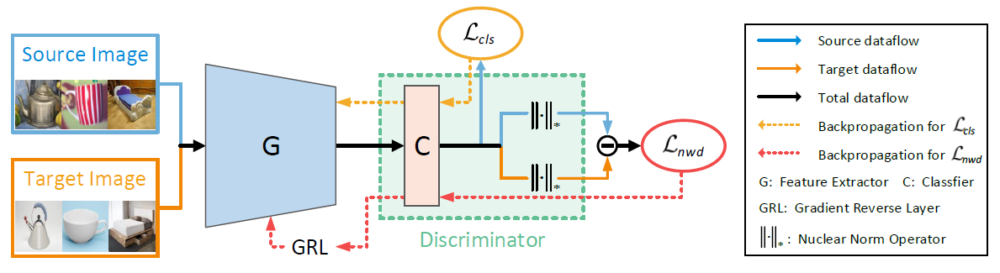

In [ ]:
class GradientReverseFunction(Function):

    @staticmethod
    def forward(ctx: Any, input: torch.Tensor, coeff: Optional[float] = 1.) -> torch.Tensor:
        ctx.coeff = coeff
        output = input * 1.0
        return output

    @staticmethod
    def backward(ctx: Any, grad_output: torch.Tensor) -> Tuple[torch.Tensor, Any]:
        return grad_output.neg() * ctx.coeff, None


class GradientReverseLayer(nn.Module):
    def __init__(self):
        super(GradientReverseLayer, self).__init__()

    def forward(self, *input):
        return GradientReverseFunction.apply(*input)


class WarmStartGradientReverseLayer(nn.Module):
    """Gradient Reverse Layer :math:`\mathcal{R}(x)` with warm start
        The forward and backward behaviours are:
        .. math::
            \mathcal{R}(x) = x,
            \dfrac{ d\mathcal{R}} {dx} = - \lambda I.
        :math:`\lambda` is initiated at :math:`lo` and is gradually changed to :math:`hi` using the following schedule:
        .. math::
            \lambda = \dfrac{2(hi-lo)}{1+\exp(- α \dfrac{i}{N})} - (hi-lo) + lo
        where :math:`i` is the iteration step.
        Args:
            alpha (float, optional): :math:`α`. Default: 1.0
            lo (float, optional): Initial value of :math:`\lambda`. Default: 0.0
            hi (float, optional): Final value of :math:`\lambda`. Default: 1.0
            max_iters (int, optional): :math:`N`. Default: 1000
            auto_step (bool, optional): If True, increase :math:`i` each time `forward` is called.
              Otherwise use function `step` to increase :math:`i`. Default: False
        """

    def __init__(self, alpha: Optional[float] = 1.0, lo: Optional[float] = 0.0, hi: Optional[float] = 1.,
                 max_iters: Optional[int] = 1000., auto_step: Optional[bool] = False):
        super(WarmStartGradientReverseLayer, self).__init__()
        self.alpha = alpha
        self.lo = lo
        self.hi = hi
        self.iter_num = 0
        self.max_iters = max_iters
        self.auto_step = auto_step

    def forward(self, input: torch.Tensor) -> torch.Tensor:
        """"""
        coeff = np.float(
            2.0 * (self.hi - self.lo) / (1.0 + np.exp(-self.alpha * self.iter_num / self.max_iters))
            - (self.hi - self.lo) + self.lo
        )
        if self.auto_step:
            self.step()
        return GradientReverseFunction.apply(input, coeff)

    def step(self):
        """Increase iteration number :math:`i` by 1"""
        self.iter_num += 1

class NuclearWassersteinDiscrepancy(nn.Module):
    def __init__(self, classifier: nn.Module):
        super(NuclearWassersteinDiscrepancy, self).__init__()
        self.grl = WarmStartGradientReverseLayer(alpha=1., lo=0., hi=1., max_iters=1000, auto_step=True)
        self.classifier = classifier

    @staticmethod
    def n_discrepancy(y_s: torch.Tensor, y_t: torch.Tensor) -> torch.Tensor:
        pre_s, pre_t = F.softmax(y_s, dim=1), F.softmax(y_t, dim=1)
        loss = (-torch.norm(pre_t, 'nuc') + torch.norm(pre_s, 'nuc')) / y_t.shape[0]
        return loss

    def forward(self, f: torch.Tensor) -> torch.Tensor:
        f_grl = self.grl(f)
        y = self.classifier(f_grl)
        y_s, y_t = y.chunk(2, dim=0)

        loss = self.n_discrepancy(y_s, y_t)
        return loss

### SDAT Optimizer
[Paper](https://arxiv.org/pdf/2206.08213.pdf)\
[Code](https://github.com/val-iisc/SDAT)\
This method aim to find a smoother optimum for the classification loss. To do that we add some additional gradient computation steps and this is practically implemented with a new optimizer.

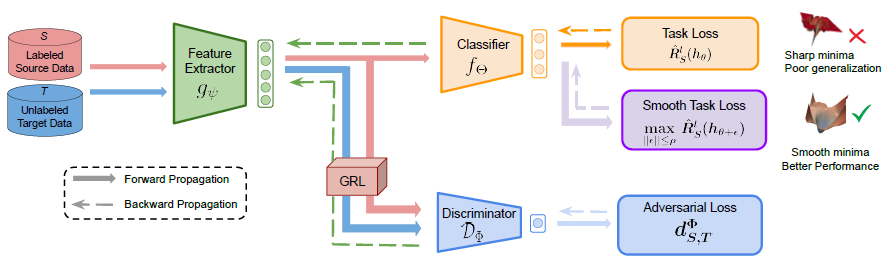

In [ ]:
class SAM(torch.optim.Optimizer):
    def __init__(self, params, base_optimizer, rho=0.05, adaptive=False, **kwargs):
        assert rho >= 0.0, f"Invalid rho, should be non-negative: {rho}"

        defaults = dict(rho=rho, adaptive=adaptive, **kwargs)
        super(SAM, self).__init__(params, defaults)

        self.base_optimizer = base_optimizer(self.param_groups, **kwargs)
        self.param_groups = self.base_optimizer.param_groups

    @torch.no_grad()
    def first_step(self, zero_grad=False):
        grad_norm = self._grad_norm()
        for group in self.param_groups:
            scale = group["rho"] / (grad_norm + 1e-12)

            for p in group["params"]:
                if p.grad is None: continue
                e_w = (torch.pow(p, 2) if group["adaptive"] else 1.0) * p.grad * scale.to(p)
                p.add_(e_w)  # climb to the local maximum "w + e(w)"
                self.state[p]["e_w"] = e_w

        if zero_grad: self.zero_grad()

    @torch.no_grad()
    def second_step(self, zero_grad=False):
        for group in self.param_groups:
            for p in group["params"]:
                if p.grad is None: continue
                p.sub_(self.state[p]["e_w"])  # get back to "w" from "w + e(w)"

        self.base_optimizer.step()  # do the actual "sharpness-aware" update

        if zero_grad: self.zero_grad()

    @torch.no_grad()
    def step(self, closure=None):
        assert closure is not None, "Sharpness Aware Minimization requires closure, but it was not provided"
        closure = torch.enable_grad()(closure)  # the closure should do a full forward-backward pass

        self.first_step(zero_grad=True)
        closure()
        self.second_step()

    def _grad_norm(self):
        shared_device = self.param_groups[0]["params"][0].device  # put everything on the same device, in case of model parallelism
        norm = torch.norm(
                    torch.stack([
                        ((torch.abs(p) if group["adaptive"] else 1.0) * p.grad).norm(p=2).to(shared_device)
                        for group in self.param_groups for p in group["params"]
                        if p.grad is not None
                    ]),
                    p=2
               )
        return norm

### Jacobian Regularization
[Paper](https://arxiv.org/pdf/1908.02729.pdf)\
[Code](https://github.com/facebookresearch/jacobian_regularizer)\
This a famous regularization methods. Jacobian regularization pushes decision boundaries farther away from each training data point, enlarging decision cells and reducing instability.

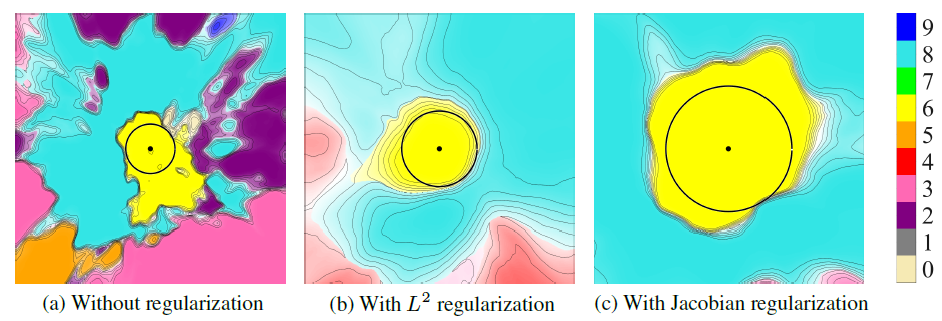

In [ ]:
class JacobianReg(nn.Module):
    '''
    Loss criterion that computes the trace of the square of the Jacobian.
    Arguments:
        n (int, optional): determines the number of random projections.
            If n=-1, then it is set to the dimension of the output 
            space and projection is non-random and orthonormal, yielding 
            the exact result.  For any reasonable batch size, the default 
            (n=1) should be sufficient.
    '''
    def __init__(self, n=1):
        assert n == -1 or n > 0
        self.n = n
        super(JacobianReg, self).__init__()

    def forward(self, x, y):
        '''
        computes (1/2) tr |dy/dx|^2
        '''
        B,C = y.shape
        if self.n == -1:
            num_proj = C
        else:
            num_proj = self.n
        J2 = 0
        for ii in range(num_proj):
            if self.n == -1:
                # orthonormal vector, sequentially spanned
                v=torch.zeros(B,C)
                v[:,ii]=1
            else:
                # random properly-normalized vector for each sample
                v = self._random_vector(C=C,B=B)
            if x.is_cuda:
                v = v.cuda()
            Jv = self._jacobian_vector_product(y, x, v, create_graph=True)
            J2 += C*torch.norm(Jv)**2 / (num_proj*B)
        R = (1/2)*J2
        return R

    def _random_vector(self, C, B):
        '''
        creates a random vector of dimension C with a norm of C^(1/2)
        (as needed for the projection formula to work)
        '''
        if C == 1: 
            return torch.ones(B)
        v=torch.randn(B,C)
        arxilirary_zero=torch.zeros(B,C)
        vnorm=torch.norm(v, 2, 1,True)
        v=torch.addcdiv(arxilirary_zero, 1.0, v, vnorm)
        return v
                                                                            
    def _jacobian_vector_product(self, y, x, v, create_graph=False): 
        '''
        Produce jacobian-vector product dy/dx dot v.
        Note that if you want to differentiate it,
        you need to make create_graph=True
        '''                                                            
        flat_y = y.reshape(-1)
        flat_v = v.reshape(-1)
        grad_x, = torch.autograd.grad(flat_y, x, flat_v, 
                                        retain_graph=True, 
                                        create_graph=create_graph)
        return grad_x

### FGDA
[Paper](https://openaccess.thecvf.com/content/ICCV2021/papers/Gao_Gradient_Distribution_Alignment_Certificates_Better_Adversarial_Domain_Adaptation_ICCV_2021_paper.pdf)\
[Code](https://github.com/gzqhappy/FGDA/tree/6f2947693e7c84a2c28cde589e2f0b2cabd8068d)\
Gradient distribution allignement:
- Constrain feature gradients of two domains to have similar distributions
- Pseudo labels are used to compute target loss
- Apply Jacobian regularization to improve model generalization


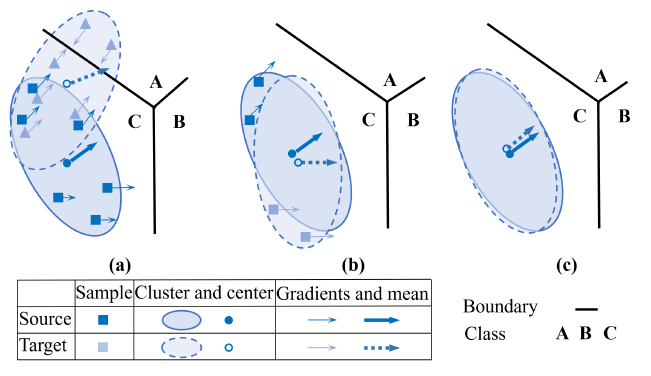

In [ ]:
def grl_hook(coeff):
    def fun1(grad):
        return -coeff * grad.clone()

    return fun1

In [ ]:
def calc_coeff(iter_num, high=1.0, low=0.0, alpha=10.0, max_iter=10000.0):
    return np.float(2.0 * (high - low) / (1.0 + np.exp(-alpha * iter_num / max_iter)) - (high - low) + low)

In [ ]:
def DANN_FGDA(features, ad_net, src_size, tgt_size, outputs=False, train_self=False): #this is not the same DANN of ganin paper
    ad_out, outputs_cla = ad_net(features, train_self)
    dc_target = torch.from_numpy(
        np.array([[1]] * src_size + [[0]] * tgt_size)).float().cuda()  # 1 for source, 0 for target
    d_loss = nn.BCELoss()(ad_out, dc_target)

    if outputs:
        return d_loss, ad_out
    elif train_self:
        return d_loss, outputs_cla
    else:
        return d_loss

In [ ]:
class GradientDiscriminator(nn.Module):
    def __init__(self, in_feature, hidden_size, num_class, r_lambda_1=0.5):
        super(GradientDiscriminator, self).__init__()
        self.ad_layer1 = nn.Linear(in_feature, hidden_size)
        self.ad_layer2 = nn.Linear(hidden_size, hidden_size)
        self.ad_layer2_1 = nn.Linear(hidden_size, hidden_size)
        self.ad_layer2_2 = nn.Linear(hidden_size, hidden_size)

        self.ad_layer3 = nn.Linear(hidden_size, 1)
        self.ad_layer4 = nn.Linear(hidden_size, num_class)

        self.relu1 = nn.ReLU()
        self.relu2 = nn.ReLU()
        self.relu2_1 = nn.ReLU()
        self.relu2_2 = nn.ReLU()
        self.dropout1 = nn.Dropout(0.5)
        self.dropout2 = nn.Dropout(0.5)
        self.dropout2_1 = nn.Dropout(0.5)
        self.dropout2_2 = nn.Dropout(0.5)
        self.sigmoid = nn.Sigmoid()
        self.apply(init_weights)
        self.iter_num = 0
        self.alpha = 10
        self.low = 0.0
        self.high = 1.0
        self.max_iter = 10000.0
        self.batch_norm_1 = nn.BatchNorm1d(hidden_size)
        self.batch_norm_2 = nn.BatchNorm1d(hidden_size)
        self.batch_norm_2_1 = nn.BatchNorm1d(hidden_size)
        self.batch_norm_2_2 = nn.BatchNorm1d(hidden_size)

        self.r_lambda_1 = r_lambda_1
        self.parameter_list = [{"params": self.parameters(), "lr": 1}]

    def forward(self, x, train_self=False):

        if not train_self:
            if self.training:
                self.iter_num += (1 * self.r_lambda_1)
            self.coeff = calc_coeff(self.iter_num, self.high, self.low, self.alpha, self.max_iter)
            x = x * 1.0
            x.register_hook(grl_hook(self.coeff))

        x = self.ad_layer1(x)
        x = self.batch_norm_1(x)
        x = self.relu1(x)
        x = self.dropout1(x)

        x = self.ad_layer2(x)
        x = self.batch_norm_2(x)
        x = self.relu2(x)
        x = self.dropout2(x)

        y = self.ad_layer3(x)
        y = self.sigmoid(y) #domain

        y_c = self.ad_layer4(x) #classes
        return y, y_c

    def output_num(self):
        return 1

    def get_parameters(self):
        return [{"params": self.parameters(), "lr_mult": 10, 'decay_mult': 2}]

### RADA
[Paper](https://arxiv.org/pdf/2103.11661.pdf)\
**Code:** there isn't an official implementation of this paper because it is very recent.\
Re-energize learning ralabeling well alligned target samples.
Well aligned samples can’t be well distinguish by domain discriminator so they are the one with an entropy higher than a certain threshold.\
Well alligned samples are relabeled as source domain samples, moreover mixup at features level is applied to softly mix the features between the previous
source samples and the newly absorbed samples.\
Domain relabeling doesn't influence classification task.


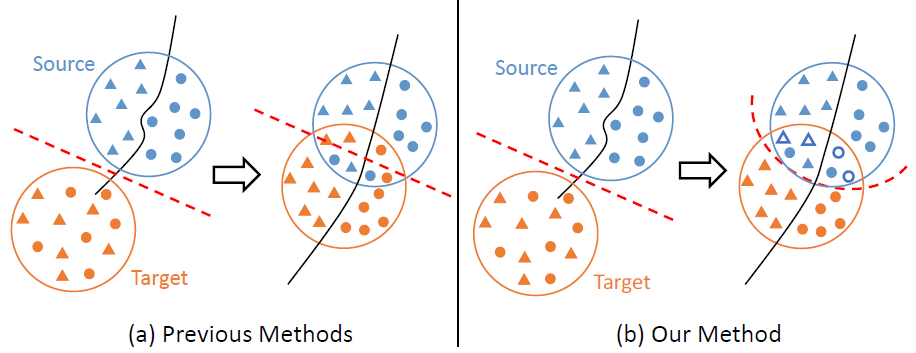


In [ ]:
def entropy_computation(probs):
  probs1 = probs.cpu().detach().numpy()
  entropies = []
  for p0 in probs1:
    if p0 > 1:
      p0=1
    if p0 < 0:
      p0=0
    ent = entropy(pk=[p0, 1-p0] )
    entropies.append(ent)
  return entropies

In [ ]:
def mixup_for_rada(features_src, features_tgt, well_alligned_idx):
  mixup_list = []
  alphas = np.random.uniform(size=len(well_alligned_idx))
  src_idxs = np.random.randint(0, features_src.shape[0]-1, size=len(well_alligned_idx)) 
  for src_idx, tgt_idx, alpha in zip(src_idxs, well_alligned_idx, alphas):
    src_f = features_src[src_idx]
    tgt_f = features_tgt[tgt_idx]
    mixup_f = alpha*src_f + (1-alpha)*tgt_f
    mixup_list.append(mixup_f)
  mixup_features = torch.stack(mixup_list)
  return mixup_features

# Source-only scenario

Here we start from a test a simple ResNET18 without domain adaptation to get a baseline to compare the results.

We train the model using a simple Cross Entropy Loss.

$CE = -\sum\limits_{i}\limits^{M} y_i log(p(y_i)) $
where $M$ is the number of classes

In [ ]:
class Classifier(nn.Module):
    def __init__(self, input, n_classes : int ,layers:Iterable[str] = None) -> None:
        super().__init__()
        self.identity = torch.nn.Identity()
        self.fc = torch.nn.Linear(in_features=input,out_features=n_classes)
        self.layers = layers
        if layers != None:
            self._features = {layer: torch.empty(0) for layer in layers}
            for layer_id in layers:
                layer = dict([*self.named_modules()])[layer_id]
                layer.register_forward_hook(self.save_outputs_hook(layer_id))

    def save_outputs_hook(self, layer_id: str) -> Callable:
        def fn(_, __, output):
            self._features[layer_id] = output
        return fn

    def forward(self, x: Tensor,layers : Iterable[str] = None) -> Tensor or Tuple[Tensor,Iterable[Tensor]]:
        out = x
        out = self.identity(out)
        out = self.fc(out)
        if layers == None:
            return  out
        else:
            feature_list = []
            for i in layers:
                if self.layers != None and i in self.layers:
                    feature_list.append(self._features[i])
                if i not in self.layers:
                    raise NameError(f"{i} is not a valid layer or it was not stated in __init__")
        return out, feature_list

## Train Step

In [ ]:
def training_source_only_step(extractor: nn.Module,
                  classifier: nn.Module, 
                  source_data_loader: Iterable, 
                  optimizer_extractor: Any,
                  optimizer_classifier: Any,
                  ce_cost_fun: nn.Module,
                  epoch: int,
                  lr: float,
                  lrd,
                  curr_iter: int,
                  device='cuda:0') -> Tuple[float,float]:
  source_samples = 0.
  cumulative_ce_loss = 0.
  cumulative_accuracy = 0.
  # strictly needed if network contains layers which has different behaviours between train and test
  classifier.train()
  extractor.train()
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a,(batch_idx, (inputs, targets, _)) in zip(pbar,enumerate(source_data_loader)):
    # loads data inot gpu
    inputs = inputs.to(device)
    targets = targets.to(device)
    # forward pass. I require in out the embeddings of the last layer(avgpool)
    extracted = extractor.forward(inputs)
    source_output = classifier.forward(extracted)
    
    # apply the losses
    ce_loss = ce_cost_fun(source_output,targets)
    # backward pass
    ce_loss.backward()
    # update parameters
    optimizer_extractor.step()
    optimizer_classifier.step()
    # reset the optimizer
    optimizer_extractor.zero_grad()
    optimizer_classifier.zero_grad()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      optimizer_extractor = exp_lr_scheduler(optimizer_extractor, epoch, lr, lrd, curr_iter)   
      optimizer_classifier = exp_lr_scheduler(optimizer_classifier, epoch, lr, lrd, curr_iter)

    # print statistics
    source_samples+=inputs.shape[0]
    cumulative_ce_loss += ce_loss.item()
    _, predicted = source_output.max(1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return float(cumulative_ce_loss/source_samples), float(cumulative_accuracy/source_samples*100), curr_iter


In [ ]:
def train_source_only(extractor: nn.Module, 
          classifier: nn.Module,
          source_train_loader: Iterable,
          source_test_loader: Iterable,
          ce_cost_function: nn.Module,
          optimizer_extractor: Any,
          optimizer_classifier: Any,
          lr: float,
          lrd,
          epochs: int,
          device='cuda:0') -> Tuple[nn.Module,nn.Module]:
  # range over the number of epochs
  curr_iter = 0
  pbar = tqdm(range(1,epochs+1),position=0, leave=True)
  for epoch in pbar:
    ce_train_loss, train_accuracy, curr_iter = training_source_only_step(extractor,classifier, source_train_loader,
                                                                 optimizer_extractor,optimizer_classifier, 
                                                                 ce_cost_function,
                                                                 epoch,
                                                                 lr,
                                                                 lrd,
                                                                 curr_iter,
                                                                 device=device)
    source_test_loss, source_test_accuracy = test_step(extractor,classifier, source_test_loader, ce_cost_function,device=device)
    pbar.set_description(str({
    'CE Training loss': f'{ce_train_loss:.5f}',
    'Training accuracy': f'{train_accuracy:.2f}',    
    'Source Test loss': f'{source_test_loss:.5f}',
    'Source Test accuracy': f'{source_test_accuracy:.2f}', 
    }))
  return extractor,classifier

## Finetune ResNet18 on A only

We train a model of ResNet18 on Amazon examples only

In [ ]:
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES).to(device)
#optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
#optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

lr = 1e-3
wd = 1e-4
lrd = 0.0002

optimizer_ex = get_SGD_optimizer(extractor,lr=lr, wd=wd, momentum=0.9)
optimizer_cl = get_SGD_optimizer(classifier,lr=lr, wd=wd, momentum=0.9)

ce_cost_function = get_ce_loss()
ex = train_source_only(extractor,
           classifier,
           train_loader_a,
           test_loader_a, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           lr=lr,
           lrd=lrd,
           epochs=50, 
           device=device)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_ex_a_path)
torch.save(classifier.state_dict(), resnet18_cl_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_ex_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_cl_a_path)

### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_ex_a_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_cl_a_path))
classifier.to(device)
classifier.eval()

###Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


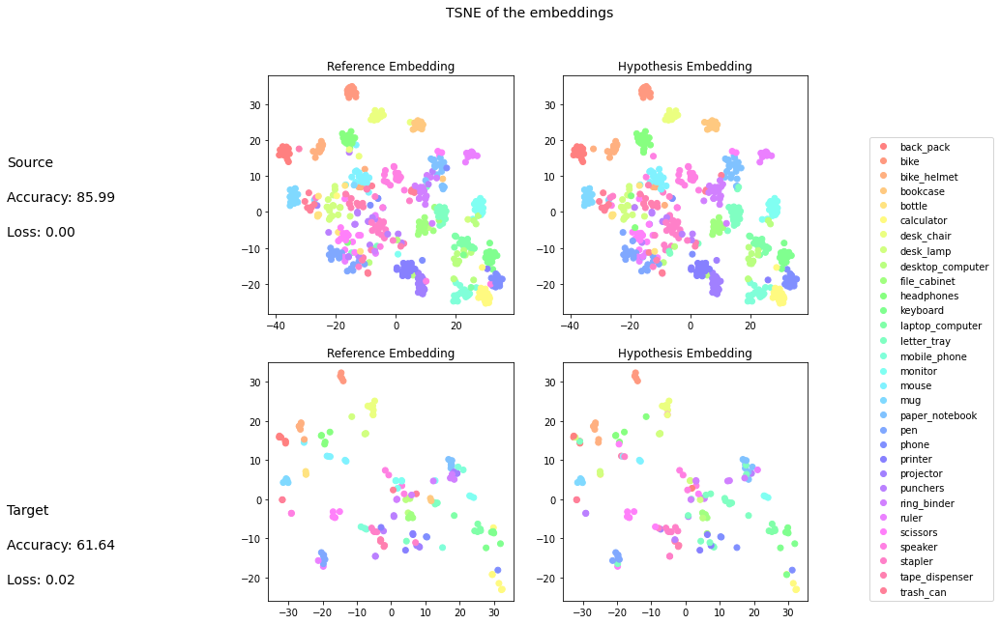

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,0.87,0.93,0.90,14.00
bookcase,0.93,0.88,0.90,16.00
bottle,1.00,0.71,0.83,7.00
calculator,1.00,0.95,0.97,19.00
desk_chair,1.00,0.83,0.91,18.00
desk_lamp,1.00,0.90,0.95,20.00
desktop_computer,0.76,0.68,0.72,19.00
file_cabinet,0.87,0.81,0.84,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

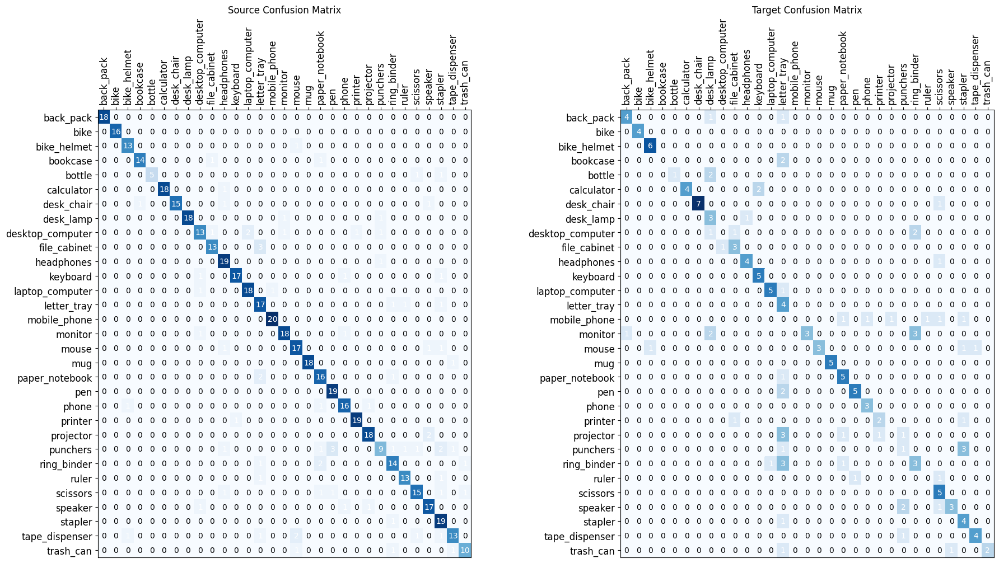

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

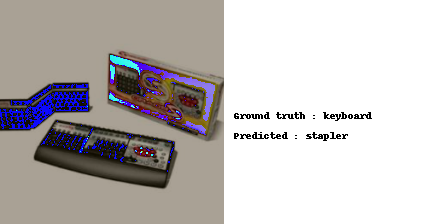

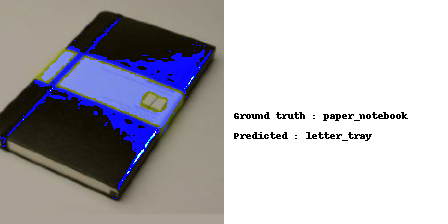

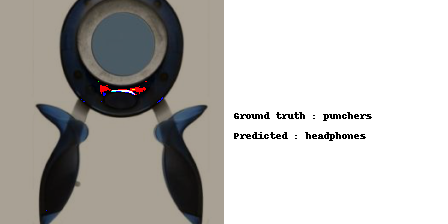

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

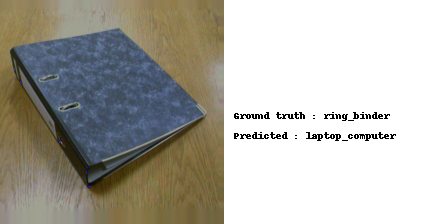

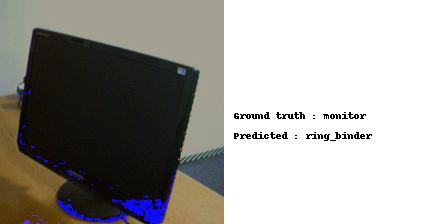

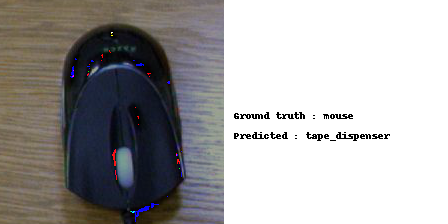

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

## Finetune ResNet18 on W only

Here we train a model of ResNet18 on webcam images only

In [ ]:
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = Classifier(extractor.model[-2][1].bn2.num_features,n_classes=N_CLASSES).to(device)
#optimizer_ex = get_optimizer(extractor,lr=0.00005, wd=0.000001)
#optimizer_cl = get_optimizer(classifier,lr=0.0005, wd=0.000001)

lr = 1e-3
wd = 1e-4
lrd = 0.0002

optimizer_ex = get_SGD_optimizer(extractor,lr=lr, wd=wd, momentum=0.9)
optimizer_cl = get_SGD_optimizer(classifier,lr=lr, wd=wd, momentum=0.9)

ce_cost_function = get_ce_loss()
ex = train_source_only(extractor,
           classifier,
           train_loader_w,
           test_loader_w, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           lr=lr,
           lrd=lrd,
           epochs=50, 
           device=device)

In [ ]:
# save pre trained fine tuned model
torch.save(extractor.state_dict(), resnet18_ex_w_path)
torch.save(classifier.state_dict(), resnet18_cl_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_ex_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_cl_w_path)

### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_ex_w_path))
extractor.to(device)
extractor.eval()
classifier = Classifier(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_cl_w_path))
classifier.to(device)
classifier.eval()

###Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. Ultimately we plot the mean confidence in prediction for each class.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


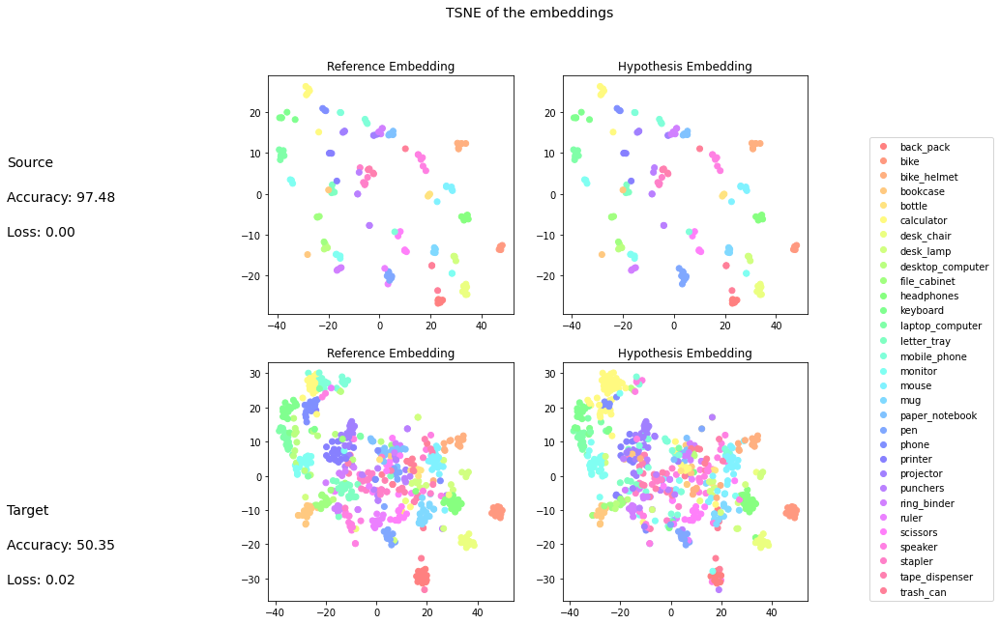

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors  = eval_plot_source_target(extractor,
                                                                                                                             classifier,
                                                                                                                             test_loader_w,
                                                                                                                             test_loader_a,
                                                                                                                             cost_function,
                                                                                                                             class_mapping,
                                                                                                                             layers=['identity'],
                                                                                                                             device='cuda:0')

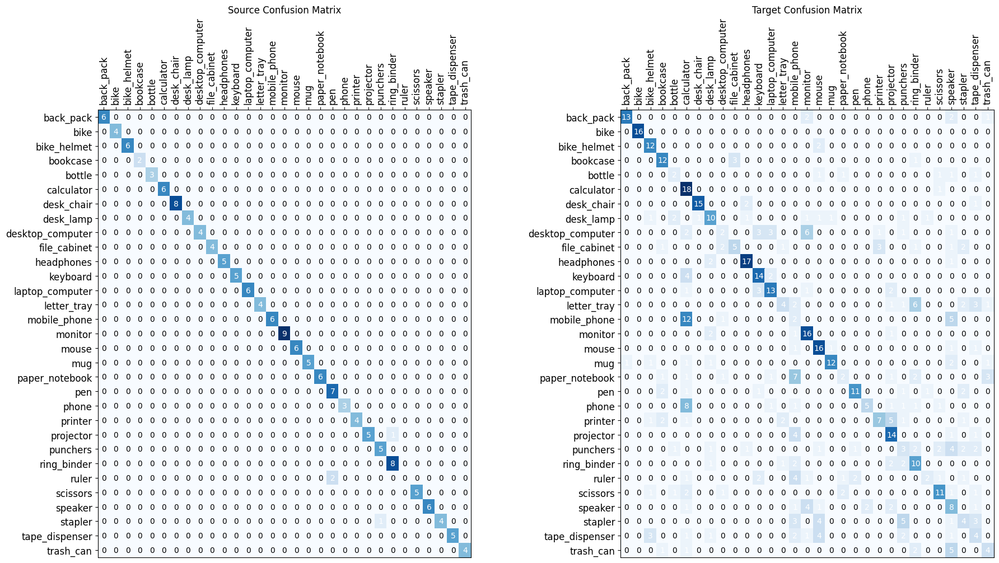

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

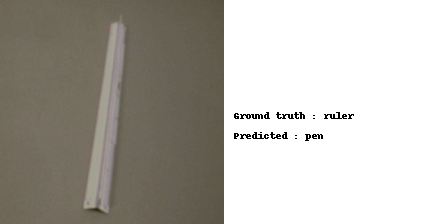

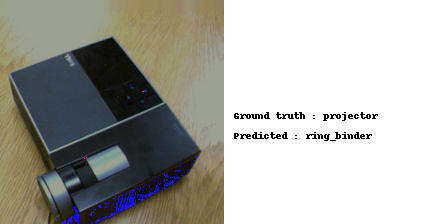

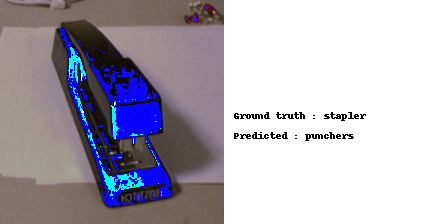

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

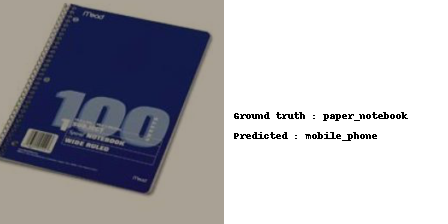

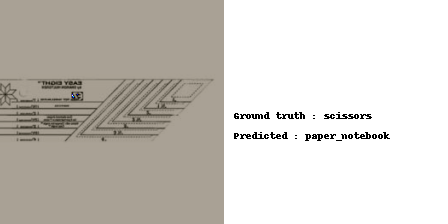

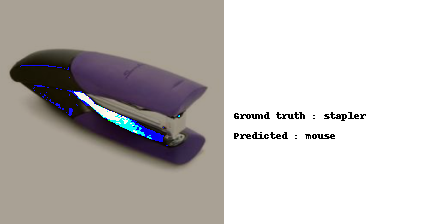

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

# Adversarial based techniques
Here the start from a simple DANN architecture and then upgrade it gradually by testing different possible improvements

## Baseline DANN







#### Introduction of the architecture

In this notebook we implemented a DANN framework (https://arxiv.org/pdf/1505.07818.pdf). It is an adversarial method that gives the samples from both domains (Amazon and Webcam in this example) as input to an encoder (Resnet18). The features extracted are given as input to a classifier that predicts the label of each sample. Simoultaneously, each sample is assigned to a label "0" if it is a source sample or to "1" if it belongs to the target domain. The new labeled samples obtained are discriminated by a discriminator network. Doing so, we jointly optimize the feature extractor to fool the discriminator and aling the features between the two domains.
Here below the architecture of the model


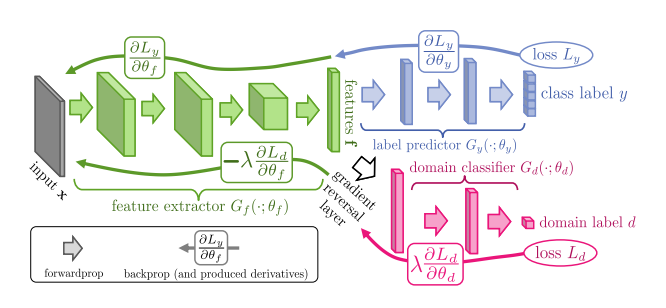

### Models

In [ ]:
"""GradientReversalLayer
Implements the gradient reversal layer
https://pytorch.org/docs/stable/autograd.html#function
"""
class GradientReversalLayer(Function):
    @staticmethod
    def forward(ctx, x, lambda_):
        ctx.lambda_ = lambda_
        return x.clone()

    @staticmethod
    def backward(ctx, grads):
        lambda_ = ctx.lambda_
        lambda_ = grads.new_tensor(lambda_)
        dx = -lambda_ * grads
        return dx, None


class GradientReversal(nn.Module):
    def __init__(self, lambda_=1):
        super(GradientReversal, self).__init__()
        self.lambda_ = lambda_

    def forward(self, x):
        return GradientReversalLayer.apply(x, self.lambda_)

In [ ]:
class ClassPredictor(nn.Module):
    def __init__(self, in_features, n_classes: int, layers: Iterable[str] = None):
        super().__init__()
        self.identity = torch.nn.Identity()
        self.fc1 = nn.Linear(in_features, in_features//8)
        self.fc2 = nn.Linear(in_features//8, n_classes)
        self.model= nn.Sequential(
            self.fc1,
            nn.BatchNorm1d(in_features//8),
            nn.Dropout(),
            nn.LeakyReLU(0.2, inplace=True),
            self.fc2,
        )
        self.layers = layers
        if layers != None:
            self._features = {layer: torch.empty(0) for layer in layers}
            for layer_id in layers:
                layer = dict([*self.named_modules()])[layer_id]
                layer.register_forward_hook(self.save_outputs_hook(layer_id))

    def save_outputs_hook(self, layer_id: str) -> Callable:
        def fn(_, __, output):
            self._features[layer_id] = output
        return fn

    def forward(self, x: Tensor,layers : Iterable[str] = None) -> Tensor or Tuple[Tensor,Iterable[Tensor]]:
        out = x
        out = self.identity(out)
        out = self.model(out)
        if layers == None:
            return  out
        else:
            feature_list = []
            for i in layers:
                if self.layers != None and i in self.layers:
                    feature_list.append(self._features[i])
                if i not in self.layers:
                    raise NameError(f"{i} is not a valid layer or it was not stated in __init__")
            return out, feature_list

In [ ]:
class DomainClassifier(nn.Module):
    def __init__(self, in_features, n_classes):
        super(DomainClassifier, self).__init__()

        self.fc1 = nn.Linear(in_features, in_features//8)
        self.fc2 = nn.Linear(in_features//8, n_classes)
        self.fc3 = nn.Linear(n_classes,1)

        self.model = nn.Sequential(
            GradientReversal(),
            self.fc1,
            nn.LeakyReLU(0.2, inplace=True),
            self.fc2,
            nn.LeakyReLU(0.2, inplace=True),
            self.fc3,
            nn.Sigmoid()
        )

    def forward(self, x):
        out = self.model(x)
        return out

### Training step

In [ ]:
def training_step_dann(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    epoch: int,
    lr: float,
    lrd,
    curr_iter: int,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):
    
    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    inputs = torch.cat([inputs_source, inputs_target]).to(device)

    features = extractor(inputs)

    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    pred_domain = discriminator(features)
    pred_class = classifier(features[:inputs_source.shape[0]])

    loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
    loss_class = ce_loss(pred_class, targets)

    loss_total = loss_domain + loss_class

    loss_total.backward()
    optimizer.step()
    optimizer.zero_grad()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      optimizerF = exp_lr_scheduler(optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, curr_iter

In [ ]:
def train_dann(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lrd,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:

    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()

    curr_iter = 0
    
    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):

      train_loss, train_accuracy, curr_iter = training_step_dann(extractor, classifier, discriminator, optimizer, ce_loss, bce_loss, 
                                                 source_train_loader, target_train_loader, epoch, lr, lrd, curr_iter) 

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator

### DANN from a -> w

In [ ]:
#'Training loss': '0.00898', 'Training accuracy': '98.18020', 'Test loss': '0.01849', 'Test accuracy': '64.77987

extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES) 

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002

extractor, classifier, discriminator = train_dann(extractor, classifier, discriminator, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lrd) 

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. 

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


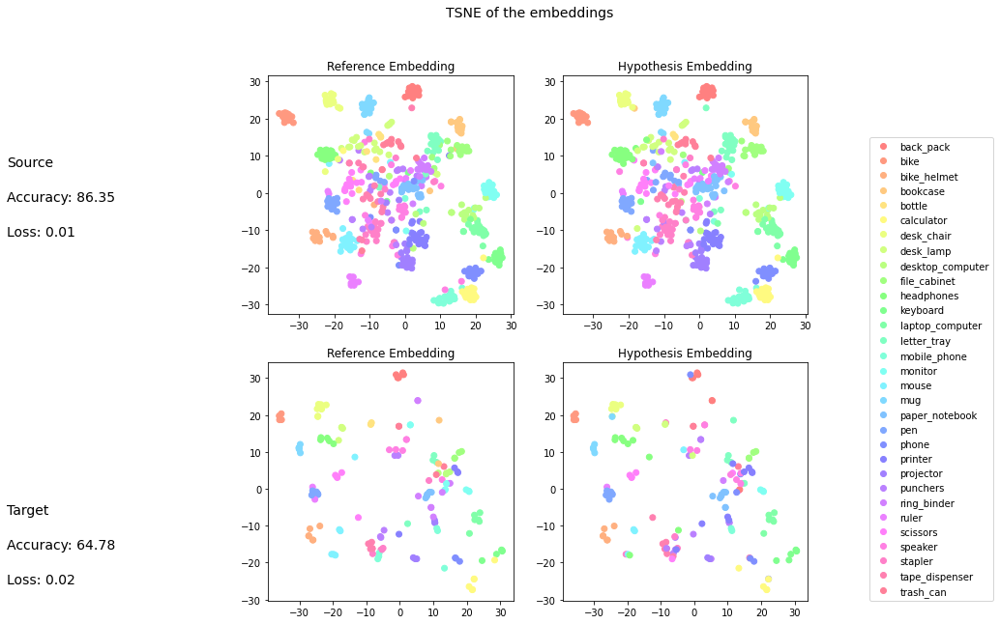

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.86,0.92,14.00
bookcase,0.93,0.88,0.90,16.00
bottle,1.00,0.43,0.60,7.00
calculator,1.00,0.95,0.97,19.00
desk_chair,1.00,0.83,0.91,18.00
desk_lamp,0.80,0.80,0.80,20.00
desktop_computer,0.82,0.74,0.78,19.00
file_cabinet,0.78,0.88,0.82,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

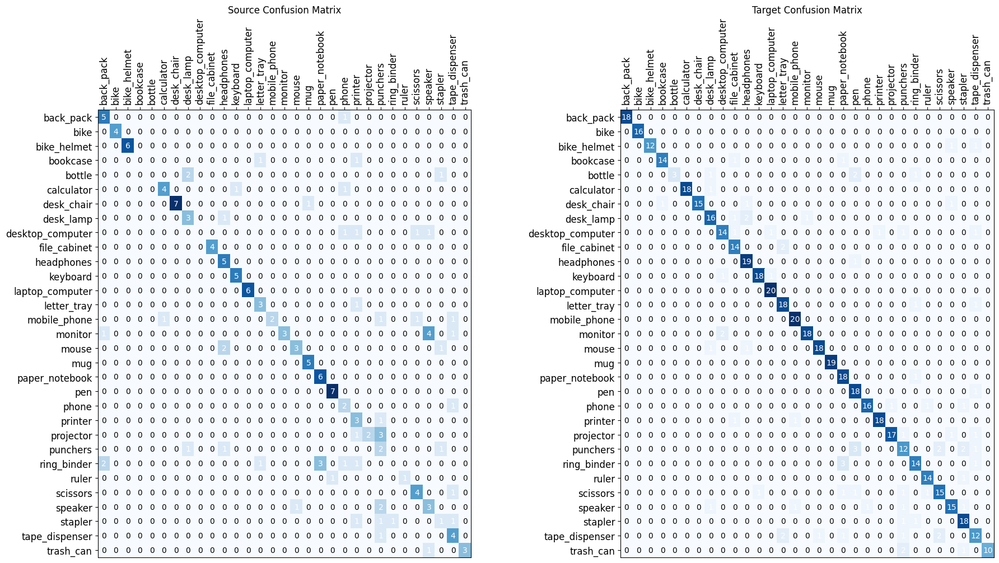

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

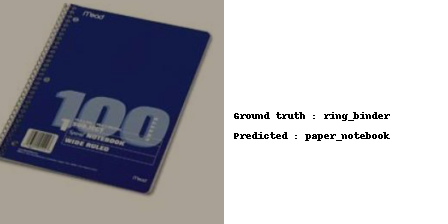

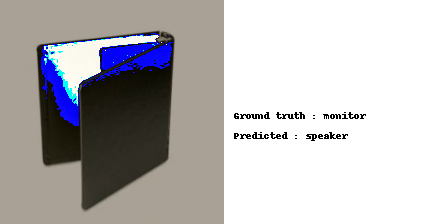

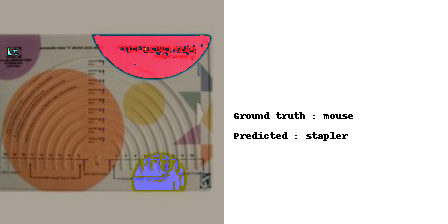

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

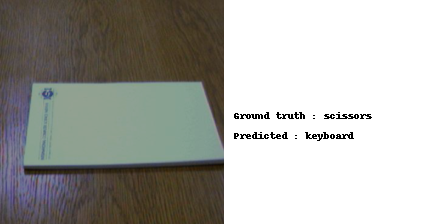

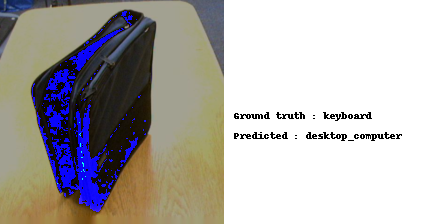

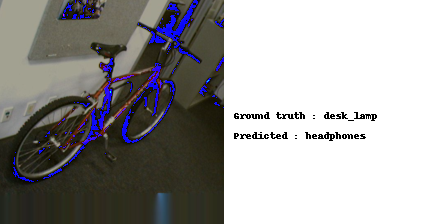

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN from w -> a

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES) 

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002

extractor, classifier, discriminator = train_dann(extractor, classifier, discriminator, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lrd) 

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_dann_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. 

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


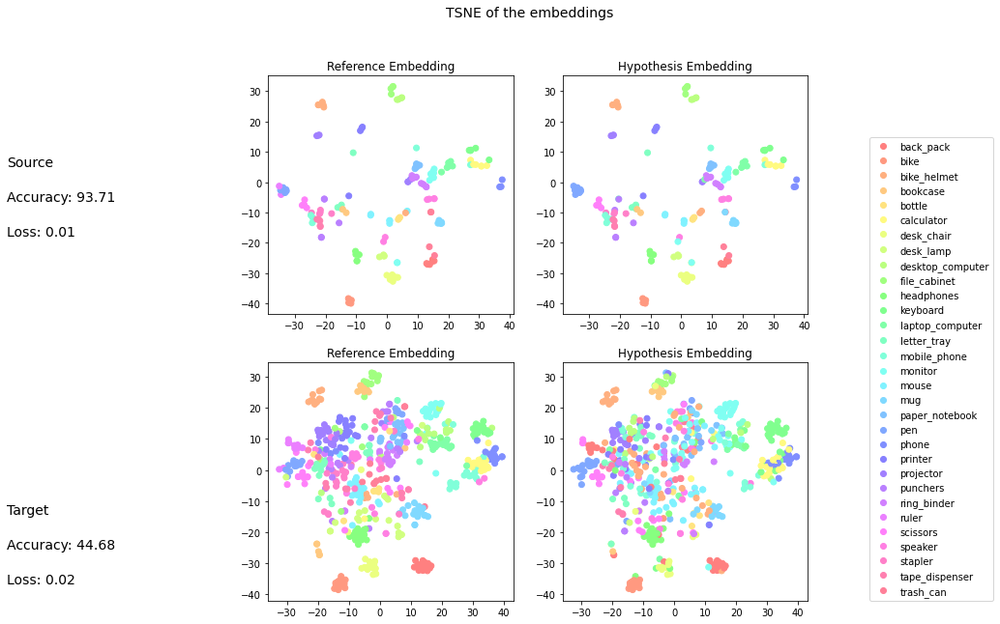

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,0.86,1.00,0.92,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,0.89,1.00,0.94,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

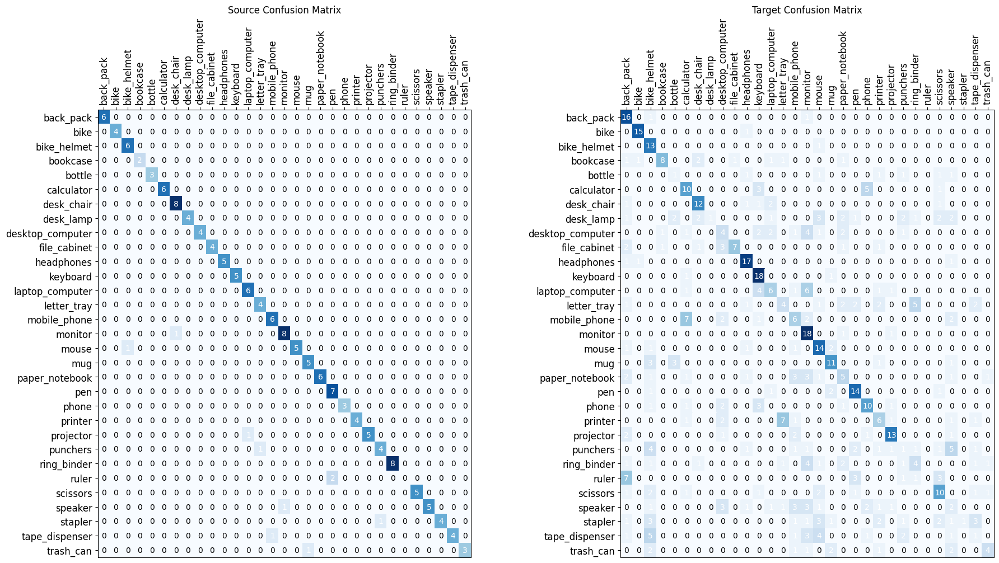

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

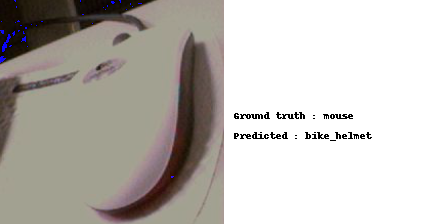

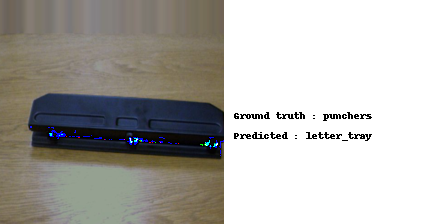

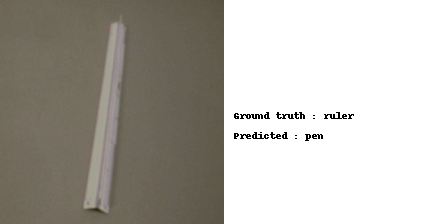

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

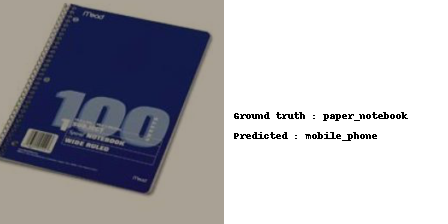

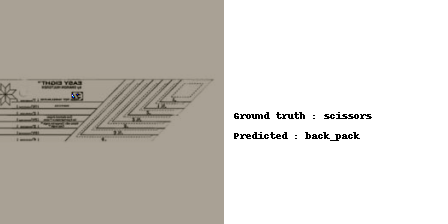

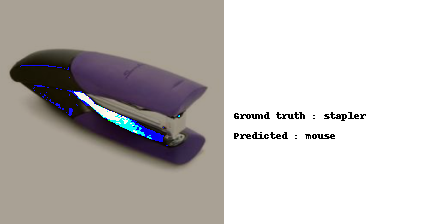

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + Discrepancy Losses

Here we try to combine DANN and discrepancy losses like MMD and CORAL


#### Experiments

We performed some experiments to align better the features and improve the accuracy of the final model.
We focused on adding a loss function at the output of the encoder to optimize its weights better.
First, we chose a Maximum Mean Discrepancy loss. It is a kernel based statistical test used to determine whether given two distribution are the same. The formula is reported below:


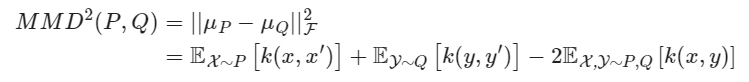

Another loss we tried was Coral loss. It tries to minimize the distance between the second-order statistics (covariances) of the source and target features.

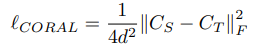


### Loss functions

In [ ]:
# https://github.com/DenisDsh/PyTorch-Deep-CORAL/blob/master/coral.py
class CoralLoss(nn.Module):
    def __init__(self):
        super(CoralLoss,self).__init__()
    def forward(self,
                source: Tensor, 
                target: Tensor ,
                ) -> Tensor:
        d = source.size(1)  # dim vector
        source_c = self.compute_covariance(source)
        target_c = self.compute_covariance(target)
        loss = torch.sum(torch.mul((source_c - target_c), (source_c - target_c)))
        loss = loss / (4 * d * d)
        return loss

    def compute_covariance(self, input_data) -> Tensor:
        """
        Compute Covariance matrix of the input data
        """
        n = input_data.size(0)  # batch_size
        id_row = torch.ones(n).resize(1, n).to(device=device)
        sum_column = torch.mm(id_row, input_data)
        mean_column = torch.div(sum_column, n) 
        term_mul_2 = torch.mm(mean_column.t(), mean_column)
        d_t_d = torch.mm(input_data.t(), input_data)
        c = torch.add(d_t_d, (-1 * term_mul_2)) * 1 / (n - 1)
        return c



In [ ]:
def get_coral_loss():
    return CoralLoss()

In [ ]:
# Maximum Mean Discrepancy Loss

class MMDLoss(nn.Module):
    def __init__(self,):
        super(MMDLoss, self).__init__()

    def forward(self,
                source: Tensor, 
                target: Tensor ,
                kernel='rbf',
                ) -> Tensor:
                
        """Emprical maximum mean discrepancy. The lower the result
        the more evidence that distributions are the same.
        Args:
            x: first sample, distribution P
            y: second sample, distribution Q
            kernel: kernel type such as "multiscale" or "rbf"
        """
        xx, yy, zz = torch.mm(source, source.t()), torch.mm(target, target.t()), torch.mm(source, target.t())
        rx = (xx.diag().unsqueeze(0).expand_as(xx))
        ry = (yy.diag().unsqueeze(0).expand_as(yy))
        dxx = rx.t() + rx - 2. * xx # Used for A in (1)
        #print(dxx.shape)
        #print('-----')
        dyy = ry.t() + ry - 2. * yy # Used for B in (1)
        #print(dyy.shape)
        #print('-----')
        dxy = rx.t() + ry - 2. * zz # Used for C in (1)
        #print(dxy.shape)
        #print('-----')
        XX, YY, XY = (torch.zeros(xx.shape).to(device),
                    torch.zeros(xx.shape).to(device),
                    torch.zeros(xx.shape).to(device))
        if kernel == "multiscale":
            bandwidth_range = [0.2, 0.5, 0.9, 1.3]
            for a in bandwidth_range:
                XX += a**2 * (a**2 + dxx)**-1
                YY += a**2 * (a**2 + dyy)**-1
                XY += a**2 * (a**2 + dxy)**-1
        if kernel == "rbf":
            bandwidth_range = [10, 15, 20, 50]
            for a in bandwidth_range:
                XX += torch.exp(-0.5*dxx/a)
                YY += torch.exp(-0.5*dyy/a)
                XY += torch.exp(-0.5*dxy/a)
        return torch.mean(XX + YY - 2. * XY)


In [ ]:
def get_mmd_loss():
    return MMDLoss()

### Train step

In [ ]:
def training_step_dann_align(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    align_cost_function:nn.Module,
    align_weight:float,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  #for a, (batch_idx, (inputs_source, targets)) in zip(pbar, enumerate(source_data_loader)):
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):
    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    inputs = torch.cat([inputs_source, inputs_target]).to(device)

    # extract source features and target features separately
    features_source = extractor(inputs_source)
    features_target = extractor(inputs_target)    


    # total features for discriminator network
    features = torch.cat((features_source, features_target), 0)
    
    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    pred_domain = discriminator(features)
    pred_class = classifier(features[:inputs_source.shape[0]])

    
    preds = discriminator(features_target).squeeze()

    
    
    # losses and optimization
    min_batch = min(features_source.shape[0],features_target.shape[0])
    loss_for_features = align_cost_function(features_source[:min_batch], features_target[:min_batch])
    loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
    loss_class = ce_loss(pred_class, targets)
    
    loss_total = loss_domain + loss_class + align_weight*loss_for_features

    loss_total.backward()
    optimizer.step()
    optimizer.zero_grad()

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, 

In [ ]:
def train_dann_align(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    align_cost_function : nn.Module,
    align_weight:float,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:
  
    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    
    pbar = tqdm(range(epochs),position=0, leave=True)
    for p,e in zip(pbar,range(epochs)):

      train_loss, train_accuracy = training_step_dann_align(extractor, classifier, discriminator, optimizer, ce_loss, bce_loss, align_cost_function=align_cost_function, align_weight=align_weight,
                                                 source_data_loader=source_train_loader,target_data_loader= target_train_loader) 

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator

### DANN with MMD loss

#### DANN + MMD from a->w



In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

optim = get_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()),
                                  lr=1e-4, wd=1e-6)
mmd_loss = get_mmd_loss()
extractor, classifier, discriminator = train_dann_align(extractor, classifier, discriminator, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w,align_cost_function=mmd_loss,align_weight=1)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_mmd_ex_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_mmd_cl_a_w_path)

In [ ]:
!cp $resnet18_dann_mmd_ex_a_w_path $models_basepath
!cp $resnet18_dann_mmd_cl_a_w_path $models_basepath

##### Load

In [ ]:
!cp $models_basepath$resnet18_dann_mmd_ex_a_w_path  ./
!cp $models_basepath$resnet18_dann_mmd_cl_a_w_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_dann_mmd_ex_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_dann_mmd_cl_a_w_path))
classifier.to(device)
classifier.eval()

##### Test

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


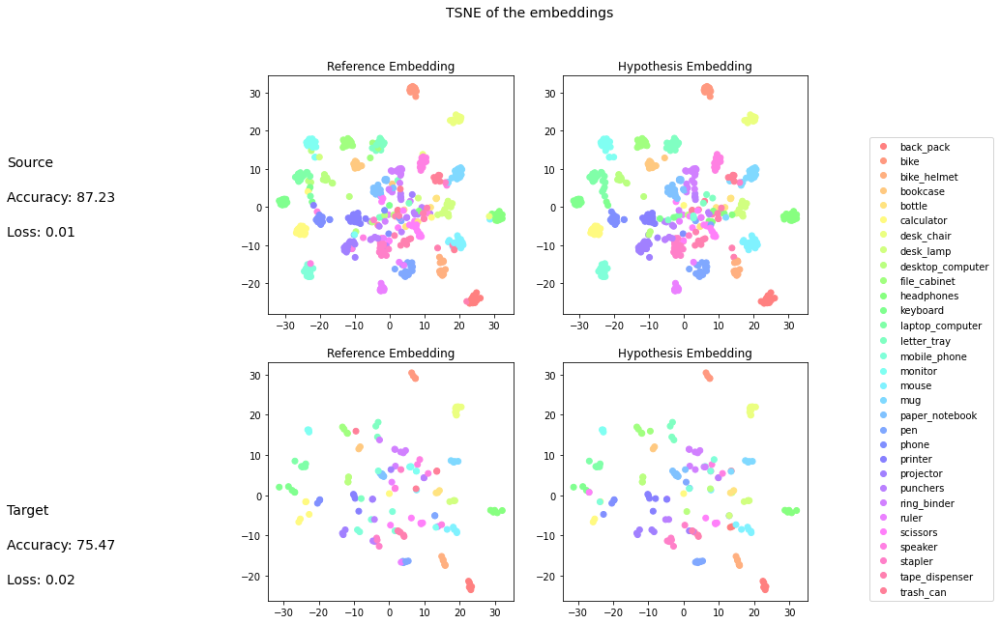

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,0.95,1.00,0.97,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.93,0.96,14.00
bookcase,0.93,0.88,0.90,16.00
bottle,0.83,0.71,0.77,7.00
calculator,0.94,0.89,0.92,19.00
desk_chair,1.00,0.89,0.94,18.00
desk_lamp,1.00,0.85,0.92,20.00
desktop_computer,0.93,0.68,0.79,19.00
file_cabinet,0.93,0.81,0.87,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

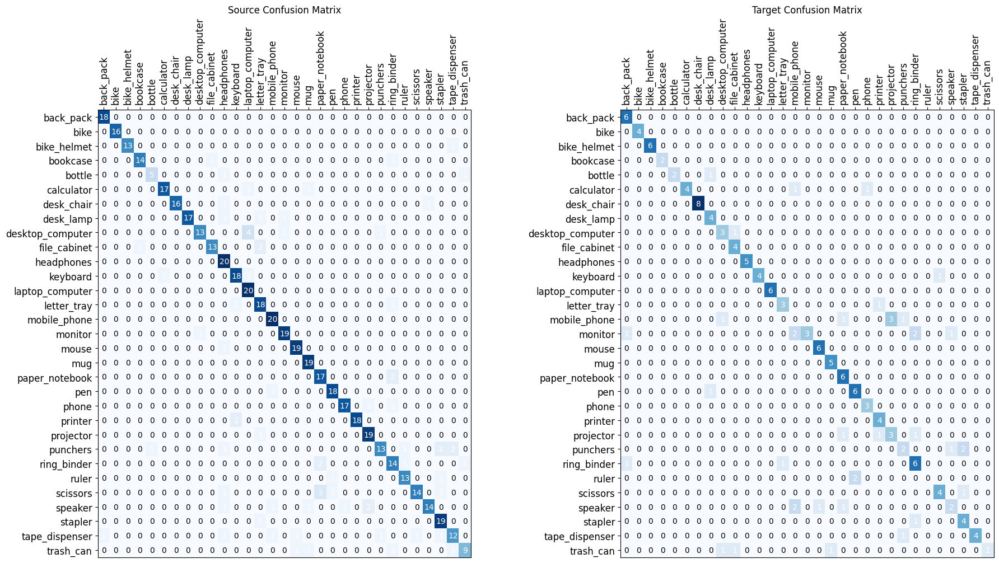

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

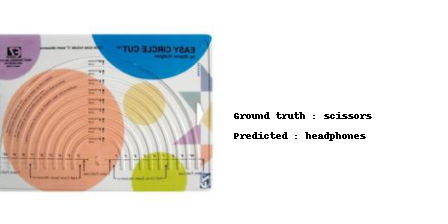

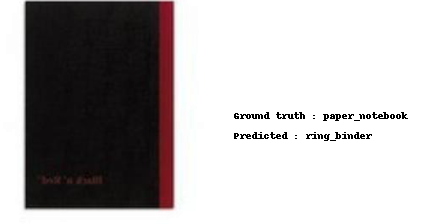

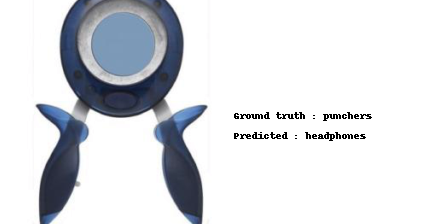

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

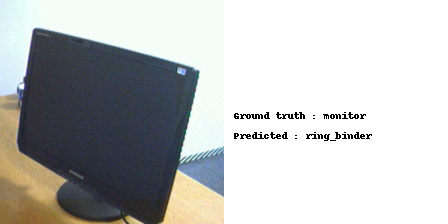

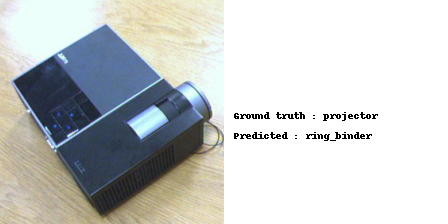

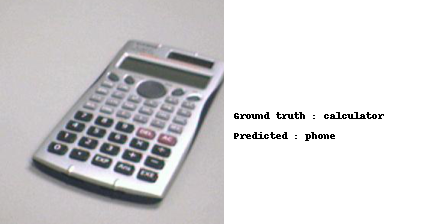

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

#### DANN + MMD from a->w



In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

optim = get_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()),
                                  lr=1e-4, wd=1e-6)
mmd_loss = get_mmd_loss()
extractor, classifier, discriminator = train_dann_align(extractor, classifier, discriminator, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a,align_cost_function=mmd_loss,align_weight=1)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_mmd_ex_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_mmd_cl_w_a_path)

In [ ]:
!cp $resnet18_dann_mmd_ex_w_a_path $models_basepath
!cp $resnet18_dann_mmd_cl_w_a_path $models_basepath

##### Load

In [ ]:
!cp $models_basepath$resnet18_dann_mmd_ex_w_a_path  ./
!cp $models_basepath$resnet18_dann_mmd_cl_w_a_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_dann_mmd_ex_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_dann_mmd_cl_w_a_path))
classifier.to(device)
classifier.eval()

##### Test

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


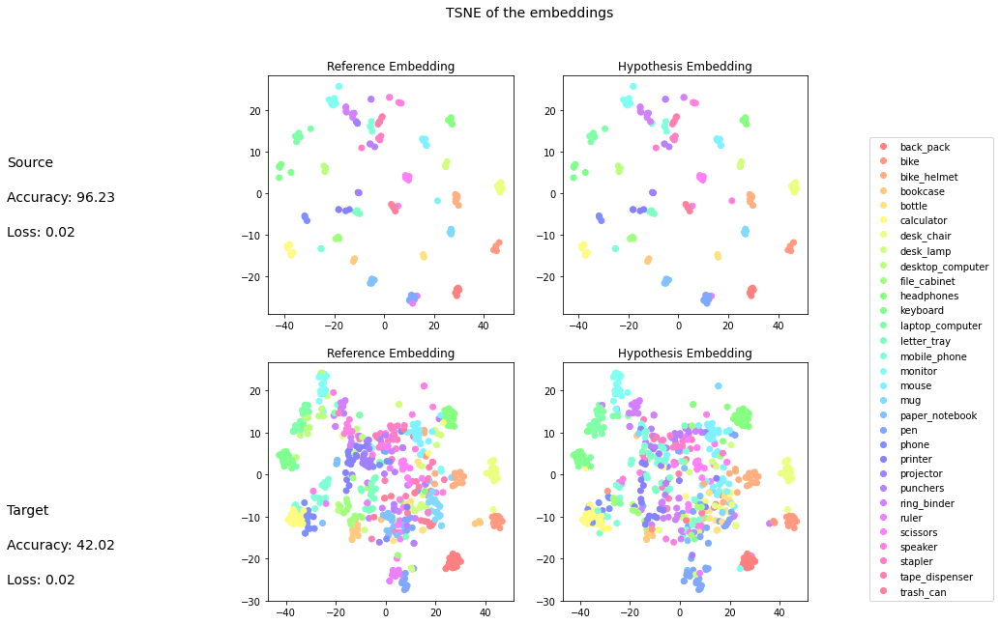

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

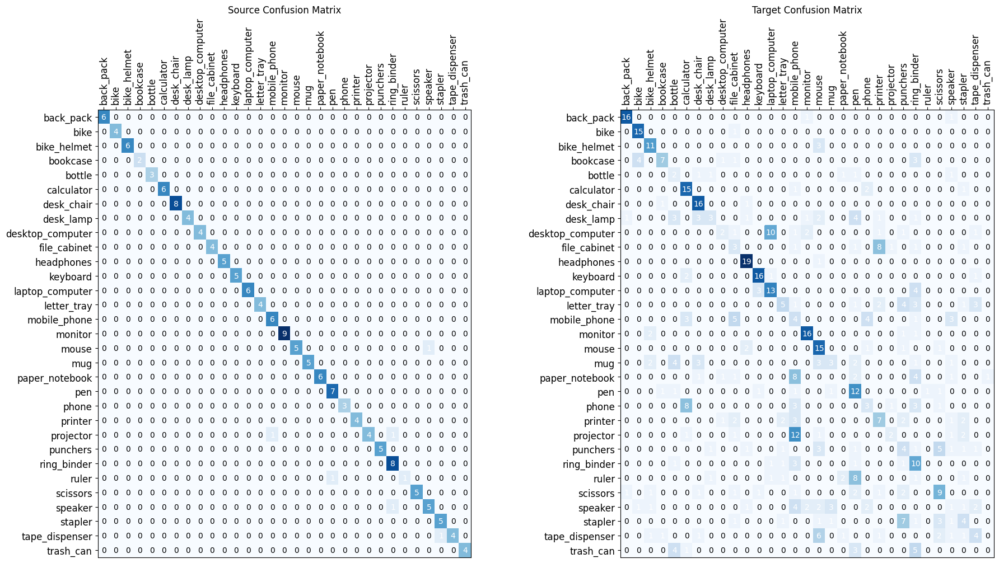

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

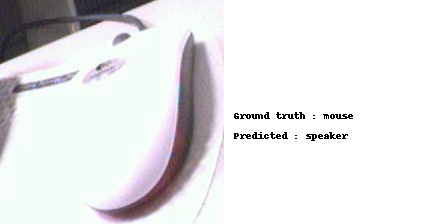

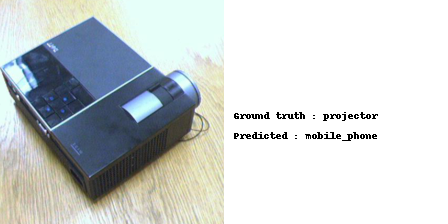

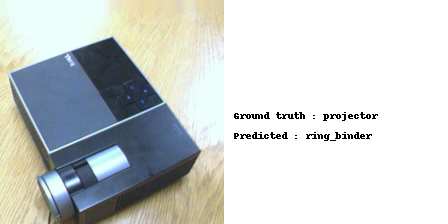

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

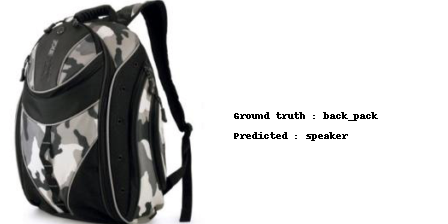

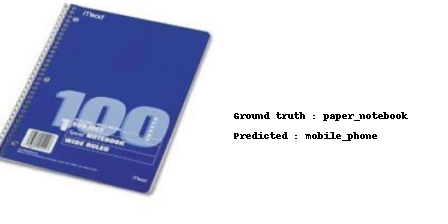

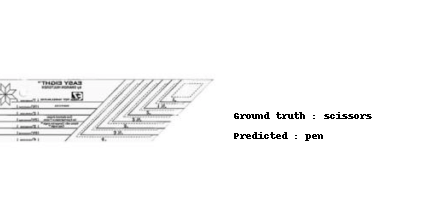

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

### DANN with Coral Loss

In [ ]:
def training_step_dann_align(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    align_cost_function:nn.Module,
    align_weight:float,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  #for a, (batch_idx, (inputs_source, targets)) in zip(pbar, enumerate(source_data_loader)):
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):
    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    inputs = torch.cat([inputs_source, inputs_target]).to(device)

    # extract source features and target features separately
    features_source = extractor(inputs_source)
    features_target = extractor(inputs_target)    


    # total features for discriminator network
    features = torch.cat((features_source, features_target), 0)
    
    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    pred_domain = discriminator(features)
    pred_class = classifier(features[:inputs_source.shape[0]])

    
    preds = discriminator(features_target).squeeze()

    
    
    # losses and optimization
    loss_for_features = align_cost_function(features_source, features_target)
    loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
    loss_class = ce_loss(pred_class, targets)
    
    loss_total = loss_domain + loss_class + align_weight*loss_for_features

    loss_total.backward()
    optimizer.step()
    optimizer.zero_grad()

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, 

In [ ]:
def train_dann_align(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    align_cost_function : nn.Module,
    align_weight:float,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:
  
    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    
    pbar = tqdm(range(epochs),position=0, leave=True)
    for p,e in zip(pbar,range(epochs)):

      train_loss, train_accuracy = training_step_dann_align(extractor, classifier, discriminator, optimizer, ce_loss, bce_loss, align_cost_function=align_cost_function, align_weight=align_weight,
                                                 source_data_loader=source_train_loader,target_data_loader= target_train_loader) 

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator

#### DANN + CORAL a->w



In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

optim = get_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()),
                                  lr=1e-4, wd=1e-6)
coral_loss = get_coral_loss()
extractor, classifier, discriminator = train_dann_align(extractor, classifier, discriminator, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w,align_cost_function=coral_loss,align_weight=1)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_coral_ex_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_coral_cl_a_w_path)

In [ ]:
!cp $resnet18_dann_coral_ex_a_w_path $models_basepath
!cp $resnet18_dann_coral_cl_a_w_path $models_basepath

##### Load

In [ ]:
!cp $models_basepath$resnet18_dann_coral_ex_a_w_path  ./
!cp $models_basepath$resnet18_dann_coral_cl_a_w_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_dann_coral_ex_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_dann_coral_cl_a_w_path))
classifier.to(device)
classifier.eval()

##### Test

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


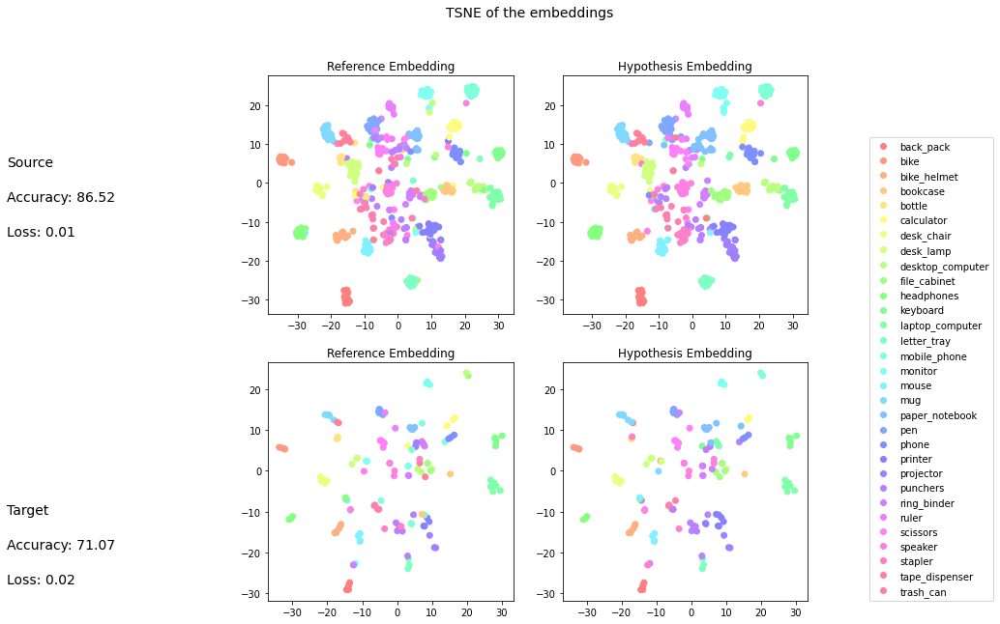

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,0.95,1.00,0.97,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.93,0.96,14.00
bookcase,0.88,0.88,0.88,16.00
bottle,0.80,0.57,0.67,7.00
calculator,0.95,0.95,0.95,19.00
desk_chair,0.94,0.83,0.88,18.00
desk_lamp,1.00,0.90,0.95,20.00
desktop_computer,0.93,0.74,0.82,19.00
file_cabinet,0.72,0.81,0.76,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

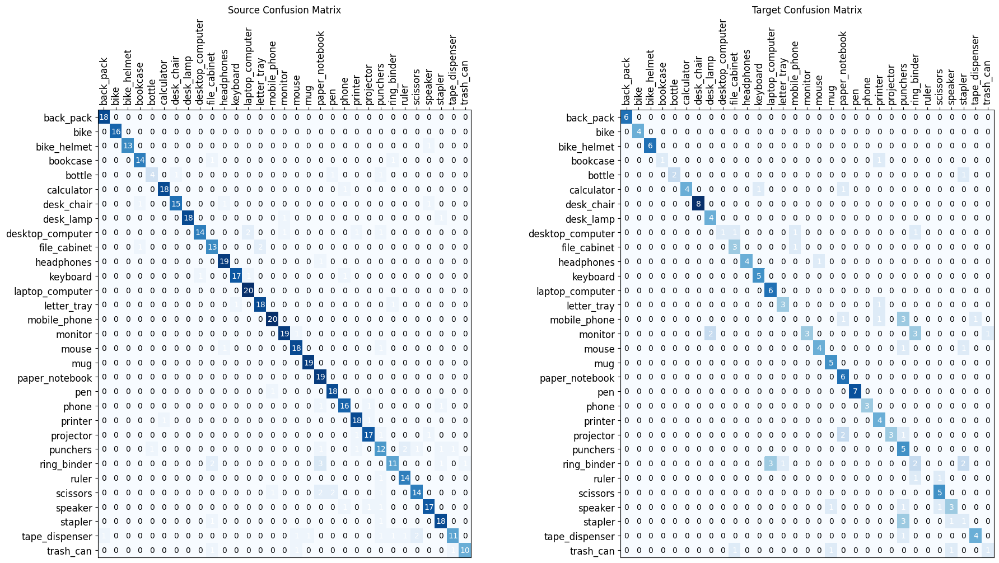

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

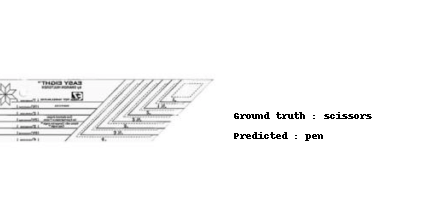

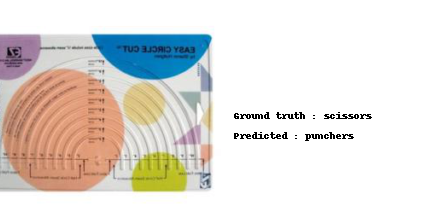

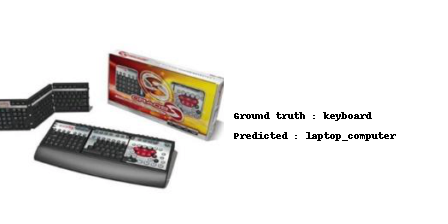

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

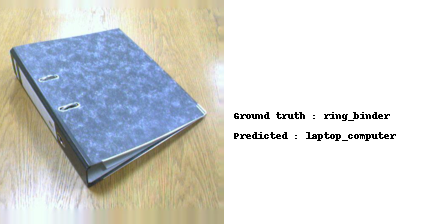

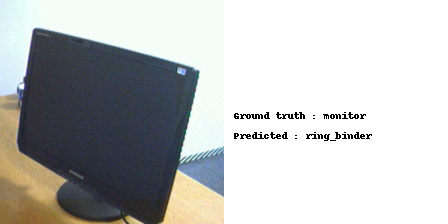

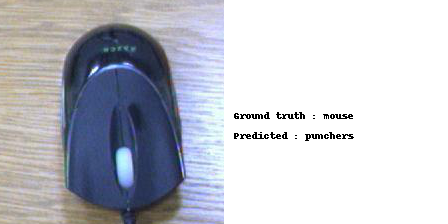

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

#### DANN + CORAL w->a



In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

optim = get_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()),
                                  lr=1e-4, wd=1e-6)
coral_loss = get_coral_loss()
extractor, classifier, discriminator = train_dann_align(extractor, classifier, discriminator, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a,align_cost_function=coral_loss,align_weight=1)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_coral_ex_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_coral_cl_w_a_path)

In [ ]:
!cp $resnet18_dann_coral_ex_w_a_path $models_basepath
!cp $resnet18_dann_coral_cl_w_a_path $models_basepath

##### Load

In [ ]:
!cp $models_basepath$resnet18_dann_coral_ex_w_a_path  ./
!cp $models_basepath$resnet18_dann_coral_cl_w_a_path  ./

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(resnet18_dann_coral_ex_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_dann_coral_cl_w_a_path))
classifier.to(device)
classifier.eval()

##### Test

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


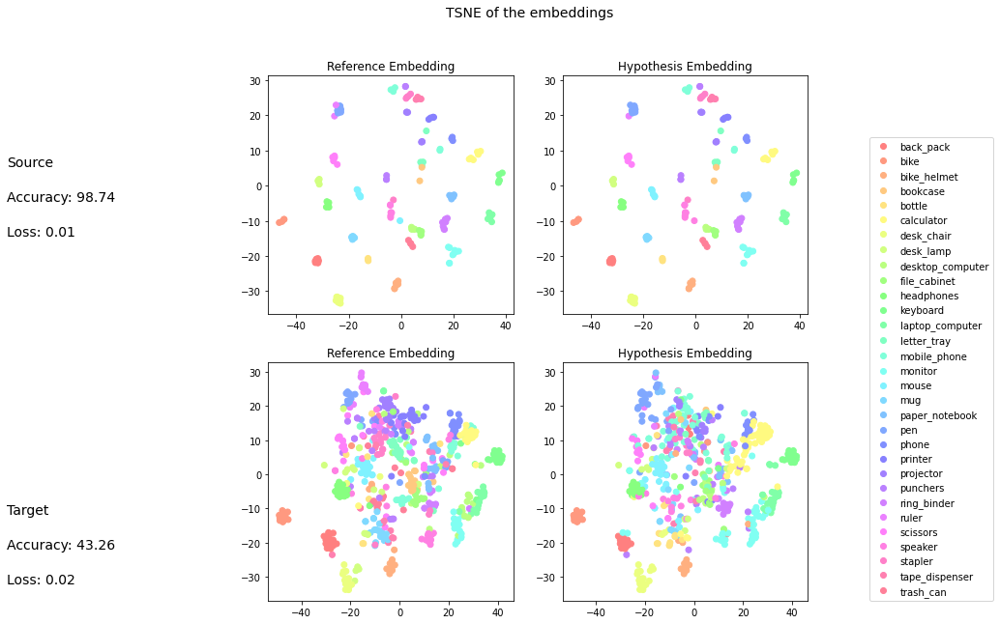

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

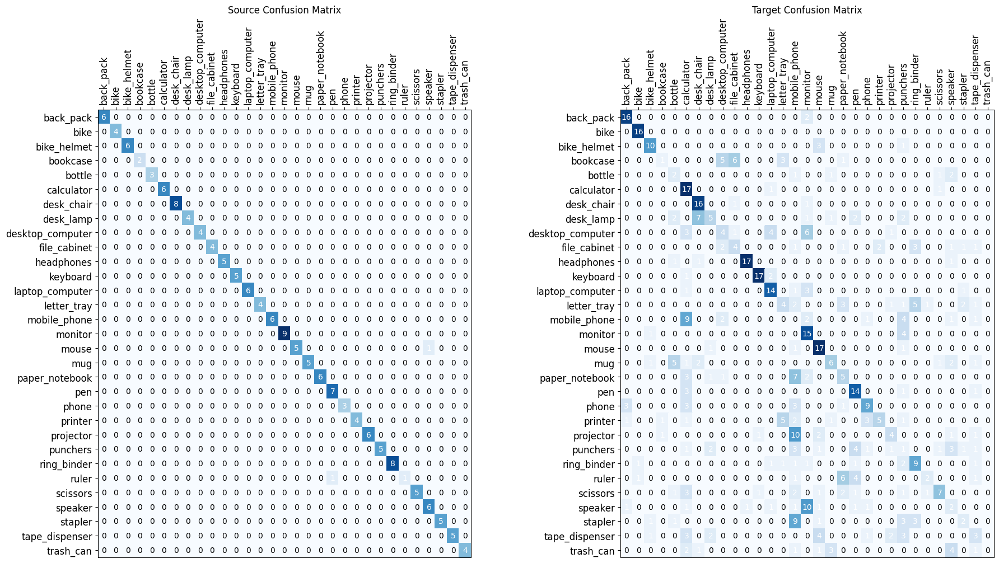

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

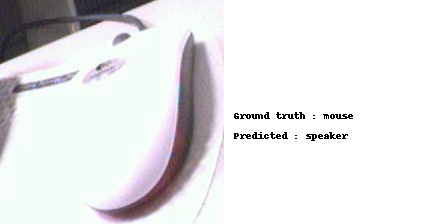

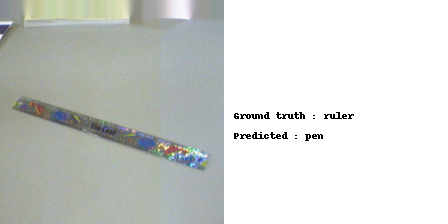

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

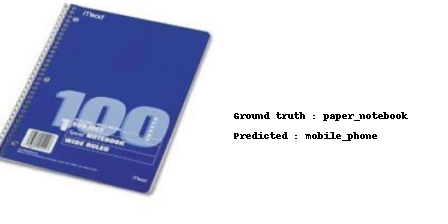

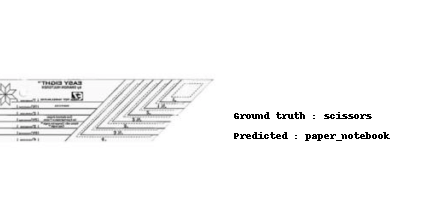

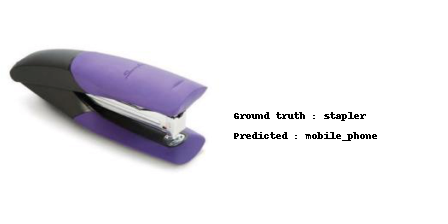

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

### Results and Conclusions





|Model                  |A->W  A |A->W  W  |Gain   |W->A  W |W->A  W |Gain     |
|-----------------------|--------|---------|-------|--------|--------|---------|
| DANN                  | 86.35  | 64.78   | -     | 93.71  | 44.68  | -       |
| DANN + MMD           | 83.16  | 75.47   | **+10.69** | 95.60  | 42.02 | -2.66   |
| DANN + Coral           | 87.06  | 71.07   | +6.29 | 94.34  | 43.25  | -1.43   |






Kullback-Leibler divergence and Relationship Preserving losses were tested, but they decreased the overall accuracies on both directions
The method proposed shows some improvements in the Amazon-Webcam direction. The MMD loss is slightly better than the Coral loss, meaning that a prealignment of the feastures before classification and discrimination is a promising path to improve the accuracy.

In the other direction, Webcam -> Amazon, the model tends to decrease the accuracy with both losses. This might due to the fact that the datasets are unbalanced in the two domains. More epochs of training or data augmentation techniques could improve the performances.

## DANN+DALN

### Train step

In [ ]:
def training_step_dann_daln(
    extractor: nn.Module,
    classifier: nn.Module,
    optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    discrepancy,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    trade_off_lambda: float,
    epoch: int,
    lr: float,
    lrd,
    curr_iter: int,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()

  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):
    
    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    inputs = torch.cat([inputs_source, inputs_target]).to(device)

    features = extractor(inputs)

    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    pred_class = classifier(features[:inputs_source.shape[0]])

    loss_class = ce_loss(pred_class, targets)
    
    # compute nuclear-norm wasserstein discrepancy between domains
    # for adversarial classifier, minimize negative nwd is equal to maximize nwd
    discrepancy_loss = -discrepancy(features)
    transfer_loss = discrepancy_loss * trade_off_lambda # multiply the lambda to trade off the loss term
    
    loss_total = transfer_loss + loss_class

    loss_total.backward()
    optimizer.step()
    optimizer.zero_grad()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      optimizerF = exp_lr_scheduler(optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, curr_iter

In [ ]:
def train_dann_daln(
    extractor: nn.Module,
    classifier: nn.Module,
    optimizer: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    trade_off_lambda: float,
    lr: float,
    lrd,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:
  
    extractor.to(device)
    classifier.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    discrepancy = NuclearWassersteinDiscrepancy(classifier)

    curr_iter = 0
    
    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, curr_iter = training_step_dann_daln(extractor, classifier, optimizer, ce_loss, bce_loss, discrepancy, 
                                                 source_train_loader, target_train_loader, trade_off_lambda, epoch, lr, lrd, curr_iter) 

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier

### DANN + DALN from a -> w

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002

trade_off_lambda = 0.8

extractor, classifier = train_dann_daln(extractor, classifier, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w, trade_off_lambda, lr, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_daln_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_daln_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_daln_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_daln_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_daln_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_daln_classifier_a_w_path))
classifier.to(device)
classifier.eval()

#### Test
Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (avgpool). We also plot the confusion matrixes and the images that the model classifies incorrectly. 

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


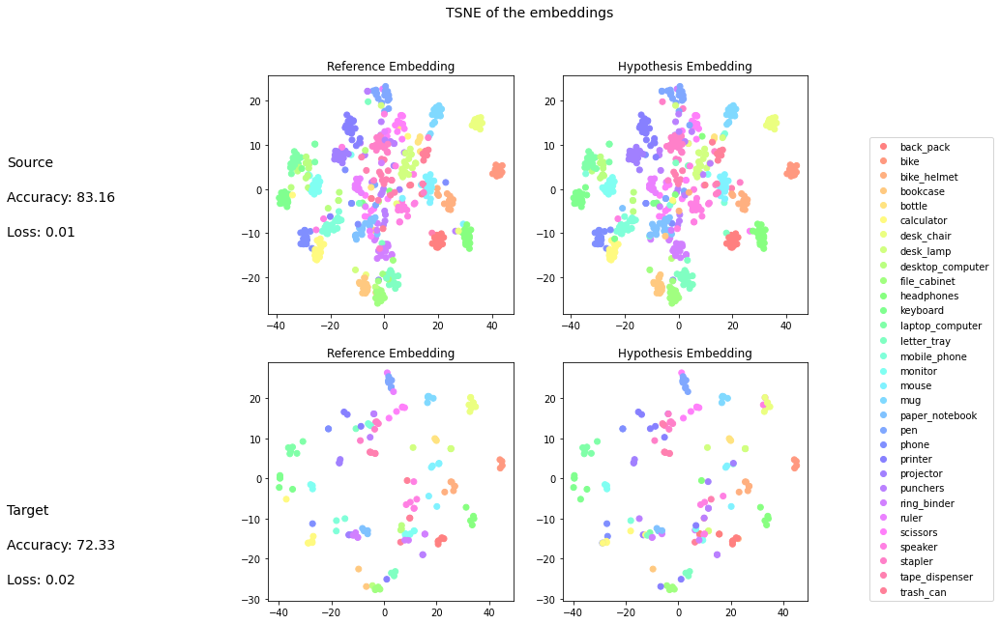

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,0.87,0.93,0.90,14.00
bookcase,0.88,0.88,0.88,16.00
bottle,1.00,0.43,0.60,7.00
calculator,0.94,0.84,0.89,19.00
desk_chair,0.94,0.83,0.88,18.00
desk_lamp,0.89,0.85,0.87,20.00
desktop_computer,0.76,0.68,0.72,19.00
file_cabinet,0.81,0.81,0.81,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

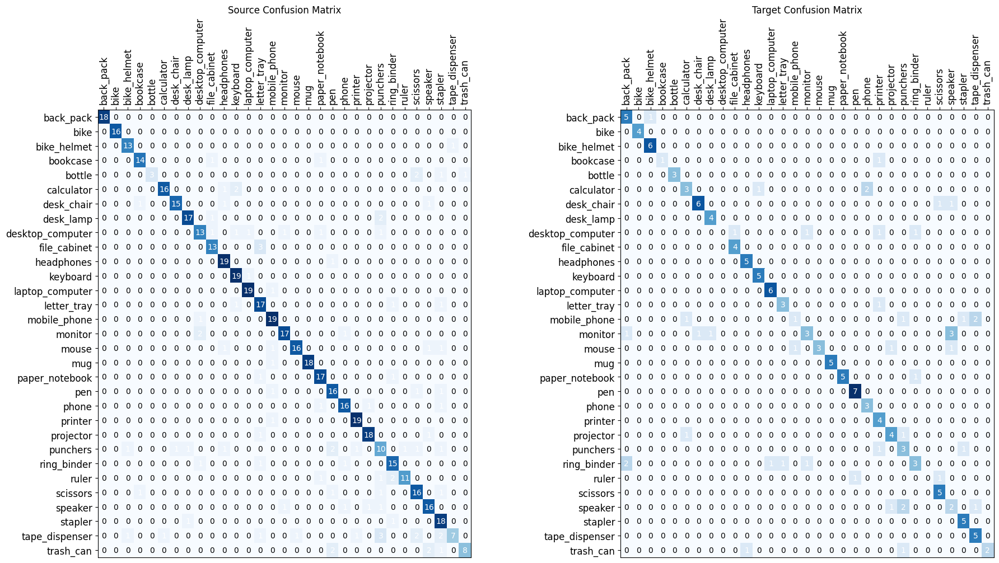

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

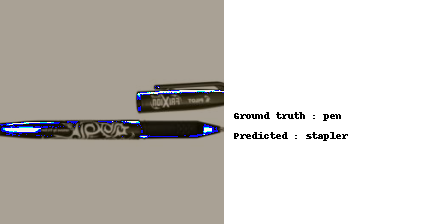

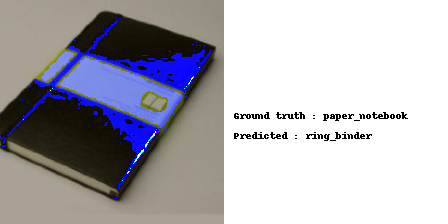

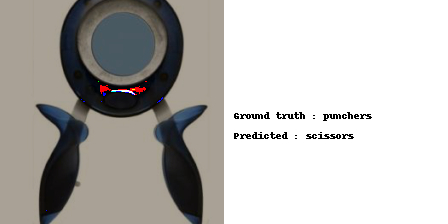

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

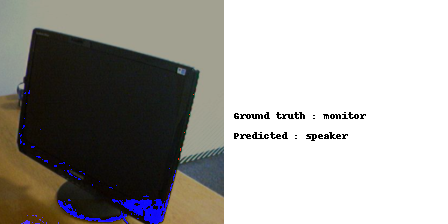

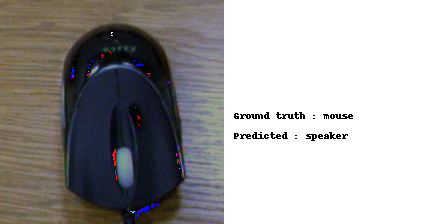

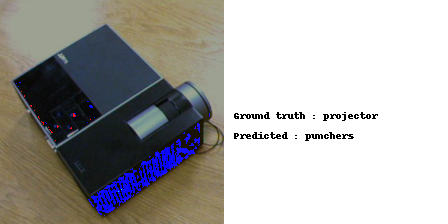

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + DALN from w -> a

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002

trade_off_lambda = 0.8

extractor, classifier = train_dann_daln(extractor, classifier, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a, trade_off_lambda, lr, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_daln_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_daln_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_daln_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_daln_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_daln_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(resnet18_dann_daln_classifier_w_a_path))
classifier.to(device)
classifier.eval()

#### Test
Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (avgpool). We also plot the confusion matrixes and the images that the model classifies incorrectly. 

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


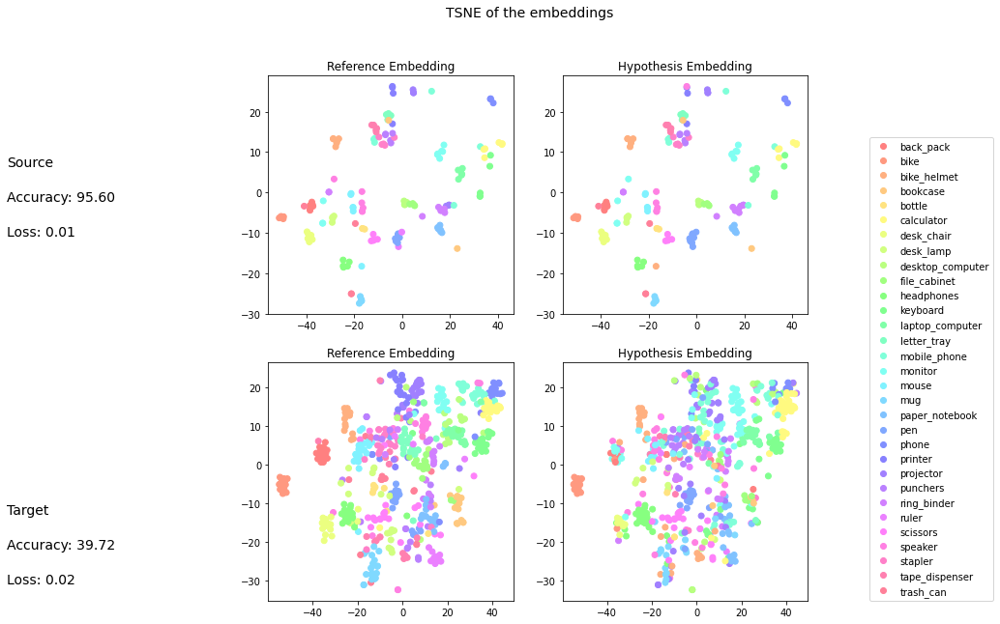

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,0.86,1.00,0.92,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

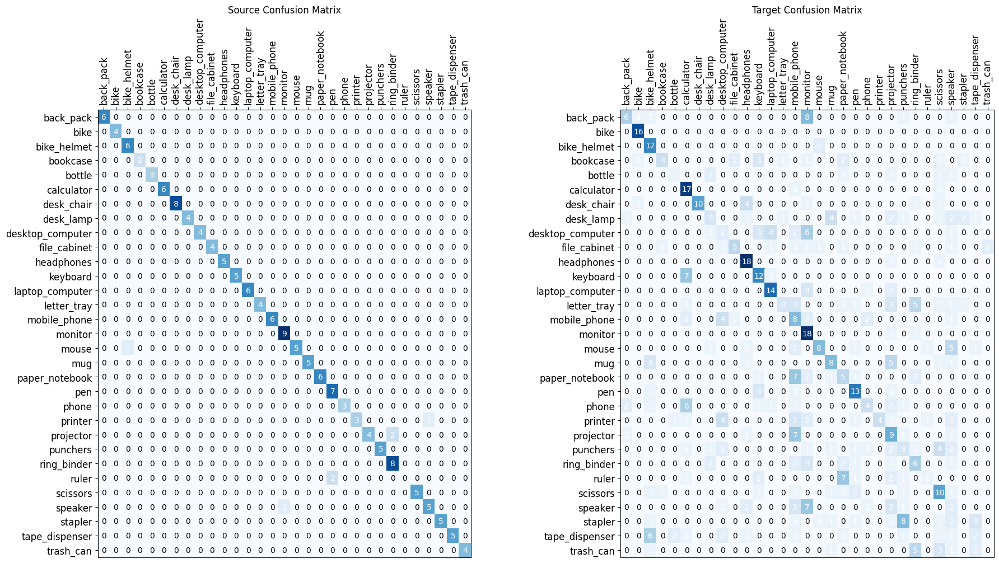

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

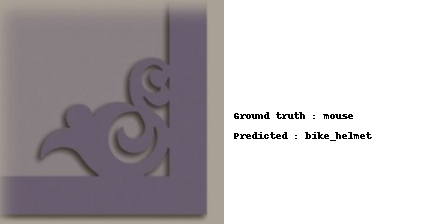

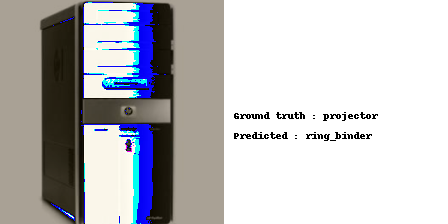

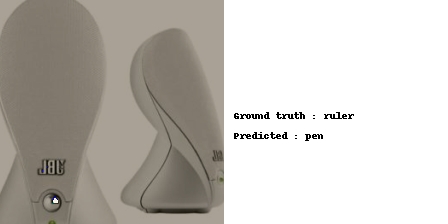

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

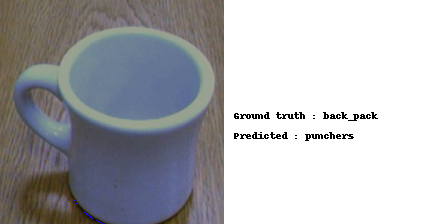

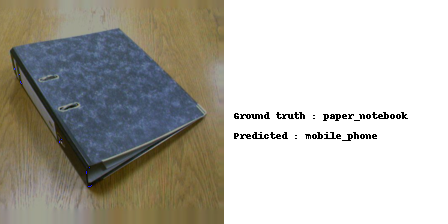

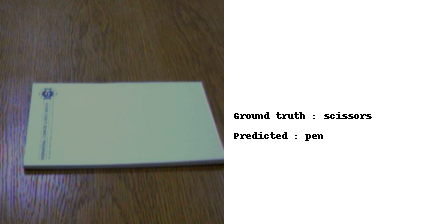

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

## DANN+SDAT 

### Train step

In [ ]:
def training_step_dann_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    sdat_optimizer: Any,
    ad_optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    epoch: int,
    lr: float,
    lr_ad: float,
    lrd,
    curr_iter: int,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):

    # sdat_optimizer refers to the Smooth optimizer which contains parameters of the feature extractor and classifier.
    sdat_optimizer.zero_grad()
    # ad_optimizer refers to standard SGD optimizer which contains parameters of domain classifier.
    ad_optimizer.zero_grad()
    
    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    inputs = torch.cat([inputs_source, inputs_target]).to(device)

    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    # Calculate task loss
    features = extractor(inputs)
    pred_class = classifier(features[:inputs_source.shape[0]])
    loss_class = ce_loss(pred_class, targets)
    loss_class.backward()

    # Calculate ϵ̂ (w) and add it to the weights
    sdat_optimizer.first_step(zero_grad=True) #prova con zero_grad True

    # Calculate task loss and domain loss
    features = extractor(inputs)
    pred_domain = discriminator(features)
    pred_class = classifier(features[:inputs_source.shape[0]])
    loss_class = ce_loss(pred_class, targets)
    loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
    loss_total = loss_domain + loss_class
    loss_total.backward()


    # Update parameters (Sharpness-Aware update)
    sdat_optimizer.second_step(zero_grad=True) 
    # Update parameters of domain classifier
    ad_optimizer.step()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      ad_optimizer = exp_lr_scheduler(ad_optimizer, epoch, lr_ad, lrd, curr_iter)
      sdat_optimizer = exp_lr_scheduler(sdat_optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, curr_iter 

In [ ]:
def train_dann_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    sdat_optimizer: Any,
    ad_optimizer: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lr_ad: float,
    lrd,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:
  
    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()

    curr_iter = 0
    
    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, curr_iter = training_step_dann_sdat(extractor, classifier, discriminator, sdat_optimizer, ad_optimizer, ce_loss, bce_loss, 
                                                 source_train_loader, target_train_loader, epoch, lr, lr_ad, lrd, curr_iter) 

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator

### DANN + SDAT from a -> w

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

#sgd param
lr = 0.001
lr_ad = 1e-2
wd = 1e-3

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True)



ad_optimizer = get_SGD_optimizer_params_list(list(discriminator.parameters()), lr=lr_ad, wd=wd, momentum=0.9) 

lrd = 0.0002

extractor, classifier, discriminator = train_dann_sdat(extractor, classifier, discriminator, sdat_optimizer, ad_optimizer, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lr_ad, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_sdat_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_sdat_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_sdat_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_sdat_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly. 

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


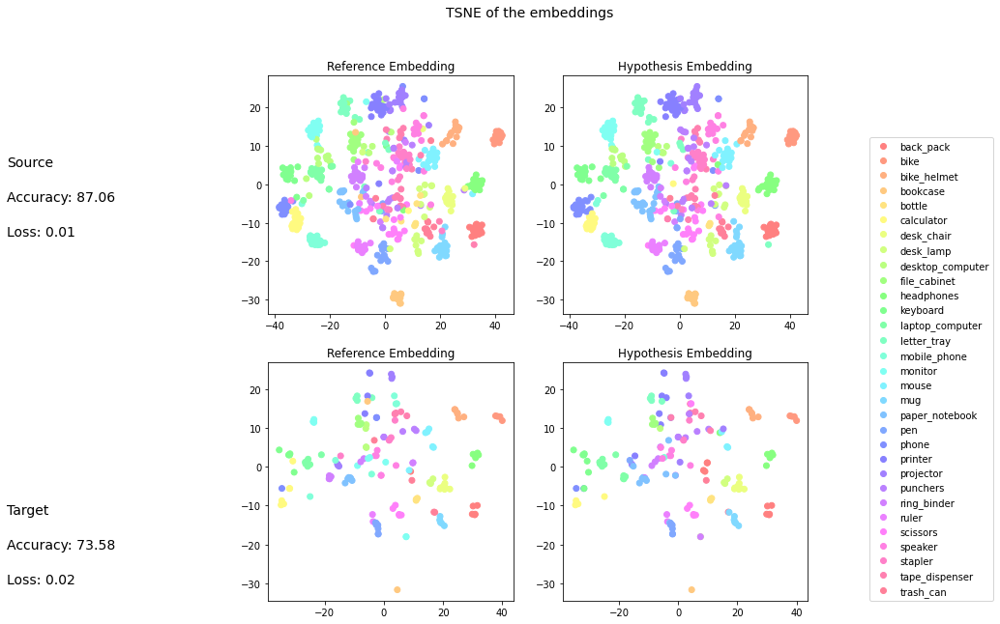

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.93,0.96,14.00
bookcase,1.00,0.81,0.90,16.00
bottle,1.00,0.43,0.60,7.00
calculator,0.94,0.84,0.89,19.00
desk_chair,1.00,0.89,0.94,18.00
desk_lamp,0.94,0.85,0.89,20.00
desktop_computer,0.82,0.74,0.78,19.00
file_cabinet,0.76,0.81,0.79,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

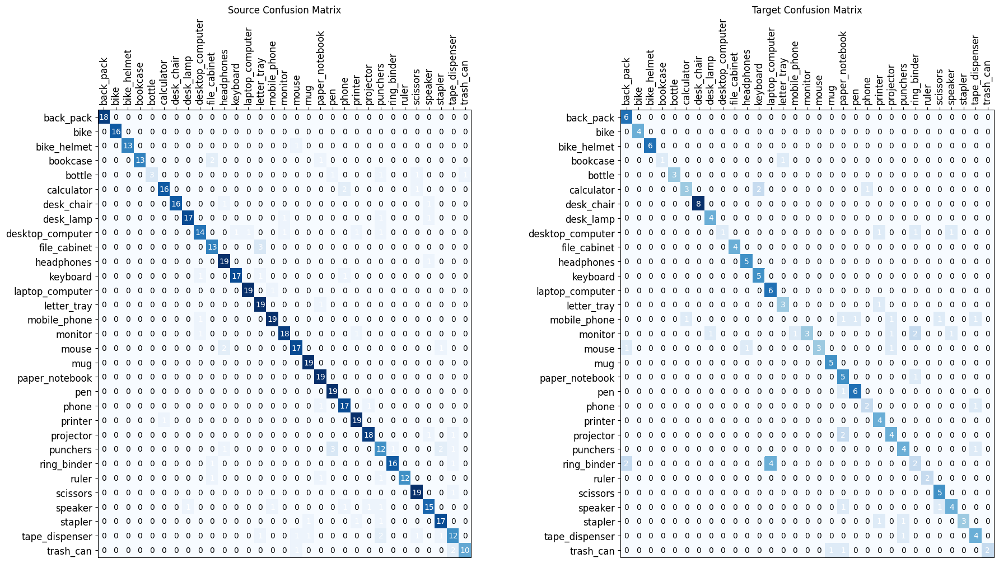

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

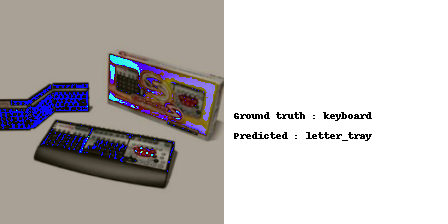

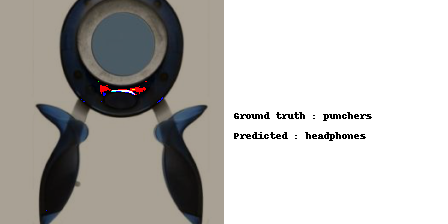

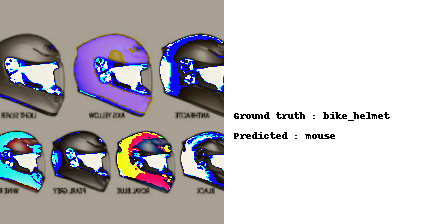

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

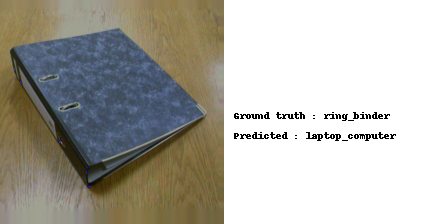

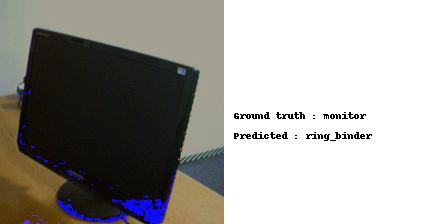

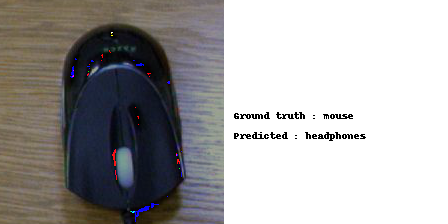

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + SDAT from w -> a

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

#sgd param
lr = 0.001
lr_ad = 1e-2
wd = 1e-3

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True)



ad_optimizer = get_SGD_optimizer_params_list(list(discriminator.parameters()), lr=lr_ad, wd=wd, momentum=0.9) 

lrd = 0.0002

extractor, classifier, discriminator = train_dann_sdat(extractor, classifier, discriminator, sdat_optimizer, ad_optimizer, 
                                                       train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lr_ad, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_sdat_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_sdat_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_sdat_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_sdat_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


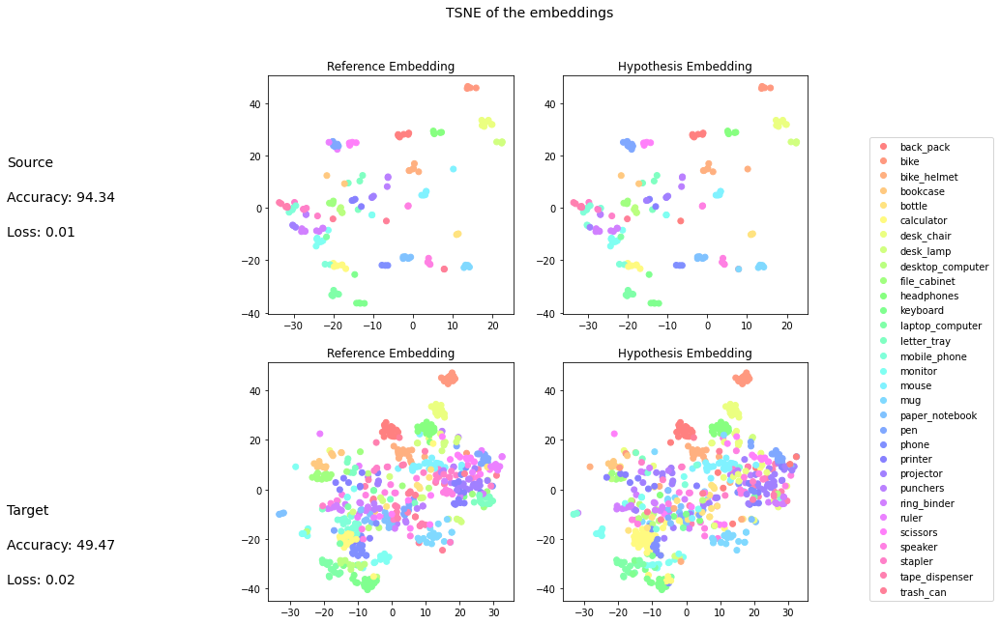

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,0.86,1.00,0.92,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,0.86,1.00,0.92,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

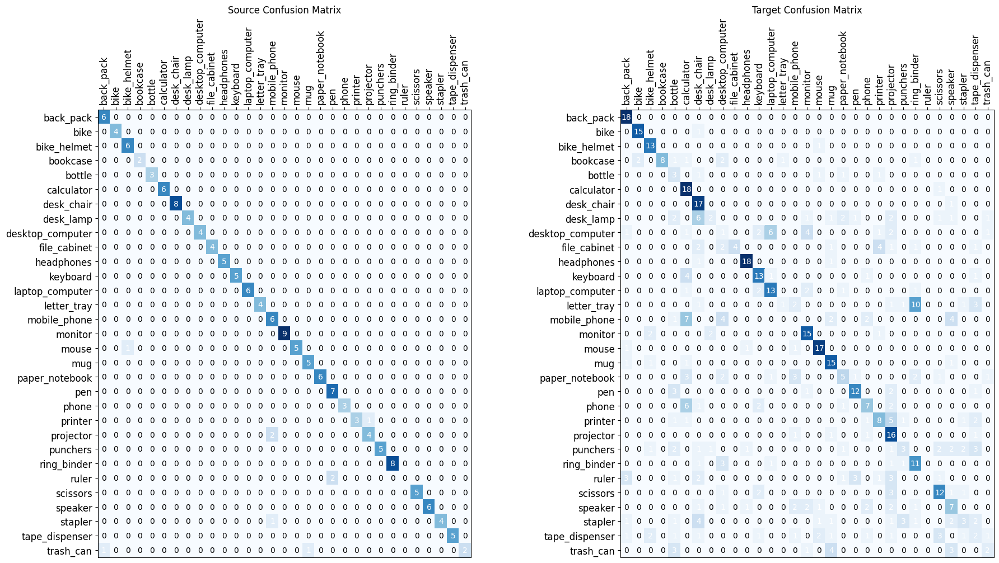

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

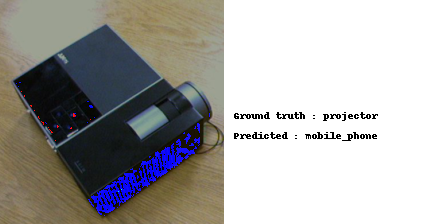

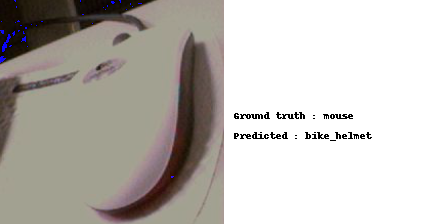

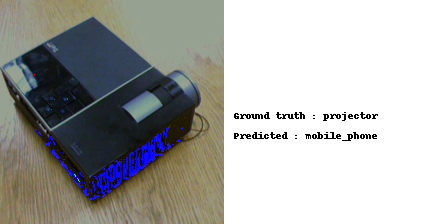

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

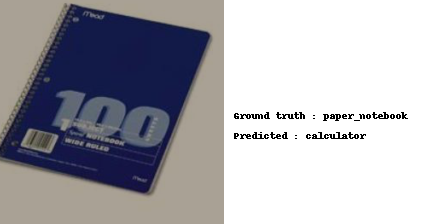

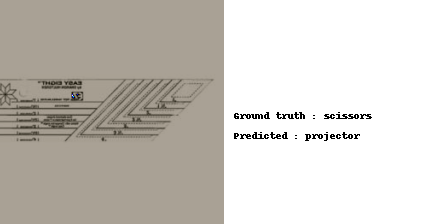

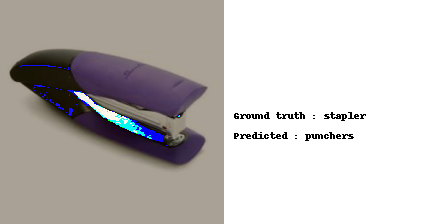

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + JREG

### Train step

In [ ]:
def training_step_dann_jreg(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    jacobian_reg,
    lambda_jr,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    epoch: int,
    lr:float,
    lrd,
    curr_iter: int,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):
    
    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)
  
    #for jacobian regularization this is essential
    inputs_source.requires_grad = True
    inputs_target.requires_grad = True

    features_src = extractor(inputs_source)
    features_tgt = extractor(inputs_target)

    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    features = torch.cat([features_src, features_tgt]).to(device)

    pred_domain = discriminator(features)
    pred_class = classifier(features_src)

    loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
    loss_class = ce_loss(pred_class, targets)

    #jacobian regularization loss
    R = jacobian_reg(features_src, pred_class)

    #total loss
    loss_total = loss_domain + loss_class

    #regularized loss
    loss_reg = loss_total + lambda_jr*R

    #loss_total.backward()
    loss_reg.backward()
    optimizer.step()
    optimizer.zero_grad()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      optimizer = exp_lr_scheduler(optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, curr_iter 

In [ ]:
def train_dann_jreg(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lrd,
    lambda_jr: float = 0.01,
    n: int = 1,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:
  
    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()

    jacobian_reg = JacobianReg(n) #n=1 default, n=-1 -> n=num_classes is the max
    
    curr_iter = 0

    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, curr_iter = training_step_dann_jreg(extractor, classifier, discriminator, optimizer, ce_loss, bce_loss, jacobian_reg, lambda_jr,
                                                 source_train_loader, target_train_loader, epoch, lr, lrd, curr_iter) 

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator

### DANN + JREG from a -> w

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)


##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002

extractor, classifier, discriminator = train_dann_jreg(extractor, classifier, discriminator, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_jreg_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_jreg_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_jreg_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_jreg_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_jreg_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_jreg_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


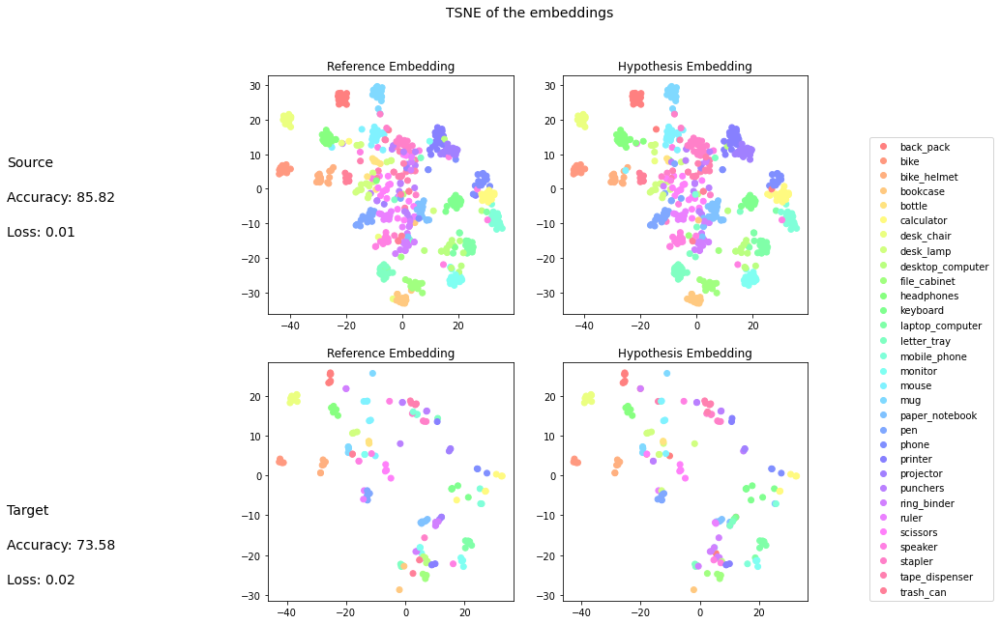

,precision,recall,f1-score,support
back_pack,0.90,1.00,0.95,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.93,0.96,14.00
bookcase,0.88,0.88,0.88,16.00
bottle,1.00,0.29,0.44,7.00
calculator,0.86,0.95,0.90,19.00
desk_chair,0.94,0.83,0.88,18.00
desk_lamp,0.89,0.80,0.84,20.00
desktop_computer,0.75,0.63,0.69,19.00
file_cabinet,0.82,0.88,0.85,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

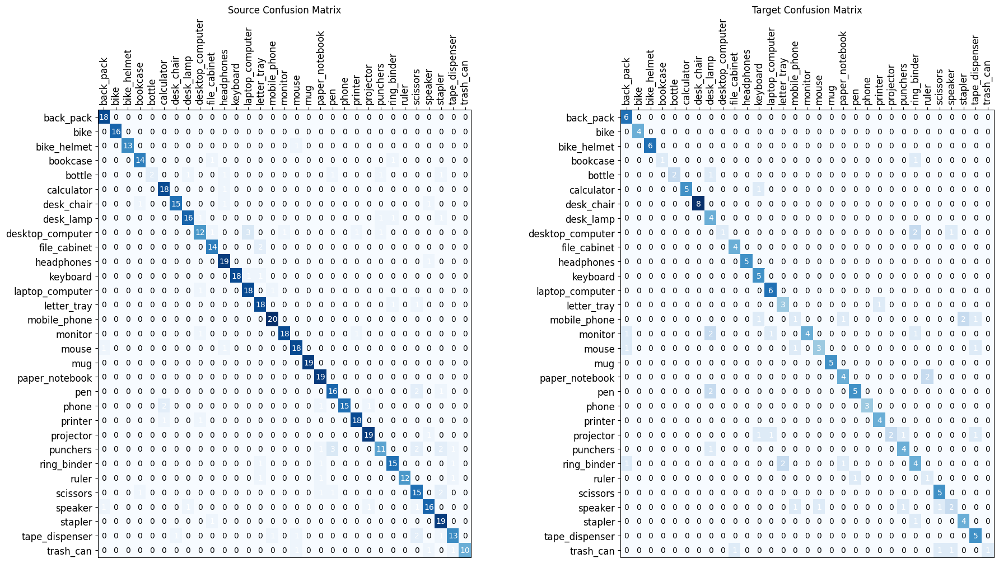

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

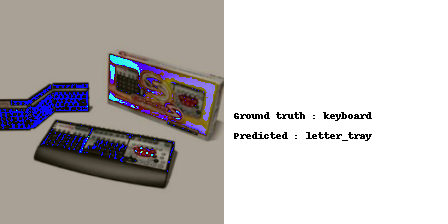

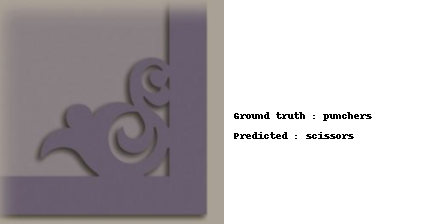

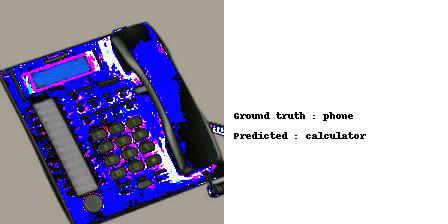

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

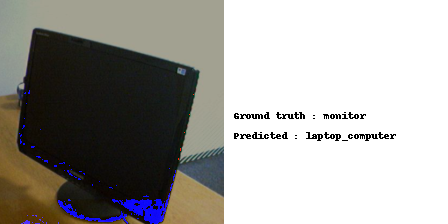

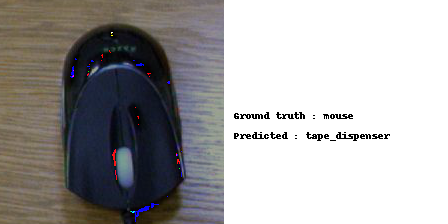

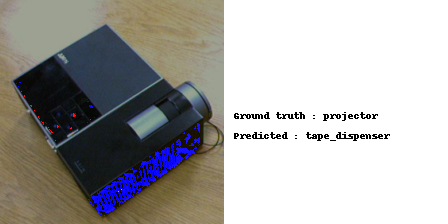

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + JREG from w -> a

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)


##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002

extractor, classifier, discriminator = train_dann_jreg(extractor, classifier, discriminator, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_jreg_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_jreg_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_jreg_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_jreg_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_jreg_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_jreg_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


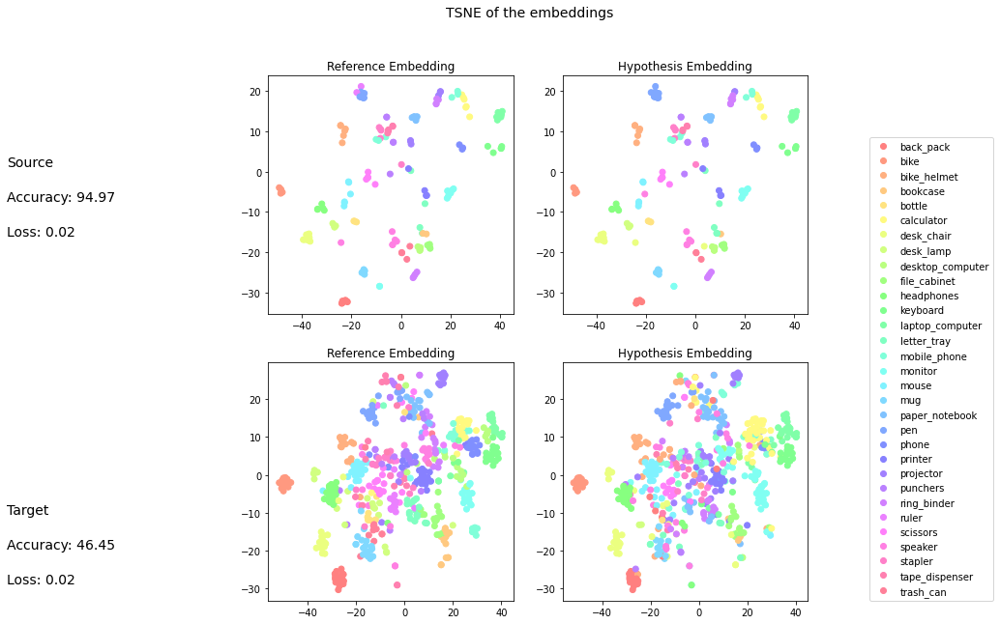

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,0.50,0.67,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,0.80,1.00,0.89,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

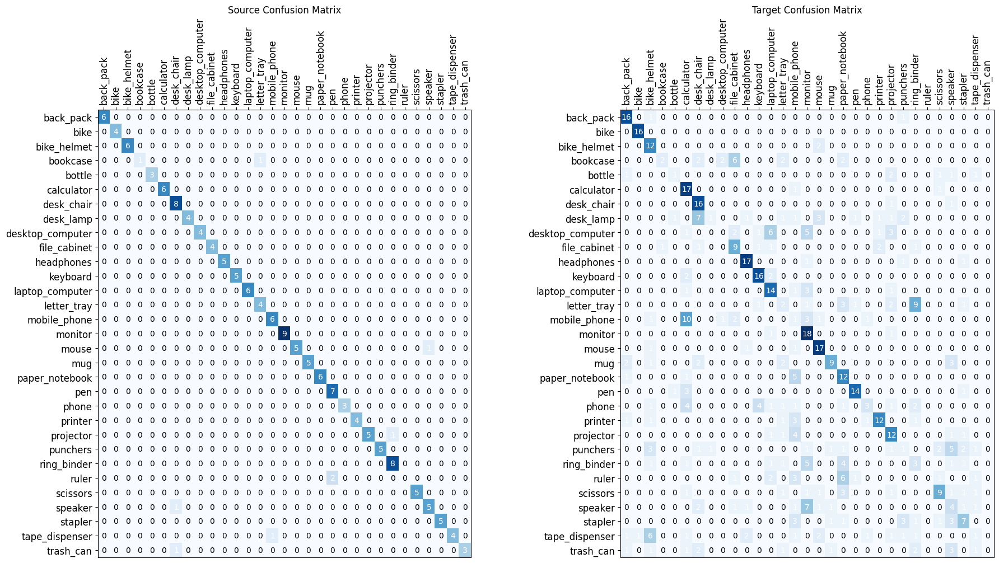

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

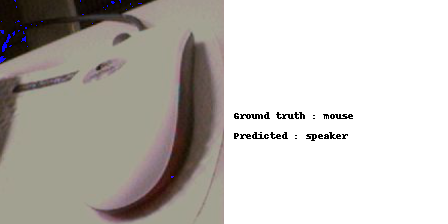

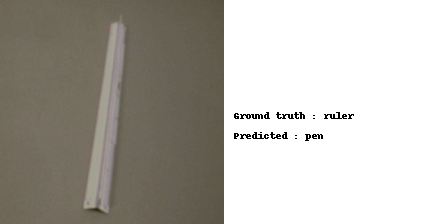

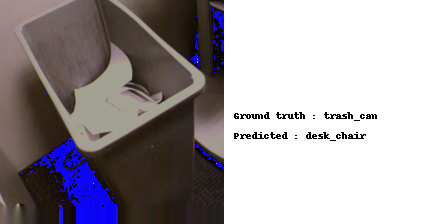

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

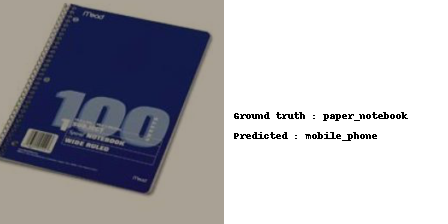

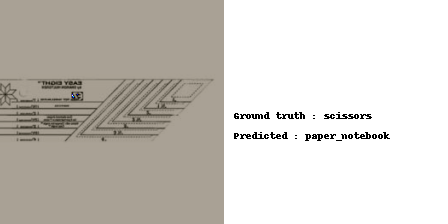

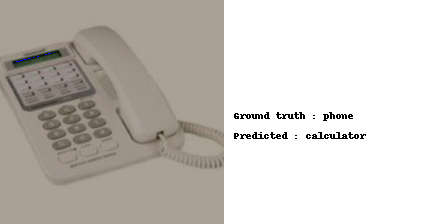

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + FGDA

### Train Step

In [ ]:
def training_step_dann_fgda(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    grad_discriminator: nn.Module,
    optimizer: Any,
    optimizer_d_grad: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    jacobian_reg,
    lambda_jr,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    mem_label,
    epoch: int,
    lr: float,
    lr_grad: float,
    lrd,
    curr_iter: int, 
    min_iter: int = 900,
    d_t: int = 0,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  pseudo_label = None

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  grad_discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):

    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, tar_idx = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, tar_idx = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)


    #added
    inputs_source.requires_grad = True
    inputs_target.requires_grad = True

    features_src = extractor(inputs_source)
    features_tgt = extractor(inputs_target)

    features = torch.cat([features_src, features_tgt]).to(device)

    #compute loss_class_src
    pred_class_src = classifier(features_src)
    loss_class_src = ce_loss(pred_class_src, targets)

    #compute loss_class_tgt
    pred_class_tgt = classifier(features_tgt)
    if mem_label is not None:
      pred = mem_label[tar_idx]
      loss_class_tgt = ce_loss(pred_class_tgt, pred)
    else:
      softmax_target = nn.Softmax(dim=1)(pred_class_tgt).detach()
      pseudo_label = softmax_target.data.max(1, keepdim=False)[1]
      loss_class_tgt = ce_loss(pred_class_tgt, pseudo_label) 

    #gradient computation
    gradient_source = torch.autograd.grad(outputs=loss_class_src, inputs=features_src, create_graph=True, retain_graph=True, only_inputs=True)[0]
    gradient_target = torch.autograd.grad(outputs=loss_class_tgt, inputs=features_tgt, create_graph=True, retain_graph=True, only_inputs=True)[0]

    gradients = torch.cat((gradient_source, gradient_target), dim=0)

    src_size, tgt_size, = features_src.size(0), features_tgt.size(0)
    
    #self training
    if d_t > 0:
      for _ in range(d_t):
          df_loss, outputs_class = DANN_FGDA(gradients.detach(), grad_discriminator, src_size, tgt_size, train_self=True)
          grad_class_src = outputs_class[0: src_size]
          d_loss_class_src = ce_loss(grad_class_src, targets)
          grad_class_tgt = outputs_class[src_size:]
          if pseudo_label is not None:
              d_loss_class_tgt = ce_loss(grad_class_tgt, pseudo_label)
          else:
              d_loss_class_tgt = ce_loss(grad_class_tgt, pred)
          df_loss = df_loss + d_loss_class_src + d_loss_class_tgt
          df_loss.backward(retain_graph=True)
          optimizer_d_grad.step()
    
    #compute gradient discrimination
    transfer_loss, d_logits = DANN_FGDA(gradients, grad_discriminator, src_size, tgt_size, outputs=True)
    
    transfer_loss.backward(retain_graph=True)

    classifier.zero_grad()

    #jacobian regularization loss
    R = jacobian_reg(features_src, pred_class_src)
    loss_jr = R*lambda_jr

    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    pred_domain = discriminator(features)
    pred_class = classifier(features_src)

    loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
    loss_class = ce_loss(pred_class, targets)

    loss_total = loss_domain + loss_class

    loss_reg = loss_total + loss_jr

    loss_reg.backward()
    optimizer.step()
    optimizer_d_grad.step()

    optimizer_d_grad.zero_grad()
    optimizer.zero_grad()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      optimizer = exp_lr_scheduler(optimizer, epoch, lr, lrd, curr_iter)
      #optimizer_d_grad = exp_lr_scheduler(optimizer_d_grad, epoch, lr_grad, lrd, curr_iter) #decrease performances

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, mem_label, curr_iter

In [ ]:
def train_dann_fgda(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    grad_discriminator: nn.Module,
    optimizer: Any,
    optimizer_d_grad: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lr_grad: float,
    lrd,
    lambda_jr: float = 0.01,
    n: int = 1,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:


    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)
    grad_discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    jacobian_reg = JacobianReg(n=1)

    pseudo_label = None
    mem_label = None
    
    curr_iter = 0
    min_iter: int = 900
    d_t = 0

    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, mem_label, curr_iter = training_step_dann_fgda(extractor, classifier, discriminator, grad_discriminator, optimizer, optimizer_d_grad, ce_loss, bce_loss, jacobian_reg, lambda_jr,
                                                 source_train_loader, target_train_loader, mem_label, epoch, lr, lr_grad, lrd, curr_iter, min_iter, d_t) 

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator, grad_discriminator

### DANN + SDAT from a -> w

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)


grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
lr_grad = 3e-3
wd = 1e-4


optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)

lrd = 0.0002
lambda_jr=0.01
n=1

extractor, classifier, discriminator, grad_discriminator = train_dann_fgda(extractor, classifier, discriminator, grad_discriminator, optim, optimizer_d_grad, 
                                                                           train_loader_a, test_loader_a, train_loader_w, test_loader_w, lambda_jr, n, lr, lr_grad, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_fgda_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_fgda_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_fgda_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_fgda_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


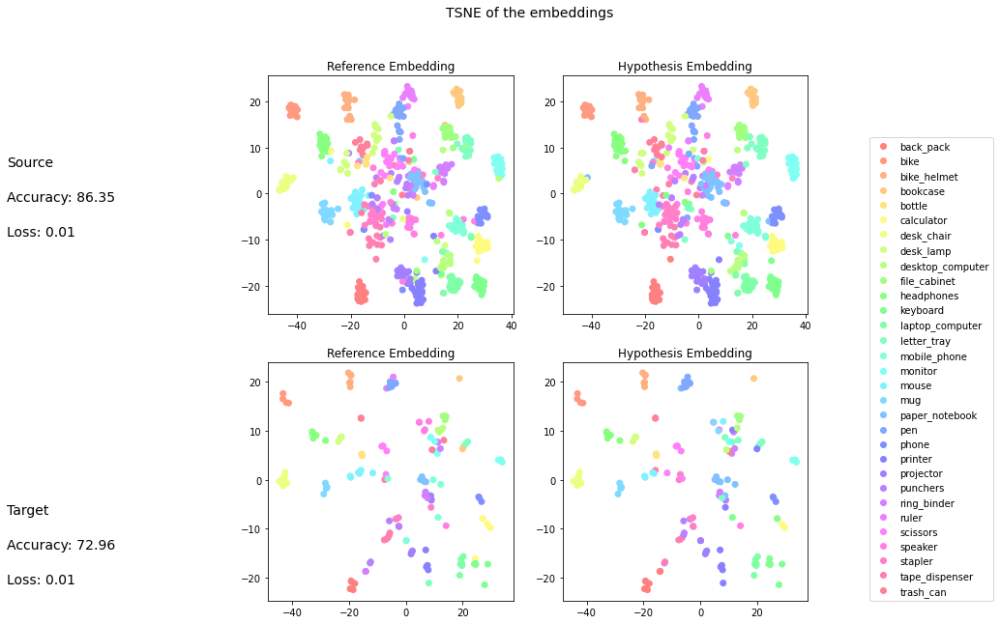

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,0.95,1.00,0.97,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.93,0.96,14.00
bookcase,1.00,0.88,0.93,16.00
bottle,1.00,0.57,0.73,7.00
calculator,0.94,0.89,0.92,19.00
desk_chair,1.00,0.83,0.91,18.00
desk_lamp,0.89,0.85,0.87,20.00
desktop_computer,0.87,0.68,0.76,19.00
file_cabinet,0.93,0.81,0.87,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

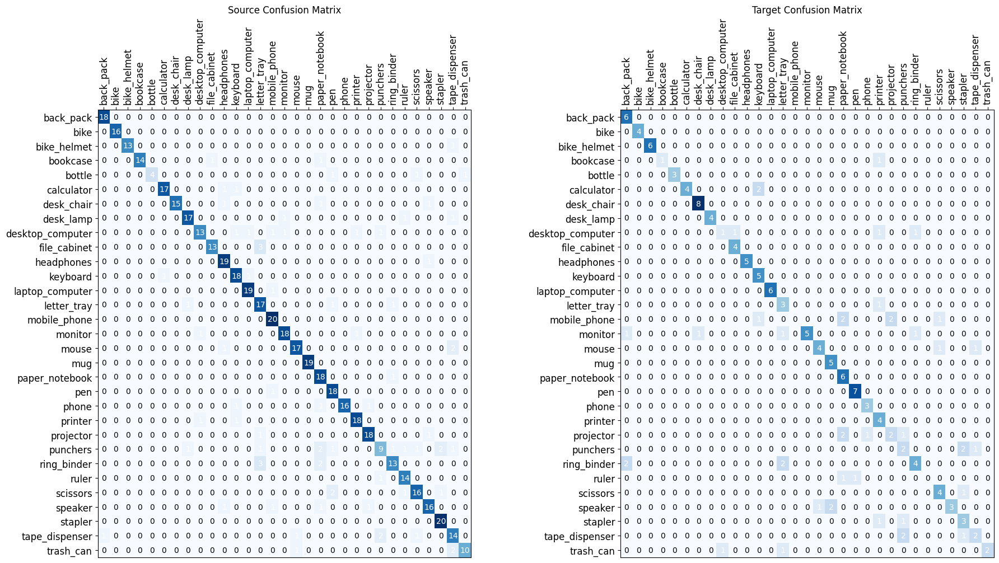

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

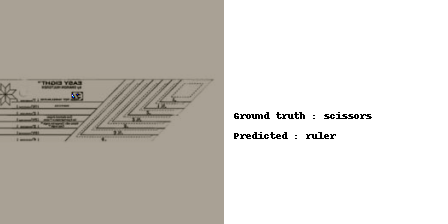

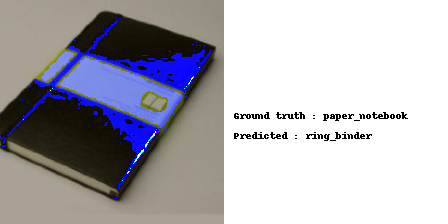

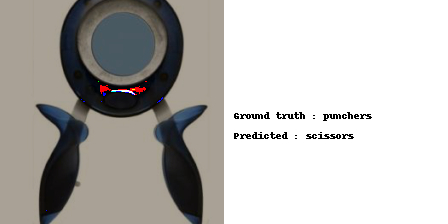

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

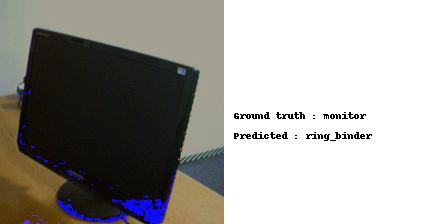

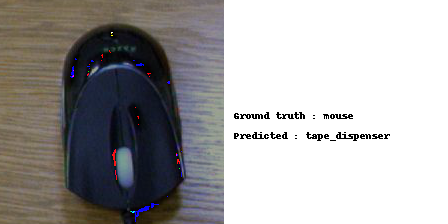

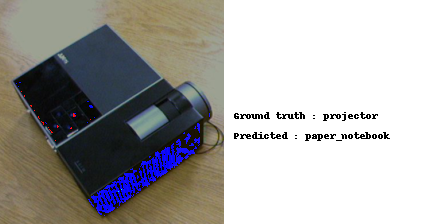

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + SDAT from w -> a

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)


grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
lr_grad = 3e-3
wd = 1e-4


optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)

lrd = 0.0002
lambda_jr=0.01
n=1

extractor, classifier, discriminator, grad_discriminator = train_dann_fgda(extractor, classifier, discriminator, grad_discriminator, optim, optimizer_d_grad, 
                                                                           train_loader_w, test_loader_w, train_loader_a, test_loader_a, lambda_jr, n, lr, lr_grad, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_fgda_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_fgda_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_fgda_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_fgda_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


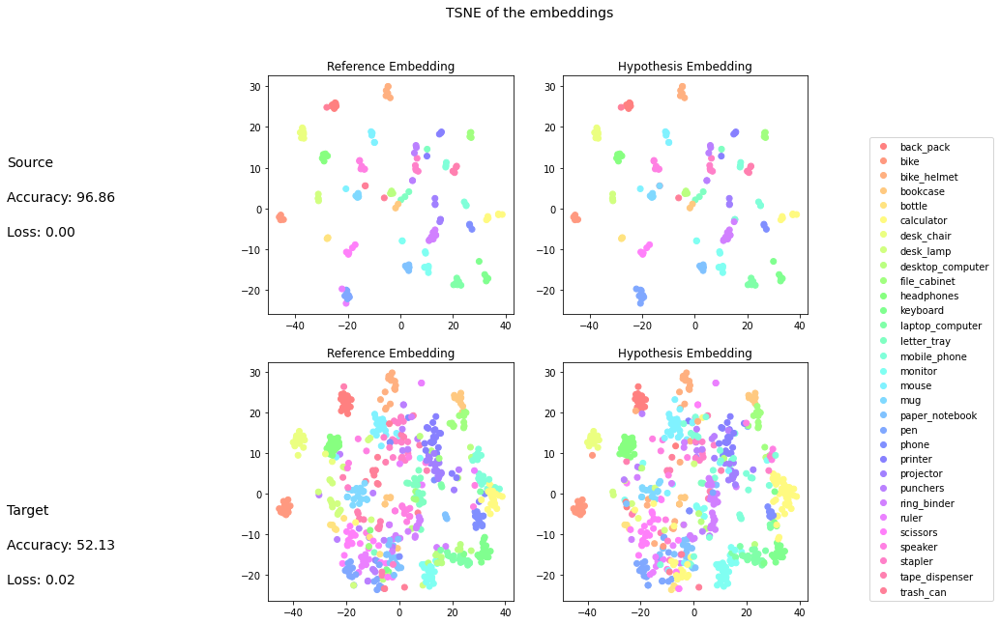

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

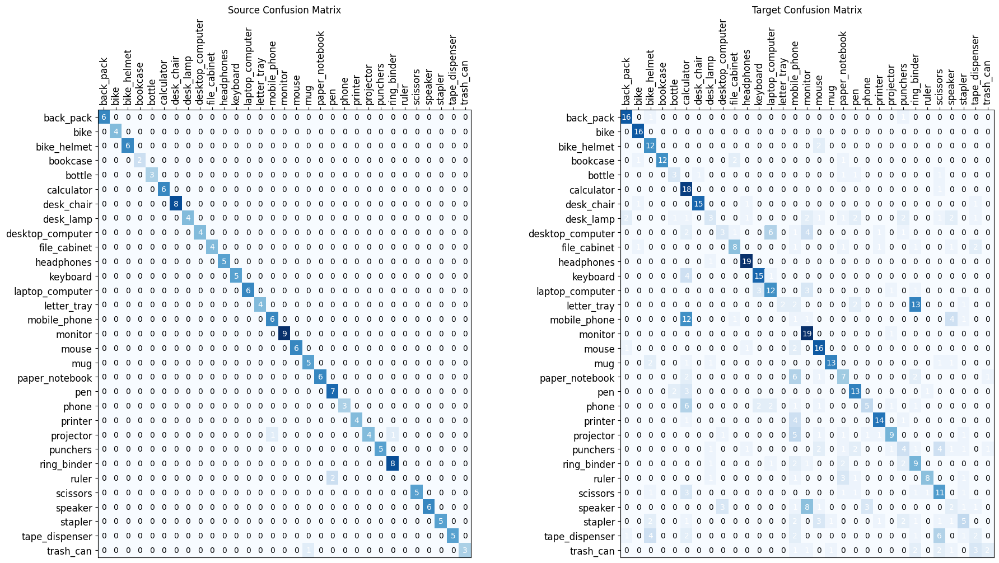

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

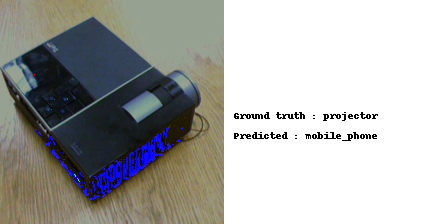

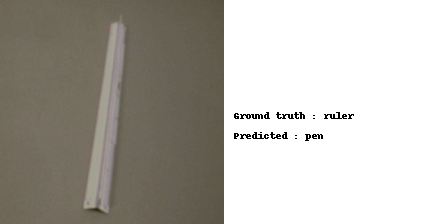

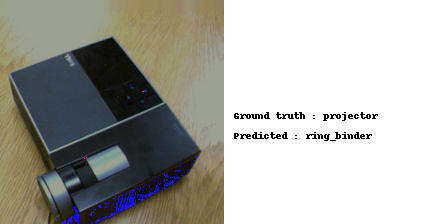

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

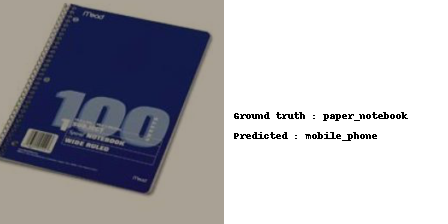

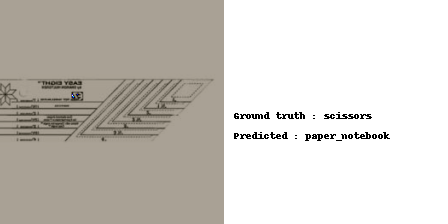

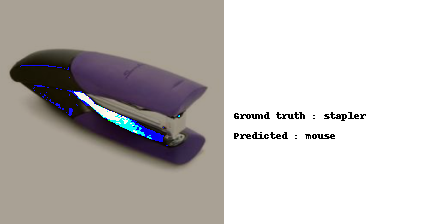

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + RADA

### Train Step

In [ ]:
def training_step_dann_rada(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    epoch: int,
    lr: float,
    lrd,
    curr_iter: int,
    rel_flag = True,
    ent_th = 0.35,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):
    
    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    # prepare domain labels
    domain_labels_src = torch.ones(inputs_source.shape[0]).to(device)
    domain_labels_tgt = torch.zeros(inputs_target.shape[0]).to(device)
    domain_labels_tgt_fake = torch.ones(inputs_target.shape[0]).to(device)
    domain_labels = torch.cat([domain_labels_src, domain_labels_tgt])

    well_alligned_tgt_idx = []
    not_well_alligned_tgt_idx = []
    if rel_flag:
      domain_labels_tgt_new = None
      domain_labels_new = None

      features_src = extractor(inputs_source)
      features_tgt = extractor(inputs_target)
      pred_domain_tgt = discriminator(features_tgt)      
      entropy_tgt = entropy_computation(pred_domain_tgt)
      for idx, ent in enumerate(entropy_tgt):
        if ent > ent_th:
          well_alligned_tgt_idx.append(idx)
        else:
          not_well_alligned_tgt_idx.append(idx)
      #print("len well_alligned_tgt_idx: ", len(well_alligned_tgt_idx))
      #print("len not_well_alligned_tgt_idx: ", len(not_well_alligned_tgt_idx))
      
      features = features_src

      if len(well_alligned_tgt_idx) != 0:
        mixup_features = mixup_for_rada(features_src, features_tgt, well_alligned_tgt_idx)

        features_alligned_list = []
        for idx in well_alligned_tgt_idx:
          features_alligned_list.append(features_tgt[idx])
      
        features_alligned = torch.stack(features_alligned_list) 

        mixup_features = mixup_features.to(device)
        features_alligned = features_alligned.to(device)

        features = torch.cat([features, features_alligned, mixup_features])
      
      domain_labels_src_new = torch.ones(features.shape[0]).to(device)

      features_tgt_new_list = []
      for idx in not_well_alligned_tgt_idx:
        features_tgt_new_list.append(features_tgt[idx])

      if len(features_tgt_new_list) != 0:
        features_tgt_new = torch.stack(features_tgt_new_list)
        features_tgt_new = features_tgt_new.to(device)

        features = torch.cat([features, features_tgt_new])

        domain_labels_tgt_new = torch.zeros(features_tgt_new.shape[0]).to(device)

      if domain_labels_tgt_new is not None:
        domain_labels_new = torch.cat([domain_labels_src_new, domain_labels_tgt_new]).to(device)
      else: 
        domain_labels_new = domain_labels_src_new.to(device)

      pred_domain = discriminator(features)
      pred_class = classifier(features_src)

      loss_domain = bce_loss(pred_domain, domain_labels_new.unsqueeze(1))
      loss_class = ce_loss(pred_class, targets)
      loss_total = 0.8*loss_domain + loss_class
    else:
      #adv training
      features_src = extractor(inputs_source)
      features_tgt = extractor(inputs_target)

      features = torch.cat([features_src, features_tgt])

      pred_domain = discriminator(features)
      pred_class = classifier(features_src)

      loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
      loss_class = ce_loss(pred_class, targets)

      loss_total = loss_domain + loss_class

    loss_total.backward()
    optimizer.step()
    optimizer.zero_grad()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      optimizer = exp_lr_scheduler(optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, loss_domain, curr_iter 

In [ ]:
def train_dann_rada(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    optimizer: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lrd,
    K=5,
    ent_th = 0.35,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:
  
    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()

    best_loss_domain = 100
    patience = 0
    rel_flag = False
    
    curr_iter = 0
    
    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      #print("results for epoch: ", epoch)
      train_loss, train_accuracy, loss_domain, curr_iter  = training_step_dann_rada(extractor, classifier, discriminator, optimizer, ce_loss, bce_loss, 
                                                 source_train_loader, target_train_loader, epoch, lr, lrd, curr_iter, rel_flag, ent_th) 
      if not rel_flag:
        if loss_domain < best_loss_domain:
          best_loss_domain = loss_domain
          patience = 0
        else:
          patience += 1
      
        if patience == K and epoch > 10:
          rel_flag = True
          print("RADA on at epoch: ", epoch)

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator

### DANN + RADA from a -> w

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002

extractor, classifier, discriminator = train_dann_rada(extractor, classifier, discriminator, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w,
                                                       lr, lrd, epochs=50)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_rada_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_rada_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_rada_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_rada_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


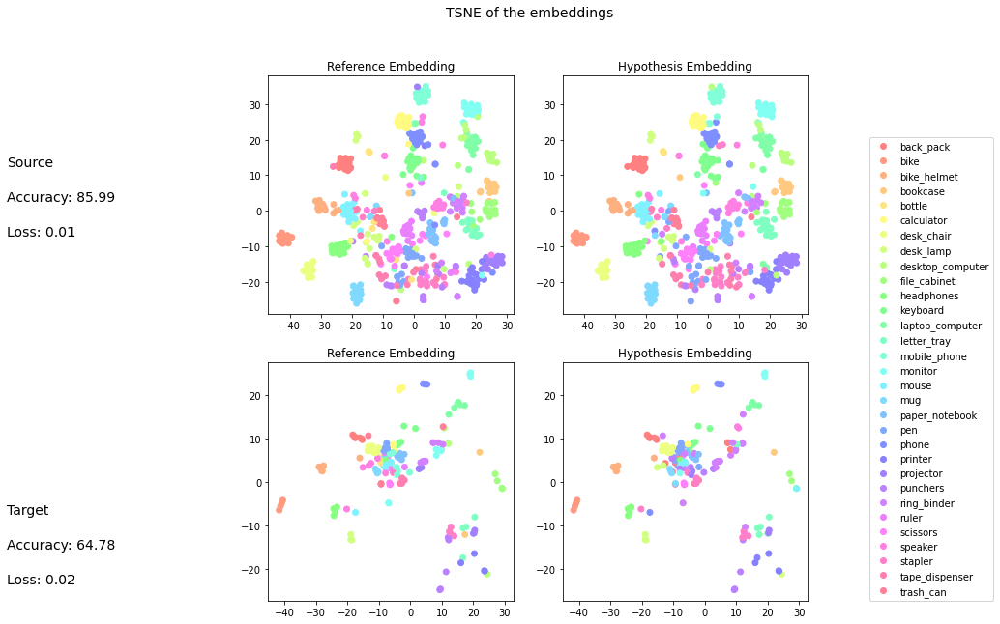

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,0.95,1.00,0.97,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,1.00,1.00,14.00
bookcase,0.93,0.88,0.90,16.00
bottle,1.00,0.43,0.60,7.00
calculator,1.00,0.89,0.94,19.00
desk_chair,1.00,0.83,0.91,18.00
desk_lamp,1.00,0.80,0.89,20.00
desktop_computer,0.75,0.63,0.69,19.00
file_cabinet,0.81,0.81,0.81,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

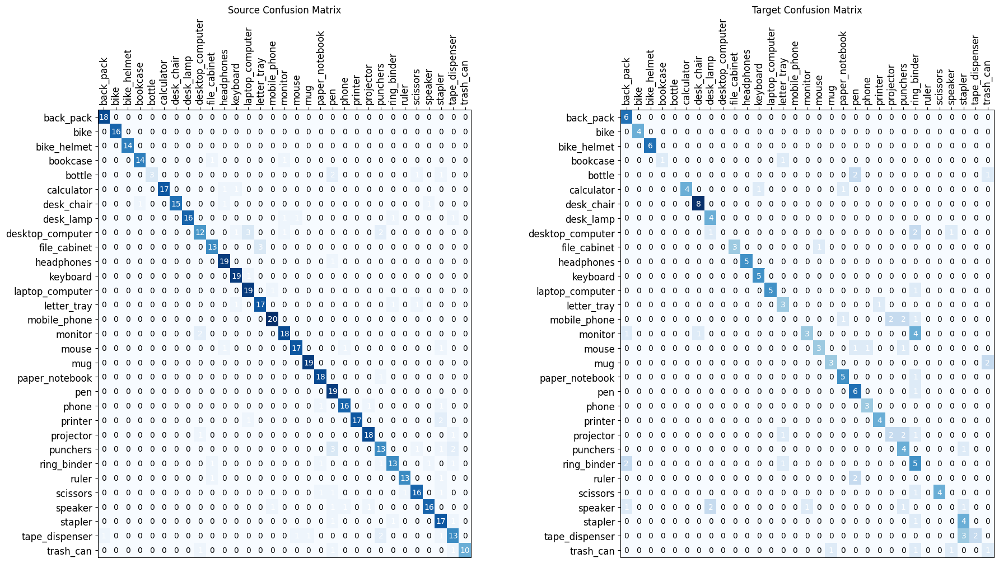

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

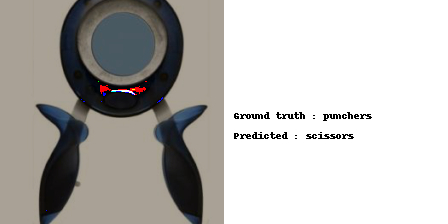

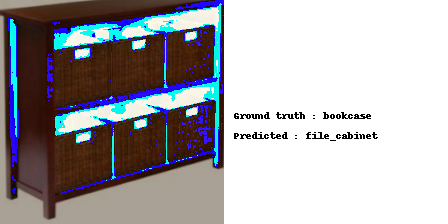

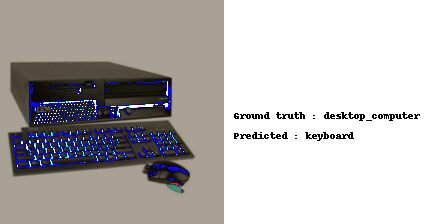

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

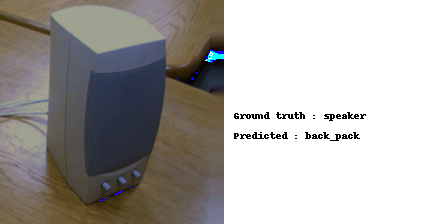

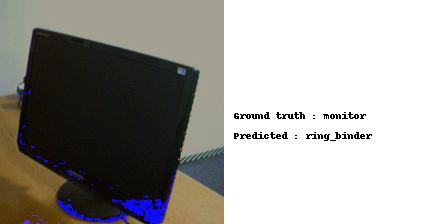

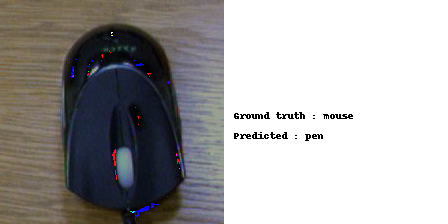

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + RADA from w -> a

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002

extractor, classifier, discriminator = train_dann_rada(extractor, classifier, discriminator, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a,
                                                       lr, lrd, epochs=50)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_rada_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_rada_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_rada_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_rada_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


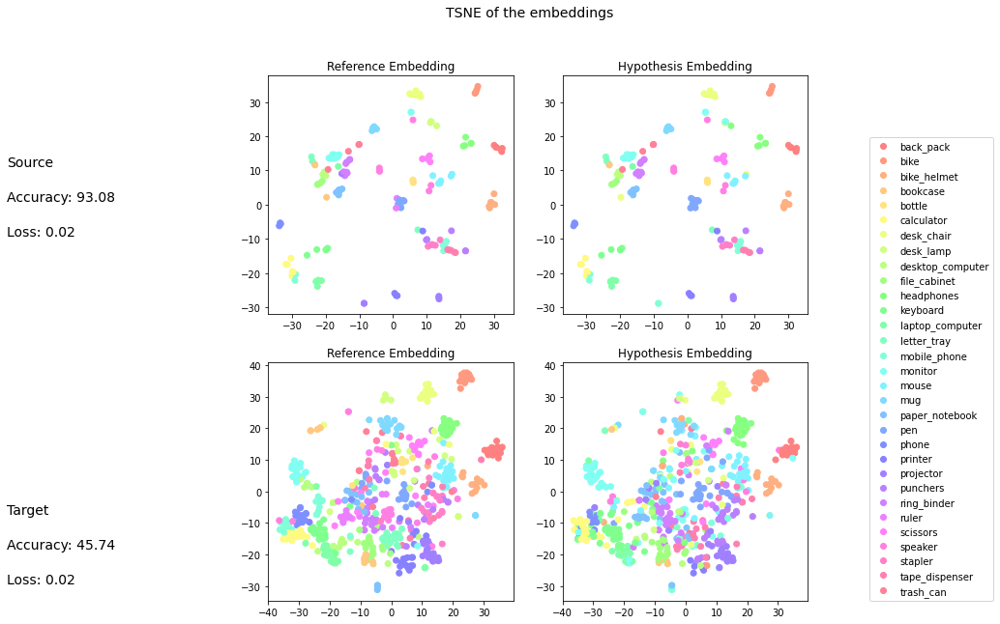

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,0.50,0.67,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,0.80,1.00,0.89,8.00
desk_lamp,1.00,0.25,0.40,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

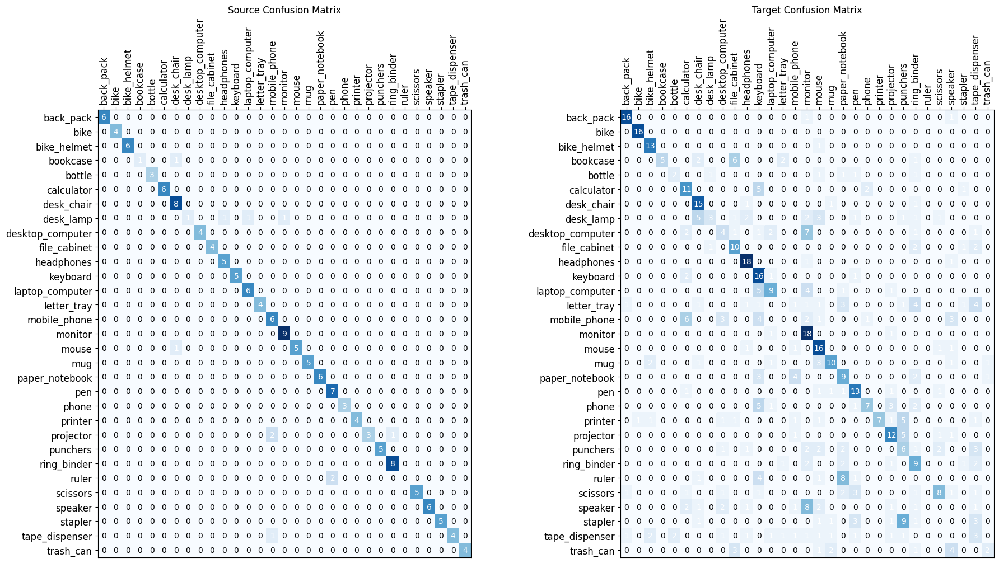

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

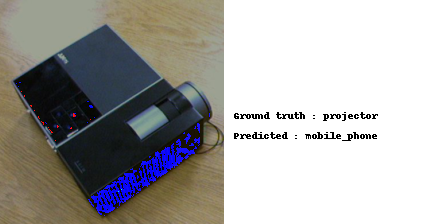

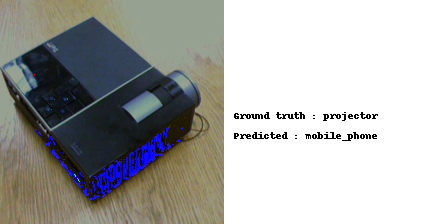

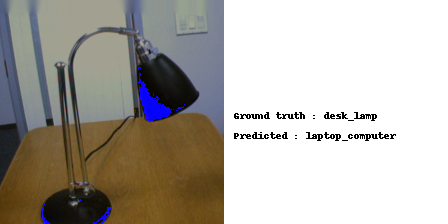

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

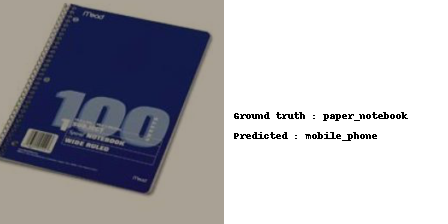

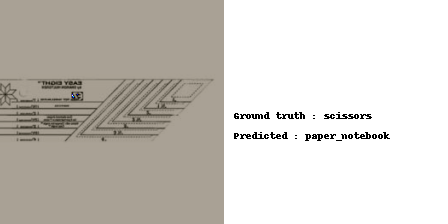

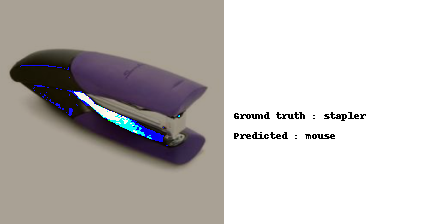

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + FGDA + DALN

### Train Step

In [ ]:
def training_step_dann_fgda_daln(
    extractor: nn.Module,
    classifier: nn.Module,
    grad_discriminator: nn.Module,
    optimizer: Any,
    optimizer_d_grad: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    discrepancy,
    jacobian_reg,
    lambda_jr,
    trade_off_lambda: float,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    mem_label,
    epoch: int, 
    lr: float,
    lrd: float, 
    curr_iter: int,
    min_iter: int = 900,
    d_t: int = 0,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  pseudo_label = None

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  grad_discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):

    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, tar_idx = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, tar_idx = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    #added
    inputs_source.requires_grad = True
    inputs_target.requires_grad = True

    features_src = extractor(inputs_source)
    features_tgt = extractor(inputs_target)

    features = torch.cat([features_src, features_tgt]).to(device)

    #compute loss_class_src
    pred_class_src = classifier(features_src)
    loss_class_src = ce_loss(pred_class_src, targets)

    #compute loss_class_tgt
    pred_class_tgt = classifier(features_tgt)
    if mem_label is not None:
      pred = mem_label[tar_idx]
      loss_class_tgt = ce_loss(pred_class_tgt, pred)
    else:
      softmax_target = nn.Softmax(dim=1)(pred_class_tgt).detach()
      pseudo_label = softmax_target.data.max(1, keepdim=False)[1]
      loss_class_tgt = ce_loss(pred_class_tgt, pseudo_label) 

    #gradient computation
    gradient_source = torch.autograd.grad(outputs=loss_class_src, inputs=features_src, create_graph=True, retain_graph=True, only_inputs=True)[0]
    gradient_target = torch.autograd.grad(outputs=loss_class_tgt, inputs=features_tgt, create_graph=True, retain_graph=True, only_inputs=True)[0]

    gradients = torch.cat((gradient_source, gradient_target), dim=0)

    src_size, tgt_size, = features_src.size(0), features_tgt.size(0)
    
    #self training
    if d_t > 0:
      for _ in range(d_t):
          df_loss, outputs_class = DANN_FGDA(gradients.detach(), grad_discriminator, src_size, tgt_size, train_self=True)
          grad_class_src = outputs_class[0: src_size]
          d_loss_class_src = ce_loss(grad_class_src, targets)
          grad_class_tgt = outputs_class[src_size:]
          if pseudo_label is not None:
              d_loss_class_tgt = ce_loss(grad_class_tgt, pseudo_label)
          else:
              d_loss_class_tgt = ce_loss(grad_class_tgt, pred)
          df_loss = df_loss + d_loss_class_src + d_loss_class_tgt
          df_loss.backward(retain_graph=True)
          optimizer_d_grad.step()
    
    #compute gradient discrimination
    transfer_loss, d_logits = DANN_FGDA(gradients, grad_discriminator, src_size, tgt_size, outputs=True)
    
    transfer_loss.backward(retain_graph=True)

    classifier.zero_grad()

    #jacobian regularization loss
    R = jacobian_reg(features_src, pred_class_src)
    loss_jr = R*lambda_jr

    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    # compute nuclear-norm wasserstein discrepancy between domains
    # for adversarial classifier, minimize negative nwd is equal to maximize nwd
    discrepancy_loss = -discrepancy(features)
    transfer_loss = discrepancy_loss * trade_off_lambda # multiply the lambda to trade off the loss term

    pred_class = classifier(features_src)
    loss_class = ce_loss(pred_class, targets)

    loss_total = transfer_loss + loss_class

    loss_reg = loss_total + loss_jr

    loss_reg.backward()
    optimizer.step()
    optimizer_d_grad.step()

    optimizer_d_grad.zero_grad()
    optimizer.zero_grad()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      optimizer = exp_lr_scheduler(optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, mem_label, curr_iter

In [ ]:
def train_dann_fgda_daln(
    extractor: nn.Module,
    classifier: nn.Module,
    grad_discriminator: nn.Module,
    optimizer: Any,
    optimizer_d_grad: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lrd,
    trade_off_lambda: float = 0.8,
    lambda_jr: float = 0.01,
    n: int = 1,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:


    extractor.to(device)
    classifier.to(device)
    grad_discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    jacobian_reg = JacobianReg(n=1)
    discrepancy = NuclearWassersteinDiscrepancy(classifier)

    pseudo_label = None
    mem_label = None
    
    curr_iter = 0
    min_iter: int = 900
    d_t = 0

    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, mem_label, curr_iter = training_step_dann_fgda_daln(extractor, classifier, grad_discriminator, optimizer, optimizer_d_grad, ce_loss, bce_loss, discrepancy,
                                                 jacobian_reg, lambda_jr, trade_off_lambda, source_train_loader, target_train_loader, mem_label, epoch, lr, lrd, curr_iter, min_iter, d_t) 
      

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, grad_discriminator

### DANN + FGDA + DALN from a -> w

In [ ]:
#Training accuracy': '97.11496', 'Test loss': '0.01498', 'Test accuracy': '75.47170
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()), lr=lr, wd=wd, momentum=0.9)

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=3e-3, wd=5e-4, momentum=0.9)

lrd = 0.0002

trade_off_lambda = 0.8
lambda_jr=0.01
n=1

extractor, classifier, grad_discriminator = train_dann_fgda_daln(extractor, classifier, grad_discriminator, optim, optimizer_d_grad, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lrd, trade_off_lambda, lambda_jr, n) 

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_fgda_daln_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_fgda_daln_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_fgda_daln_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_fgda_daln_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_daln_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_daln_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


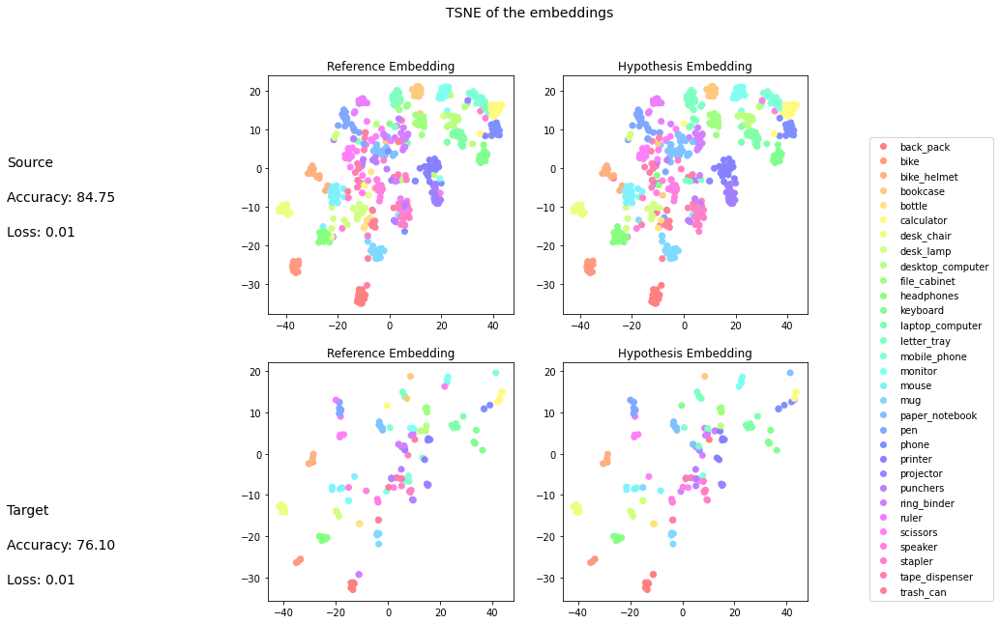

,precision,recall,f1-score,support
back_pack,0.95,1.00,0.97,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.93,0.96,14.00
bookcase,0.88,0.88,0.88,16.00
bottle,1.00,0.29,0.44,7.00
calculator,0.90,0.95,0.92,19.00
desk_chair,1.00,0.83,0.91,18.00
desk_lamp,1.00,0.80,0.89,20.00
desktop_computer,0.86,0.63,0.73,19.00
file_cabinet,0.87,0.81,0.84,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

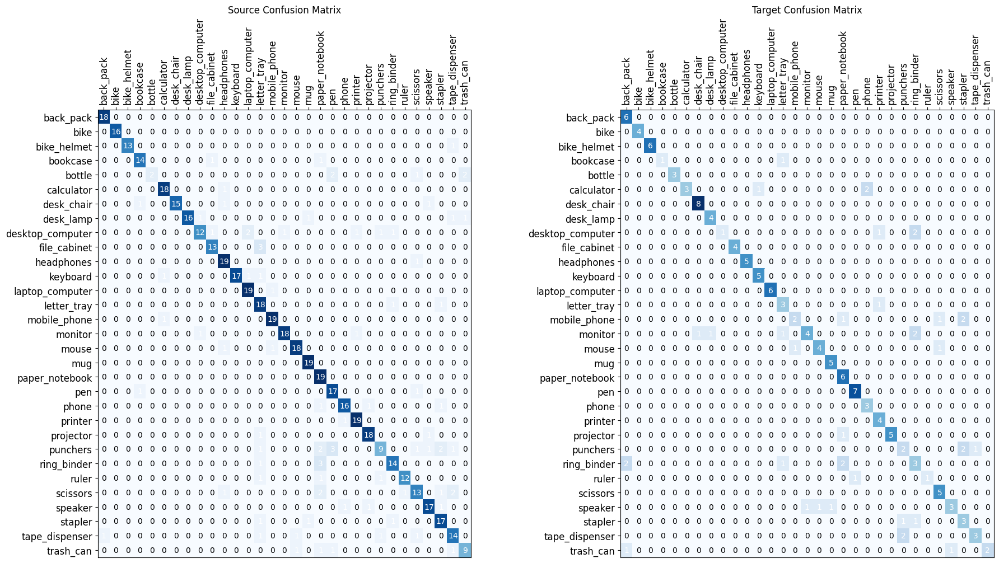

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

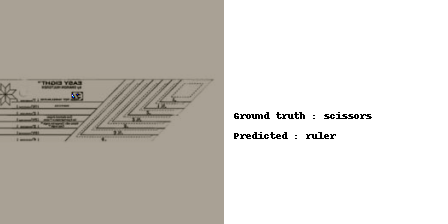

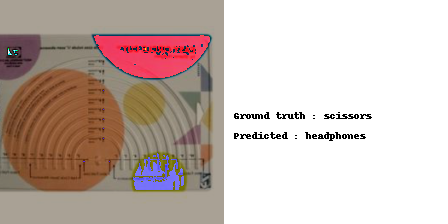

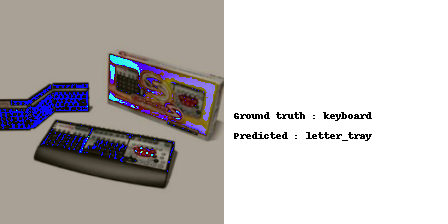

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

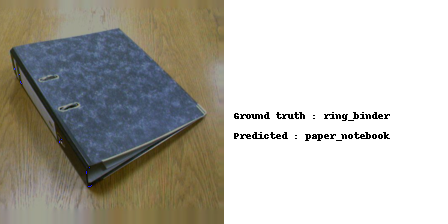

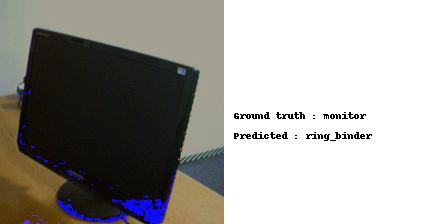

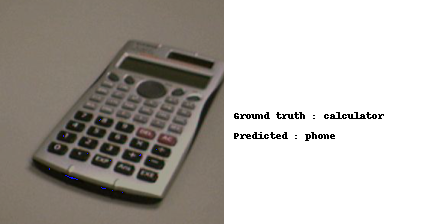

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + FGDA + DALN from w -> a

In [ ]:
#Training accuracy': '97.11496', 'Test loss': '0.01498', 'Test accuracy': '75.47170
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()), lr=lr, wd=wd, momentum=0.9)

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=3e-3, wd=5e-4, momentum=0.9)

lrd = 0.0002

trade_off_lambda = 0.8
lambda_jr=0.01
n=1

extractor, classifier, grad_discriminator = train_dann_fgda_daln(extractor, classifier, grad_discriminator, optim, optimizer_d_grad, 
                                                                 train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lrd, trade_off_lambda, lambda_jr, n) 

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_fgda_daln_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_fgda_daln_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_fgda_daln_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_fgda_daln_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_daln_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_daln_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


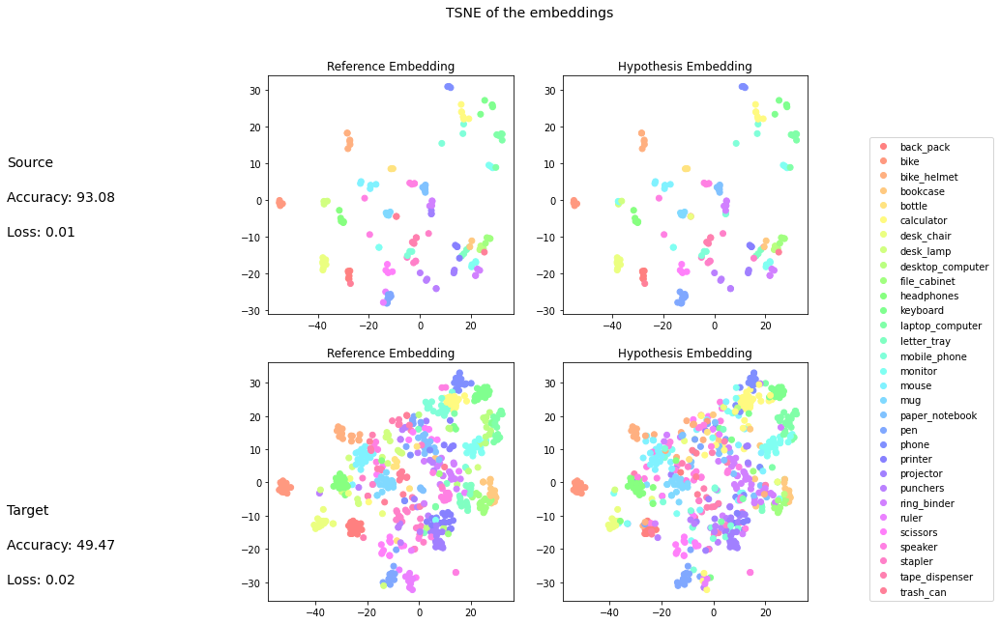

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,0.89,1.00,0.94,8.00
desk_lamp,1.00,0.50,0.67,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

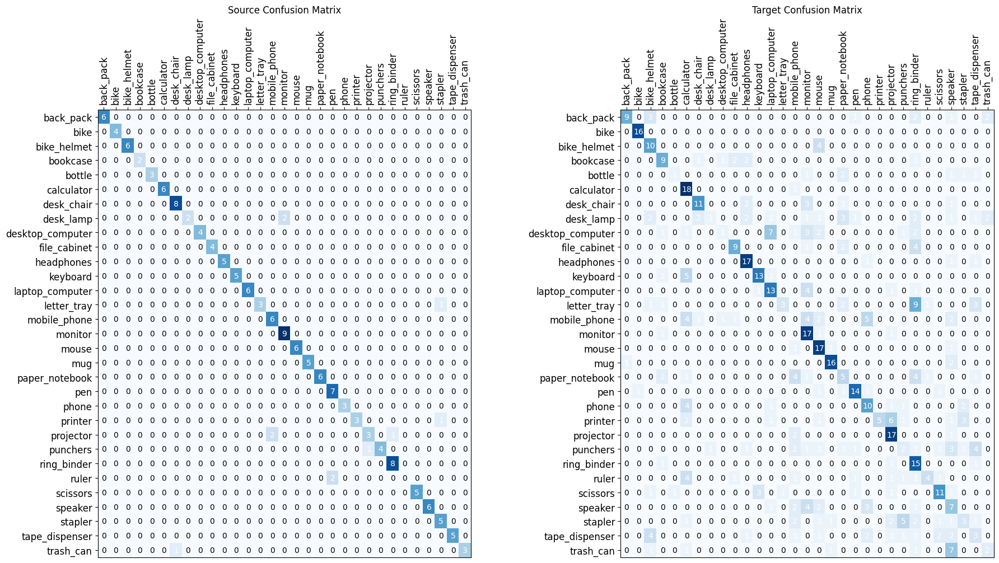

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

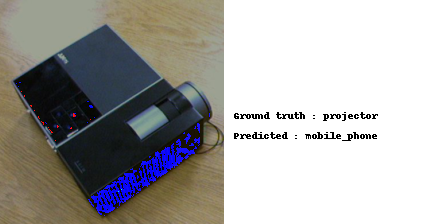

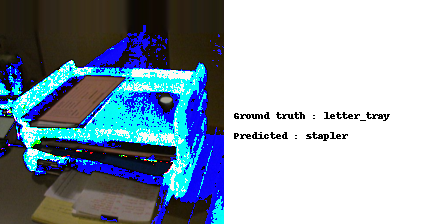

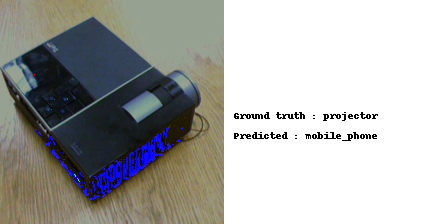

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

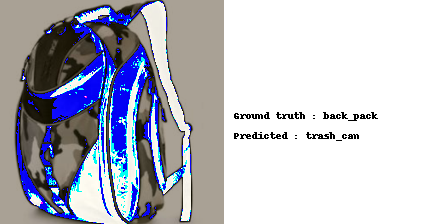

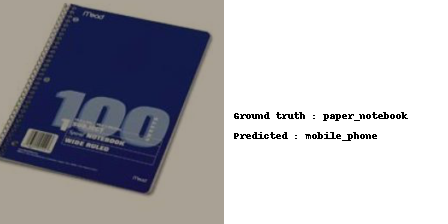

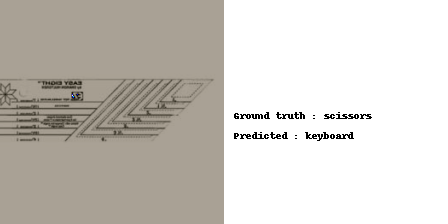

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN+DALN+SDAT

### Train Step

In [ ]:
def training_step_dann_daln_sdat1(
    extractor: nn.Module,
    classifier: nn.Module,
    sdat_optimizer: Any,
    ad_optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    discrepancy,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    trade_off_lambda: float,
    epoch: int,
    lr: float,
    lr_ad: float,
    lrd,
    curr_iter: int,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()

  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):

    # sdat_optimizer refers to the Smooth optimizer which contains parameters of the feature extractor and classifier.
    sdat_optimizer.zero_grad()
    # ad_optimizer refers to standard SGD optimizer which contains parameters of domain classifier.
    ad_optimizer.zero_grad()
    
    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    inputs = torch.cat([inputs_source, inputs_target]).to(device)

    # Calculate task loss
    features = extractor(inputs)
    pred_class = classifier(features[:inputs_source.shape[0]])
    loss_class = ce_loss(pred_class, targets)
    loss_class.backward()

    # Calculate ϵ̂ (w) and add it to the weights
    sdat_optimizer.first_step(zero_grad=True) #prova con zero_grad True

    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    features = extractor(inputs)
    pred_class = classifier(features[:inputs_source.shape[0]])
    loss_class = ce_loss(pred_class, targets)

    # compute nuclear-norm wasserstein discrepancy between domains
    # for adversarial classifier, minimize negative nwd is equal to maximize nwd
    discrepancy_loss = -discrepancy(features)
    transfer_loss = discrepancy_loss * trade_off_lambda # multiply the lambda to trade off the loss term
    
    loss_total = transfer_loss + loss_class
    loss_total.backward()

    # Update parameters (Sharpness-Aware update)
    sdat_optimizer.second_step(zero_grad=True) #ma nell'esempio usano questo -> no problemi -> è giusto?
    # Update parameters of domain classifier
    ad_optimizer.step()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      ad_optimizer = exp_lr_scheduler(ad_optimizer, epoch, lr_ad, lrd, curr_iter)
      sdat_optimizer = exp_lr_scheduler(sdat_optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, curr_iter

In [ ]:
def training_step_dann_daln_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    sdat_optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    discrepancy,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    trade_off_lambda: float,
    epoch: int,
    lr: float,
    lrd,
    curr_iter: int,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()

  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):

    # sdat_optimizer refers to the Smooth optimizer which contains parameters of the feature extractor and classifier.
    sdat_optimizer.zero_grad()
    # ad_optimizer refers to standard SGD optimizer which contains parameters of domain classifier.
    ad_optimizer.zero_grad()
    
    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    inputs = torch.cat([inputs_source, inputs_target]).to(device)

    # Calculate task loss
    features = extractor(inputs)
    pred_class = classifier(features[:inputs_source.shape[0]])
    loss_class = ce_loss(pred_class, targets)
    loss_class.backward()

    # Calculate ϵ̂ (w) and add it to the weights
    sdat_optimizer.first_step(zero_grad=True) #prova con zero_grad True

    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    features = extractor(inputs)
    pred_class = classifier(features[:inputs_source.shape[0]])
    loss_class = ce_loss(pred_class, targets)

    # compute nuclear-norm wasserstein discrepancy between domains
    # for adversarial classifier, minimize negative nwd is equal to maximize nwd
    discrepancy_loss = -discrepancy(features)
    transfer_loss = discrepancy_loss * trade_off_lambda # multiply the lambda to trade off the loss term
    
    loss_total = transfer_loss + loss_class
    loss_total.backward()

    # Update parameters (Sharpness-Aware update)
    sdat_optimizer.second_step(zero_grad=True) #ma nell'esempio usano questo -> no problemi -> è giusto?
    # Update parameters of domain classifier

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      sdat_optimizer = exp_lr_scheduler(sdat_optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, curr_iter

In [ ]:
def train_dann_daln_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    sdat_optimizer: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    trade_off_lambda: float,
    lr: float,
    lrd,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:
  
    extractor.to(device)
    classifier.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    discrepancy = NuclearWassersteinDiscrepancy(classifier)

    curr_iter = 0
    
    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, curr_iter = training_step_dann_daln_sdat(extractor, classifier, sdat_optimizer, ce_loss, bce_loss, discrepancy, 
                                                 source_train_loader, target_train_loader, trade_off_lambda, epoch, lr, lrd, curr_iter) 

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier

### DANN + DALN + SDAT from a -> w

In [ ]:
#'{'Training loss': '0.00250', 'Training accuracy': '98.53529', 'Test loss': '0.01957', 'Test accuracy': '68.55346'
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)

#sgd param
lr=1e-3
wd = 1e-3

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True) 

lrd = 0.0002

trade_off_lambda = 0.8

extractor, classifier = train_dann_daln_sdat(extractor, classifier, sdat_optimizer, train_loader_a, test_loader_a, train_loader_w, test_loader_w, trade_off_lambda, lr, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_daln_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_daln_sdat_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_daln_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_daln_sdat_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_daln_sdat_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_daln_sdat_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


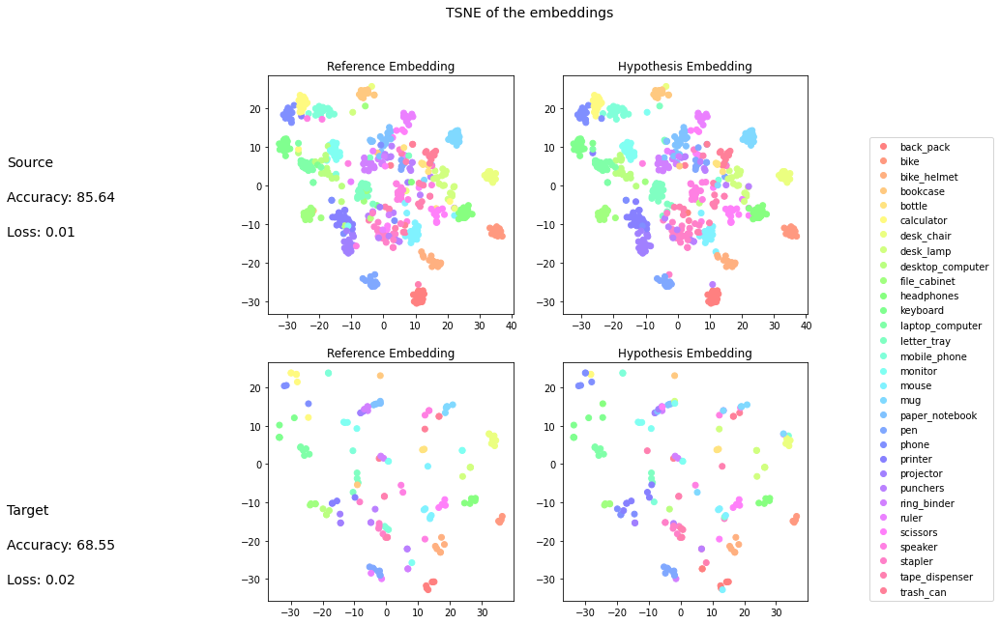

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,0.95,1.00,0.97,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.93,0.96,14.00
bookcase,0.93,0.88,0.90,16.00
bottle,1.00,0.57,0.73,7.00
calculator,0.94,0.89,0.92,19.00
desk_chair,1.00,0.89,0.94,18.00
desk_lamp,0.94,0.85,0.89,20.00
desktop_computer,0.76,0.68,0.72,19.00
file_cabinet,0.87,0.81,0.84,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

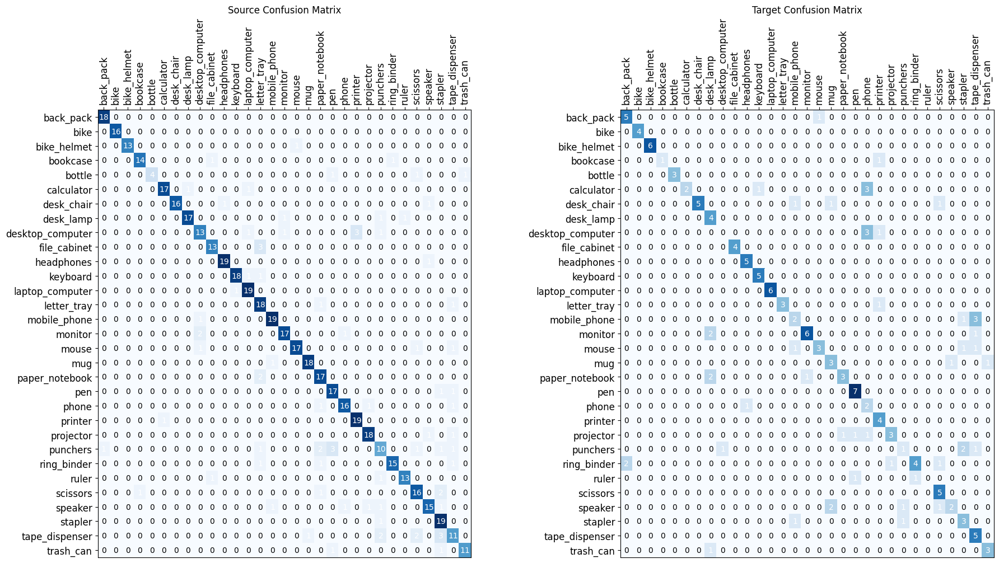

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

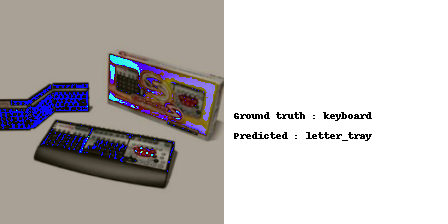

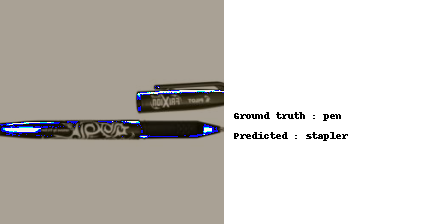

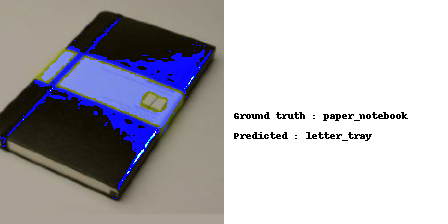

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

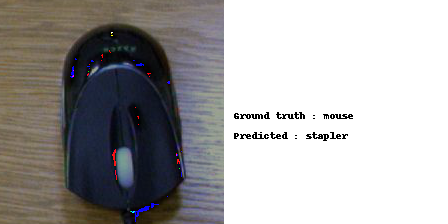

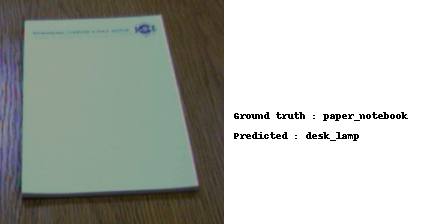

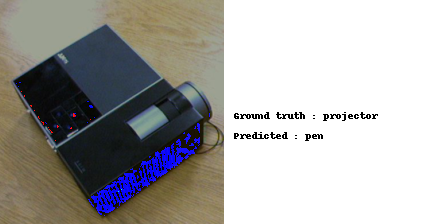

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + DALN + SDAT from w -> a

In [ ]:
#'{'Training loss': '0.00250', 'Training accuracy': '98.53529', 'Test loss': '0.01957', 'Test accuracy': '68.55346'
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)

#sgd param
lr=1e-3
wd = 1e-3

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True) 

lrd = 0.0002

trade_off_lambda = 0.8

extractor, classifier = train_dann_daln_sdat(extractor, classifier, sdat_optimizer, train_loader_w, test_loader_w, train_loader_a, test_loader_a, trade_off_lambda, lr, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_daln_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_daln_sdat_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_daln_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_daln_sdat_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_daln_sdat_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_daln_sdat_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


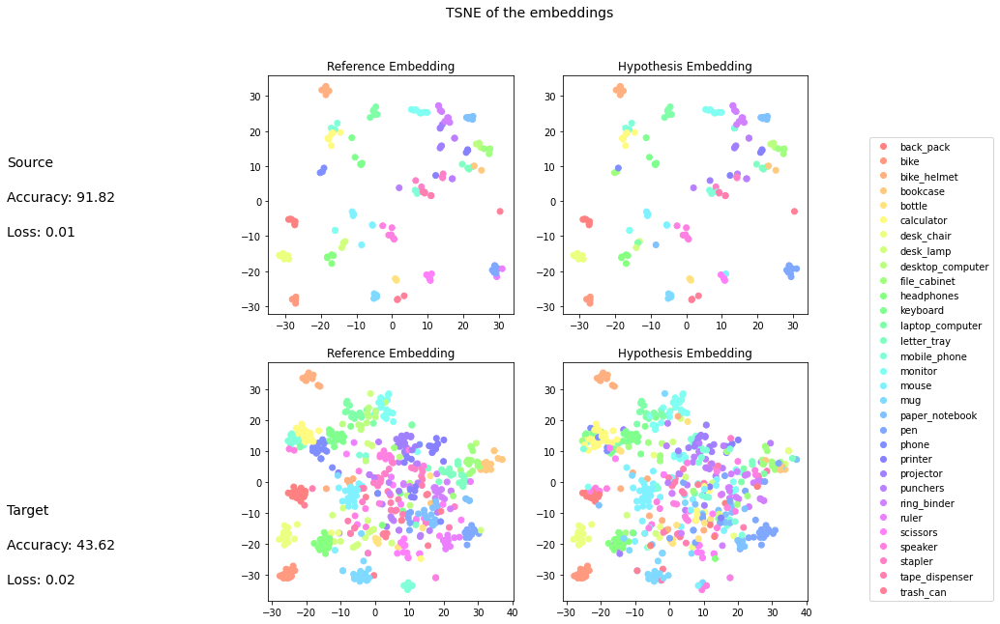

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,0.75,0.86,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,0.67,1.00,0.80,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + FGDA + SDAT

### Train Step

In [ ]:
def training_step_dann_fgda_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    grad_discriminator: nn.Module,
    sdat_optimizer: Any,
    ad_optimizer: Any,
    optimizer_d_grad: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    jacobian_reg,
    lambda_jr,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    mem_label,
    epoch: int,
    lr: float,
    lr_ad: float,
    lr_grad: float,
    lrd,
    curr_iter: int, 
    min_iter: int = 900,
    d_t: int = 0,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  pseudo_label = None

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  grad_discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):

    # sdat_optimizer refers to the Smooth optimizer which contains parameters of the feature extractor and classifier.
    sdat_optimizer.zero_grad()
    # ad_optimizer refers to standard SGD optimizer which contains parameters of domain classifier.
    ad_optimizer.zero_grad()

    # get target data. If the target iterator reaches the end, restart it
    try:
      #inputs_target, _ = next(target_iter)
      inputs_target, _, tar_idx = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      #inputs_target, _ = next(target_iter)
      inputs_target, _, tar_idx = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    #for sdat
    # Calculate task loss
    features_src = extractor(inputs_source)
    pred_class = classifier(features_src)
    loss_class = ce_loss(pred_class, targets)
    loss_class.backward()

    # Calculate ϵ̂ (w) and add it to the weights
    sdat_optimizer.first_step(zero_grad=True) #prova con zero_grad True

    #added
    inputs_source.requires_grad = True
    inputs_target.requires_grad = True

    features_src = extractor(inputs_source)
    features_tgt = extractor(inputs_target)

    features = torch.cat([features_src, features_tgt]).to(device)

    #compute loss_class_src
    pred_class_src = classifier(features_src)
    loss_class_src = ce_loss(pred_class_src, targets)

    #compute loss_class_tgt
    pred_class_tgt = classifier(features_tgt)
    if mem_label is not None:
      pred = mem_label[tar_idx]
      loss_class_tgt = ce_loss(pred_class_tgt, pred)
    else:
      softmax_target = nn.Softmax(dim=1)(pred_class_tgt).detach()
      pseudo_label = softmax_target.data.max(1, keepdim=False)[1]
      loss_class_tgt = ce_loss(pred_class_tgt, pseudo_label) 

    #gradient computation
    gradient_source = torch.autograd.grad(outputs=loss_class_src, inputs=features_src, create_graph=True, retain_graph=True, only_inputs=True)[0]
    gradient_target = torch.autograd.grad(outputs=loss_class_tgt, inputs=features_tgt, create_graph=True, retain_graph=True, only_inputs=True)[0]

    gradients = torch.cat((gradient_source, gradient_target), dim=0)

    src_size, tgt_size, = features_src.size(0), features_tgt.size(0)
    
    #self training
    
    if d_t > 0:
      for _ in range(d_t):
          df_loss, outputs_class = DANN_FGDA(gradients.detach(), grad_discriminator, src_size, tgt_size, train_self=True)
          grad_class_src = outputs_class[0: src_size]
          d_loss_class_src = ce_loss(grad_class_src, targets)
          grad_class_tgt = outputs_class[src_size:]
          if pseudo_label is not None:
              d_loss_class_tgt = ce_loss(grad_class_tgt, pseudo_label)
          else:
              d_loss_class_tgt = ce_loss(grad_class_tgt, pred)
          df_loss = df_loss + d_loss_class_src + d_loss_class_tgt
          df_loss.backward(retain_graph=True)
          optimizer_d_grad.step()
    
    #compute gradient discrimination
    transfer_loss, d_logits = DANN_FGDA(gradients, grad_discriminator, src_size, tgt_size, outputs=True)
    
    transfer_loss.backward(retain_graph=True)

    classifier.zero_grad()

    #jacobian regularization loss
    R = jacobian_reg(features_src, pred_class_src)
    loss_jr = R*lambda_jr

    #da sistemare
    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    pred_domain = discriminator(features)
    pred_class = classifier(features_src)

    loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
    loss_class = ce_loss(pred_class, targets)

    loss_total = loss_domain + loss_class

    loss_reg = loss_total + loss_jr

    loss_reg.backward()
    sdat_optimizer.second_step(zero_grad=True)
    ad_optimizer.step()
    optimizer_d_grad.step()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      #optimizer_d_grad = exp_lr_scheduler(optimizer_d_grad, epoch, lr_grad, lrd, curr_iter) #decrease perforances
      ad_optimizer = exp_lr_scheduler(ad_optimizer, epoch, lr_ad, lrd, curr_iter)
      sdat_optimizer = exp_lr_scheduler(sdat_optimizer, epoch, lr, lrd, curr_iter)


    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, mem_label, curr_iter

In [ ]:
def train_dann_fgda_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    grad_discriminator: nn.Module,
    sdat_optimizer: Any,
    ad_optimizer: Any,
    optimizer_d_grad: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lr_ad: float,
    lr_grad: float,
    lrd,
    lambda_jr: float = 0.01,
    n: int = 1,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:


    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)
    grad_discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    jacobian_reg = JacobianReg(n=1)

    pseudo_label = None
    mem_label = None
    
    curr_iter = 0
    min_iter: int = 900
    d_t = 0

    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, mem_label, curr_iter = training_step_dann_fgda_sdat(extractor, classifier, discriminator, grad_discriminator, sdat_optimizer, ad_optimizer, optimizer_d_grad, ce_loss, bce_loss, jacobian_reg, lambda_jr,
                                                 source_train_loader, target_train_loader, mem_label, epoch, lr, lr_ad, lr_grad, lrd, curr_iter, min_iter, d_t)

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator, grad_discriminator

### DANN + FGDA + SDAT from a -> w

In [ ]:
#{'Training loss': '0.00949', 'Training accuracy': '96.62672', 'Test loss': '0.01676', 'Test accuracy': '71.0691
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

#sgd param
lr = 0.001
lr_ad = 1e-2
lr_grad = 3e-3
wd = 1e-3

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True)



ad_optimizer = get_SGD_optimizer_params_list(list(discriminator.parameters()), lr=lr_ad, wd=wd, momentum=0.9) 

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)

lrd = 0.0002
lambda_jr=0.01
n=1

extractor, classifier, discriminator, grad_discriminator = train_dann_fgda_sdat(extractor, classifier, discriminator, grad_discriminator, sdat_optimizer, ad_optimizer, optimizer_d_grad,
                                                            train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lr_ad, lr_grad, lrd, lambda_jr, n)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_fgda_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_fgda_sdat_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_fgda_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_fgda_sdat_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_sdat_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_sdat_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


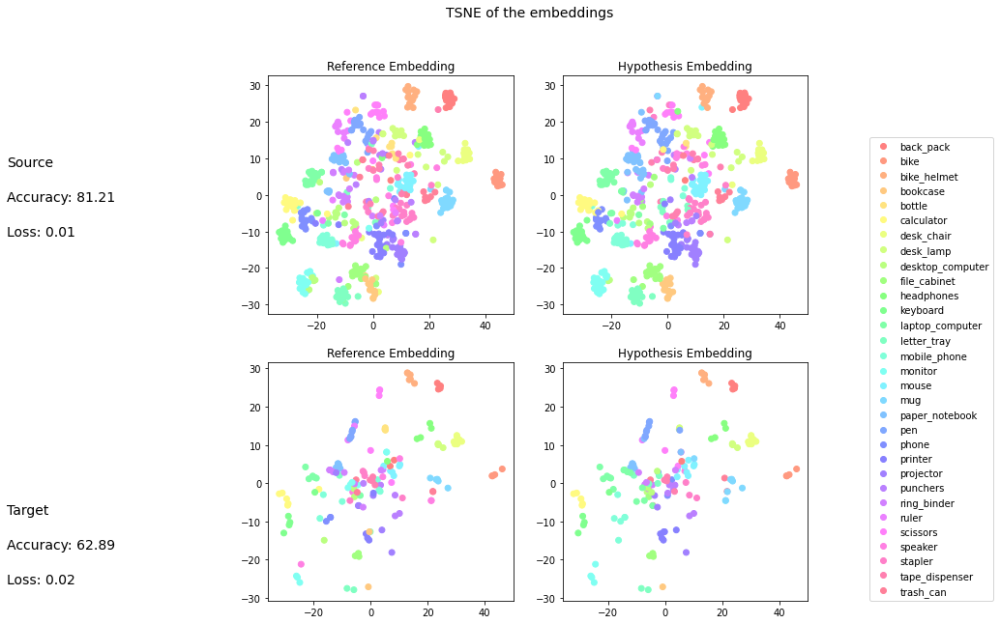

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,0.95,1.00,0.97,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.86,0.92,14.00
bookcase,0.81,0.81,0.81,16.00
bottle,1.00,0.29,0.44,7.00
calculator,0.85,0.89,0.87,19.00
desk_chair,0.94,0.83,0.88,18.00
desk_lamp,0.89,0.85,0.87,20.00
desktop_computer,0.92,0.58,0.71,19.00
file_cabinet,0.67,0.88,0.76,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

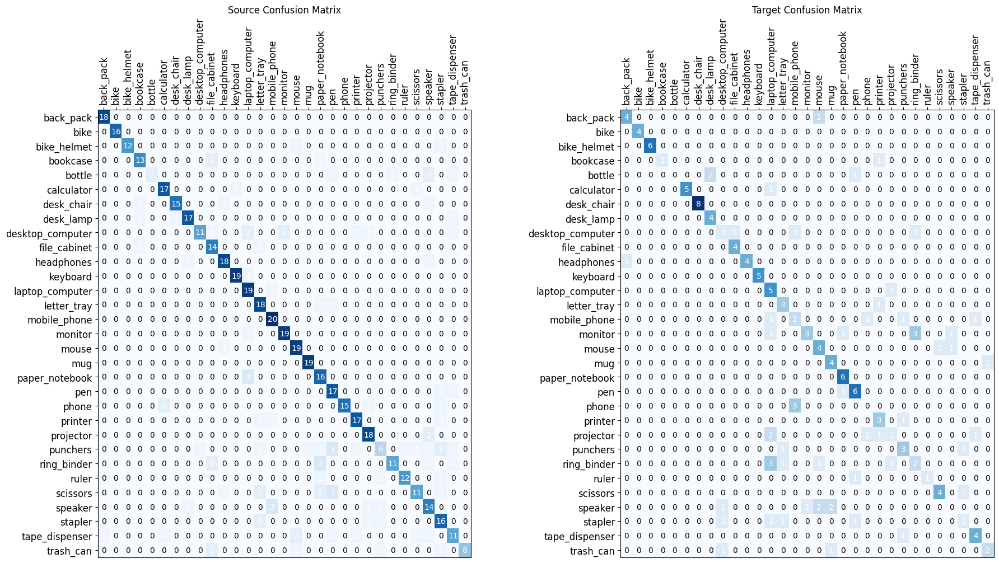

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

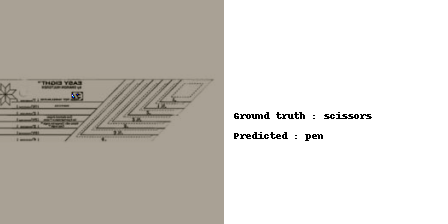

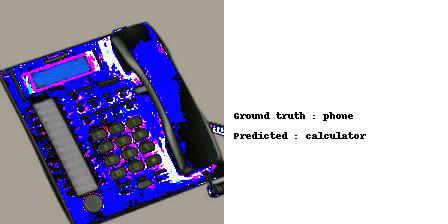

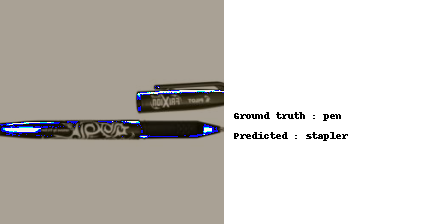

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

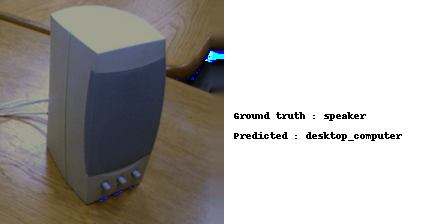

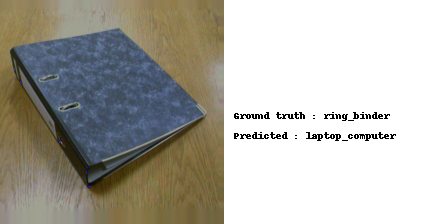

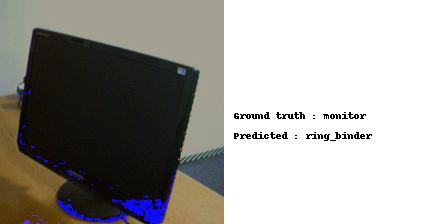

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + FGDA + SDAT from w -> a

In [ ]:
#{'Training loss': '0.00949', 'Training accuracy': '96.62672', 'Test loss': '0.01676', 'Test accuracy': '71.0691
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

#sgd param
lr = 0.001
lr_ad = 1e-2
lr_grad = 3e-3
wd = 1e-3

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True)



ad_optimizer = get_SGD_optimizer_params_list(list(discriminator.parameters()), lr=lr_ad, wd=wd, momentum=0.9) 

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)

lrd = 0.0002
lambda_jr=0.01
n=1

extractor, classifier, discriminator, grad_discriminator = train_dann_fgda_sdat(extractor, classifier, discriminator, grad_discriminator, sdat_optimizer, ad_optimizer, optimizer_d_grad,
                                                            train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lr_ad, lr_grad, lrd, lambda_jr, n)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_fgda_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_fgda_sdat_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_fgda_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_fgda_sdat_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_sdat_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_sdat_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


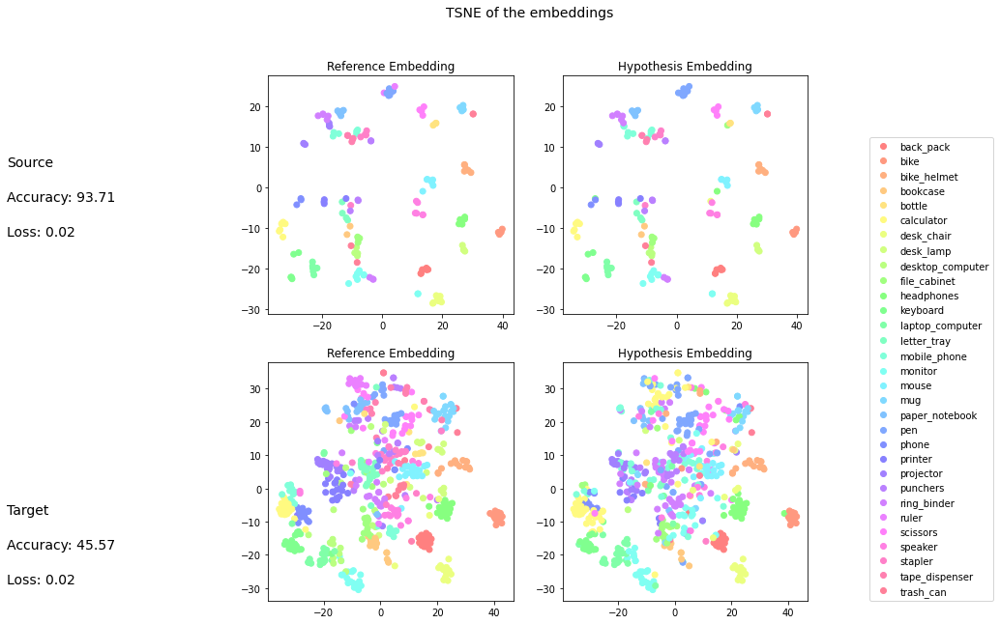

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,0.67,0.80,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,0.89,1.00,0.94,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,0.80,1.00,0.89,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

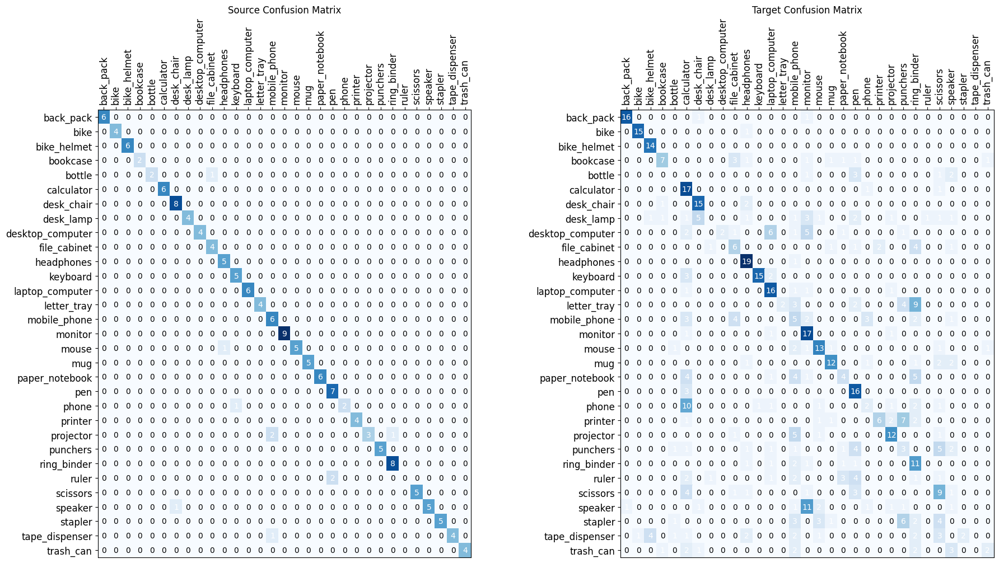

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

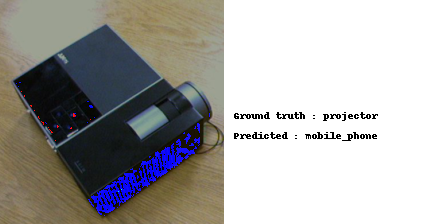

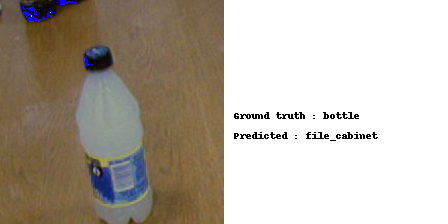

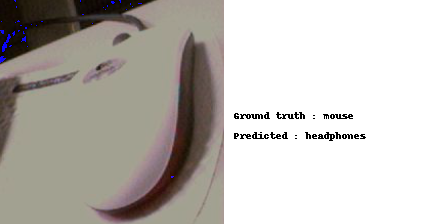

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

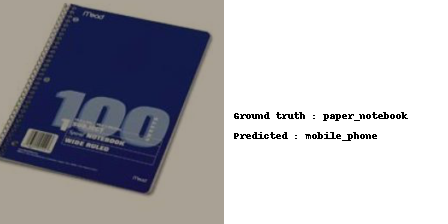

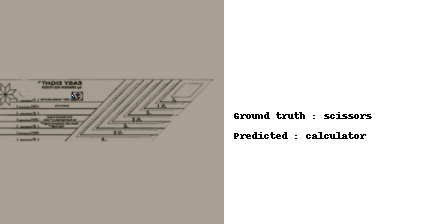

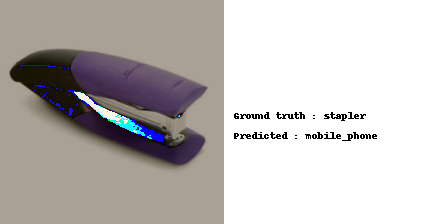

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + FGDA + DALN + SDAT

### Train Step

In [ ]:
def training_step_dann_fgda_daln_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    grad_discriminator: nn.Module,
    sdat_optimizer: Any,
    optimizer_d_grad: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    discrepancy,
    jacobian_reg,
    lambda_jr,
    trade_off_lambda: float,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    mem_label,
    epoch: int, 
    lr: float,
    lr_grad: float,
    lrd: float, 
    curr_iter: int,
    min_iter: int = 900,
    d_t: int = 0,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  pseudo_label = None

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  grad_discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):

    # sdat_optimizer refers to the Smooth optimizer which contains parameters of the feature extractor and classifier.
    sdat_optimizer.zero_grad()

    optimizer_d_grad.zero_grad()

    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, tar_idx = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, tar_idx = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    inputs = torch.cat([inputs_source, inputs_target]).to(device)

    #for sdat
    # Calculate task loss
    features = extractor(inputs)
    pred_class = classifier(features[:inputs_source.shape[0]])
    loss_class = ce_loss(pred_class, targets)
    loss_class.backward()

    # Calculate ϵ̂ (w) and add it to the weights
    sdat_optimizer.first_step(zero_grad=True) #prova con zero_grad True

    #added
    inputs_source.requires_grad = True
    inputs_target.requires_grad = True

    features_src = extractor(inputs_source)
    features_tgt = extractor(inputs_target)

    features = torch.cat([features_src, features_tgt]).to(device)

    #compute loss_class_src
    pred_class_src = classifier(features_src)
    loss_class_src = ce_loss(pred_class_src, targets)

    #compute loss_class_tgt
    pred_class_tgt = classifier(features_tgt)
    if mem_label is not None:
      pred = mem_label[tar_idx]
      loss_class_tgt = ce_loss(pred_class_tgt, pred)
    else:
      softmax_target = nn.Softmax(dim=1)(pred_class_tgt).detach()
      pseudo_label = softmax_target.data.max(1, keepdim=False)[1]
      loss_class_tgt = ce_loss(pred_class_tgt, pseudo_label) 

    #gradient computation
    gradient_source = torch.autograd.grad(outputs=loss_class_src, inputs=features_src, create_graph=True, retain_graph=True, only_inputs=True)[0]
    gradient_target = torch.autograd.grad(outputs=loss_class_tgt, inputs=features_tgt, create_graph=True, retain_graph=True, only_inputs=True)[0]

    gradients = torch.cat((gradient_source, gradient_target), dim=0)

    src_size, tgt_size, = features_src.size(0), features_tgt.size(0)
    
    #self training
    if d_t > 0:
      for _ in range(d_t):
          df_loss, outputs_class = DANN_FGDA(gradients.detach(), grad_discriminator, src_size, tgt_size, train_self=True)
          grad_class_src = outputs_class[0: src_size]
          d_loss_class_src = ce_loss(grad_class_src, targets)
          grad_class_tgt = outputs_class[src_size:]
          if pseudo_label is not None:
              d_loss_class_tgt = ce_loss(grad_class_tgt, pseudo_label)
          else:
              d_loss_class_tgt = ce_loss(grad_class_tgt, pred)
          df_loss = df_loss + d_loss_class_src + d_loss_class_tgt
          df_loss.backward(retain_graph=True)
          optimizer_d_grad.step()
    
    #compute gradient discrimination
    transfer_loss, d_logits = DANN_FGDA(gradients, grad_discriminator, src_size, tgt_size, outputs=True)
    
    transfer_loss.backward(retain_graph=True)

    classifier.zero_grad()

    #jacobian regularization loss
    R = jacobian_reg(features_src, pred_class_src)
    loss_jr = R*lambda_jr

    # prepare domain labels
    domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

    # compute nuclear-norm wasserstein discrepancy between domains
    # for adversarial classifier, minimize negative nwd is equal to maximize nwd
    discrepancy_loss = -discrepancy(features)
    transfer_loss = discrepancy_loss * trade_off_lambda # multiply the lambda to trade off the loss term

    pred_class = classifier(features_src)
    loss_class = ce_loss(pred_class, targets)

    loss_total = transfer_loss + loss_class

    loss_reg = loss_total + loss_jr

    loss_reg.backward()
    sdat_optimizer.second_step(zero_grad=True)
    optimizer_d_grad.step()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      optimizer_d_grad = exp_lr_scheduler(optimizer_d_grad, epoch, lr_grad, lrd, curr_iter)
      sdat_optimizer = exp_lr_scheduler(sdat_optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, mem_label, curr_iter

In [ ]:
def train_dann_fgda_daln_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    grad_discriminator: nn.Module,
    sdat_optimizer: Any,
    optimizer_d_grad: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lr_grad: float, 
    lrd,
    trade_off_lambda: float = 0.8,
    lambda_jr: float = 0.01,
    n: int = 1,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:


    extractor.to(device)
    classifier.to(device)
    grad_discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    jacobian_reg = JacobianReg(n=1)
    discrepancy = NuclearWassersteinDiscrepancy(classifier)

    pseudo_label = None
    mem_label = None
    
    curr_iter = 0
    min_iter: int = 900
    d_t = 0

    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, mem_label, curr_iter = training_step_dann_fgda_daln_sdat(extractor, classifier, grad_discriminator, sdat_optimizer, optimizer_d_grad, ce_loss, bce_loss, discrepancy,
                                                 jacobian_reg, lambda_jr, trade_off_lambda, source_train_loader, target_train_loader, mem_label, epoch, lr, lr_grad, lrd, curr_iter, min_iter, d_t) 

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, grad_discriminator

### DANN + FGDA + DALN + SDAT from a -> w

In [ ]:
#Training loss': '0.00363', 'Training accuracy': '97.20373', 'Test loss': '0.01472', 'Test accuracy': '74.84277
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)

grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

#sgd param
lr=1e-3
wd = 1e-3

lr_grad = 3e-3  
wd_grad = 5e-4

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True) 

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=wd_grad, momentum=0.9)

lrd = 0.0002

trade_off_lambda = 0.8
lambda_jr = 0.01
n = 1

extractor, classifier, grad_discriminator = train_dann_fgda_daln_sdat(extractor, classifier, grad_discriminator, sdat_optimizer, optimizer_d_grad,
                                                                      train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lr_grad, lrd, trade_off_lambda, lambda_jr, n)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_fgda_daln_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_fgda_daln_sdat_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_fgda_daln_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_fgda_daln_sdat_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_daln_sdat_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_daln_sdat_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


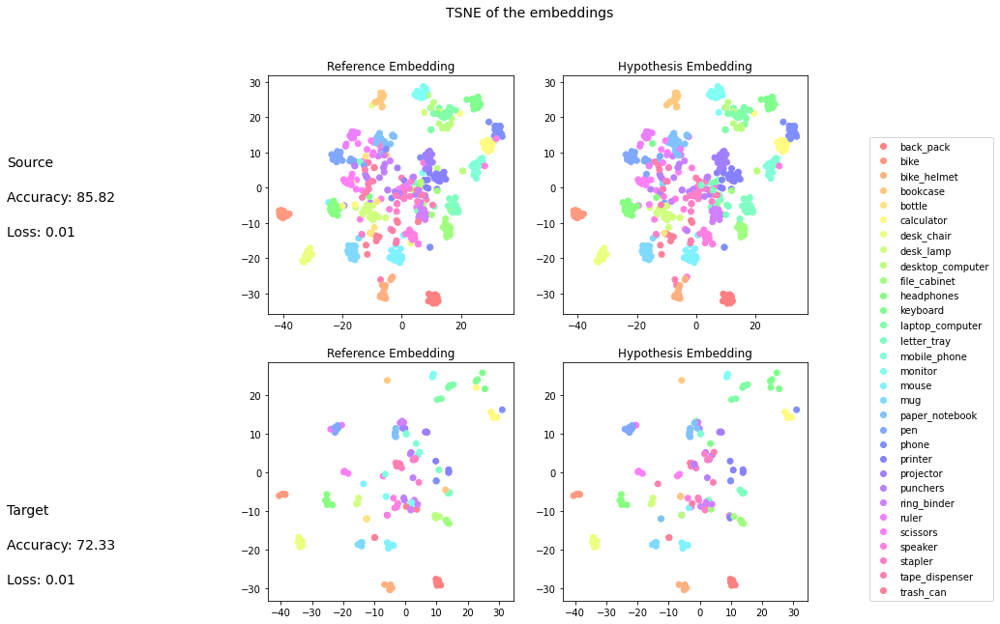

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.86,0.92,14.00
bookcase,0.93,0.88,0.90,16.00
bottle,1.00,0.14,0.25,7.00
calculator,0.95,0.95,0.95,19.00
desk_chair,1.00,0.83,0.91,18.00
desk_lamp,0.95,0.90,0.92,20.00
desktop_computer,0.92,0.58,0.71,19.00
file_cabinet,0.87,0.81,0.84,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

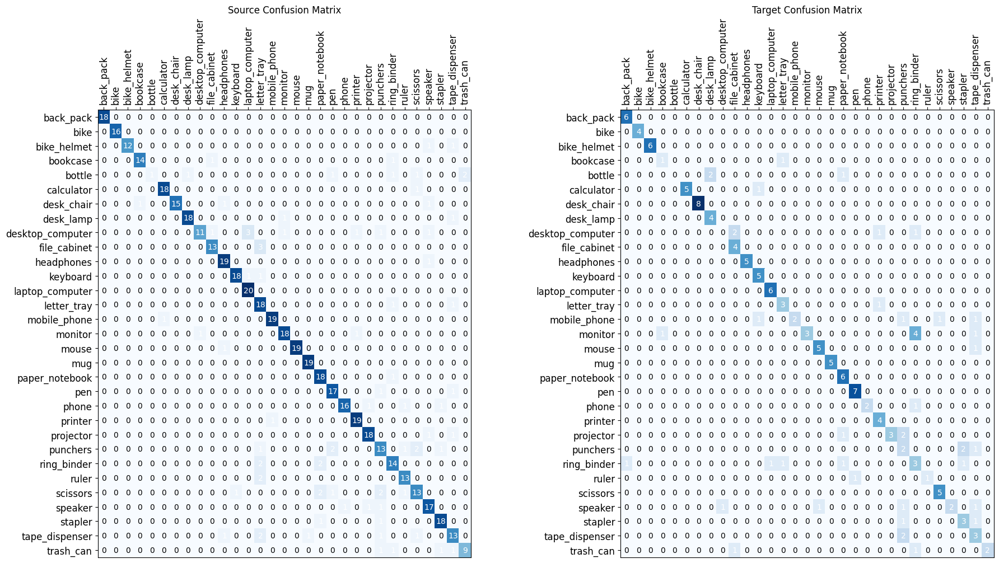

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

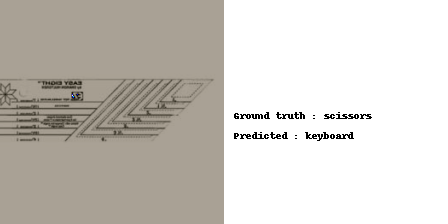

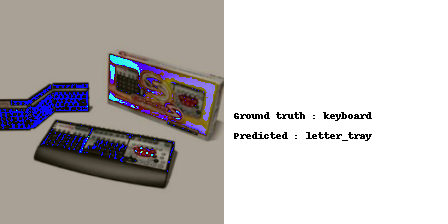

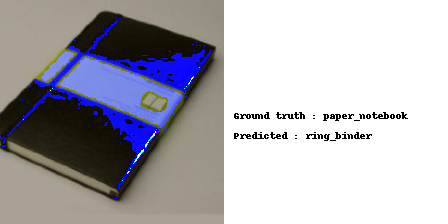

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

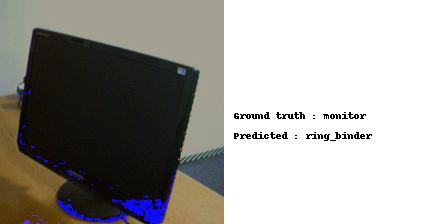

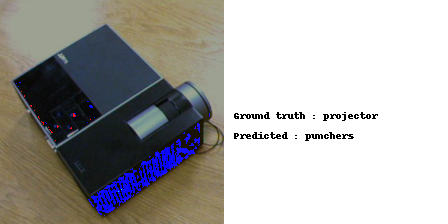

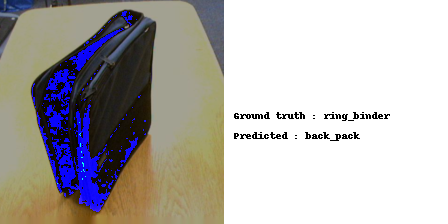

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + FGDA + DALN + SDAT from w -> a

In [ ]:
#Training loss': '0.00363', 'Training accuracy': '97.20373', 'Test loss': '0.01472', 'Test accuracy': '74.84277
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)

grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

#sgd param
lr=1e-3
wd = 1e-3

lr_grad = 3e-3  
wd_grad = 5e-4

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True) 

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=wd_grad, momentum=0.9)

lrd = 0.0002

trade_off_lambda = 0.8
lambda_jr = 0.01
n = 1

extractor, classifier, grad_discriminator = train_dann_fgda_daln_sdat(extractor, classifier, grad_discriminator, sdat_optimizer, optimizer_d_grad,
                                                                      train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lr_grad, lrd, trade_off_lambda, lambda_jr, n)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_fgda_daln_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_fgda_daln_sdat_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_fgda_daln_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_fgda_daln_sdat_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_daln_sdat_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_fgda_daln_sdat_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


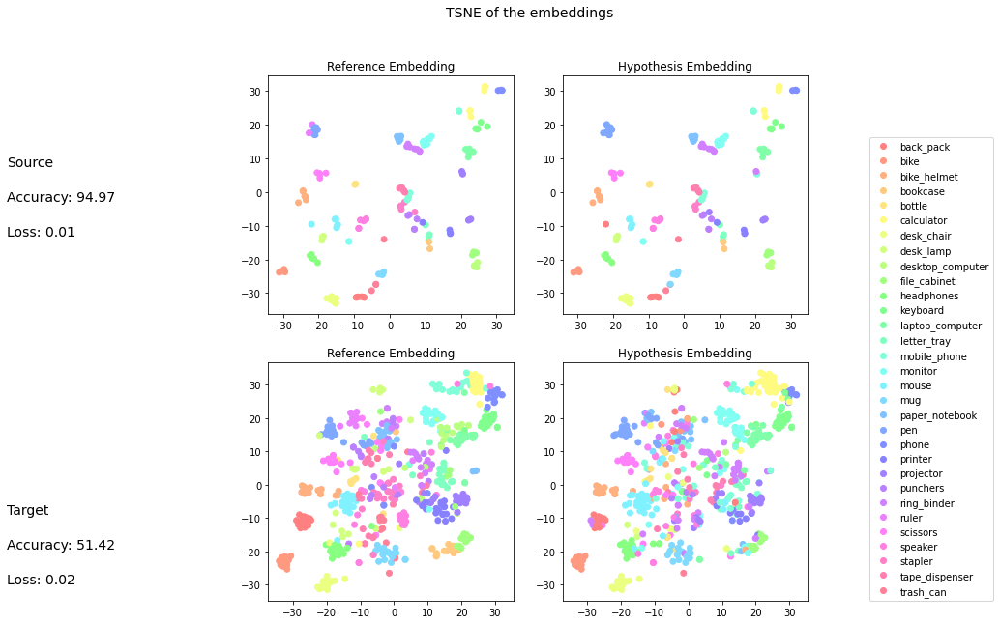

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,0.86,1.00,0.92,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

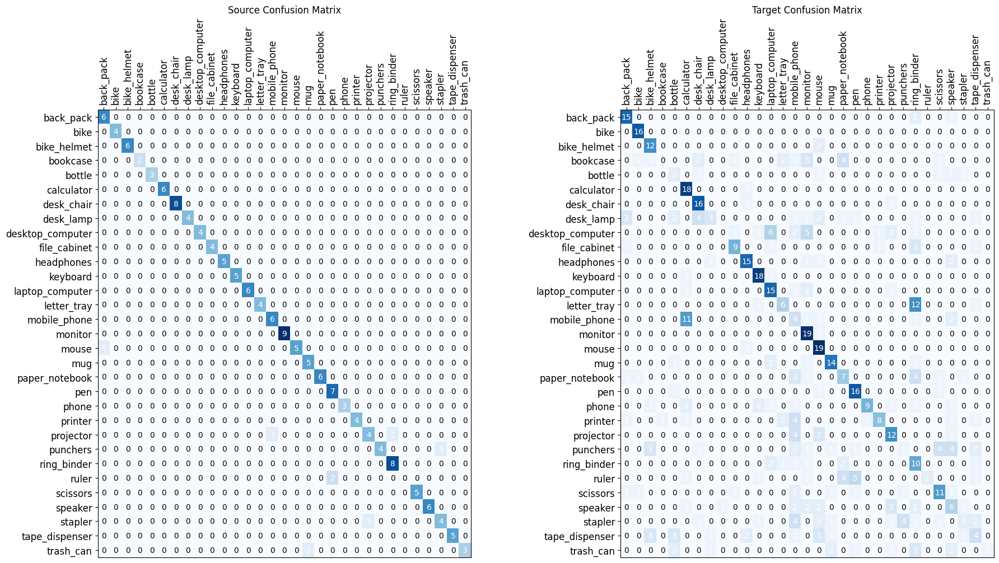

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

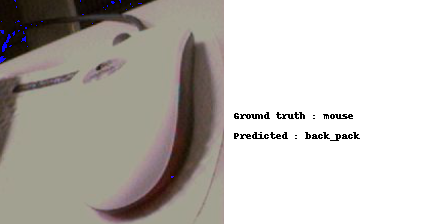

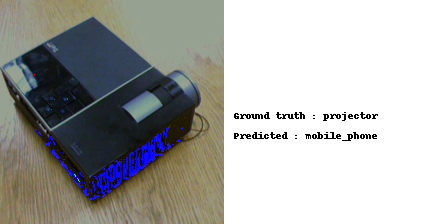

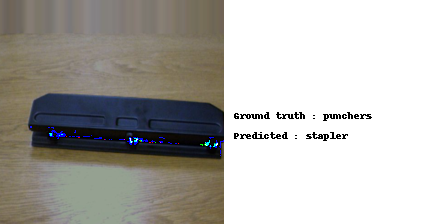

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

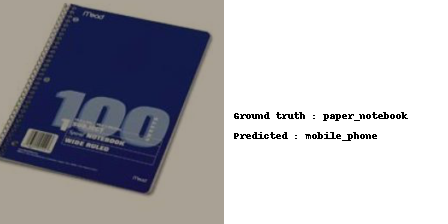

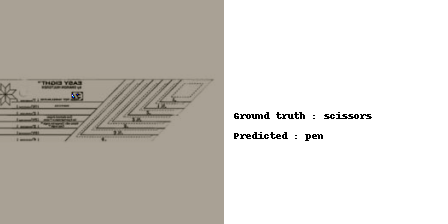

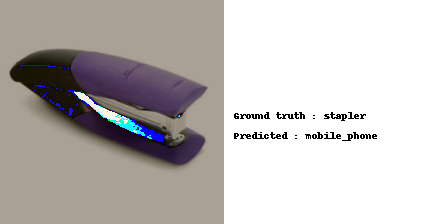

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + RADA + SDAT

### Train Step

In [ ]:
def training_step_dann_rada_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    sdat_optimizer: Any,
    ad_optimizer: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    epoch: int,
    lr: float,
    lr_ad: float,
    lrd,
    curr_iter: int,
    rel_flag = True,
    ent_th = 0.35,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):
    
    # sdat_optimizer refers to the Smooth optimizer which contains parameters of the feature extractor and classifier.
    sdat_optimizer.zero_grad()
    # ad_optimizer refers to standard SGD optimizer which contains parameters of domain classifier.
    ad_optimizer.zero_grad()

    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, _ = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, _ = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    #for sdat
    # Calculate task loss
    features_src = extractor(inputs_source)
    pred_class = classifier(features_src)
    loss_class = ce_loss(pred_class, targets)
    loss_class.backward()

    # Calculate ϵ̂ (w) and add it to the weights
    sdat_optimizer.first_step(zero_grad=True)

    # prepare domain labels
    domain_labels_src = torch.ones(inputs_source.shape[0]).to(device)
    domain_labels_tgt = torch.zeros(inputs_target.shape[0]).to(device)
    domain_labels_tgt_fake = torch.ones(inputs_target.shape[0]).to(device)
    domain_labels = torch.cat([domain_labels_src, domain_labels_tgt])

    well_alligned_tgt_idx = []
    not_well_alligned_tgt_idx = []
    if rel_flag:
      domain_labels_tgt_new = None
      domain_labels_new = None

      features_src = extractor(inputs_source)
      features_tgt = extractor(inputs_target)
      pred_domain_tgt = discriminator(features_tgt)      
      entropy_tgt = entropy_computation(pred_domain_tgt)
      for idx, ent in enumerate(entropy_tgt):
        if ent > ent_th:
          well_alligned_tgt_idx.append(idx)
        else:
          not_well_alligned_tgt_idx.append(idx)
      #print("len well_alligned_tgt_idx: ", len(well_alligned_tgt_idx))
      #print("len not_well_alligned_tgt_idx: ", len(not_well_alligned_tgt_idx))
      
      features = features_src

      if len(well_alligned_tgt_idx) != 0:
        mixup_features = mixup_for_rada(features_src, features_tgt, well_alligned_tgt_idx)

        features_alligned_list = []
        for idx in well_alligned_tgt_idx:
          features_alligned_list.append(features_tgt[idx])
      
        features_alligned = torch.stack(features_alligned_list) 

        mixup_features = mixup_features.to(device)
        features_alligned = features_alligned.to(device)

        features = torch.cat([features, features_alligned, mixup_features])
      
      domain_labels_src_new = torch.ones(features.shape[0]).to(device)

      features_tgt_new_list = []
      for idx in not_well_alligned_tgt_idx:
        features_tgt_new_list.append(features_tgt[idx])

      if len(features_tgt_new_list) != 0:
        features_tgt_new = torch.stack(features_tgt_new_list)
        features_tgt_new = features_tgt_new.to(device)

        features = torch.cat([features, features_tgt_new])

        domain_labels_tgt_new = torch.zeros(features_tgt_new.shape[0]).to(device)

      if domain_labels_tgt_new is not None:
        domain_labels_new = torch.cat([domain_labels_src_new, domain_labels_tgt_new]).to(device)
      else: 
        domain_labels_new = domain_labels_src_new.to(device)

      pred_domain = discriminator(features)
      pred_class = classifier(features_src)

      loss_domain = bce_loss(pred_domain, domain_labels_new.unsqueeze(1))
      loss_class = ce_loss(pred_class, targets)
      loss_total = 0.8*loss_domain + loss_class
    else:
      #adv training
      features_src = extractor(inputs_source)
      features_tgt = extractor(inputs_target)

      features = torch.cat([features_src, features_tgt])

      pred_domain = discriminator(features)
      pred_class = classifier(features_src)

      loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
      loss_class = ce_loss(pred_class, targets)

      loss_total = loss_domain + loss_class

    loss_total.backward()

    # Update parameters (Sharpness-Aware update)
    sdat_optimizer.second_step(zero_grad=True)
    # Update parameters of domain classifier
    ad_optimizer.step()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      ad_optimizer = exp_lr_scheduler(ad_optimizer, epoch, lr_ad, lrd, curr_iter)
      sdat_optimizer = exp_lr_scheduler(sdat_optimizer, epoch, lr, lrd, curr_iter)

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, loss_domain, curr_iter 

In [ ]:
def train_dann_rada_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    sdat_optimizer: Any,
    ad_optimizer: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lr_ad: float,
    lrd,
    K: int = 5,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:
  
    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()

    best_loss_domain = 100
    patience = 0
    rel_flag = False

    curr_iter = 0
    
    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      #print("results for epoch: ", epoch)
      train_loss, train_accuracy, loss_domain, curr_iter = training_step_dann_rada_sdat(extractor, classifier, discriminator, sdat_optimizer, ad_optimizer, ce_loss, bce_loss, 
                                                 source_train_loader, target_train_loader, epoch, lr, lr_ad, lrd, curr_iter, rel_flag) 
      
      if not rel_flag:
        if loss_domain < best_loss_domain:
          best_loss_domain = loss_domain
          patience = 0
        else:
          patience += 1
      
        if patience == K and epoch > 10:
          rel_flag = True
          print("RADA on at epoch: ", epoch)

      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator

### DANN + RADA + SDAT from a -> w

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

lr = 0.001
lr_ad = 1e-2
wd = 1e-3

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True)


ad_optimizer = get_SGD_optimizer_params_list(list(discriminator.parameters()), lr=lr_ad, wd=wd, momentum=0.9) 

lrd = 0.0002

extractor, classifier, discriminator = train_dann_rada_sdat(extractor, classifier, discriminator, sdat_optimizer, ad_optimizer, 
                                                            train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lr_ad, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_rada_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_rada_sdat_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_rada_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_rada_sdat_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_sdat_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_sdat_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


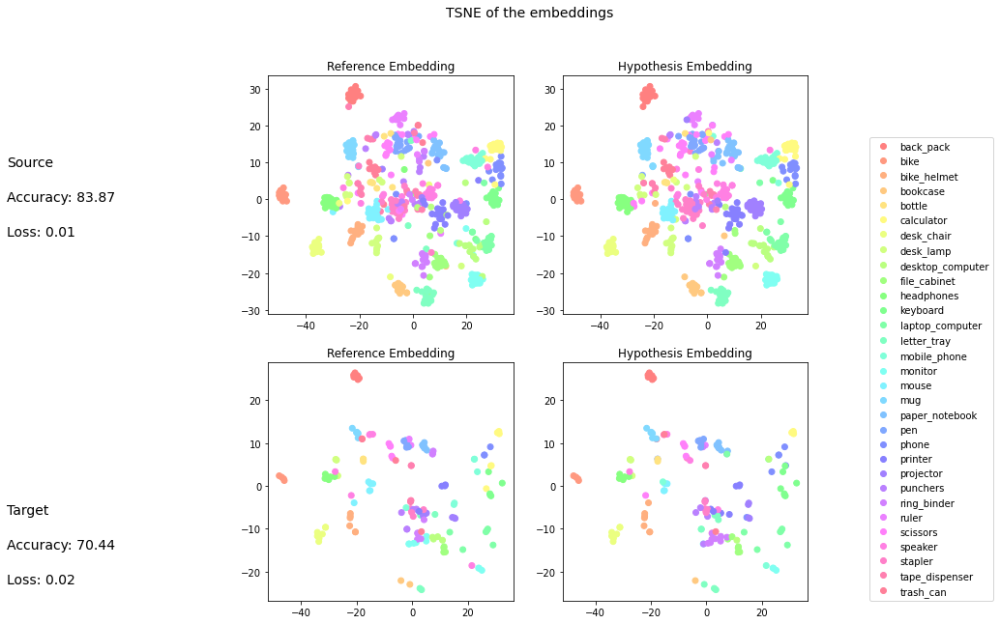

,precision,recall,f1-score,support
back_pack,0.95,1.00,0.97,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,0.93,1.00,0.97,14.00
bookcase,0.82,0.88,0.85,16.00
bottle,1.00,0.57,0.73,7.00
calculator,0.90,0.95,0.92,19.00
desk_chair,0.94,0.83,0.88,18.00
desk_lamp,0.82,0.90,0.86,20.00
desktop_computer,0.75,0.63,0.69,19.00
file_cabinet,0.82,0.88,0.85,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

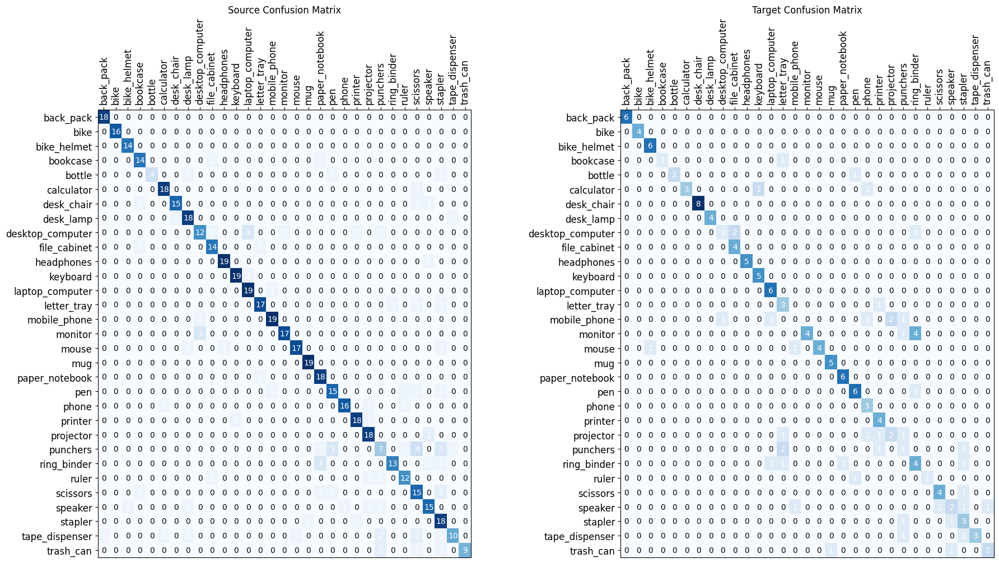

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

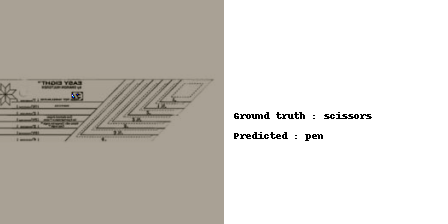

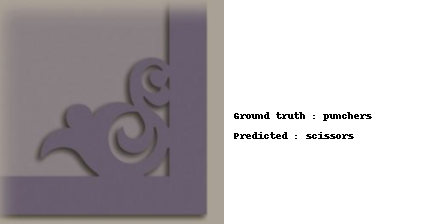

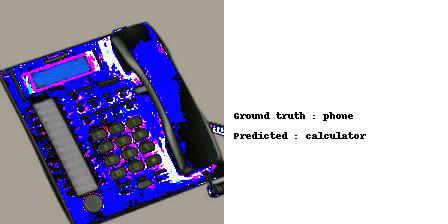

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

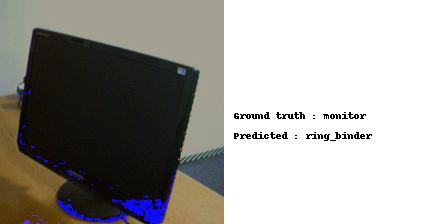

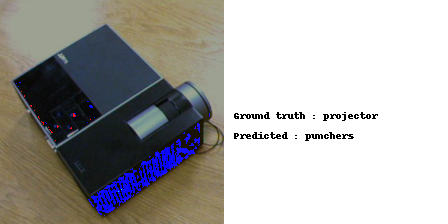

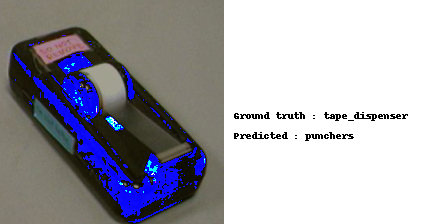

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + RADA + SDAT from w -> a

In [ ]:

extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)

lr = 0.001
lr_ad = 1e-2
wd = 1e-3

sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True)


ad_optimizer = get_SGD_optimizer_params_list(list(discriminator.parameters()), lr=lr_ad, wd=wd, momentum=0.9) 

lrd = 0.0002

extractor, classifier, discriminator = train_dann_rada_sdat(extractor, classifier, discriminator, sdat_optimizer, ad_optimizer, 
                                                            train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lr_ad, lrd)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_rada_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_rada_sdat_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_rada_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_rada_sdat_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_sdat_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_sdat_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


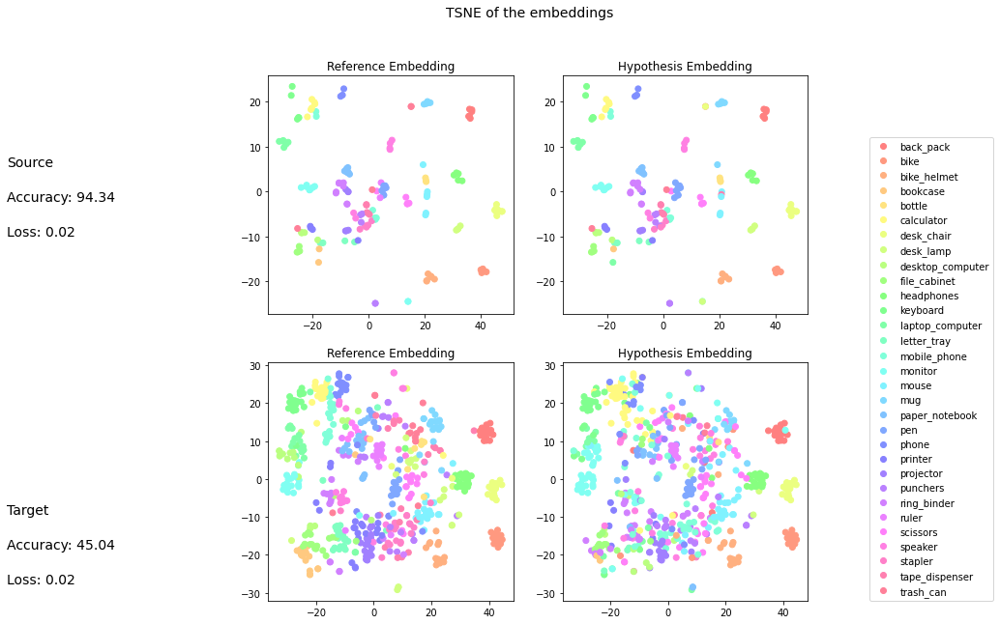

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,0.50,0.67,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,0.89,1.00,0.94,8.00
desk_lamp,0.80,1.00,0.89,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

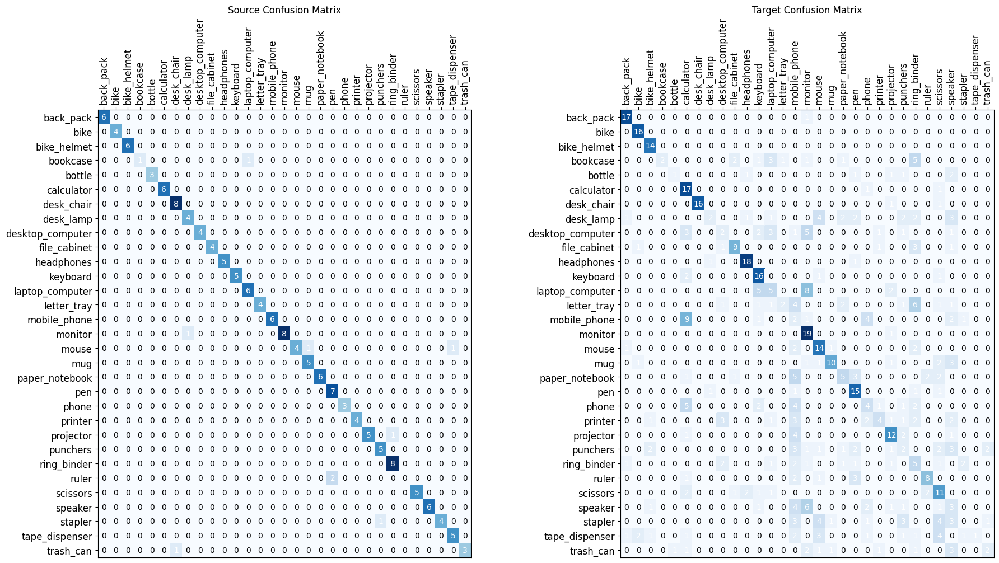

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

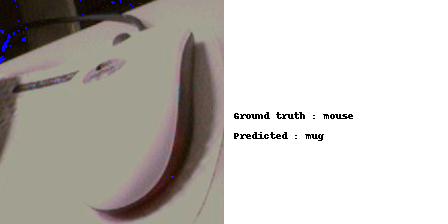

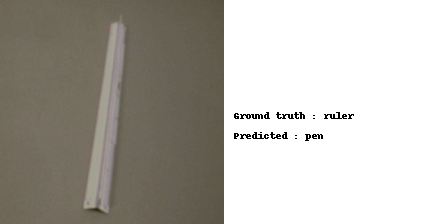

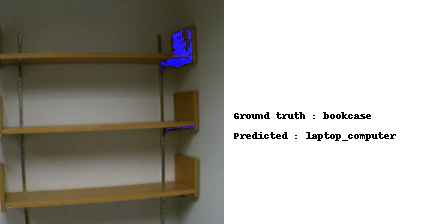

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

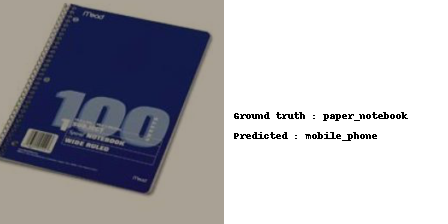

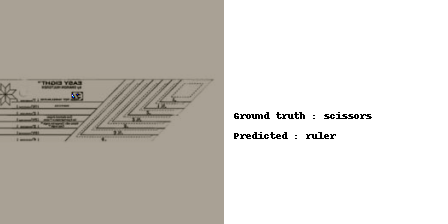

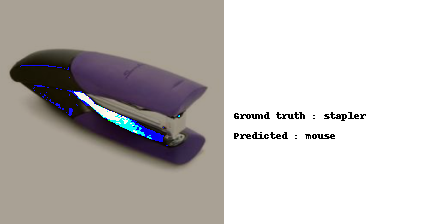

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + RADA + FGDA

### Train Step

In [ ]:
def training_step_dann_rada_fgda(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    grad_discriminator: nn.Module,
    optimizer: Any,
    optimizer_d_grad: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    jacobian_reg,
    lambda_jr,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    mem_label,
    epoch: int,
    lr: float,
    lr_grad: float,
    lrd,
    curr_iter: int, 
    min_iter: int = 900,
    d_t: int = 0,
    rel_flag = True,
    ent_th = 0.35,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  pseudo_label = None

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  grad_discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):

    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, tar_idx = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, tar_idx = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    #added
    inputs_source.requires_grad = True
    inputs_target.requires_grad = True


    # prepare domain labels
    domain_labels_src = torch.ones(inputs_source.shape[0]).to(device)
    domain_labels_tgt = torch.zeros(inputs_target.shape[0]).to(device)
    domain_labels = torch.cat([domain_labels_src, domain_labels_tgt])

    well_alligned_tgt_idx = []
    not_well_alligned_tgt_idx = []
    if rel_flag:
      domain_labels_tgt_new = None
      domain_labels_new = None

      features_src = extractor(inputs_source)
      features_tgt = extractor(inputs_target)
      features = torch.cat([features_src, features_tgt]).to(device)

      pred_domain_tgt = discriminator(features_tgt)      
      entropy_tgt = entropy_computation(pred_domain_tgt)
      for idx, ent in enumerate(entropy_tgt):
        if ent > ent_th:
          well_alligned_tgt_idx.append(idx)
        else:
          not_well_alligned_tgt_idx.append(idx)
      #print("len well_alligned_tgt_idx: ", len(well_alligned_tgt_idx))
      #print("len not_well_alligned_tgt_idx: ", len(not_well_alligned_tgt_idx))
      
      features = features_src

      if len(well_alligned_tgt_idx) != 0:
        mixup_features = mixup_for_rada(features_src, features_tgt, well_alligned_tgt_idx)

        features_alligned_list = []
        for idx in well_alligned_tgt_idx:
          features_alligned_list.append(features_tgt[idx])
      
        features_alligned = torch.stack(features_alligned_list) 

        mixup_features = mixup_features.to(device)
        features_alligned = features_alligned.to(device)

        features = torch.cat([features, features_alligned, mixup_features])
      
      domain_labels_src_new = torch.ones(features.shape[0]).to(device)

      features_tgt_new_list = []
      for idx in not_well_alligned_tgt_idx:
        features_tgt_new_list.append(features_tgt[idx])

      if len(features_tgt_new_list) != 0:
        features_tgt_new = torch.stack(features_tgt_new_list)
        features_tgt_new = features_tgt_new.to(device)

        features = torch.cat([features, features_tgt_new])

        domain_labels_tgt_new = torch.zeros(features_tgt_new.shape[0]).to(device)

      if domain_labels_tgt_new is not None:
        domain_labels_new = torch.cat([domain_labels_src_new, domain_labels_tgt_new]).to(device)
      else: 
        domain_labels_new = domain_labels_src_new.to(device)


      #fgda
      #compute loss_class_src
      pred_class_src = classifier(features_src)
      loss_class_src = ce_loss(pred_class_src, targets)

      #compute loss_class_tgt
      pred_class_tgt = classifier(features_tgt)
      if mem_label is not None:
        pred = mem_label[tar_idx]
        loss_class_tgt = ce_loss(pred_class_tgt, pred)
      else:
        softmax_target = nn.Softmax(dim=1)(pred_class_tgt).detach()
        pseudo_label = softmax_target.data.max(1, keepdim=False)[1]
        loss_class_tgt = ce_loss(pred_class_tgt, pseudo_label) 
      
      #gradient computation
      gradient_source = torch.autograd.grad(outputs=loss_class_src, inputs=features_src, create_graph=True, retain_graph=True, only_inputs=True)[0]
      gradient_target = torch.autograd.grad(outputs=loss_class_tgt, inputs=features_tgt, create_graph=True, retain_graph=True, only_inputs=True)[0]

      gradients = torch.cat((gradient_source, gradient_target), dim=0)

      src_size, tgt_size, = features_src.size(0), features_tgt.size(0)

      #self training
    
      if d_t > 0:
        for _ in range(d_t):
            df_loss, outputs_class = DANN_FGDA(gradients.detach(), grad_discriminator, src_size, tgt_size, train_self=True)
            grad_class_src = outputs_class[0: src_size]
            d_loss_class_src = ce_loss(grad_class_src, targets)
            grad_class_tgt = outputs_class[src_size:]
            if pseudo_label is not None:
                d_loss_class_tgt = ce_loss(grad_class_tgt, pseudo_label)
            else:
                d_loss_class_tgt = ce_loss(grad_class_tgt, pred)
            df_loss = df_loss + d_loss_class_src + d_loss_class_tgt
            df_loss.backward(retain_graph=True)
            optimizer_d_grad.step()

      #compute gradient discrimination
      transfer_loss, d_logits = DANN_FGDA(gradients, grad_discriminator, src_size, tgt_size, outputs=True)

      transfer_loss.backward(retain_graph=True)

      classifier.zero_grad()

      #jacobian regularization loss
      R = jacobian_reg(features_src, pred_class_src)
      loss_jr = R*lambda_jr

      pred_domain = discriminator(features)
      pred_class = classifier(features_src)

      loss_domain = bce_loss(pred_domain, domain_labels_new.unsqueeze(1))
      loss_class = ce_loss(pred_class, targets)
      loss_total = 0.8*loss_domain + loss_class

      loss_reg = loss_total + loss_jr

    else:
      #adv training
      features_src = extractor(inputs_source)
      features_tgt = extractor(inputs_target)

      features = torch.cat([features_src, features_tgt])

      #compute loss_class_src
      pred_class_src = classifier(features_src)
      loss_class_src = ce_loss(pred_class_src, targets)

      #compute loss_class_tgt
      pred_class_tgt = classifier(features_tgt)
      if mem_label is not None:
        pred = mem_label[tar_idx]
        loss_class_tgt = ce_loss(pred_class_tgt, pred)
      else:
        softmax_target = nn.Softmax(dim=1)(pred_class_tgt).detach()
        pseudo_label = softmax_target.data.max(1, keepdim=False)[1]
        loss_class_tgt = ce_loss(pred_class_tgt, pseudo_label) 

      #gradient computation
      gradient_source = torch.autograd.grad(outputs=loss_class_src, inputs=features_src, create_graph=True, retain_graph=True, only_inputs=True)[0]
      gradient_target = torch.autograd.grad(outputs=loss_class_tgt, inputs=features_tgt, create_graph=True, retain_graph=True, only_inputs=True)[0]

      gradients = torch.cat((gradient_source, gradient_target), dim=0)

      src_size, tgt_size, = features_src.size(0), features_tgt.size(0)
    
      #self training
    
      if d_t > 0:
        for _ in range(d_t):
            df_loss, outputs_class = DANN_FGDA(gradients.detach(), grad_discriminator, src_size, tgt_size, train_self=True)
            grad_class_src = outputs_class[0: src_size]
            d_loss_class_src = ce_loss(grad_class_src, targets)
            grad_class_tgt = outputs_class[src_size:]
            if pseudo_label is not None:
                d_loss_class_tgt = ce_loss(grad_class_tgt, pseudo_label)
            else:
                d_loss_class_tgt = ce_loss(grad_class_tgt, pred)
            df_loss = df_loss + d_loss_class_src + d_loss_class_tgt
            df_loss.backward(retain_graph=True)
            optimizer_d_grad.step()
    
      #compute gradient discrimination
      transfer_loss, d_logits = DANN_FGDA(gradients, grad_discriminator, src_size, tgt_size, outputs=True)
    
      transfer_loss.backward(retain_graph=True)

      classifier.zero_grad()

      #jacobian regularization loss
      R = jacobian_reg(features_src, pred_class_src)
      loss_jr = R*lambda_jr

      # prepare domain labels
      domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

      pred_domain = discriminator(features)
      pred_class = classifier(features_src)

      loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
      loss_class = ce_loss(pred_class, targets)

      loss_total = loss_domain + loss_class

      loss_reg = loss_total + loss_jr

    loss_reg.backward()
    optimizer.step()
    optimizer_d_grad.step()

    optimizer_d_grad.zero_grad()
    optimizer.zero_grad()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      optimizer = exp_lr_scheduler(optimizer, epoch, lr, lrd, curr_iter)
      #optimizer_d_grad = exp_lr_scheduler(optimizer_d_grad, epoch, lr_grad, lrd, curr_iter) #decrease performances

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, mem_label, loss_domain, curr_iter

In [ ]:
def train_dann_rada_fgda(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    grad_discriminator: nn.Module,
    optimizer: Any,
    optimizer_d_grad: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lr_grad: float,
    lrd,
    K=5,
    ent_th = 0.35,
    lambda_jr: float = 0.01,
    n: int = 1,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:


    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)
    grad_discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    jacobian_reg = JacobianReg(n=1)

    pseudo_label = None
    mem_label = None
    
    curr_iter = 0
    min_iter: int = 900
    d_t = 0

    best_loss_domain = 100
    patience = 0
    rel_flag = False

    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, mem_label, loss_domain, curr_iter = training_step_dann_rada_fgda(extractor, classifier, discriminator, grad_discriminator, optimizer, optimizer_d_grad, ce_loss, bce_loss, jacobian_reg, lambda_jr,
                                                 source_train_loader, target_train_loader, mem_label, epoch, lr, lr_grad, lrd, curr_iter, min_iter, d_t, rel_flag, ent_th) 
      
      if not rel_flag:
        if loss_domain < best_loss_domain:
          best_loss_domain = loss_domain
          patience = 0
        else:
          patience += 1
      
        if patience == K and epoch > 10:
          rel_flag = True
          print("RADA on at epoch: ", epoch)


      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator, grad_discriminator

### DANN + RADA + FGDA from a -> w

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)


grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
lr_grad = 3e-3
wd = 1e-4


optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)

lrd = 0.0002
lambda_jr=0.01
n=1
K=5
ent_th = 0.35

extractor, classifier, discriminator, grad_discriminator = train_dann_rada_fgda(extractor, classifier, discriminator, grad_discriminator, optim, optimizer_d_grad, train_loader_a, test_loader_a, 
                                                                            train_loader_w, test_loader_w, lr, lr_grad, lrd, K, ent_th, lambda_jr, n)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_rada_fgda_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_rada_fgda_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_rada_fgda_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_rada_fgda_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_fgda_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_fgda_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


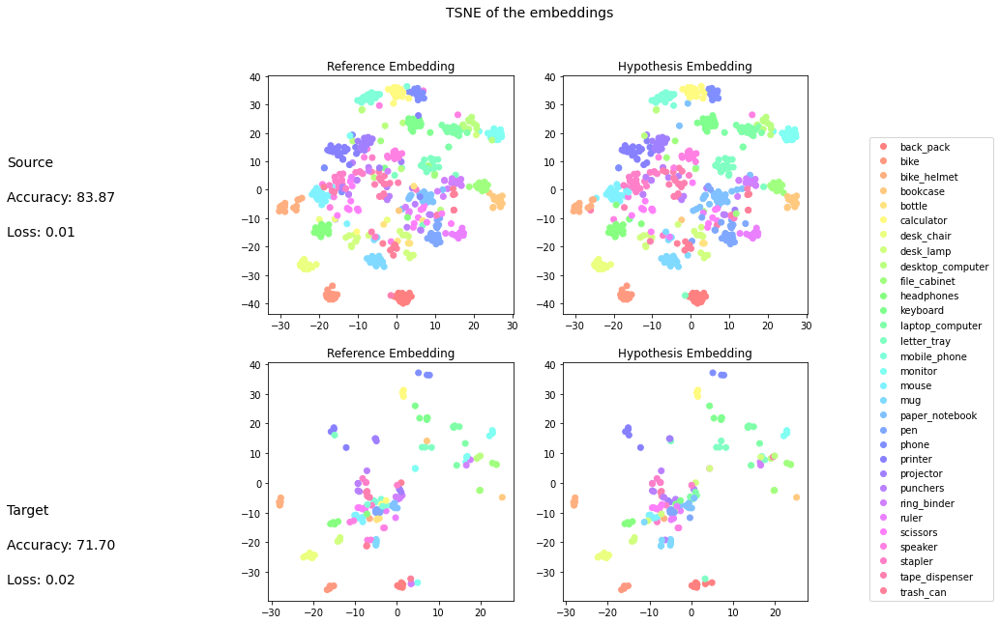

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,1.00,0.86,0.92,14.00
bookcase,0.93,0.88,0.90,16.00
bottle,1.00,0.43,0.60,7.00
calculator,0.85,0.89,0.87,19.00
desk_chair,1.00,0.83,0.91,18.00
desk_lamp,0.89,0.85,0.87,20.00
desktop_computer,0.79,0.58,0.67,19.00
file_cabinet,0.71,0.75,0.73,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

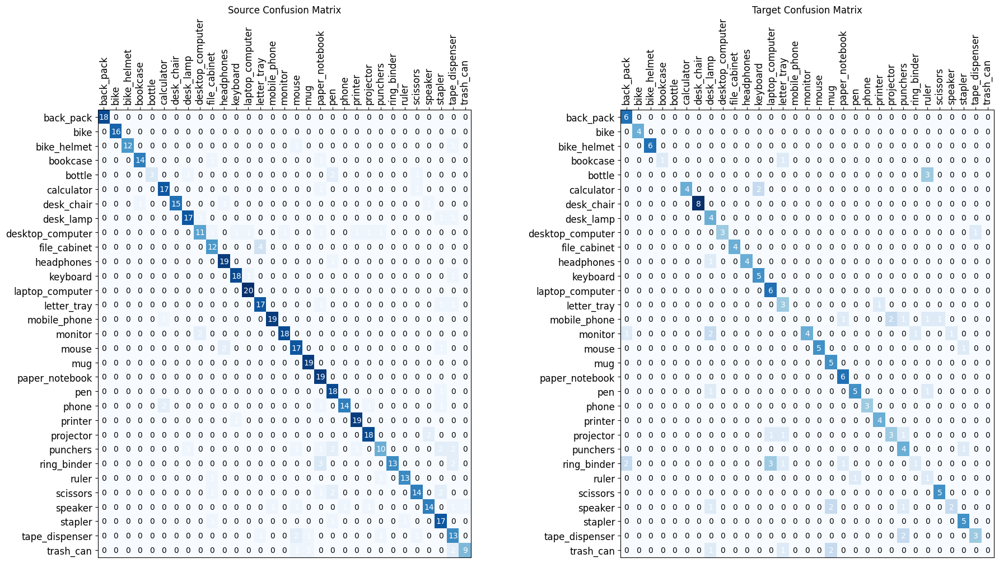

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

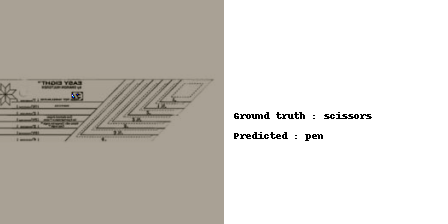

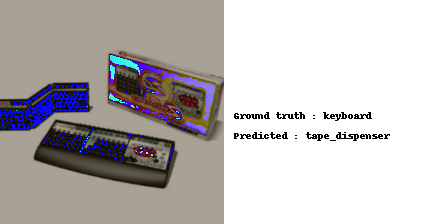

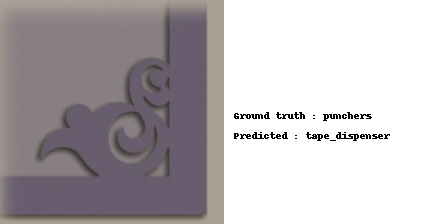

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

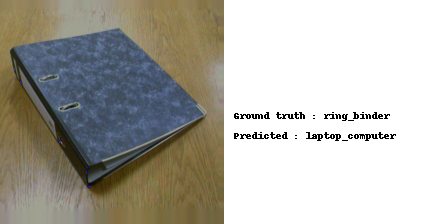

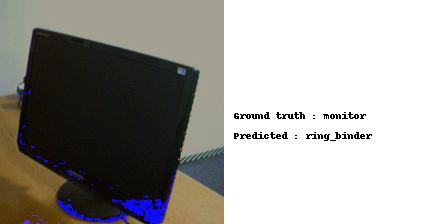

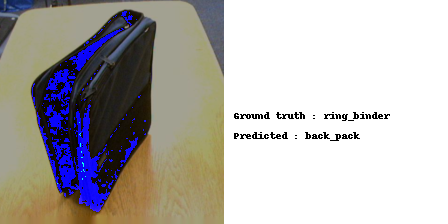

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + RADA + FGDA from w -> a

In [ ]:
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)


grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
lr_grad = 3e-3
wd = 1e-4


optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)

lrd = 0.0002
lambda_jr=0.01
n=1
K=5
ent_th = 0.35

extractor, classifier, discriminator, grad_discriminator = train_dann_rada_fgda(extractor, classifier, discriminator, grad_discriminator, optim, optimizer_d_grad, train_loader_w, test_loader_w, 
                                                                            train_loader_a, test_loader_a, lr, lr_grad, lrd, K, ent_th, lambda_jr, n)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_rada_fgda_extractor_w_a_path)
torch.save(classifier.state_dict(), resnet18_dann_rada_fgda_classifier_w_a_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_rada_fgda_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_rada_fgda_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_fgda_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_fgda_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


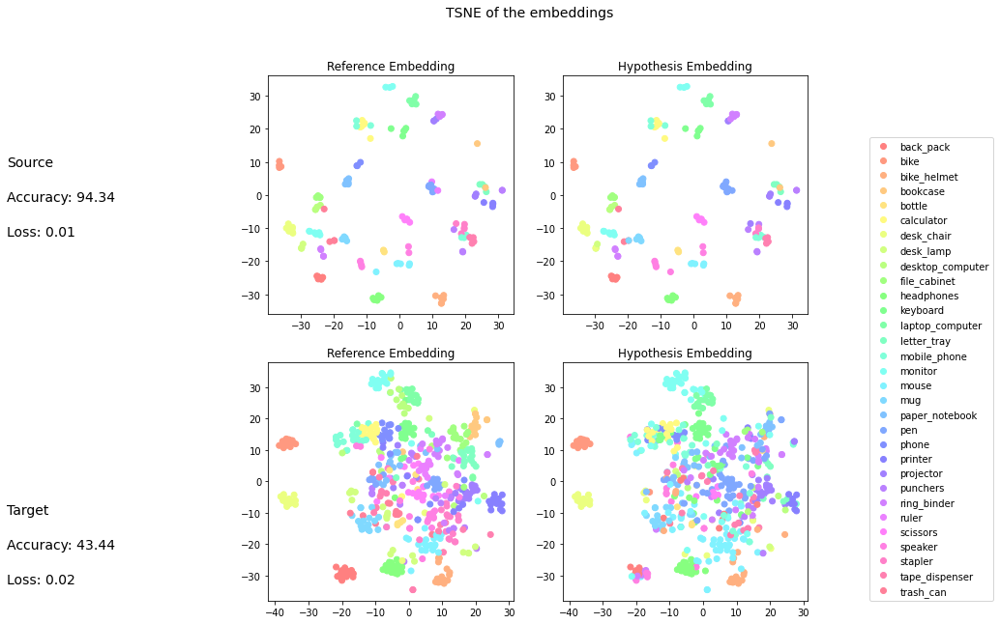

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,1.00,1.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,0.89,1.00,0.94,8.00
desk_lamp,1.00,0.75,0.86,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

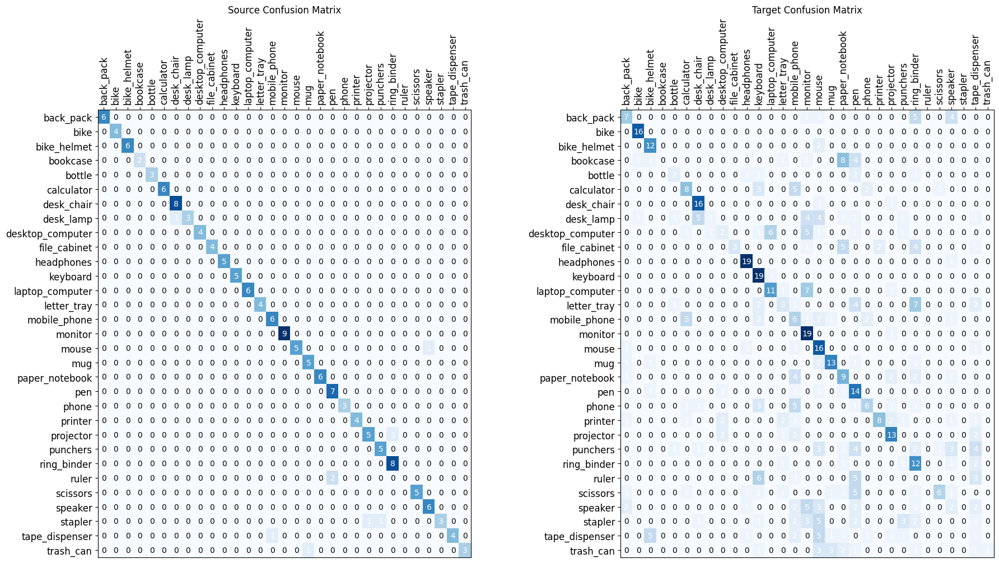

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

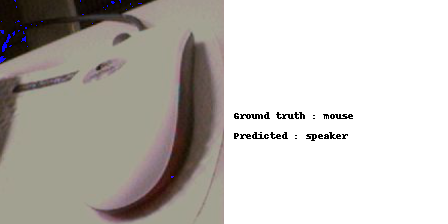

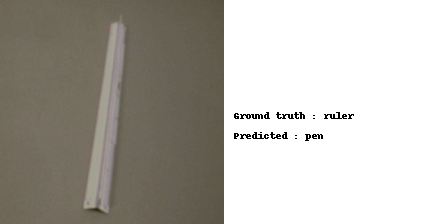

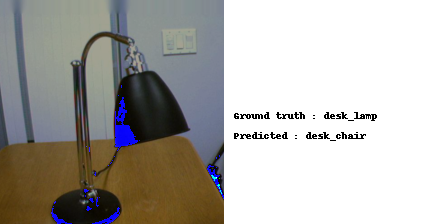

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

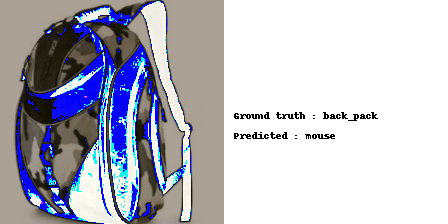

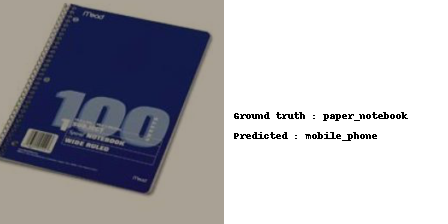

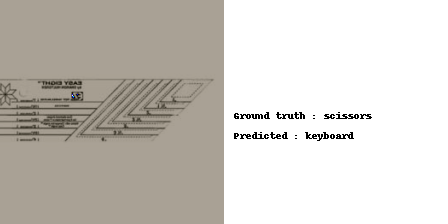

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## DANN + RADA + FGDA + SDAT

### Train Step

In [ ]:
def training_step_dann_rada_fgda_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    grad_discriminator: nn.Module,
    sdat_optimizer: Any,
    ad_optimizer: Any,
    optimizer_d_grad: Any,
    ce_loss: nn.Module,
    bce_loss: nn.Module,
    jacobian_reg,
    lambda_jr,
    source_data_loader: Iterable,
    target_data_loader: Iterable,
    mem_label,
    epoch: int,
    lr: float,
    lr_ad: float,
    lr_grad: float,
    lrd,
    curr_iter: int, 
    min_iter: int = 900,
    d_t: int = 0,
    rel_flag = True,
    ent_th = 0.35,
    device="cuda:0") -> Tuple[float, float]:

  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  pseudo_label = None

  target_iter = iter(target_data_loader)
  
  extractor.train()
  classifier.train()
  discriminator.train()
  grad_discriminator.train()
  
  pbar = tqdm(range(len(source_data_loader)),position=0, leave=False)
  for a, (batch_idx, (inputs_source, targets, _)) in zip(pbar, enumerate(source_data_loader)):

    # sdat_optimizer refers to the Smooth optimizer which contains parameters of the feature extractor and classifier.
    sdat_optimizer.zero_grad()
    # ad_optimizer refers to standard SGD optimizer which contains parameters of domain classifier.
    ad_optimizer.zero_grad()
    optimizer_d_grad.zero_grad()

    # get target data. If the target iterator reaches the end, restart it
    try:
      inputs_target, _, tar_idx = next(target_iter)
    except:
      target_iter = iter(target_data_loader)
      inputs_target, _, tar_idx = next(target_iter)

    inputs_source = inputs_source.to(device)
    inputs_target = inputs_target.to(device)
    targets = targets.to(device)

    # Calculate task loss
    features_src = extractor(inputs_source)
    pred_class = classifier(features_src)
    loss_class = ce_loss(pred_class, targets)
    loss_class.backward()

    # Calculate ϵ̂ (w) and add it to the weights
    sdat_optimizer.first_step(zero_grad=True) 

    #added
    inputs_source.requires_grad = True
    inputs_target.requires_grad = True


    # prepare domain labels
    domain_labels_src = torch.ones(inputs_source.shape[0]).to(device)
    domain_labels_tgt = torch.zeros(inputs_target.shape[0]).to(device)
    domain_labels = torch.cat([domain_labels_src, domain_labels_tgt])

    well_alligned_tgt_idx = []
    not_well_alligned_tgt_idx = []
    if rel_flag:
      domain_labels_tgt_new = None
      domain_labels_new = None

      features_src = extractor(inputs_source)
      features_tgt = extractor(inputs_target)
      features = torch.cat([features_src, features_tgt]).to(device)

      pred_domain_tgt = discriminator(features_tgt)      
      entropy_tgt = entropy_computation(pred_domain_tgt)
      for idx, ent in enumerate(entropy_tgt):
        if ent > ent_th:
          well_alligned_tgt_idx.append(idx)
        else:
          not_well_alligned_tgt_idx.append(idx)
      #print("len well_alligned_tgt_idx: ", len(well_alligned_tgt_idx))
      #print("len not_well_alligned_tgt_idx: ", len(not_well_alligned_tgt_idx))
      
      features = features_src

      if len(well_alligned_tgt_idx) != 0:
        mixup_features = mixup_for_rada(features_src, features_tgt, well_alligned_tgt_idx)

        features_alligned_list = []
        for idx in well_alligned_tgt_idx:
          features_alligned_list.append(features_tgt[idx])
      
        features_alligned = torch.stack(features_alligned_list) 

        mixup_features = mixup_features.to(device)
        features_alligned = features_alligned.to(device)

        features = torch.cat([features, features_alligned, mixup_features])
      
      domain_labels_src_new = torch.ones(features.shape[0]).to(device)

      features_tgt_new_list = []
      for idx in not_well_alligned_tgt_idx:
        features_tgt_new_list.append(features_tgt[idx])

      if len(features_tgt_new_list) != 0:
        features_tgt_new = torch.stack(features_tgt_new_list)
        features_tgt_new = features_tgt_new.to(device)

        features = torch.cat([features, features_tgt_new])

        domain_labels_tgt_new = torch.zeros(features_tgt_new.shape[0]).to(device)

      if domain_labels_tgt_new is not None:
        domain_labels_new = torch.cat([domain_labels_src_new, domain_labels_tgt_new]).to(device)
      else: 
        domain_labels_new = domain_labels_src_new.to(device)


      #fgda
      #compute loss_class_src
      pred_class_src = classifier(features_src)
      loss_class_src = ce_loss(pred_class_src, targets)

      #compute loss_class_tgt
      pred_class_tgt = classifier(features_tgt)
      if mem_label is not None:
        pred = mem_label[tar_idx]
        loss_class_tgt = ce_loss(pred_class_tgt, pred)
      else:
        softmax_target = nn.Softmax(dim=1)(pred_class_tgt).detach()
        pseudo_label = softmax_target.data.max(1, keepdim=False)[1]
        loss_class_tgt = ce_loss(pred_class_tgt, pseudo_label) 
      
      #gradient computation
      gradient_source = torch.autograd.grad(outputs=loss_class_src, inputs=features_src, create_graph=True, retain_graph=True, only_inputs=True)[0]
      gradient_target = torch.autograd.grad(outputs=loss_class_tgt, inputs=features_tgt, create_graph=True, retain_graph=True, only_inputs=True)[0]

      gradients = torch.cat((gradient_source, gradient_target), dim=0)

      src_size, tgt_size, = features_src.size(0), features_tgt.size(0)

      #self training    
      if d_t > 0:
        for _ in range(d_t):
            df_loss, outputs_class = DANN_FGDA(gradients.detach(), grad_discriminator, src_size, tgt_size, train_self=True)
            grad_class_src = outputs_class[0: src_size]
            d_loss_class_src = ce_loss(grad_class_src, targets)
            grad_class_tgt = outputs_class[src_size:]
            if pseudo_label is not None:
                d_loss_class_tgt = ce_loss(grad_class_tgt, pseudo_label)
            else:
                d_loss_class_tgt = ce_loss(grad_class_tgt, pred)
            df_loss = df_loss + d_loss_class_src + d_loss_class_tgt
            df_loss.backward(retain_graph=True)
            optimizer_d_grad.step()

      #compute gradient discrimination
      transfer_loss, d_logits = DANN_FGDA(gradients, grad_discriminator, src_size, tgt_size, outputs=True)

      transfer_loss.backward(retain_graph=True)

      classifier.zero_grad()

      #jacobian regularization loss
      R = jacobian_reg(features_src, pred_class_src)
      loss_jr = R*lambda_jr

      pred_domain = discriminator(features)
      pred_class = classifier(features_src)

      loss_domain = bce_loss(pred_domain, domain_labels_new.unsqueeze(1))
      loss_class = ce_loss(pred_class, targets)
      loss_total = 0.8*loss_domain + loss_class

      loss_reg = loss_total + loss_jr

    else:
      #adv training
      features_src = extractor(inputs_source)
      features_tgt = extractor(inputs_target)

      features = torch.cat([features_src, features_tgt])

      #compute loss_class_src
      pred_class_src = classifier(features_src)
      loss_class_src = ce_loss(pred_class_src, targets)

      #compute loss_class_tgt
      pred_class_tgt = classifier(features_tgt)
      if mem_label is not None:
        pred = mem_label[tar_idx]
        loss_class_tgt = ce_loss(pred_class_tgt, pred)
      else:
        softmax_target = nn.Softmax(dim=1)(pred_class_tgt).detach()
        pseudo_label = softmax_target.data.max(1, keepdim=False)[1]
        loss_class_tgt = ce_loss(pred_class_tgt, pseudo_label) 

      #gradient computation
      gradient_source = torch.autograd.grad(outputs=loss_class_src, inputs=features_src, create_graph=True, retain_graph=True, only_inputs=True)[0]
      gradient_target = torch.autograd.grad(outputs=loss_class_tgt, inputs=features_tgt, create_graph=True, retain_graph=True, only_inputs=True)[0]

      gradients = torch.cat((gradient_source, gradient_target), dim=0)

      src_size, tgt_size, = features_src.size(0), features_tgt.size(0)
    
      #self training
      if d_t > 0:
        for _ in range(d_t):
            df_loss, outputs_class = DANN_FGDA(gradients.detach(), grad_discriminator, src_size, tgt_size, train_self=True)
            grad_class_src = outputs_class[0: src_size]
            d_loss_class_src = ce_loss(grad_class_src, targets)
            grad_class_tgt = outputs_class[src_size:]
            if pseudo_label is not None:
                d_loss_class_tgt = ce_loss(grad_class_tgt, pseudo_label)
            else:
                d_loss_class_tgt = ce_loss(grad_class_tgt, pred)
            df_loss = df_loss + d_loss_class_src + d_loss_class_tgt
            df_loss.backward(retain_graph=True)
            optimizer_d_grad.step()
    
      #compute gradient discrimination
      transfer_loss, d_logits = DANN_FGDA(gradients, grad_discriminator, src_size, tgt_size, outputs=True)
    
      transfer_loss.backward(retain_graph=True)

      classifier.zero_grad()

      #jacobian regularization loss
      R = jacobian_reg(features_src, pred_class_src)
      loss_jr = R*lambda_jr

      # prepare domain labels
      domain_labels = torch.cat([torch.ones(inputs_source.shape[0]),
                              torch.zeros(inputs_target.shape[0])]).to(device)

      pred_domain = discriminator(features)
      pred_class = classifier(features_src)

      loss_domain = bce_loss(pred_domain, domain_labels.unsqueeze(1))
      loss_class = ce_loss(pred_class, targets)

      loss_total = loss_domain + loss_class

      loss_reg = loss_total + loss_jr

    loss_reg.backward()
    sdat_optimizer.second_step(zero_grad=True)
    ad_optimizer.step()
    optimizer_d_grad.step()

    #end training        
    curr_iter += 1

    # Learning rate scheduling
    if lrd:   
      sdat_optimizer = exp_lr_scheduler(sdat_optimizer, epoch, lr, lrd, curr_iter)
      ad_optimizer = exp_lr_scheduler(ad_optimizer, epoch, lr_ad, lrd, curr_iter)
      #optimizer_d_grad = exp_lr_scheduler(optimizer_d_grad, epoch, lr_grad, lrd, curr_iter) #decrease performances

    cumulative_loss += loss_total.item()

    samples += inputs_source.shape[0]
    _, predicted = pred_class.max(dim = 1)
    cumulative_accuracy += predicted.eq(targets).sum().item()

  return cumulative_loss/samples, cumulative_accuracy/samples*100, mem_label, loss_domain, curr_iter

In [ ]:
def train_dann_rada_fgda_sdat(
    extractor: nn.Module,
    classifier: nn.Module,
    discriminator: nn.Module,
    grad_discriminator: nn.Module,
    sdat_optimizer: Any,
    ad_optimizer: Any,
    optimizer_d_grad: Any,
    source_train_loader: Iterable,
    source_test_loader: Iterable,
    target_train_loader: Iterable,
    target_test_loader: Iterable,
    lr: float,
    lr_grad: float,
    lrd,
    K=5,
    ent_th = 0.35,
    lambda_jr: float = 0.01,
    n: int = 1,
    epochs=50,
    device="cuda:0") -> Tuple[nn.Module, nn.Module, nn.Module]:


    extractor.to(device)
    classifier.to(device)
    discriminator.to(device)
    grad_discriminator.to(device)

    ce_loss = get_ce_loss()
    bce_loss = get_bce_loss()
    jacobian_reg = JacobianReg(n=1)

    pseudo_label = None
    mem_label = None
    
    curr_iter = 0
    min_iter: int = 900
    d_t = 0

    best_loss_domain = 100
    patience = 0
    rel_flag = False

    pbar = tqdm(range(epochs),position=0, leave=True)
    for p, epoch in zip(pbar,range(epochs)):
      
      train_loss, train_accuracy, mem_label, loss_domain, curr_iter = training_step_dann_rada_fgda_sdat(extractor, classifier, discriminator, grad_discriminator, sdat_optimizer, ad_optimizer, optimizer_d_grad, ce_loss, bce_loss, jacobian_reg, lambda_jr,
                                                 source_train_loader, target_train_loader, mem_label, epoch, lr, lr_ad, lr_grad, lrd, curr_iter, min_iter, d_t, rel_flag, ent_th) 

      if not rel_flag:
        if loss_domain < best_loss_domain:
          best_loss_domain = loss_domain
          patience = 0
        else:
          patience += 1
      
        if patience == K and epoch > 10:
          rel_flag = True
          print("RADA on at epoch: ", epoch)


      test_loss, test_accuracy = test_step(extractor, classifier, target_test_loader, 
                                          cost_function=ce_loss)
      pbar.set_description(str({
      'Training loss': f'{train_loss:.5f}',
      'Training accuracy': f'{train_accuracy:.5f}',
      'Test loss': f'{test_loss:.5f}',
      'Test accuracy': f'{test_accuracy:.5f}',
      }))
      

    return extractor, classifier, discriminator, grad_discriminator

### DANN + RADA + FGDA + SDAT from a -> w

In [ ]:
#{'Training loss': '0.00660', 'Training accuracy': '96.40479', 'Test loss': '0.01423', 'Test accuracy': '74.84277'}
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)


grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
lr_ad = 1e-2
lr_grad = 3e-3
wd = 1e-3


sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True)



ad_optimizer = get_SGD_optimizer_params_list(list(discriminator.parameters()), lr=lr_ad, wd=wd, momentum=0.9) 

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)

lrd = 0.0002
lambda_jr=0.01
n=1
K=5
ent_th = 0.35

extractor, classifier, discriminator, grad_discriminator = train_dann_rada_fgda_sdat(extractor, classifier, discriminator, grad_discriminator, sdat_optimizer, ad_optimizer, optimizer_d_grad, train_loader_a, test_loader_a, 
                                                                            train_loader_w, test_loader_w, lr, lr_grad, lrd, K, ent_th, lambda_jr, n)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_rada_fgda_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_rada_fgda_sdat_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_rada_fgda_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_rada_fgda_sdat_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_fgda_sdat_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_fgda_sdat_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


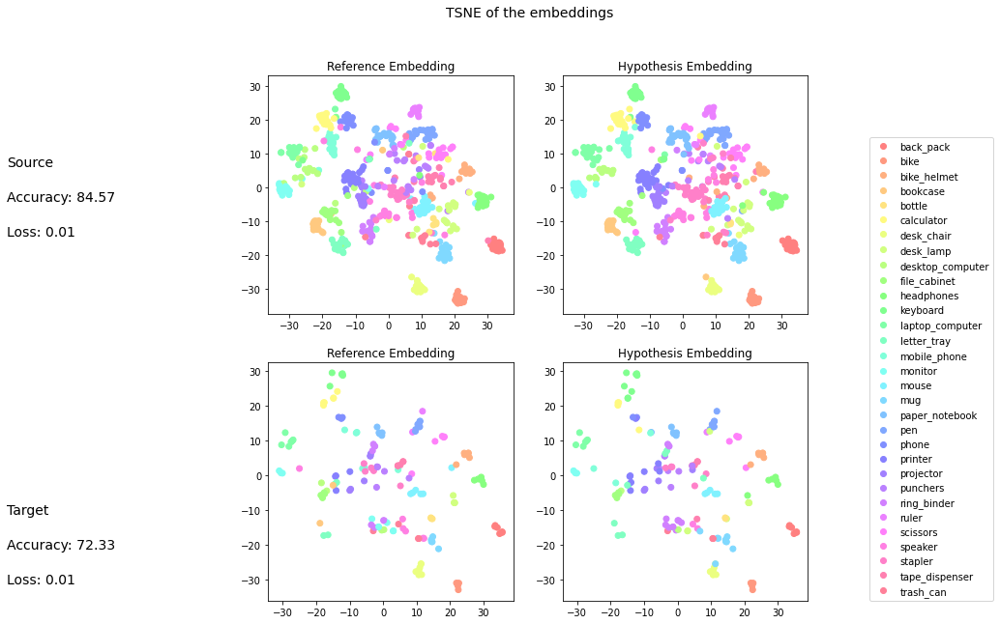

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,0.95,1.00,0.97,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,0.79,0.79,0.79,14.00
bookcase,0.93,0.88,0.90,16.00
bottle,1.00,0.29,0.44,7.00
calculator,0.86,0.95,0.90,19.00
desk_chair,0.94,0.83,0.88,18.00
desk_lamp,0.89,0.85,0.87,20.00
desktop_computer,0.77,0.53,0.62,19.00
file_cabinet,0.82,0.88,0.85,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

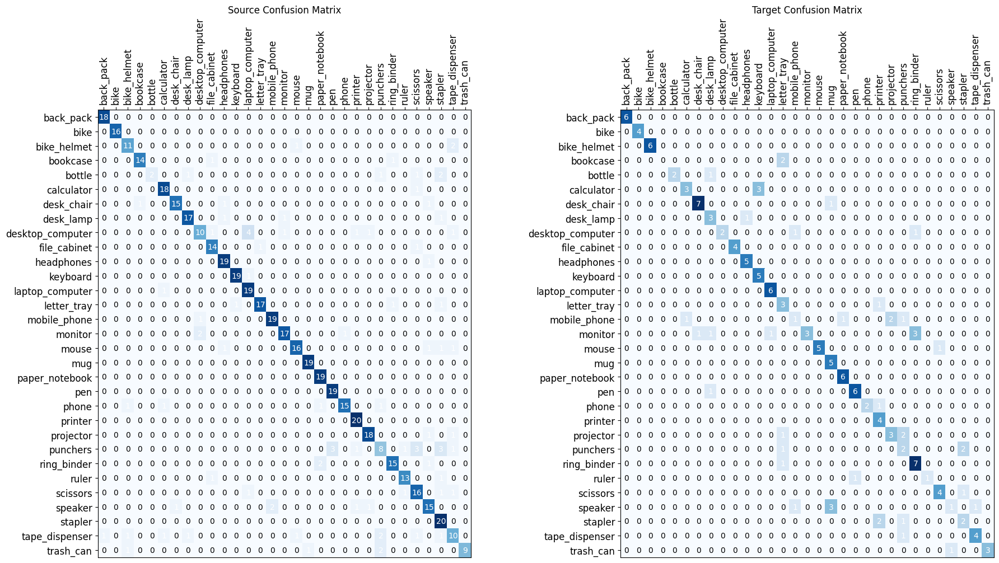

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

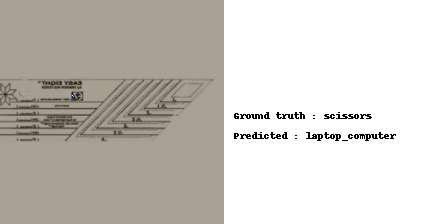

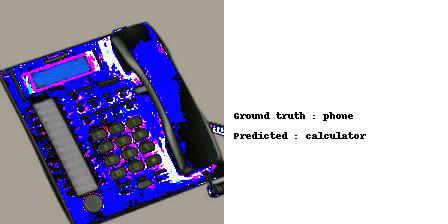

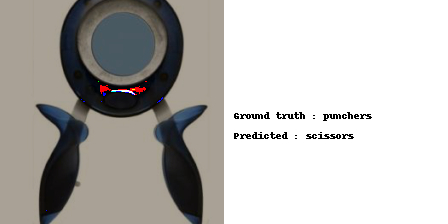

In [ ]:
show_error_images(test_loader_a,*source_errors,class_mapping,max_images=3)

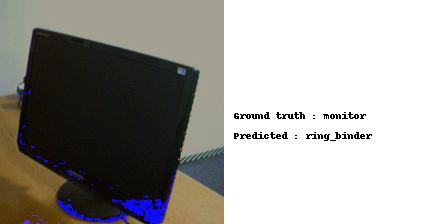

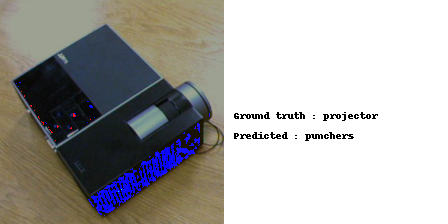

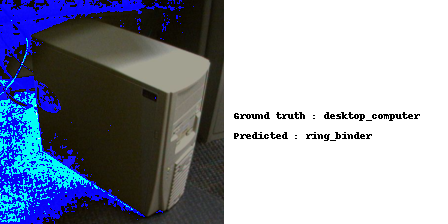

In [ ]:
show_error_images(test_loader_w,*target_errors,class_mapping,max_images=3)

### DANN + RADA + FGDA + SDAT from w -> a

In [ ]:
#{'Training loss': '0.00660', 'Training accuracy': '96.40479', 'Test loss': '0.01423', 'Test accuracy': '74.84277'}
extractor = Extractor(models.resnet18(weights=True))
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES)


grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)

##adam param
#lr = 1e-4
#wd = 1e-6
#
#optim = get_optimizer_params_list(list(extractor.parameters()) + 
#                                  list(classifier.parameters()) + 
#                                  list(discriminator.parameters()),
#                                  lr=lr, wd=wd)

#sgd param
lr = 1e-3
lr_ad = 1e-2
lr_grad = 3e-3
wd = 1e-3


sdat_optimizer = SAM(list(extractor.parameters()) + list(classifier.parameters()), torch.optim.SGD, rho=0.02, adaptive=False,
                    lr=lr, momentum=0.9, weight_decay=wd, nesterov=True)



ad_optimizer = get_SGD_optimizer_params_list(list(discriminator.parameters()), lr=lr_ad, wd=wd, momentum=0.9) 

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)

lrd = 0.0002
lambda_jr=0.01
n=1
K=5
ent_th = 0.35

extractor, classifier, discriminator, grad_discriminator = train_dann_rada_fgda_sdat(extractor, classifier, discriminator, grad_discriminator, sdat_optimizer, ad_optimizer, optimizer_d_grad, train_loader_w, test_loader_w, 
                                                                            train_loader_a, test_loader_a, lr, lr_grad, lrd, K, ent_th, lambda_jr, n)

In [ ]:
# save
torch.save(extractor.state_dict(), resnet18_dann_rada_fgda_sdat_extractor_a_w_path)
torch.save(classifier.state_dict(), resnet18_dann_rada_fgda_sdat_classifier_a_w_path)
torch.save(extractor.state_dict(), models_basepath + resnet18_dann_rada_fgda_sdat_extractor_w_a_path)
torch.save(classifier.state_dict(), models_basepath + resnet18_dann_rada_fgda_sdat_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_fgda_sdat_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_dann_rada_fgda_sdat_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


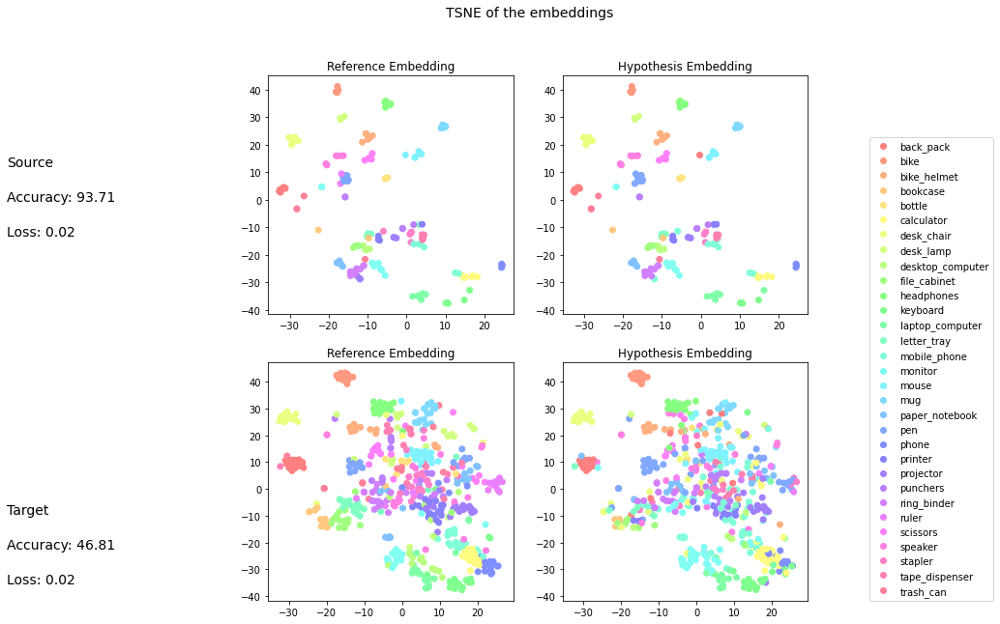

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,precision,recall,f1-score,support
back_pack,0.86,1.00,0.92,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,1.00,1.00,1.00,2.00
bottle,1.00,1.00,1.00,3.00
calculator,1.00,1.00,1.00,6.00
desk_chair,1.00,1.00,1.00,8.00
desk_lamp,1.00,1.00,1.00,4.00
desktop_computer,1.00,1.00,1.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

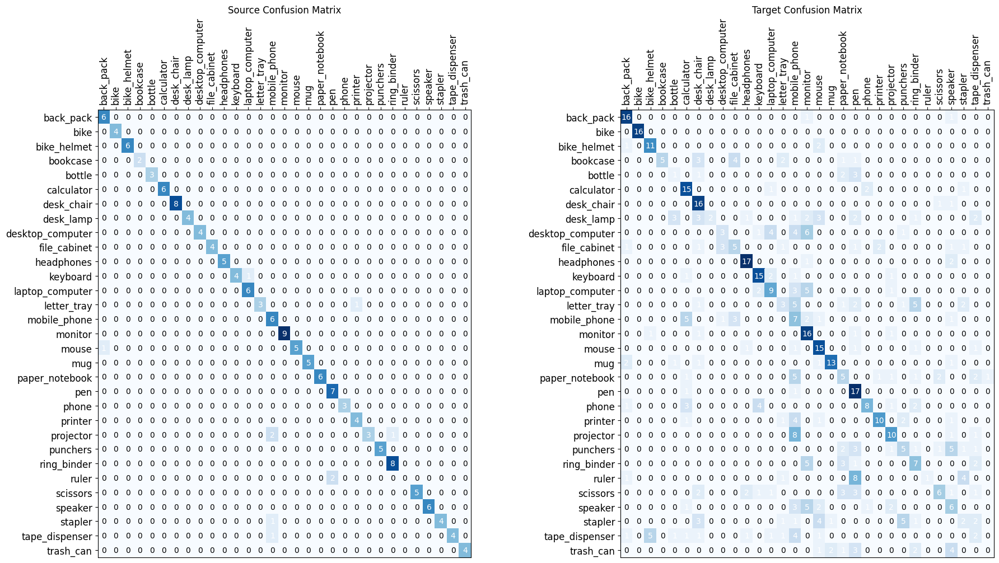

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

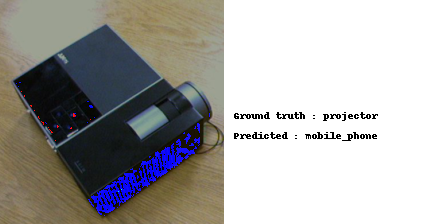

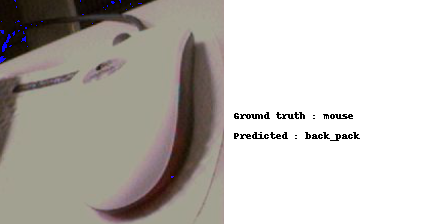

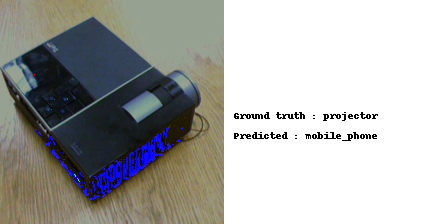

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

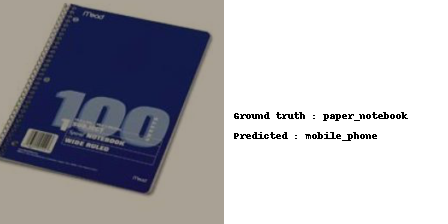

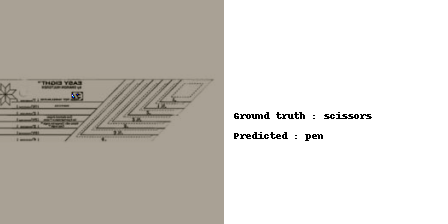

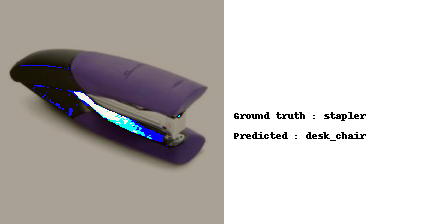

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

# Result Explanation

## Procedure
We decided to started from DANN method and try to improve it, DANN is old and quite simple but purpose was not the of obtaining the greatest accuracy but to test different modifications for adversarial methods proposed in more recent papers and moreover try to combine them when it make sense. So DANN is ur baseline.\
As first step we select some papers that we found interesting and we adapt the  source code when available or we implemented them from zero as for the RADA method.\
Once every improvement for a generic adversarial method works fine, we started to combine them.\

## Dataset
The dataset used for training and testing is office31, because is more complex than digits datset but is lighter than officeHome. Unfortunatelly this dataset is very unbalanced, there are very few images on the webcam domain and this caused some problems that we discuss later.

## How we merge methods

We selected 4 + 1 generic methods to improve an adversarial learning scheme.\
- **DALN:** means Discriminator free ADA. Here we remove the discriminator and we add to the classifier a Nuclear-Norm Wasserstein Discrepancy module to exploit the classifier prediction to discriminate the domain.
- **SDAT:** means Smooth Domain Adversarial Training. Basically this is a new optimizer with some aditional gradient computation step to find a smoother minima in the classification loss.
- **JREG:** Jacobian Regularization is a regularization method that pushes decision boundaries farther away from each training data point, enlarging decision cells and reducing instability. It is exploited FGDA method, so we also tested it separatelly.
- **FGDA:** Constrain feature gradients of two domains to have similar distributions. Pseudo labels are computed in order to obtain the target loss and Jacobian regularization is applied.
- **RADA:** Re-energize learning ralabeling well aligned target samples.
Well aligned samples can’t be well distinguish by domain discriminator so they are the one with an entropy higher than a certain threshold.
Well aligned samples are relabeled as source domain samples, moreover mixup at features level is applied to softly mix the features between the previous
source samples and the newly absorbed samples.
Domain relabeling doesn't influence classification task.

The ideas follwed to join the different methods are the following:
- **FGDA + DALN:** **FGDA** can be **combined** with **DALN**. **FGDA** use an addition discriminator *grad_discriminator* to aligned the gradient distributions but the discriminator for the adversarial part can be removed without any problems in the same way as **DALN**.
- **RADA + FGDA:** in **RADA** we change domain label but we don't influence classification task, so we can apply **FGDA**.
- **Method + SDAT:** **SDAT** is an optimizer applied to the classification loss, so we can add it to avery other method.
- **RADA and DALN:** to fuse **RADA** and **DALN** is not straight forward because in our implementation of **RADA** we use the entropy of the domain discriminator to decide if a sample is well aligned. So for the moments we didn't consider this case. 


## Obtained Results on office31

|Model                  |A->W  A |A->W  W  |Gain   |W->A  W |W->A  W |Gain     |
|-----------------------|--------|---------|-------|--------|--------|---------|
| DANN                  | 86.35  | 64.78   | -     | 93.71  | 44.68  | -       |
| DANN + DALN           | 83.16  | 72.33   | +7.55 | 95.60  | 39.72  | -4.96   |
| DANN + SDAT           | 87.06  | 73.58   | +8.80 | 94.34  | 49.47  | +4.79   |
| DANN + JREG           | 85.82  | 73.58   | +8.80 | 94.97  | 46.45  | +1.77   |
| DANN + FGDA           | 86.35  | 72.96   | +8.18 | 96.86  | 52.13  |**+7.45**|
| DANN + RADA           | 85.99  | 64.78   | 0     | 93.08  | 45.74  | +1.06   |
| DANN + FGDA + DALN    | 84.75  |**76.10**| +11.32| 93.08  | 49.47  | +4.79   |
| DANN + DALN + SDAT    | 85.64  |  68.55  | +3.77 | 91.82  | 43.62  | -1.06   |
| DANN + FGDA + SDAT    | 81.21  |  62.89  | -1.89 | 93.71  | 45.57  | +0.89   |
|DANN + DALN + DALN + SDAT|85.82 | 72.33   | +7.55 | 94.97  | 51.42  | +6.74   |
| DANN + RADA + SDAT    | 83.87  |  70.44  | +5.66 | 94.34  | 45.04  | +0.36   |
| DANN + RADA + FGDA    | 83.87  |  71.70  | +6.92 | 94.34  | 43.44  | -1.24   |
|DANN + RADA + FGDA + SDAT|84.57 |  72.33  | +7.55 | 93.71  | 46.81  | +2.13   |

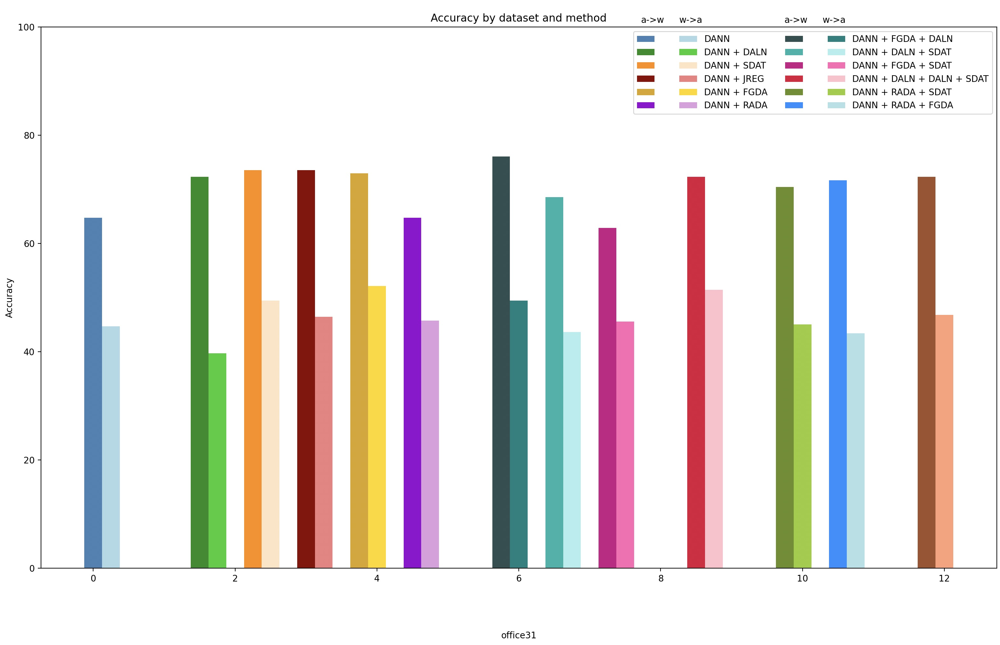

### Comments on obtained results

- All the methods tested singularly are able to improve the **DANN** baseline with the exception of **RADA** in the test *A -> W* and **DALN** in the test *W -> A*. 
- In our opinion the poor performances of **DALN** method in the test *W -> A* can be explained by the fact that the dataset is very unbalanced in the two domains.
- **RADA** in the test *A -> W* not improve performances but neither decrease them. We implemented **RADA** without a reference code and bofore of obtaining this result performances are always decreased. Samples re-allignement started at epoch 17 so we thing that the method is working and that better results can be obtained adjusting training parameters. Moreover in the other direction, **RADA** method have a gain of +1.06.
- **JREG** seems to be very effective but **FGDA** that exploit it is able to improve performances again, in particular in the test *W -> A* where it results to be the best method with a gain of +7.45.
- **FGDA + DALN** seems to be a very good idea especially in the test *A -> W* where it results to be the best method with a gain of +11.32. In the other direction we are decreasing the performances of FGDA by -2.66 but the reason is that **DALN** in this test perform poorly.
- **RADA + FGDA** might be a good idea because increase performances of **RADA** method but decrease wrt **FGDA**. The problem is that **RADA** is performing poorly also alone. In our opinion once the right hyperparameters for **RADA** are found also the combination should work fine.
- **SDAT** is a very effective method but is very sensitive to simulation parameters, we try many combination of parameters but often it decrease performances, only with the parameters that we found in the paper it increase considerably performances with +8.8 in the test *A -> W* and *+4.79* in the other direction. In our opinion this sensitivity is the motivation for the fact that when we add it to another method, this not always improve performances. If one hav the possibility to try different hyperparameters combinations this could be a very powerful method.




### TSNE analisys

**DANN**
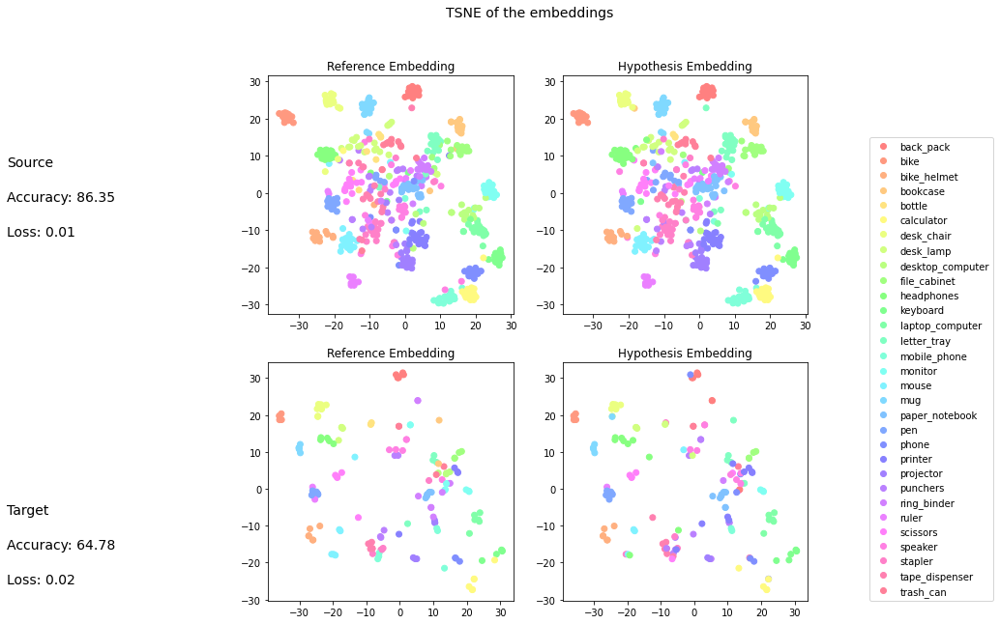


**DANN + DALN**
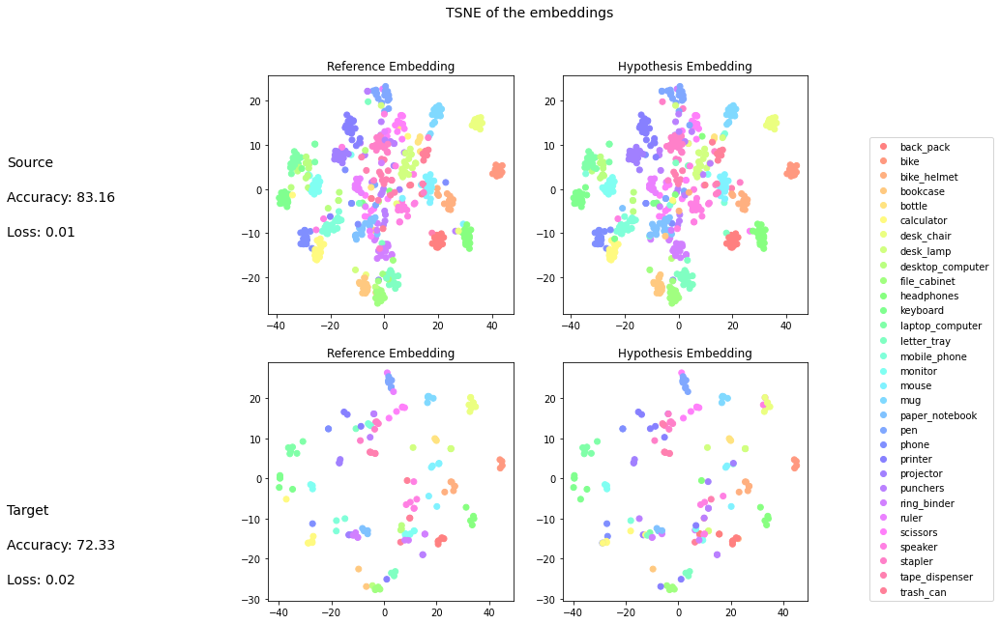

**DANN + FGDA**
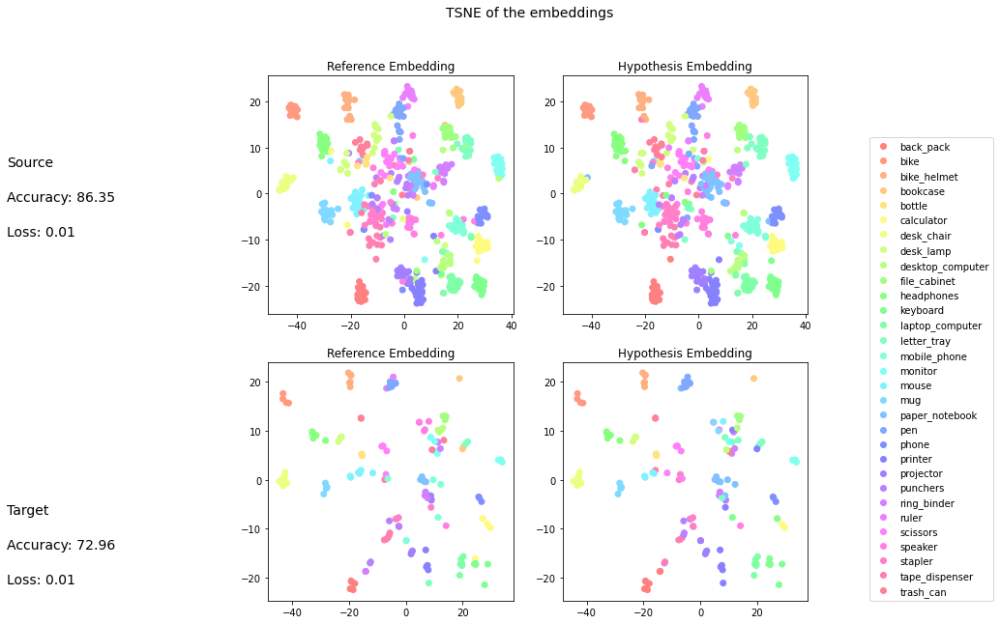


**DANN + FGDA + DALN**
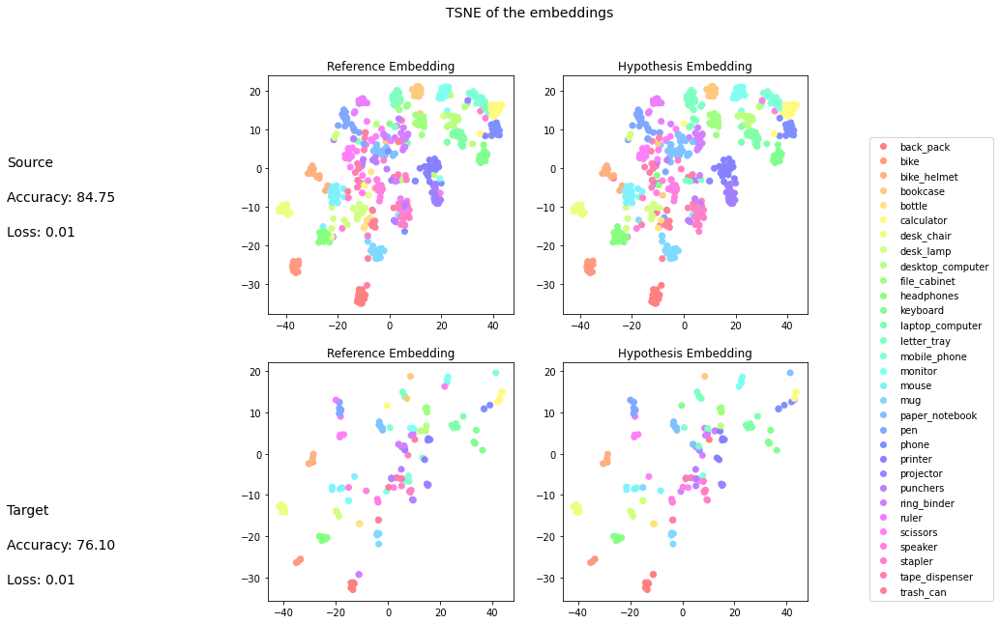


From these TSNE plots we can see how those methods succede in obtaining a better inter class separation and an higher intra class compactness. Moreover using **FGDA** together with **DALN** further improve performances.

## Future works
- Try different training parameters to possibly obtain better results.
- Try those methods with a structure more complex than the **DANN** (e.g. a **CDAN** or newer)
- Test on different datasets (e.g. MNIST or officeHome) to have a better understanding of the opportunity of fusing together different methods.
- Try a different alignement measure for RADA not based on discriminator output, allowing to fuse **RADA** with **DALN**. An idea explored in **RADA** paper is to use MMD loss.

# Incremental learning

This section implements an incremental learning technique that is performed upon the previous adversarial approaches. The idea is inspired by Gallego et al. (2020). This work aim to assign a pseudo label to all the target data. In order to do it, a set of *k* target samples are selected iteratively based on a policy. In the case of this work, the policy is based on the confidence of the prediction of the classifier given by the softmax function. After the selection of the *k* samples, a pseudo-label is assigned to each one. Subsequently, the model is trained in two phases:

*   First, train the model as usual
*   Next, only on the new pseudo labeled samples

This process is repeated until all the target data are assigned with a pseudo-label. At the end a new model is trained from scratch using only the target samples.


## Incremental functions

In [ ]:
def remove_label_from_dataloader(dataloader:Iterable):

  for i in range(len(dataloader.dataset)):
    dataloader.dataset[i] = list(dataloader.dataset[i])
    dataloader.dataset[i][1] = -1
    dataloader.dataset[i] = tuple(dataloader.dataset[i])
    
  return dataloader

In [ ]:
def pseudo_labeling_policy(extractor: Iterable, classifier: Iterable, data_loader:Iterable, k=100, min_accuracy=0.97):

  top_accuracy = []
  indexes = []
  prediction = []
  # set the network to evaluation mode
  extractor.eval()
  classifier.eval()
  samples = 0
  n_epochs_pseudo_labels = 0
  max_accuracy = 0.30

  with torch.no_grad():
    # iterate over the test set
    for batch_idx, (inputs, _, _) in enumerate(data_loader):
      
      indexes2 = [x + (BATCH_SIZE*batch_idx) for x in list(range(0, len(inputs)))]

      # load data into GPU
      inputs = inputs.to(device)
        
      # forward pass
      outputs = classifier(extractor(inputs))

      outputs = nn.Softmax(dim=1)(outputs)

      # fetch prediction and loss value
      samples+=inputs.shape[0]
      probability, predicted = outputs.max(1)
      
      top_accuracy.extend(probability)
      indexes.extend(indexes2)
      prediction.extend(predicted)

  top_accuracy, indexes, prediction = (list(t) for t in zip(*sorted(zip(top_accuracy, indexes, prediction))))

  #print(top_accuracy)
  i = 0

  while i < len(top_accuracy) and top_accuracy[i] < min_accuracy:
    i += 1
    
  num_epochs_pseudo_labels = 10

  if top_accuracy[-1] < max_accuracy:
    k = len(top_accuracy)
    num_epochs_pseudo_labels = 0

  if( (len(top_accuracy) - i) < k ):
    i = -k
    num_epochs_pseudo_labels = 1

  indexes = indexes[i:]
  prediction = prediction[i:]
  
  return indexes, prediction, num_epochs_pseudo_labels

In [ ]:
def assign_and_remove_pseudo_labels(shuffled_loader: Iterable, unshuffled_loader: Iterable, idxs, labels):

  # Assign pseudo-label to Target data loader
  for i in range(len(idxs)):
    name_img = unshuffled_loader.dataset[idxs[i]][2]
    for ind in range(len(shuffled_loader.dataset)):
      if shuffled_loader.dataset[ind][2] == name_img:
        shuffled_loader.dataset[ind] = list(shuffled_loader.dataset[ind])
        shuffled_loader.dataset[ind][1] = labels[i].item()
        shuffled_loader.dataset[ind] = tuple(shuffled_loader.dataset[ind])

  # Remove data with pseudo-label from the temporal dataloader 
  idxs = sorted(idxs, reverse = True)
  for id in idxs:
    unshuffled_loader.dataset.pop(id)

  return shuffled_loader, unshuffled_loader

In [ ]:
def training_step_self_label(extractor: nn.Module, classifier: nn.Module, target: Iterable, optimizer: Any):
  
  samples = 0.
  cumulative_loss = 0.
  cumulative_accuracy = 0.

  extractor.train()
  classifier.train()

  single_sample = None
  single_sample_label = None
  pseudo_labeled_samples = []
  pseudo_target_labels = []

  # iterate over the training set
  pbar = tqdm(range(len(target)),position=0, leave=False)
  for a, (batch_idx, (target_inputs, pseudo_labels, _)) in zip(pbar,enumerate(target)):

    # load data into GPU
    target_inputs = target_inputs.to(device)
    pseudo_labels = pseudo_labels.to(device)

    pseudo_labeled_samples = []
    pseudo_target_labels = []

    extractor.zero_grad()
    classifier.zero_grad()

    for i in range(len(target_inputs)):
      if pseudo_labels[i] >= 0:
        pseudo_labeled_samples.append(target_inputs[i])
        pseudo_target_labels.append(pseudo_labels[i])
        if single_sample != None:
          pseudo_labeled_samples.append(single_sample)
          pseudo_target_labels.append(single_sample_label)
          single_sample = None
          single_sample_label = None

    if len(pseudo_labeled_samples) > 0:
      pseudo_labeled_samples = torch.stack(pseudo_labeled_samples)
      pseudo_target_labels = torch.stack(pseudo_target_labels)

    samples += len(pseudo_labeled_samples)

    if len(pseudo_labeled_samples) == 1:
      single_sample = pseudo_labeled_samples[0]
      single_sample_label = pseudo_target_labels[0]

    if len(pseudo_labeled_samples) > 1:
      pseudo_class_outputs = classifier(extractor(pseudo_labeled_samples))
      loss = nn.CrossEntropyLoss()(pseudo_class_outputs, pseudo_target_labels)

      cumulative_loss += loss.item()

      loss.backward()

      optimizer.step()

      _, predicted = pseudo_class_outputs.max(dim=1)

      # compute training accuracy
      cumulative_accuracy += predicted.eq(pseudo_target_labels).sum().item()

  return cumulative_loss/(samples*2), cumulative_accuracy/samples*100

In [ ]:
def get_data_pseudo_label(batch_size: int, img_root: str):

  transform = list()
  transform.append(transforms.Resize((256, 256)))                      
  transform.append(transforms.CenterCrop((224, 224)))                  
  transform.append(transforms.ToTensor())                              
  transform.append(transforms.Normalize(mean=[0.7527, 0.7494, 0.7474], 
                                std=[0.3120, 0.3136, 0.3154]))      
  transform = transforms.Compose(transform)                            
    
  office31_train = ImageFolderWithIndices(root=img_root, transform=transform)

  dataset_size = len(office31_train.samples)
  train_size = int(dataset_size*0.8)
  val_size = int(dataset_size*0)
  test_size = dataset_size - val_size - train_size 
  
  train_data, _ = train_test_split(office31_train,train_size=train_size+val_size,test_size=test_size,random_state=0,
                                           shuffle=True,stratify=office31_train.targets)
  
  train_loader = torch.utils.data.DataLoader(train_data, batch_size, shuffle=False, collate_fn=None, drop_last=False)
  
  return train_loader

## Incremental DANN

### Train Step

In [ ]:
def train_self_label_incremental_dann(extractor: nn.Module, 
                                      classifier: nn.Module, 
                                      discriminator: nn.Module, 
                                      source_train_loader: Iterable, 
                                      source_test_loader: Iterable, 
                                      pseudo_train_loader: Iterable, 
                                      test_loader: Iterable, 
                                      optimizer: Any, 
                                      epochs: int,
                                      lr: float,
                                      lrd: float):
  
  extractor.to(device)
  classifier.to(device)
  discriminator.to(device)

  ce_loss = get_ce_loss()
  
  extractor, classifier, discriminator = train_dann(extractor, classifier, discriminator, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lrd, epochs = 2)

  pbar = tqdm(range(epochs),position=0, leave=True)
  for p, epoch in zip(pbar,range(epochs)): 
    train_loss, train_accuracy = training_step_self_label(extractor, classifier, pseudo_train_loader, optimizer) 
    
    test_loss, test_accuracy = test_step(extractor, classifier, test_loader, cost_function=ce_loss)

    pbar.set_description(str({
    'Training loss': f'{train_loss:.5f}',
    'Training accuracy': f'{train_accuracy:.5f}',
    'Test loss': f'{test_loss:.5f}',
    'Test accuracy': f'{test_accuracy:.5f}',
    }))

  return extractor, classifier, optimizer

In [ ]:
def train_incremental_dann(extractor: nn.Module,
                classifier: nn.Module,
                discriminator: nn.Module,
                batch_size: int,
                root: str,
                optimizer: Any,
                source_train_loader:Iterable,
                source_test_loader:Iterable,
                target_train_loader:Iterable,
                target_test_loader:Iterable,
                lr: float,
                lrd: float):

  pseudo_target_train_loader = get_data_pseudo_label(batch_size, root)
  target_train_loader = remove_label_from_dataloader(target_train_loader)

  test_loss, test_accuracy= test_step(extractor, classifier, target_test_loader, cost_function=get_ce_loss())
  print("Test accuracy: ", test_accuracy)

  print("Initial number of samples to label:", len(pseudo_target_train_loader.dataset))
  while(len(pseudo_target_train_loader.dataset) > 0):

    #Compute pseudo-labels
    idxs, labels, n_epochs_pseudo_labels = pseudo_labeling_policy(extractor, classifier, pseudo_target_train_loader, k=10, min_accuracy=0.80)

    target_train_loader, pseudo_target_train_loader = assign_and_remove_pseudo_labels(target_train_loader, pseudo_target_train_loader, idxs, labels)

    print("Remaining samples to label:", len(pseudo_target_train_loader.dataset))
    print("Samples with pseudo-label:", len(target_train_loader.dataset) - len(pseudo_target_train_loader.dataset))

    extractor, classifier, optimizer = train_self_label_incremental_dann(extractor, classifier, discriminator, source_train_loader, source_test_loader, target_train_loader, target_test_loader, optimizer, n_epochs_pseudo_labels, lr, lrd)
    
  final_lr = 0.0005
  final_lrd = 0.00002

  final_extractor = Extractor(models.resnet18(weights=True)).to(device)
  final_classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
  optimizer_ex = get_optimizer(final_extractor,lr=final_lr, wd=0.000001)
  optimizer_cl = get_optimizer(final_classifier,lr=final_lr, wd=0.000001)
  ce_cost_function = get_ce_loss()
  ex = train_source_only(final_extractor,
           final_classifier,
           target_train_loader,
           target_test_loader, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           lr = final_lr, 
           lrd = final_lrd,
           epochs=50, 
           device=device)
  
  return final_extractor, final_classifier
  

### Incremental DANN A $\rightarrow$ W

In [ ]:
#'Training loss': '0.00083', 'Training accuracy': '100.00', 'Test loss': '0.01327', 'Test accuracy': '75.47'
root = f"{unzipped_dataset}/webcam/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002
fe, fc = train_incremental_dann(extractor, classifier, discriminator, BATCH_SIZE, root, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_extractor_a_w_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_classifier_a_w_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_extractor_a_w_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


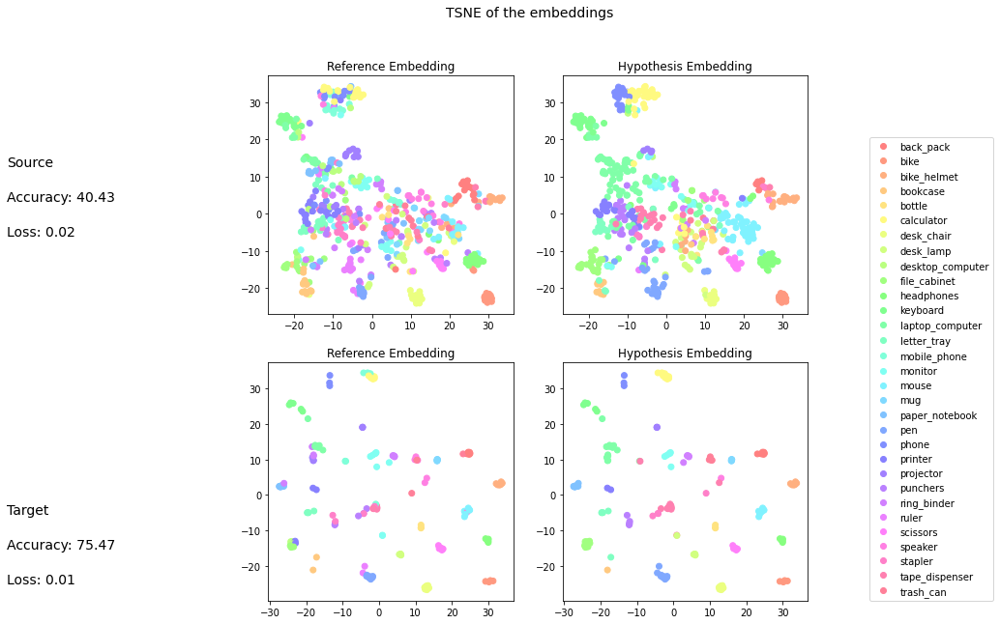

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,0.44,0.62,18.00
bike,1.00,0.88,0.93,16.00
bike_helmet,0.42,0.71,0.53,14.00
bookcase,0.70,0.44,0.54,16.00
bottle,0.09,0.14,0.11,7.00
calculator,0.37,0.68,0.48,19.00
desk_chair,1.00,0.78,0.88,18.00
desk_lamp,0.21,0.20,0.21,20.00
desktop_computer,0.00,0.00,0.00,19.00
file_cabinet,0.42,0.69,0.52,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

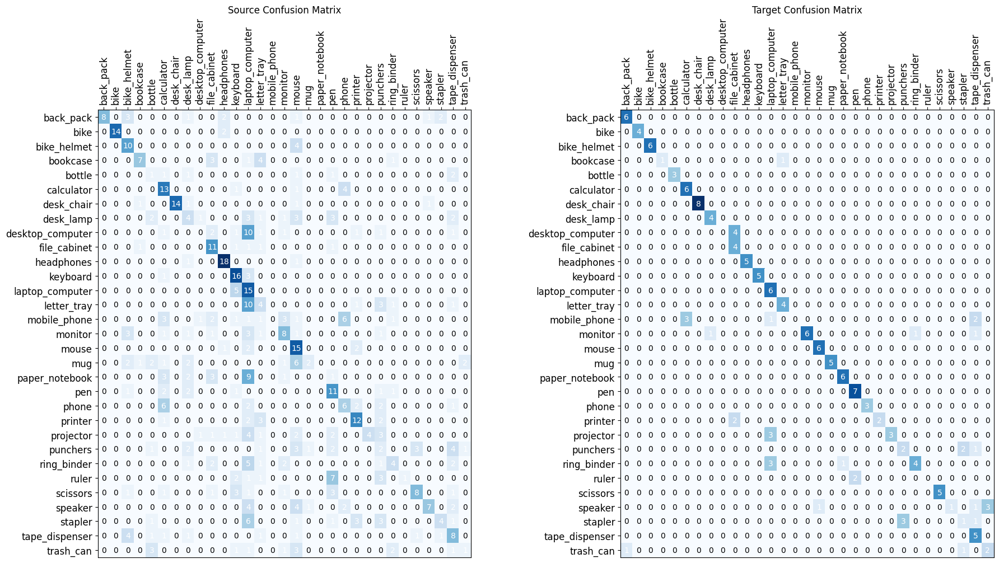

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

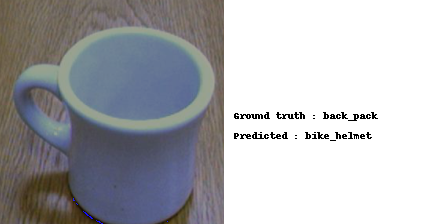

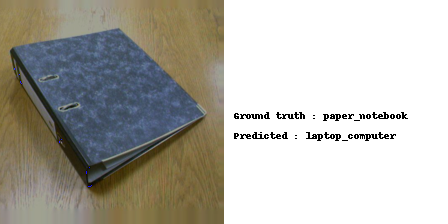

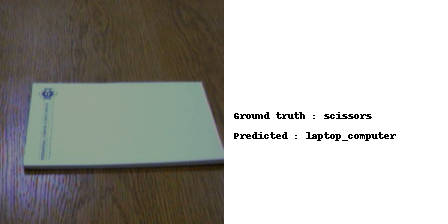

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

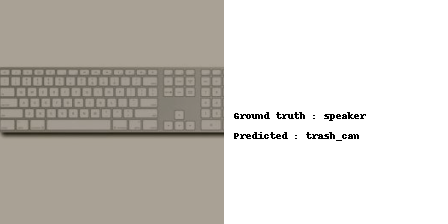

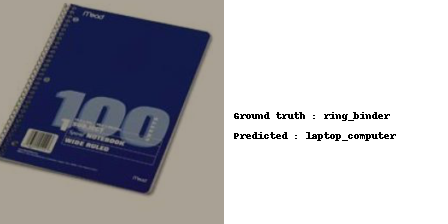

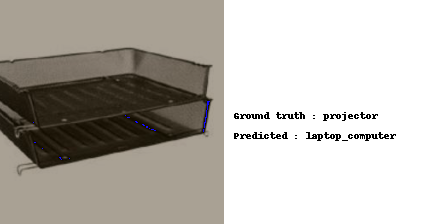

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

### Incremental DANN W $\rightarrow$ A

In [ ]:
root = f"{unzipped_dataset}/amazon"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002
fe, fc = train_incremental_dann(extractor, classifier, discriminator, BATCH_SIZE, root, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_extractor_w_a_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_classifier_w_a_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_extractor_w_a_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


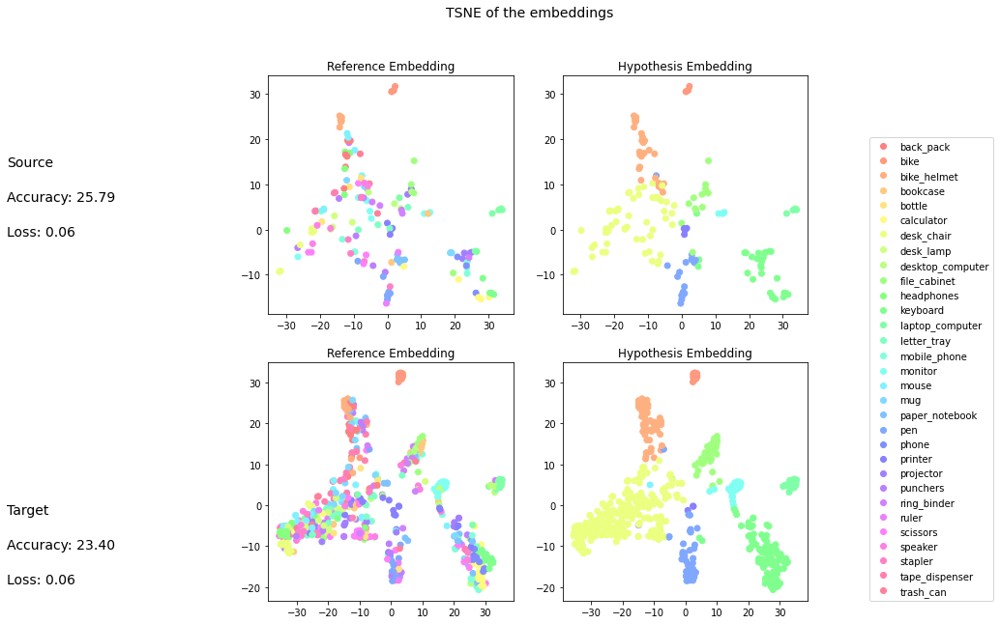

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,0.00,0.00,0.00,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,0.23,1.00,0.38,6.00
bookcase,0.00,0.00,0.00,2.00
bottle,0.00,0.00,0.00,3.00
calculator,0.00,0.00,0.00,6.00
desk_chair,0.14,1.00,0.25,8.00
desk_lamp,0.00,0.00,0.00,4.00
desktop_computer,0.00,0.00,0.00,4.00
file_cabinet,0.23,0.75,0.35,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

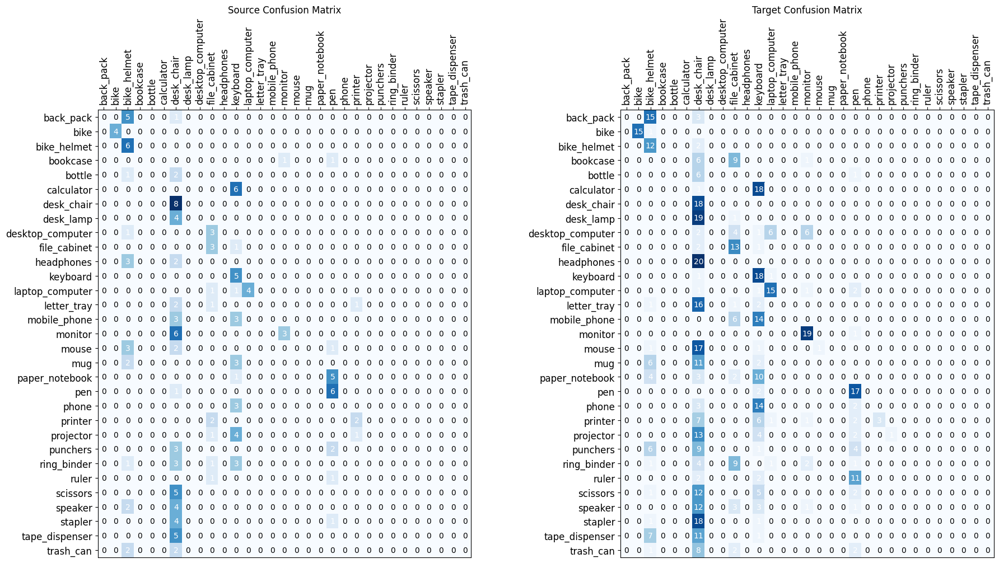

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

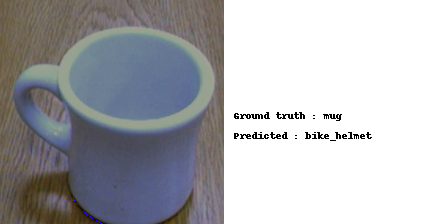

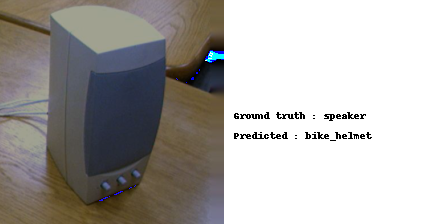

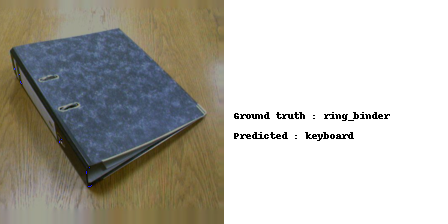

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

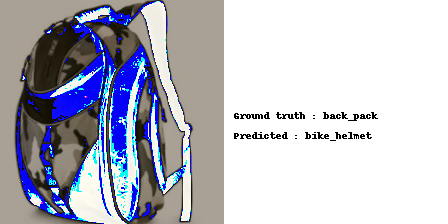

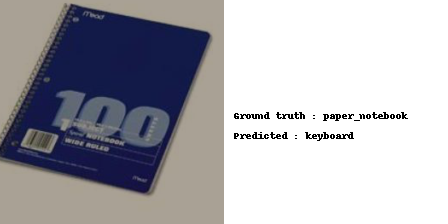

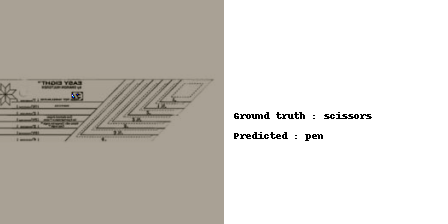

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## Incremental DANN + DALN

### Train Step

In [ ]:
def train_self_label_incremental_dann_daln(extractor: nn.Module,
                                      classifier: nn.Module,
                                      source_train_loader: Iterable,
                                      source_test_loader: Iterable,
                                      pseudo_train_loader: Iterable,
                                      test_loader: Iterable,
                                      optimizer: Any,
                                      epochs: int,
                                      lr: float,
                                      lrd: float):
  
  extractor.to(device)
  classifier.to(device)

  ce_loss = get_ce_loss()
  
  extractor, classifier = train_dann_daln(extractor, classifier, optimizer, train_loader_a, test_loader_a, train_loader_w, test_loader_w, trade_off_lambda, lr, lrd, epochs=2)

  pbar = tqdm(range(epochs),position=0, leave=True)
  for p, epoch in zip(pbar,range(epochs)): 
    train_loss, train_accuracy = training_step_self_label(extractor, classifier, pseudo_train_loader, optimizer) 
    
    test_loss, test_accuracy = test_step(extractor, classifier, test_loader, cost_function=ce_loss)

    pbar.set_description(str({
    'Training loss': f'{train_loss:.5f}',
    'Training accuracy': f'{train_accuracy:.5f}',
    'Test loss': f'{test_loss:.5f}',
    'Test accuracy': f'{test_accuracy:.5f}',
    }))

  return extractor, classifier

In [ ]:
def train_incremental_dann_daln(extractor: nn.Module,
                classifier: nn.Module,
                batch_size: int,
                root: str,
                optimizer: Any,
                source_train_loader:Iterable,
                source_test_loader:Iterable,
                target_train_loader:Iterable,
                target_test_loader:Iterable,
                lr: float,
                lrd: float):

  pseudo_target_train_loader = get_data_pseudo_label(batch_size, root)
  target_train_loader = remove_label_from_dataloader(target_train_loader)

  test_loss, test_accuracy= test_step(extractor, classifier, target_test_loader, cost_function=get_ce_loss())
  print("Test accuracy: ", test_accuracy)

  print("Initial number of samples to label:", len(pseudo_target_train_loader.dataset))
  while(len(pseudo_target_train_loader.dataset) > 0):

    #Compute pseudo-labels
    idxs, labels, n_epochs_pseudo_labels = pseudo_labeling_policy(extractor, classifier, pseudo_target_train_loader, k=10, min_accuracy=0.80)

    target_train_loader, pseudo_target_train_loader = assign_and_remove_pseudo_labels(target_train_loader, pseudo_target_train_loader, idxs, labels)

    print("Remaining samples to label:", len(pseudo_target_train_loader.dataset))
    print("Samples with pseudo-label:", len(target_train_loader.dataset) - len(pseudo_target_train_loader.dataset))

    extractor, classifier = train_self_label_incremental_dann_daln(extractor, classifier, source_train_loader, source_test_loader, target_train_loader, target_test_loader, optimizer, n_epochs_pseudo_labels, lr, lrd)
    
  final_lr = 0.0005
  final_lrd = 0.00002
  
  final_extractor = Extractor(models.resnet18(weights=True)).to(device)
  final_classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
  optimizer_ex = get_optimizer(final_extractor,lr=final_lr, wd=0.000001)
  optimizer_cl = get_optimizer(final_classifier,lr=final_lr, wd=0.000001)
  ce_cost_function = get_ce_loss()
  ex = train_source_only(final_extractor,
           final_classifier,
           target_train_loader,
           target_test_loader, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           lr = final_lr, 
           lrd = final_lrd,
           epochs=75, 
           device=device)
  
  return final_extractor, final_classifier
  

### Incremental DANN + DALN A $\rightarrow$ W

In [ ]:
root = f"{unzipped_dataset}/webcam/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002
fe, fc = train_incremental_dann_daln(extractor, classifier, BATCH_SIZE, root, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_daln_extractor_a_w_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_daln_classifier_a_w_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_daln_extractor_a_w_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_daln_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_daln_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_daln_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


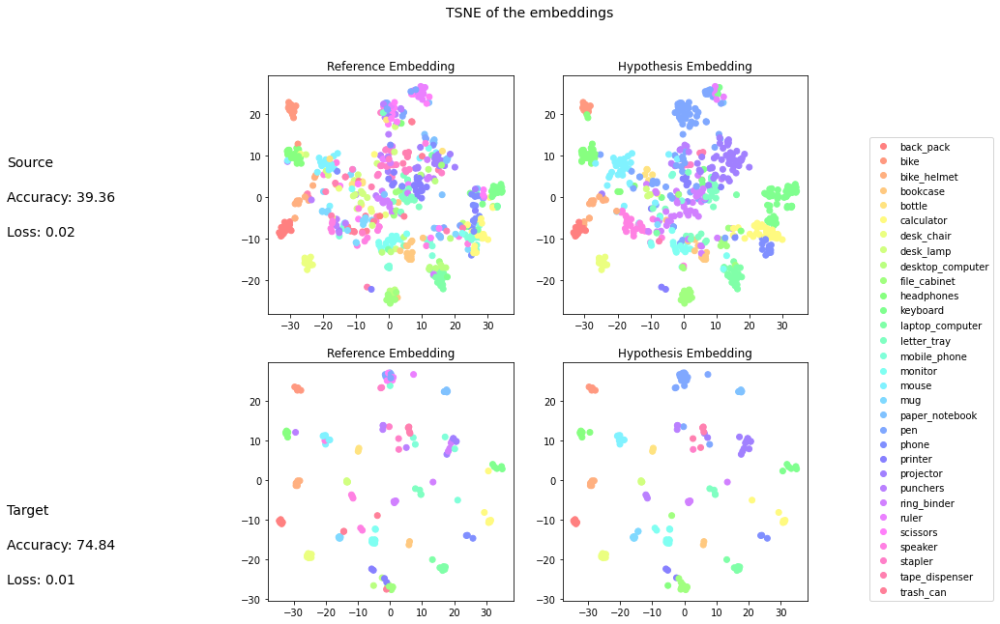

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,0.78,0.88,18.00
bike,1.00,0.81,0.90,16.00
bike_helmet,0.62,0.71,0.67,14.00
bookcase,0.67,0.50,0.57,16.00
bottle,0.00,0.00,0.00,7.00
calculator,0.32,0.47,0.38,19.00
desk_chair,0.92,0.67,0.77,18.00
desk_lamp,0.50,0.10,0.17,20.00
desktop_computer,0.00,0.00,0.00,19.00
file_cabinet,0.43,0.62,0.51,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

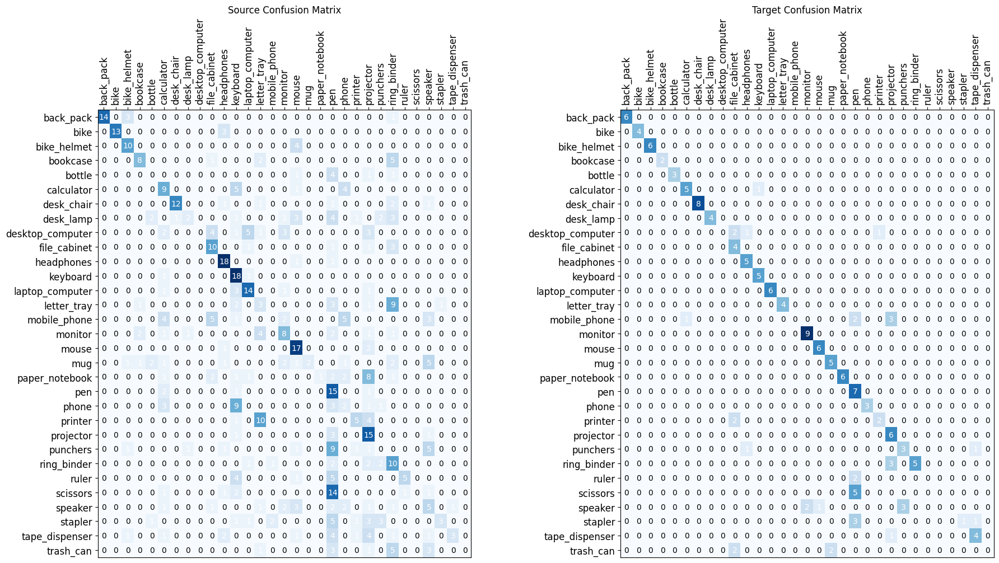

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

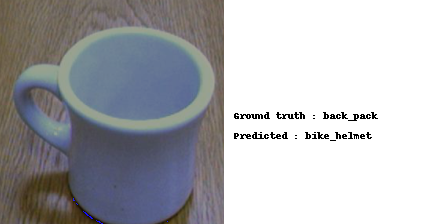

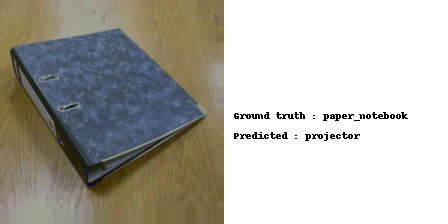

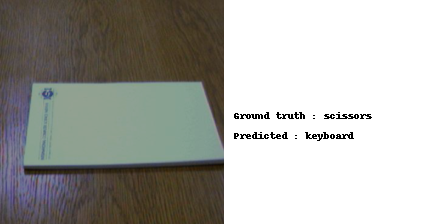

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

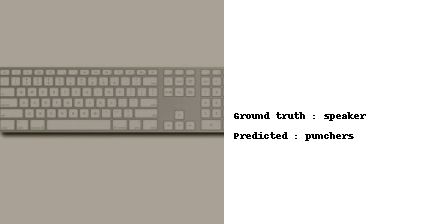

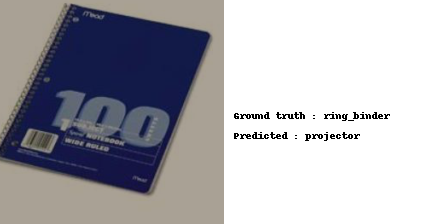

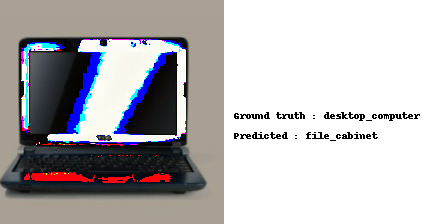

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

### Incremental DANN + DALN W $\rightarrow$ A

In [ ]:
root = f"{unzipped_dataset}/amazon/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002
fe, fc = train_incremental_dann_daln(extractor, classifier, BATCH_SIZE, root, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_daln_extractor_w_a_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_daln_classifier_w_a_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_daln_extractor_w_a_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_daln_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_daln_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_daln_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


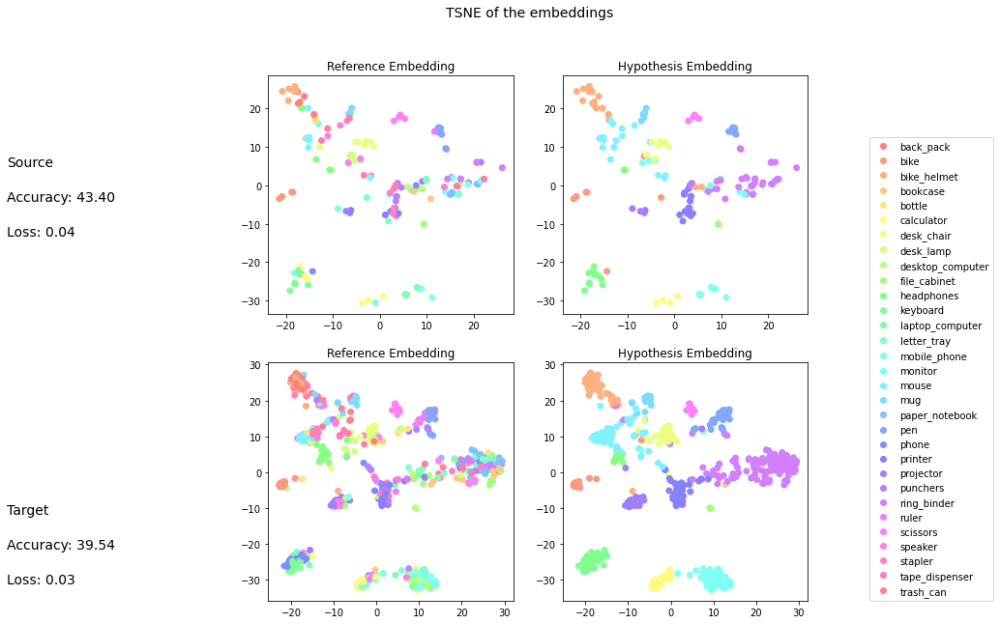

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,0.00,0.00,0.00,6.00
bike,0.57,1.00,0.73,4.00
bike_helmet,0.33,1.00,0.50,6.00
bookcase,0.00,0.00,0.00,2.00
bottle,0.00,0.00,0.00,3.00
calculator,0.75,0.50,0.60,6.00
desk_chair,0.67,0.75,0.71,8.00
desk_lamp,0.00,0.00,0.00,4.00
desktop_computer,0.00,0.00,0.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

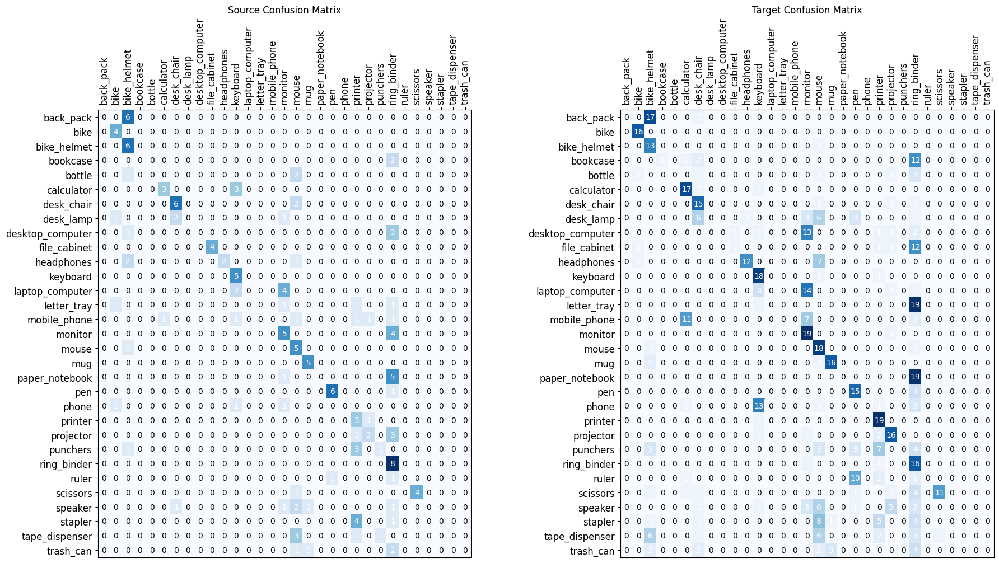

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

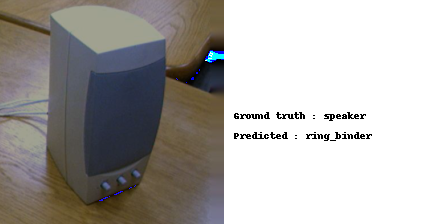

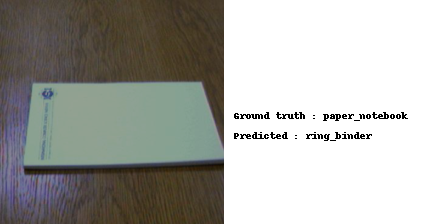

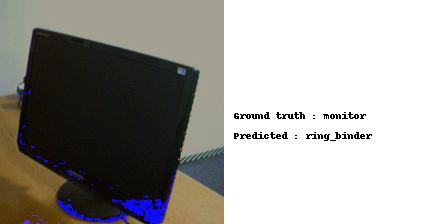

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

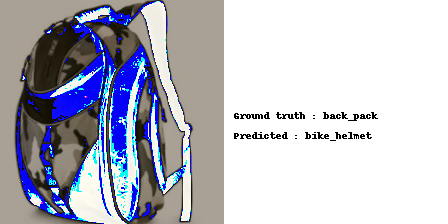

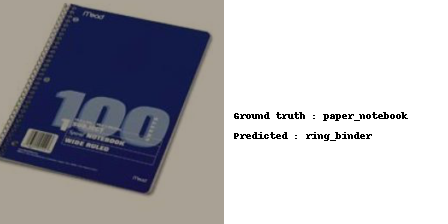

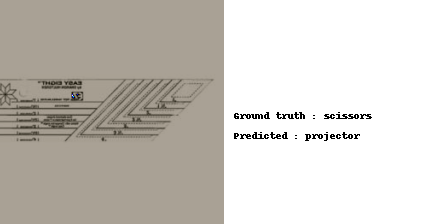

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## Incremental DANN + JREG

### Train Step

In [ ]:
def train_self_label_incremental_dann_jreg(extractor: nn.Module,
                                      classifier: nn.Module,
                                      discriminator: nn.Module,
                                      source_train_loader: Iterable,
                                      source_test_loader: Iterable,
                                      pseudo_train_loader: Iterable,
                                      test_loader: Iterable,
                                      optim: Any,
                                      epochs: int,
                                      lr: float,
                                      lrd: float):
  
  extractor.to(device)
  classifier.to(device)
  discriminator.to(device)

  ce_loss = get_ce_loss()
  
  extractor, classifier, discriminator = train_dann_jreg(extractor, classifier, discriminator, optim, source_train_loader, source_test_loader, pseudo_train_loader, test_loader, lr, lrd, epochs=2)

  pbar = tqdm(range(epochs),position=0, leave=True)
  for p, epoch in zip(pbar,range(epochs)): 
    train_loss, train_accuracy = training_step_self_label(extractor, classifier, pseudo_train_loader, optim) 
    
    test_loss, test_accuracy = test_step(extractor, classifier, test_loader, cost_function=ce_loss)

    pbar.set_description(str({
    'Training loss': f'{train_loss:.5f}',
    'Training accuracy': f'{train_accuracy:.5f}',
    'Test loss': f'{test_loss:.5f}',
    'Test accuracy': f'{test_accuracy:.5f}',
    }))

  return extractor, classifier

In [ ]:
def train_incremental_dann_jreg(extractor: nn.Module,
                classifier: nn.Module,
                discriminator: nn.Module,
                batch_size: int,
                root: str,
                optimizer: Any,
                source_train_loader:Iterable,
                source_test_loader:Iterable,
                target_train_loader:Iterable,
                target_test_loader:Iterable,
                lr: float,
                lrd: float):

  pseudo_target_train_loader = get_data_pseudo_label(batch_size, root)
  target_train_loader = remove_label_from_dataloader(target_train_loader)

  test_loss, test_accuracy= test_step(extractor, classifier, target_test_loader, cost_function=get_ce_loss())
  print("Test accuracy: ", test_accuracy)

  print("Initial number of samples to label:", len(pseudo_target_train_loader.dataset))
  while(len(pseudo_target_train_loader.dataset) > 0):

    #Compute pseudo-labels
    idxs, labels, n_epochs_pseudo_labels = pseudo_labeling_policy(extractor, classifier, pseudo_target_train_loader, k=10, min_accuracy=0.80)

    target_train_loader, pseudo_target_train_loader = assign_and_remove_pseudo_labels(target_train_loader, pseudo_target_train_loader, idxs, labels)

    print("Remaining samples to label:", len(pseudo_target_train_loader.dataset))
    print("Samples with pseudo-label:", len(target_train_loader.dataset) - len(pseudo_target_train_loader.dataset))

    extractor, classifier = train_self_label_incremental_dann_jreg(extractor, classifier, discriminator, source_train_loader, source_test_loader, target_train_loader, target_test_loader, optimizer, n_epochs_pseudo_labels, lr, lrd)
    
  final_lr = 0.0005
  final_lrd = 0.00002
  
  final_extractor = Extractor(models.resnet18(weights=True)).to(device)
  final_classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
  optimizer_ex = get_optimizer(final_extractor,lr=final_lr, wd=0.000001)
  optimizer_cl = get_optimizer(final_classifier,lr=final_lr, wd=0.000001)
  ce_cost_function = get_ce_loss()
  ex = train_source_only(final_extractor,
           final_classifier,
           target_train_loader,
           target_test_loader, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           lr = final_lr, 
           lrd = final_lrd,
           epochs=50, 
           device=device)
  
  return final_extractor, final_classifier
  

### Incremental DANN + JREG A $\rightarrow$ W

In [ ]:
root = f"{unzipped_dataset}/webcam/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002
fe, fc = train_incremental_dann_jreg(extractor, classifier, discriminator, BATCH_SIZE, root, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_jreg_extractor_a_w_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_jreg_classifier_a_w_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_jreg_extractor_a_w_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_jreg_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_jreg_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_jreg_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


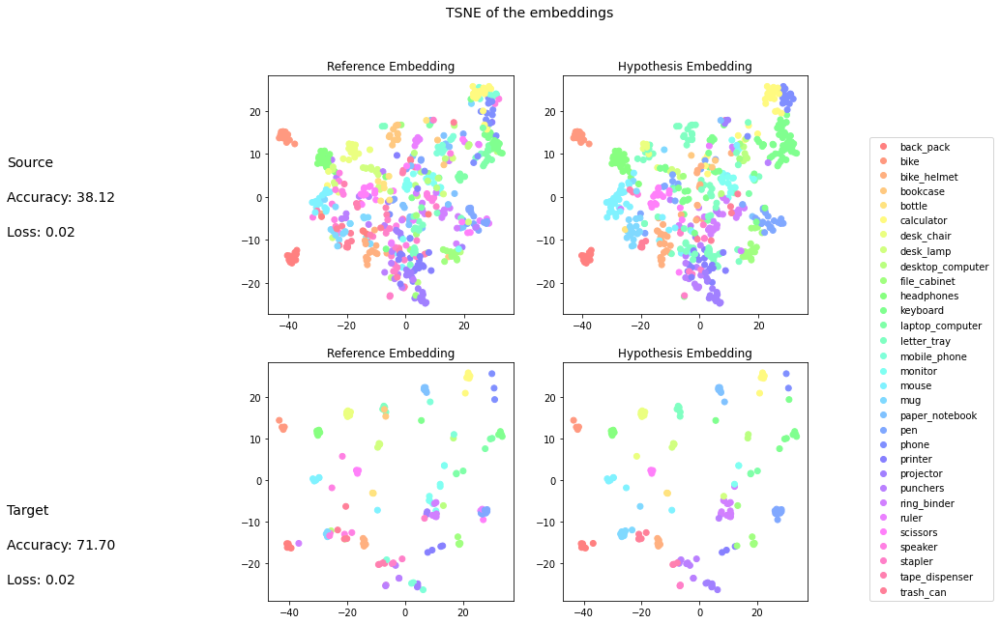

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,0.72,0.84,18.00
bike,1.00,1.00,1.00,16.00
bike_helmet,0.30,0.64,0.41,14.00
bookcase,0.00,0.00,0.00,16.00
bottle,0.00,0.00,0.00,7.00
calculator,0.46,0.68,0.55,19.00
desk_chair,0.86,0.33,0.48,18.00
desk_lamp,0.50,0.10,0.17,20.00
desktop_computer,0.12,0.05,0.07,19.00
file_cabinet,0.33,0.44,0.38,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

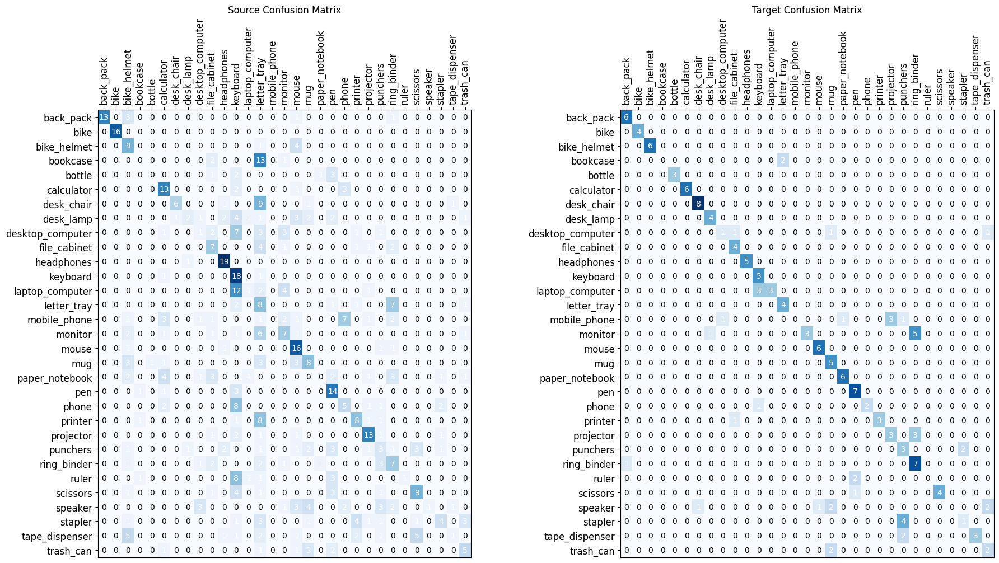

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

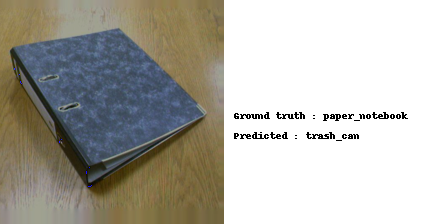

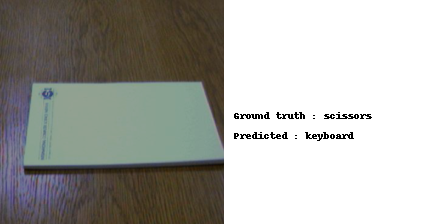

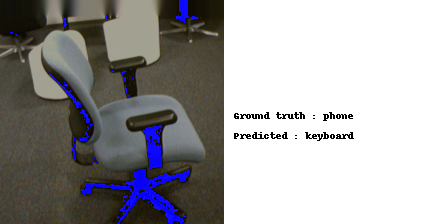

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

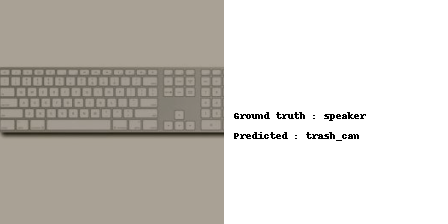

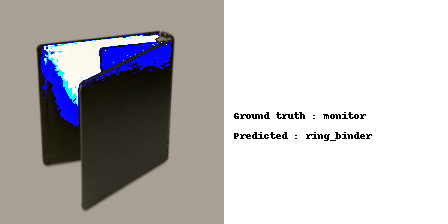

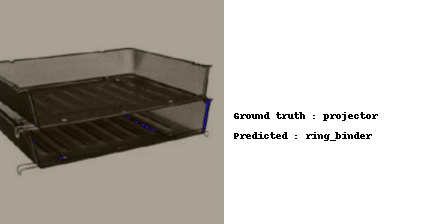

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

### Incremental DANN + JREG W $\rightarrow$ A

In [ ]:
root = f"{unzipped_dataset}/amazon/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)
lrd = 0.0002
fe, fc = train_incremental_dann_jreg(extractor, classifier, discriminator, BATCH_SIZE, root, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_jreg_extractor_w_a_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_jreg_classifier_w_a_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_jreg_extractor_w_a_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_jreg_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_jreg_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_jreg_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


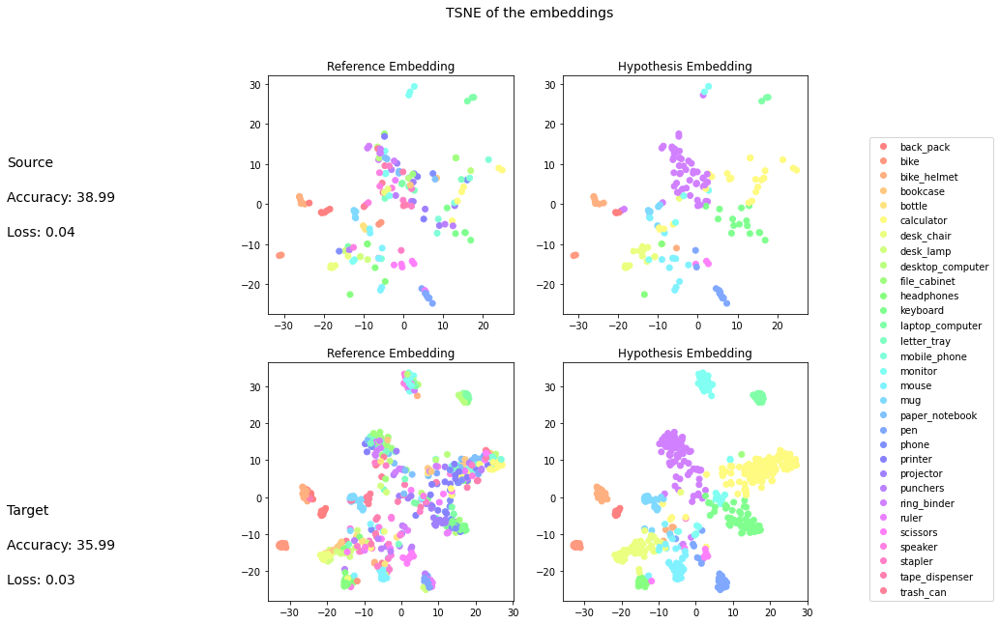

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,0.50,0.67,6.00
bike,1.00,0.50,0.67,4.00
bike_helmet,0.75,1.00,0.86,6.00
bookcase,0.00,0.00,0.00,2.00
bottle,0.00,0.00,0.00,3.00
calculator,0.22,0.83,0.34,6.00
desk_chair,0.38,0.75,0.50,8.00
desk_lamp,0.00,0.00,0.00,4.00
desktop_computer,0.00,0.00,0.00,4.00
file_cabinet,0.00,0.00,0.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

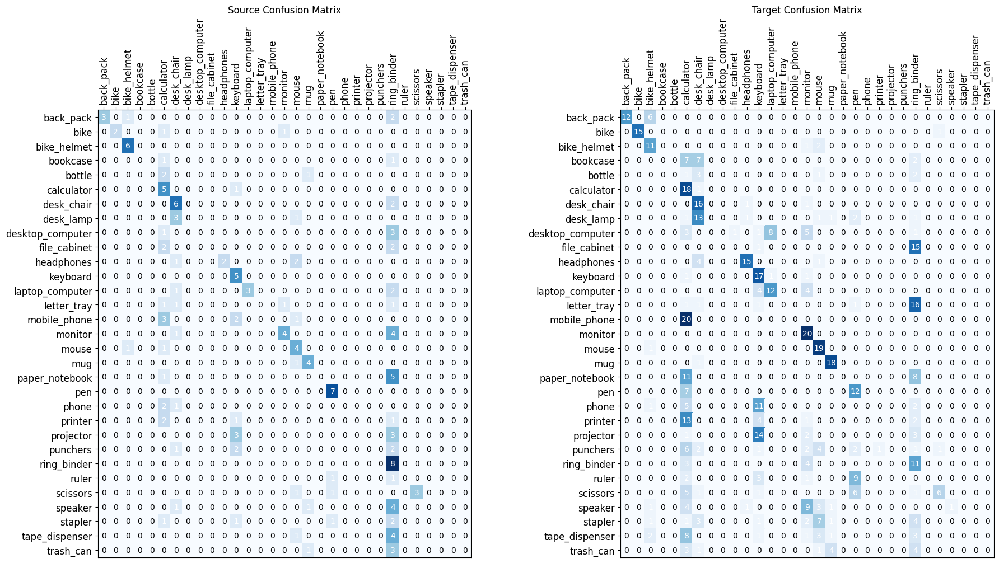

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

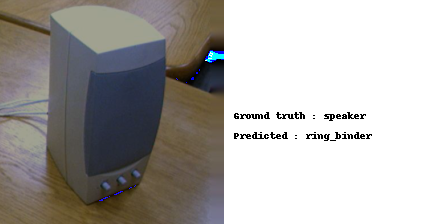

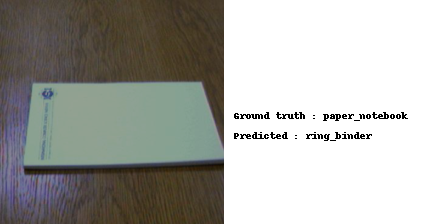

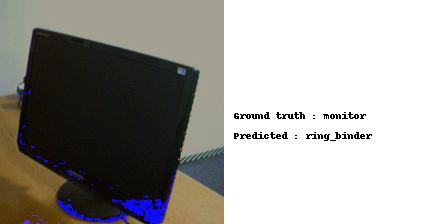

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

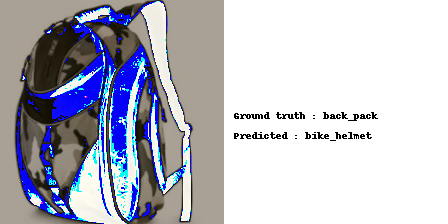

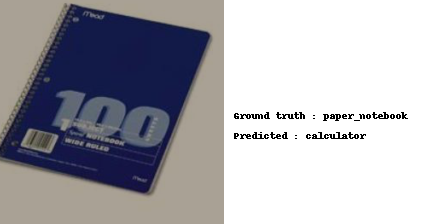

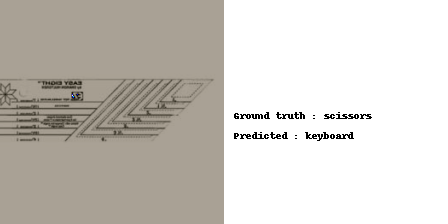

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## Incremental DANN + RADA

### Train Step

In [ ]:
def train_self_label_incremental_dann_rada(extractor: nn.Module,
                                      classifier: nn.Module,
                                      discriminator: nn.Module,
                                      source_train_loader: Iterable,
                                      source_test_loader: Iterable,
                                      pseudo_train_loader: Iterable,
                                      test_loader: Iterable,
                                      optim: Any,
                                      epochs: int,
                                      lr: float,
                                      lrd: float):
  
  extractor = extractor.to(device)
  classifier = classifier.to(device)
  discriminator = discriminator.to(device)

  ce_loss = get_ce_loss()

  extractor, classifier, discriminator = train_dann_rada(extractor, classifier, discriminator, optim, source_train_loader, source_test_loader, pseudo_train_loader, test_loader, lr, lrd, epochs=2)

  pbar = tqdm(range(epochs),position=0, leave=True)
  for p, epoch in zip(pbar,range(epochs)): 
    train_loss, train_accuracy = training_step_self_label(extractor, classifier, pseudo_train_loader, optim) 
    
    test_loss, test_accuracy = test_step(extractor, classifier, test_loader, cost_function=ce_loss)

    pbar.set_description(str({
    'Training loss': f'{train_loss:.5f}',
    'Training accuracy': f'{train_accuracy:.5f}',
    'Test loss': f'{test_loss:.5f}',
    'Test accuracy': f'{test_accuracy:.5f}',
    }))

  return extractor, classifier

In [ ]:
def train_incremental_dann_rada(extractor: nn.Module,
                classifier: nn.Module,
                discriminator: nn.Module,
                batch_size: int,
                root: str,
                optimizer: Any,
                source_train_loader:Iterable,
                source_test_loader:Iterable,
                target_train_loader:Iterable,
                target_test_loader:Iterable,
                lr: float,
                lrd: float):

  pseudo_target_train_loader = get_data_pseudo_label(batch_size, root)
  target_train_loader = remove_label_from_dataloader(target_train_loader)

  test_loss, test_accuracy= test_step(extractor, classifier, target_test_loader, cost_function=get_ce_loss())
  print("Test accuracy: ", test_accuracy)

  print("Initial number of samples to label:", len(pseudo_target_train_loader.dataset))
  while(len(pseudo_target_train_loader.dataset) > 0):

    #Compute pseudo-labels
    idxs, labels, n_epochs_pseudo_labels = pseudo_labeling_policy(extractor, classifier, pseudo_target_train_loader, k=10, min_accuracy=0.80)

    target_train_loader, pseudo_target_train_loader = assign_and_remove_pseudo_labels(target_train_loader, pseudo_target_train_loader, idxs, labels)

    print("Remaining samples to label:", len(pseudo_target_train_loader.dataset))
    print("Samples with pseudo-label:", len(target_train_loader.dataset) - len(pseudo_target_train_loader.dataset))

    extractor, classifier = train_self_label_incremental_dann_rada(extractor, classifier, discriminator, source_train_loader, source_test_loader, target_train_loader, target_test_loader, optimizer, n_epochs_pseudo_labels, lr, lrd)
    
  final_lr = 0.0005
  final_lrd = 0.00002
  
  final_extractor = Extractor(models.resnet18(weights=True)).to(device)
  final_classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
  optimizer_ex = get_optimizer(final_extractor,lr=final_lr, wd=0.000001)
  optimizer_cl = get_optimizer(final_classifier,lr=final_lr, wd=0.000001)
  ce_cost_function = get_ce_loss()
  ex = train_source_only(final_extractor,
           final_classifier,
           target_train_loader,
           target_test_loader, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           lr = final_lr, 
           lrd = final_lrd,
           epochs=75, 
           device=device)
  
  return final_extractor, final_classifier
  

### Incremental DANN + RADA A $\rightarrow$ W

In [ ]:
root = f"{unzipped_dataset}/webcam/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002
fe, fc = train_incremental_dann_rada(extractor, classifier, discriminator, BATCH_SIZE, root, optim, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_rada_extractor_a_w_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_rada_classifier_a_w_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_rada_extractor_a_w_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_rada_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_rada_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_rada_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


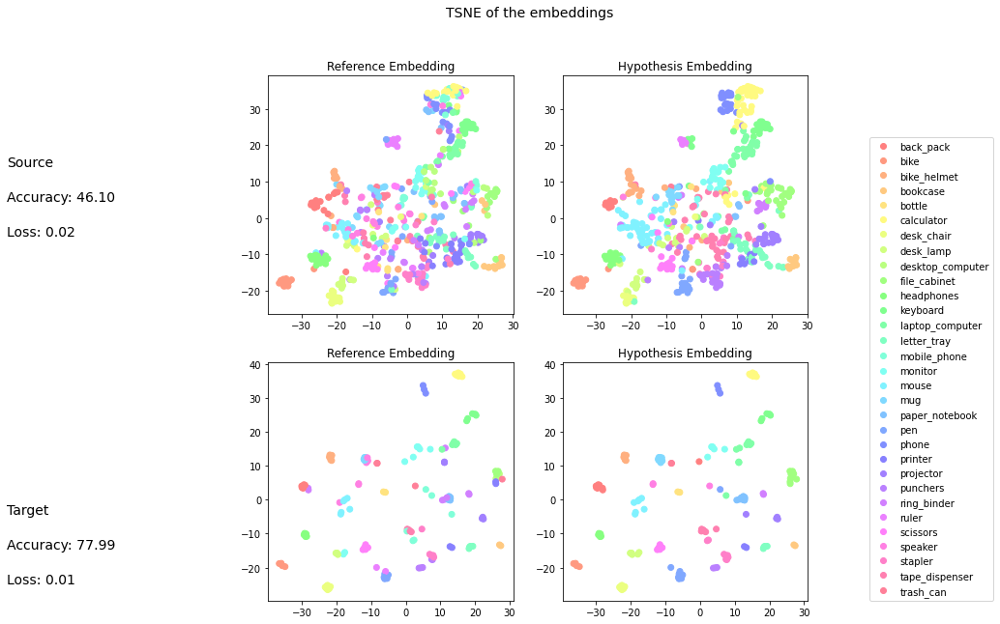

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,0.56,0.71,18.00
bike,0.84,1.00,0.91,16.00
bike_helmet,0.50,0.64,0.56,14.00
bookcase,0.69,0.56,0.62,16.00
bottle,0.33,0.14,0.20,7.00
calculator,0.33,0.74,0.45,19.00
desk_chair,1.00,0.78,0.88,18.00
desk_lamp,0.37,0.50,0.43,20.00
desktop_computer,0.00,0.00,0.00,19.00
file_cabinet,0.35,0.69,0.47,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

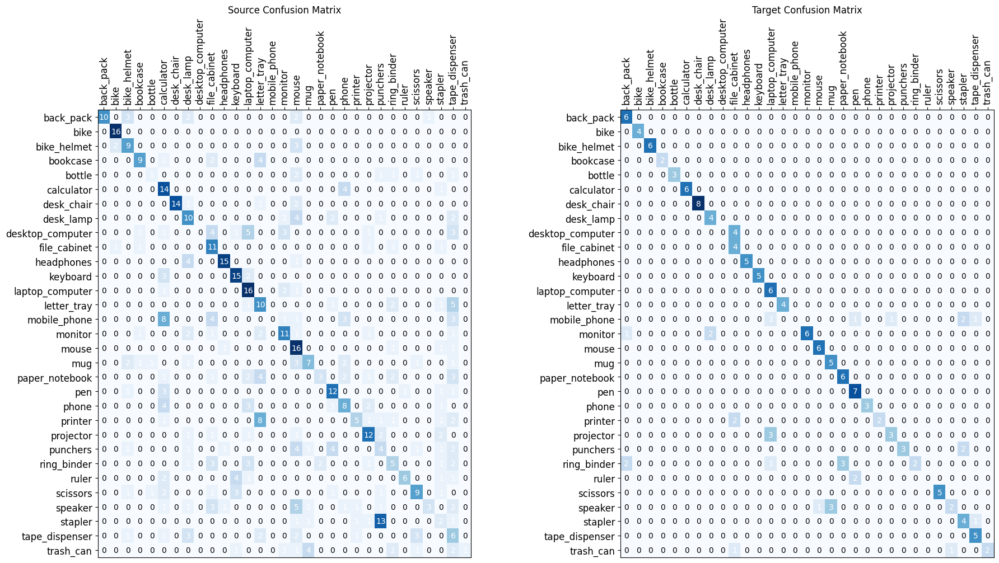

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

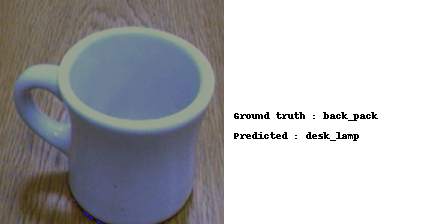

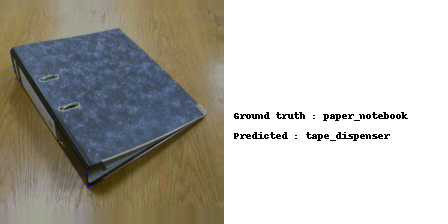

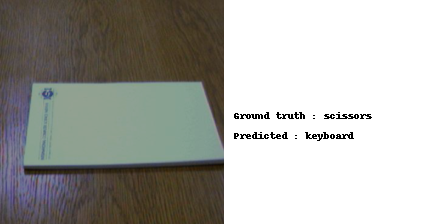

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

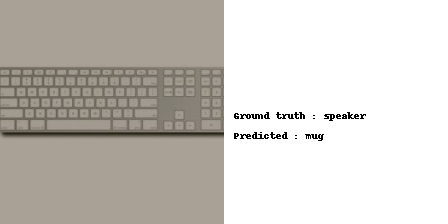

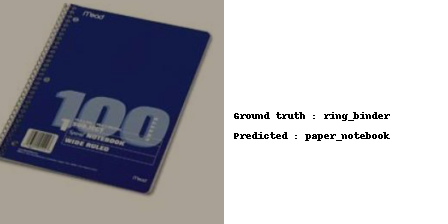

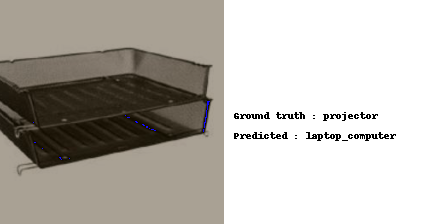

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

### Incremental DANN + RADA W $\rightarrow$ A

In [ ]:
root = f"{unzipped_dataset}/amazon/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)

lrd = 0.0002
fe, fc = train_incremental_dann_rada(extractor, classifier, discriminator, BATCH_SIZE, root, optim, train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_rada_extractor_w_a_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_rada_classifier_w_a_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_rada_extractor_w_a_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_rada_classifier_w_a_path)

In [ ]:
!cp resnet18_incremental_dann_rada_extractor_w_a_path "gdrive/MyDrive/TACV_Project/trained_models/"
!cp resnet18_incremental_dann_rada_classifier_w_a_path "gdrive/MyDrive/TACV_Project/trained_models/"

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_rada_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_rada_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


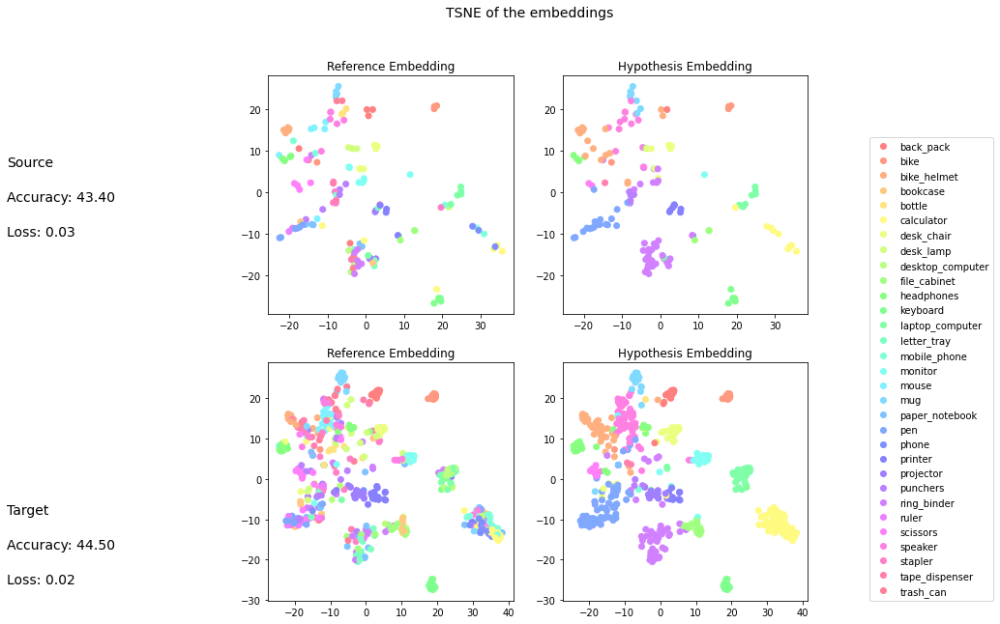

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,0.17,0.29,6.00
bike,1.00,1.00,1.00,4.00
bike_helmet,0.35,1.00,0.52,6.00
bookcase,0.00,0.00,0.00,2.00
bottle,0.00,0.00,0.00,3.00
calculator,0.33,0.50,0.40,6.00
desk_chair,0.67,0.75,0.71,8.00
desk_lamp,0.00,0.00,0.00,4.00
desktop_computer,0.00,0.00,0.00,4.00
file_cabinet,1.00,0.75,0.86,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

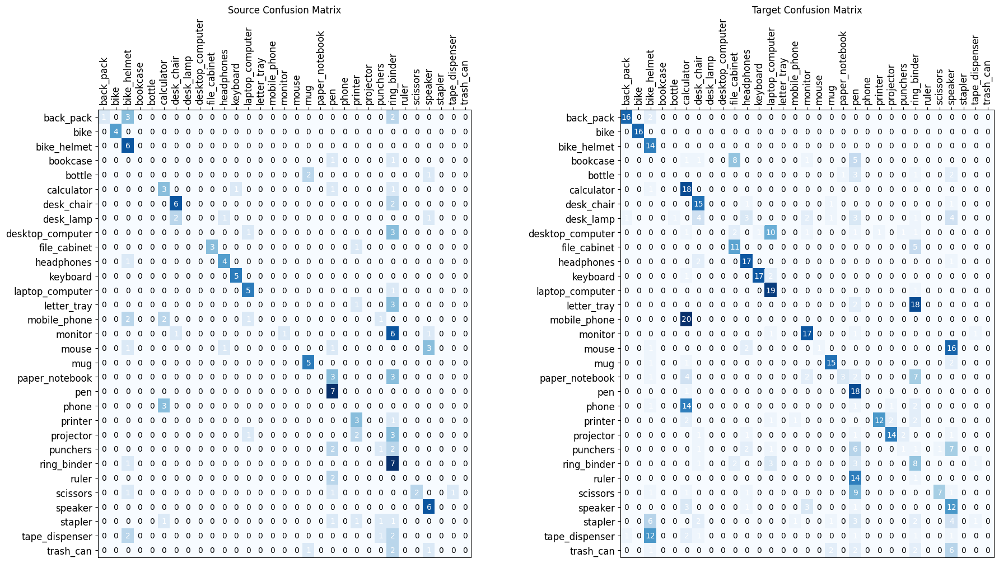

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

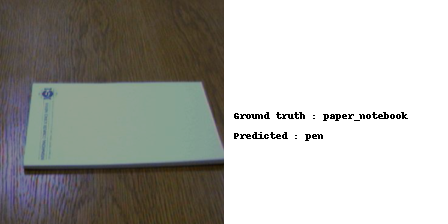

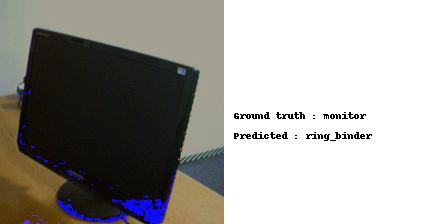

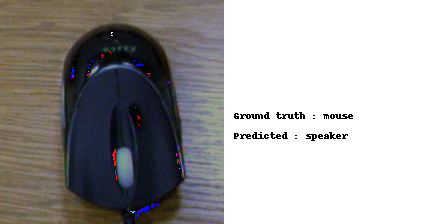

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

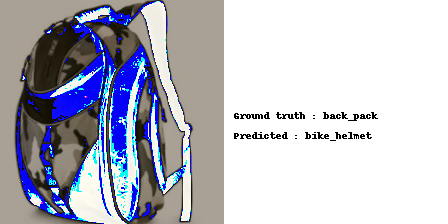

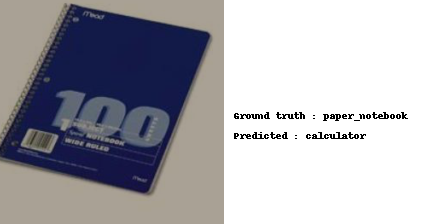

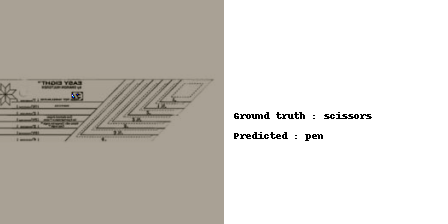

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## Incremental DANN + FGDA + DALN

### Train Step

In [ ]:
def train_self_label_incremental_dann_fgda_daln(extractor: nn.Module,
                                      classifier: nn.Module,
                                      grad_discriminator: nn.Module,
                                      source_train_loader: Iterable,
                                      source_test_loader: Iterable,
                                      pseudo_train_loader: Iterable,
                                      test_loader: Iterable,
                                      optim: Any,
                                      optimizer_d_grad: Any,
                                      epochs: int,
                                      lambda_jr,
                                      n,
                                      lr: float,
                                      lrd: float):
  
  extractor = extractor.to(device)
  classifier = classifier.to(device)
  grad_discriminator = grad_discriminator.to(device)

  ce_loss = get_ce_loss()

  extractor, classifier, grad_discriminator = train_dann_fgda_daln(extractor, classifier, grad_discriminator, optim, optimizer_d_grad, 
                                                                           source_train_loader, source_test_loader, pseudo_train_loader, test_loader, lr, lrd, 0.8, lambda_jr, n, epochs=2)

  pbar = tqdm(range(epochs),position=0, leave=True)
  for p, epoch in zip(pbar,range(epochs)): 
    train_loss, train_accuracy = training_step_self_label(extractor, classifier, pseudo_train_loader, optim) 
    
    test_loss, test_accuracy = test_step(extractor, classifier, test_loader, cost_function=ce_loss)

    pbar.set_description(str({
    'Training loss': f'{train_loss:.5f}',
    'Training accuracy': f'{train_accuracy:.5f}',
    'Test loss': f'{test_loss:.5f}',
    'Test accuracy': f'{test_accuracy:.5f}',
    }))

  return extractor, classifier, grad_discriminator

In [ ]:
def train_incremental_dann_fgda_daln(extractor: nn.Module,
                classifier: nn.Module,
                grad_discriminator: nn.Module,
                batch_size: int,
                root: str,
                optimizer: Any,
                optimizer_d_grad: Any,
                source_train_loader:Iterable,
                source_test_loader:Iterable,
                target_train_loader:Iterable,
                target_test_loader:Iterable,
                lambda_jr: float,
                n,
                lr: float,
                lrd: float):

  pseudo_target_train_loader = get_data_pseudo_label(batch_size, root)
  target_train_loader = remove_label_from_dataloader(target_train_loader)

  test_loss, test_accuracy= test_step(extractor, classifier, target_test_loader, cost_function=get_ce_loss())
  print("Test accuracy: ", test_accuracy)

  print("Initial number of samples to label:", len(pseudo_target_train_loader.dataset))
  while(len(pseudo_target_train_loader.dataset) > 0):

    #Compute pseudo-labels
    idxs, labels, n_epochs_pseudo_labels = pseudo_labeling_policy(extractor, classifier, pseudo_target_train_loader, k=10, min_accuracy=0.80)

    target_train_loader, pseudo_target_train_loader = assign_and_remove_pseudo_labels(target_train_loader, pseudo_target_train_loader, idxs, labels)

    print("Remaining samples to label:", len(pseudo_target_train_loader.dataset))
    print("Samples with pseudo-label:", len(target_train_loader.dataset) - len(pseudo_target_train_loader.dataset))

    extractor, classifier, grad_discriminator = train_self_label_incremental_dann_fgda_daln(extractor, classifier, grad_discriminator, source_train_loader, source_test_loader, target_train_loader, target_test_loader, optimizer, optimizer_d_grad, n_epochs_pseudo_labels, lambda_jr, n, lr, lrd)
    
  final_lr = 0.0005
  final_lrd = 0.00002
  
  final_extractor = Extractor(models.resnet18(weights=True)).to(device)
  final_classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
  optimizer_ex = get_optimizer(final_extractor,lr=final_lr, wd=0.000001)
  optimizer_cl = get_optimizer(final_classifier,lr=final_lr, wd=0.000001)
  ce_cost_function = get_ce_loss()
  ex = train_source_only(final_extractor,
           final_classifier,
           target_train_loader,
           target_test_loader, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           lr = final_lr, 
           lrd = final_lrd,
           epochs=75, 
           device=device)
  
  return final_extractor, final_classifier
  

### Incremental DANN + FGDA + DALN A $\rightarrow$ W

In [ ]:
root = f"{unzipped_dataset}/webcam/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()), lr=lr, wd=wd, momentum=0.9)

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=3e-3, wd=5e-4, momentum=0.9)

lrd = 0.0002

trade_off_lambda = 0.8
lambda_jr=0.01
n=1

fe, fc = train_incremental_dann_fgda_daln(extractor, classifier, grad_discriminator, BATCH_SIZE, root, optim, optimizer_d_grad, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lambda_jr, n, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_fgda_daln_extractor_a_w_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_fgda_daln_classifier_a_w_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_fgda_daln_extractor_a_w_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_fgda_daln_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_fgda_daln_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_fgda_daln_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


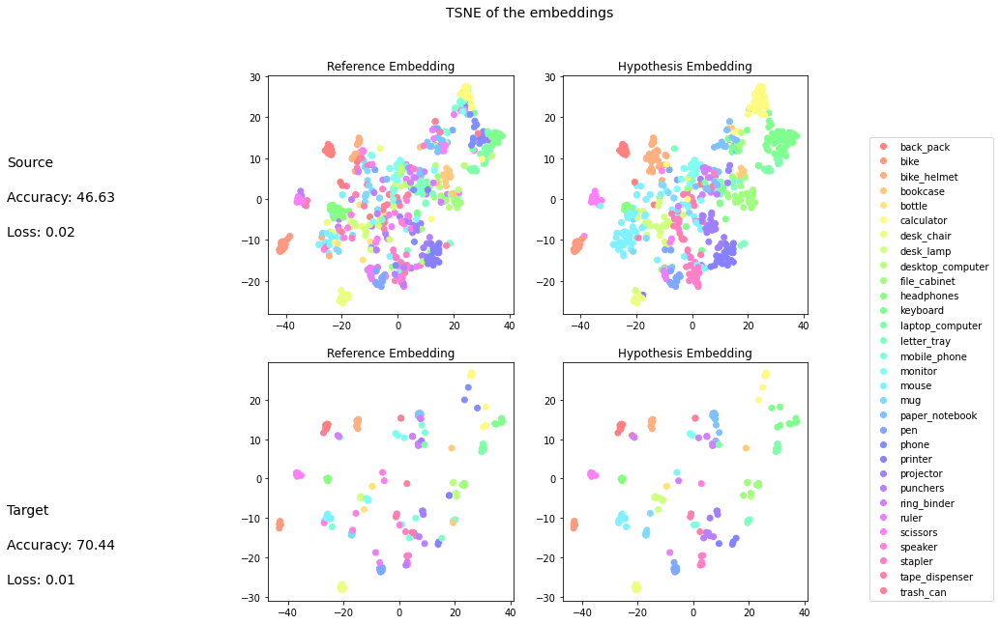

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,0.87,0.72,0.79,18.00
bike,1.00,0.94,0.97,16.00
bike_helmet,0.38,0.79,0.51,14.00
bookcase,0.64,0.44,0.52,16.00
bottle,0.00,0.00,0.00,7.00
calculator,0.42,0.84,0.56,19.00
desk_chair,0.92,0.67,0.77,18.00
desk_lamp,0.36,0.50,0.42,20.00
desktop_computer,0.00,0.00,0.00,19.00
file_cabinet,0.40,0.88,0.55,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

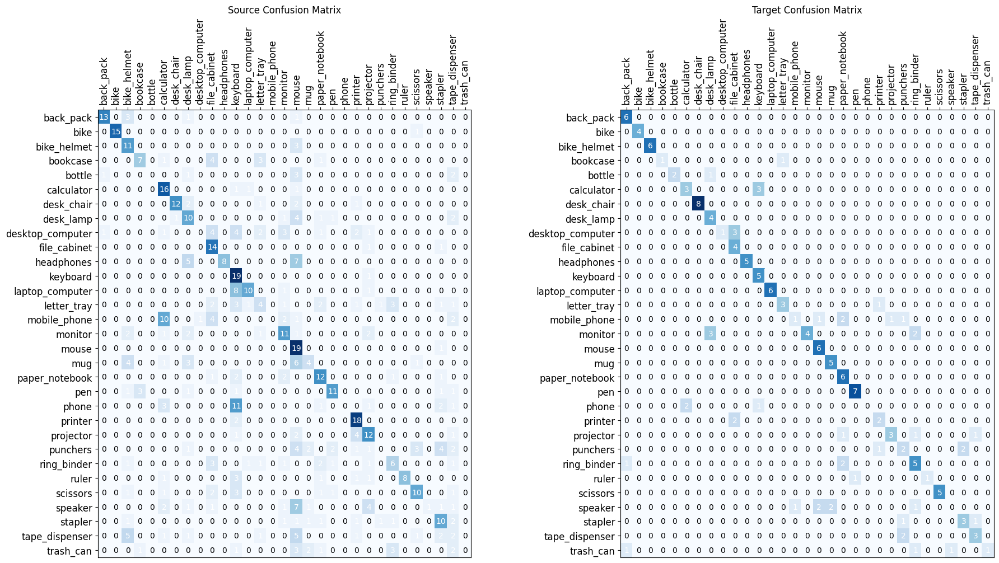

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

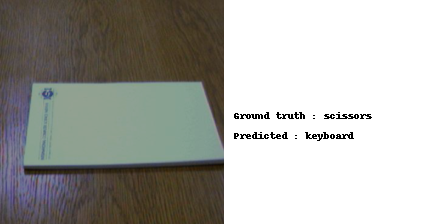

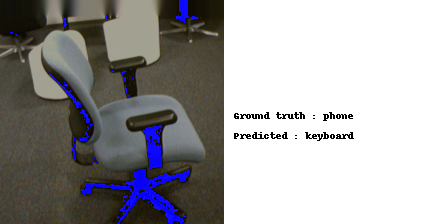

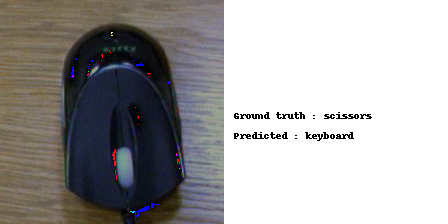

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

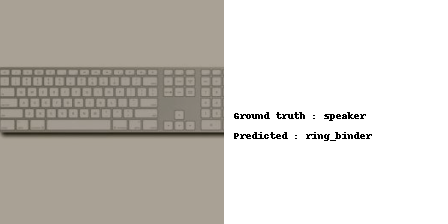

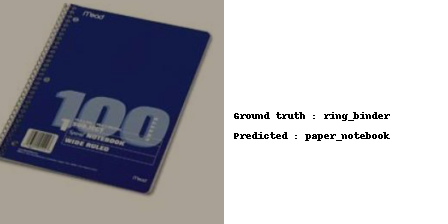

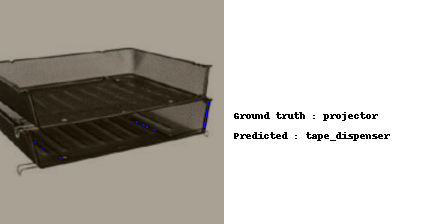

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

### Incremental DANN + FGDA + DALN W $\rightarrow$ A

In [ ]:
root = f"{unzipped_dataset}/amazon/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)
lr = 1e-3
wd = 1e-4

optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()), lr=lr, wd=wd, momentum=0.9)

optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=3e-3, wd=5e-4, momentum=0.9)

lrd = 0.0002

trade_off_lambda = 0.8
lambda_jr=0.01
n=1

fe, fc = train_incremental_dann_fgda_daln(extractor, classifier, grad_discriminator, BATCH_SIZE, root, optim, optimizer_d_grad, train_loader_w, test_loader_w, train_loader_a, test_loader_a, lambda_jr, n, lr, lrd)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_fgda_daln_extractor_w_a_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_fgda_daln_classifier_w_a_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_fgda_daln_extractor_w_a_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_fgda_daln_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_fgda_daln_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_fgda_daln_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


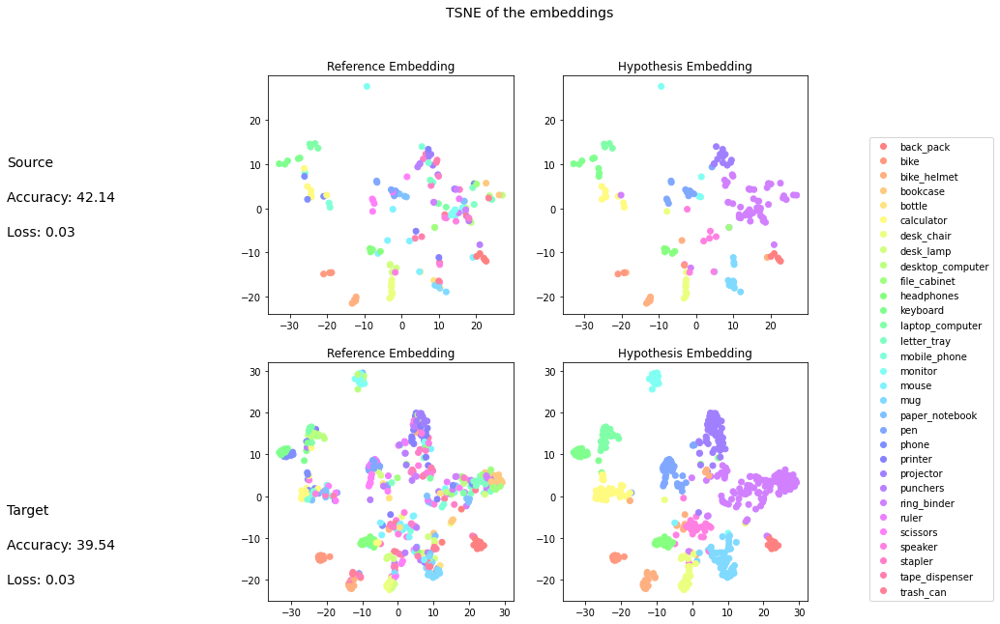

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,0.83,0.91,6.00
bike,0.75,0.75,0.75,4.00
bike_helmet,0.67,1.00,0.80,6.00
bookcase,0.00,0.00,0.00,2.00
bottle,0.00,0.00,0.00,3.00
calculator,0.50,0.67,0.57,6.00
desk_chair,0.80,1.00,0.89,8.00
desk_lamp,0.00,0.00,0.00,4.00
desktop_computer,0.00,0.00,0.00,4.00
file_cabinet,1.00,0.25,0.40,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

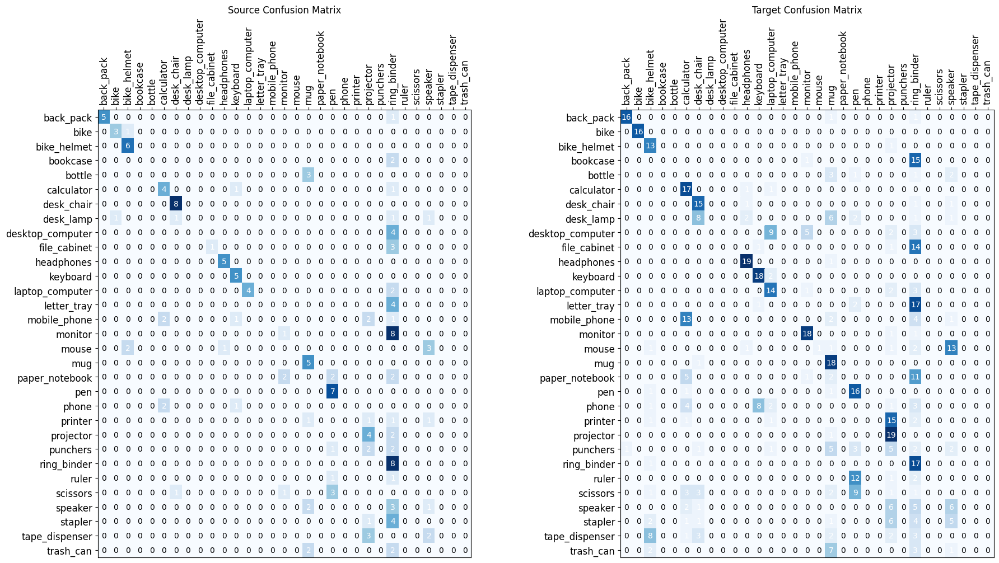

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

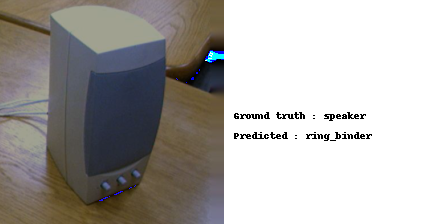

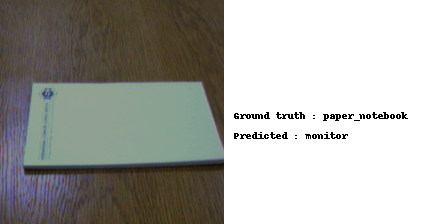

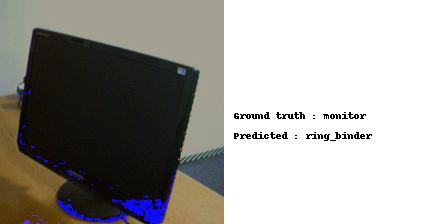

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

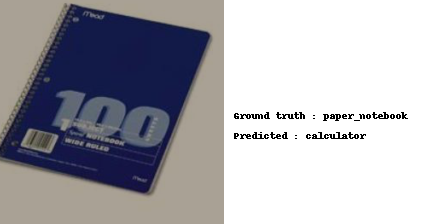

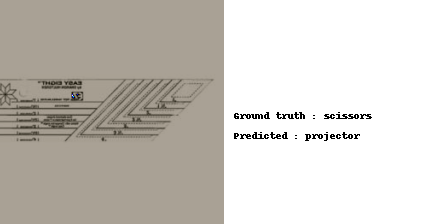

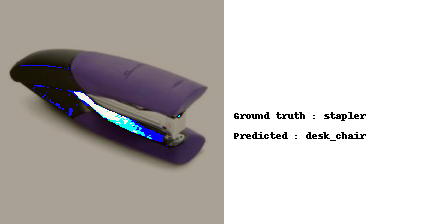

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## Incremental DANN + RADA + FGDA

### Train Step

In [ ]:
def train_self_label_incremental_dann_rada_fgda(extractor: nn.Module,
                                      classifier: nn.Module,
                                      discriminator: nn.Module,
                                      grad_discriminator: nn.Module,
                                      source_train_loader: Iterable,
                                      source_test_loader: Iterable,
                                      pseudo_train_loader: Iterable,
                                      test_loader: Iterable,
                                      optim: Any,
                                      optimizer_d_grad: Any,
                                      epochs: int,
                                      lr: float,
                                      lr_grad: float,
                                      lrd: float,
                                      K,
                                      ent_th,
                                      lambda_jr):
  
  extractor = extractor.to(device)
  classifier = classifier.to(device)
  discriminator = discriminator.to(device)
  grad_discriminator = grad_discriminator.to(device)

  ce_loss = get_ce_loss()

  extractor, classifier, discriminator, grad_discriminator = train_dann_rada_fgda(extractor, classifier, discriminator, grad_discriminator, optim, optimizer_d_grad, source_train_loader, source_test_loader,
                                                                                  pseudo_train_loader, test_loader, lr, lr_grad, lrd, K, ent_th, lambda_jr, n, epochs=2)

  pbar = tqdm(range(epochs),position=0, leave=True)
  for p, epoch in zip(pbar,range(epochs)): 
    train_loss, train_accuracy = training_step_self_label(extractor, classifier, pseudo_train_loader, optim) 
    
    test_loss, test_accuracy = test_step(extractor, classifier, test_loader, cost_function=ce_loss)

    pbar.set_description(str({
    'Training loss': f'{train_loss:.5f}',
    'Training accuracy': f'{train_accuracy:.5f}',
    'Test loss': f'{test_loss:.5f}',
    'Test accuracy': f'{test_accuracy:.5f}',
    }))

  return extractor, classifier

In [ ]:
def train_incremental_dann_rada_fgda(extractor: nn.Module,
                classifier: nn.Module,
                discriminator: nn.Module,
                grad_discriminator: nn.Module,
                batch_size: int,
                root: str,
                optimizer: Any,
                optimizer_d_grad: Any,
                source_train_loader:Iterable,
                source_test_loader:Iterable,
                target_train_loader:Iterable,
                target_test_loader:Iterable,
                lr: float,
                lr_grad: float,
                lrd: float,
                K,
                ent_th,
                lambda_jr):

  pseudo_target_train_loader = get_data_pseudo_label(batch_size, root)
  target_train_loader = remove_label_from_dataloader(target_train_loader)

  test_loss, test_accuracy= test_step(extractor, classifier, target_test_loader, cost_function=get_ce_loss())
  print("Test accuracy: ", test_accuracy)

  print("Initial number of samples to label:", len(pseudo_target_train_loader.dataset))
  while(len(pseudo_target_train_loader.dataset) > 0):

    #Compute pseudo-labels
    idxs, labels, n_epochs_pseudo_labels = pseudo_labeling_policy(extractor, classifier, pseudo_target_train_loader, k=10, min_accuracy=0.80)

    target_train_loader, pseudo_target_train_loader = assign_and_remove_pseudo_labels(target_train_loader, pseudo_target_train_loader, idxs, labels)

    print("Remaining samples to label:", len(pseudo_target_train_loader.dataset))
    print("Samples with pseudo-label:", len(target_train_loader.dataset) - len(pseudo_target_train_loader.dataset))

    extractor, classifier = train_self_label_incremental_dann_rada_fgda(extractor, classifier, discriminator, grad_discriminator, source_train_loader, source_test_loader, target_train_loader, target_test_loader, optimizer, optimizer_d_grad, n_epochs_pseudo_labels, lr, lr_grad,lrd, K, ent_th, lambda_jr)
    
  final_lr = 0.0005
  final_lrd = 0.00002
  
  final_extractor = Extractor(models.resnet18(weights=True)).to(device)
  final_classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
  optimizer_ex = get_optimizer(final_extractor,lr=final_lr, wd=0.000001)
  optimizer_cl = get_optimizer(final_classifier,lr=final_lr, wd=0.000001)
  ce_cost_function = get_ce_loss()
  ex = train_source_only(final_extractor,
           final_classifier,
           target_train_loader,
           target_test_loader, 
           ce_cost_function,
           optimizer_extractor = optimizer_ex,
           optimizer_classifier = optimizer_cl,
           lr = final_lr, 
           lrd = final_lrd,
           epochs=75, 
           device=device)
  
  return final_extractor, final_classifier
  

### Incremental DANN + RADA + FGDA A $\rightarrow$ W

In [ ]:
root = f"{unzipped_dataset}/webcam/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)
optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)
lrd = 0.0002
lambda_jr=0.01
n=1
K=5
ent_th = 0.35
fe, fc = train_incremental_dann_rada_fgda(extractor, classifier, discriminator, grad_discriminator, BATCH_SIZE, root, optim, optimizer_d_grad, train_loader_a, test_loader_a, train_loader_w, test_loader_w, lr, lr_grad, lrd, K, ent_th, lambda_jr)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_rada_fgda_extractor_a_w_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_rada_fgda_classifier_a_w_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_rada_fgda_extractor_a_w_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_rada_fgda_classifier_a_w_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_rada_fgda_extractor_a_w_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_rada_fgda_classifier_a_w_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


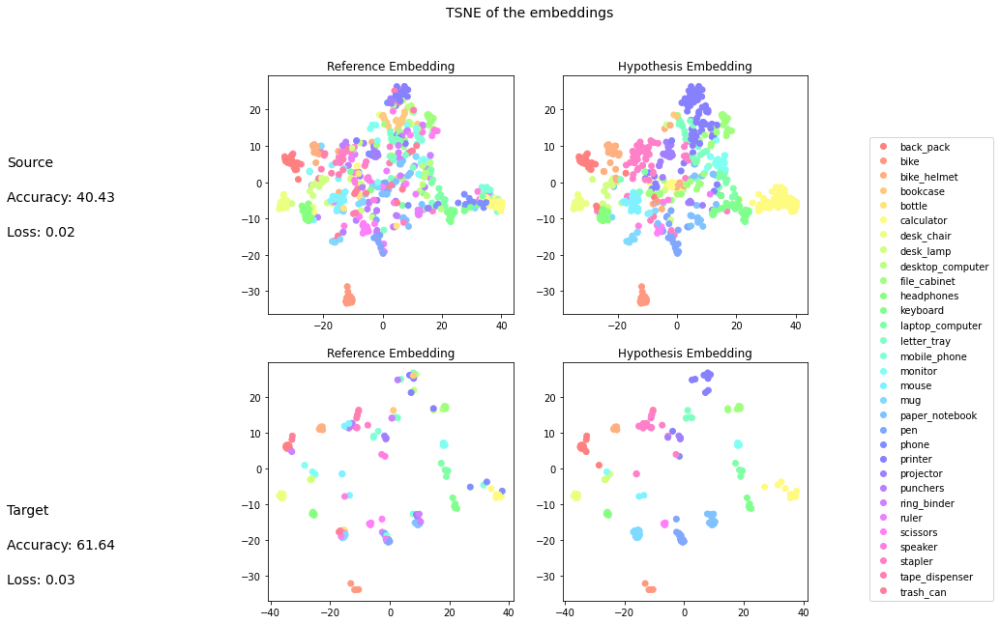

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,0.73,0.89,0.80,18.00
bike,0.89,1.00,0.94,16.00
bike_helmet,0.32,0.64,0.43,14.00
bookcase,0.50,0.06,0.11,16.00
bottle,0.00,0.00,0.00,7.00
calculator,0.28,0.95,0.43,19.00
desk_chair,0.88,0.83,0.86,18.00
desk_lamp,0.39,0.35,0.37,20.00
desktop_computer,0.00,0.00,0.00,19.00
file_cabinet,0.22,0.62,0.32,16.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_a,
                                                                                                                            test_loader_w,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

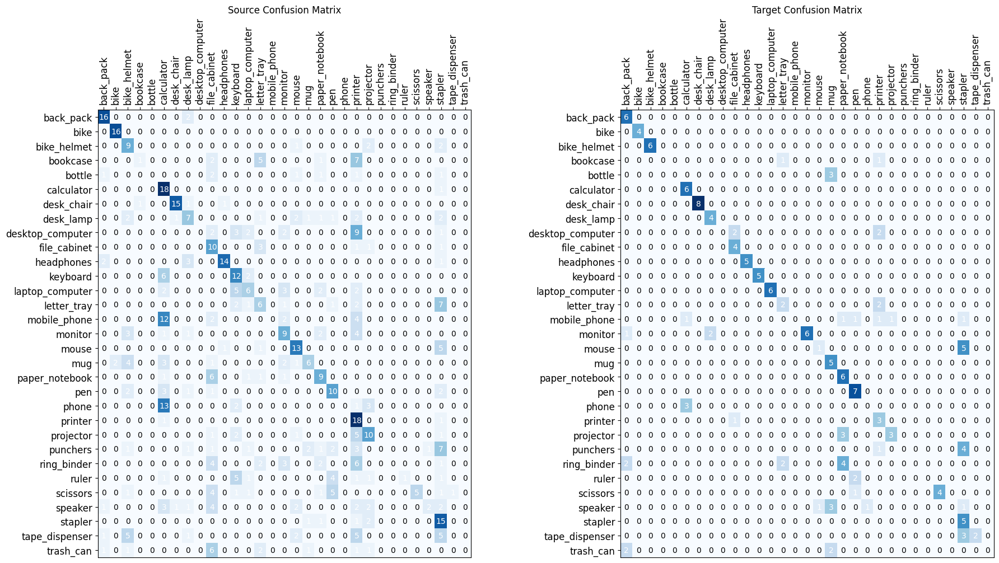

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

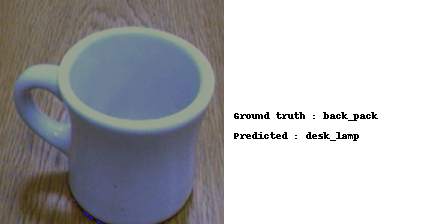

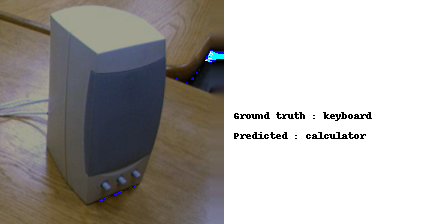

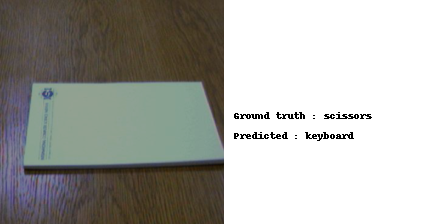

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

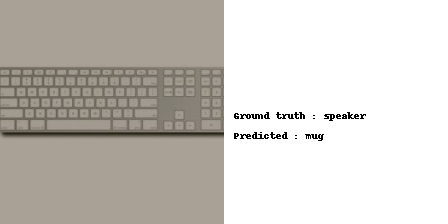

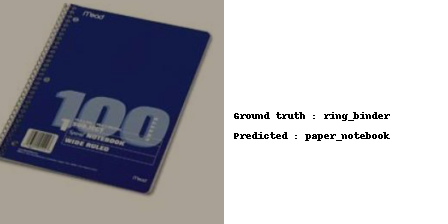

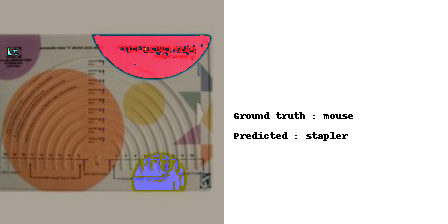

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

### Incremental DANN + RADA + FGDA W $\rightarrow$ A

In [ ]:
root = f"{unzipped_dataset}/amazon/"
extractor = Extractor(models.resnet18(weights=True)).to(device)
classifier = ClassPredictor(in_features=512, n_classes=N_CLASSES).to(device)
discriminator = DomainClassifier(in_features=512, n_classes=N_CLASSES).to(device)
grad_discriminator = GradientDiscriminator(in_feature=512, hidden_size=1024, num_class=N_CLASSES, r_lambda_1=0.5)
lr = 1e-3
wd = 1e-4
optim = get_SGD_optimizer_params_list(list(extractor.parameters()) + 
                                  list(classifier.parameters()) + 
                                  list(discriminator.parameters()), lr=lr, wd=wd, momentum=0.9)
optimizer_d_grad = get_SGD_optimizer_params_list(list(grad_discriminator.parameters()), lr=lr_grad, wd=5e-4, momentum=0.9)
lrd = 0.0002
lambda_jr=0.01
n=1
K=5
ent_th = 0.35
fe, fc = train_incremental_dann_rada_fgda(extractor, classifier, discriminator, grad_discriminator, BATCH_SIZE, root, optim, optmizer_d_grad, train_loader_w, test_loader_w, train_loader_a, test_loader_a, lr, lr_grad, lrd, K, ent_th, lambda_jr)

In [ ]:
#Save
torch.save(fe.state_dict(), resnet18_incremental_dann_rada_fgda_extractor_w_a_path)
torch.save(fc.state_dict(), resnet18_incremental_dann_rada_fgda_classifier_w_a_path)
torch.save(fe.state_dict(), models_basepath + resnet18_incremental_dann_rada_fgda_extractor_w_a_path)
torch.save(fc.state_dict(), models_basepath + resnet18_incremental_dann_rada_fgda_classifier_w_a_path)

#### Load

we load a pre computed model, useful to avoid retraining the model each time

In [ ]:
# load
%%capture
extractor = Extractor(models.resnet18(weights=True)).to(device)
extractor.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_rada_fgda_extractor_w_a_path))
extractor.to(device)
extractor.eval()
classifier = ClassPredictor(extractor.model[-2][1].bn2.num_features,
                        n_classes=N_CLASSES,
                        layers=['identity'],).to(device)
classifier.load_state_dict(torch.load(models_basepath + resnet18_incremental_dann_rada_fgda_classifier_w_a_path))
classifier.to(device)
classifier.eval()

####Test

Here we test the model and plot the TSNE embeddings of the features present in the last layer of the model (`avgpool`). We also plot the confusion matrixes and the images that the model classifies incorrectly.

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:982: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  warnings.warn(


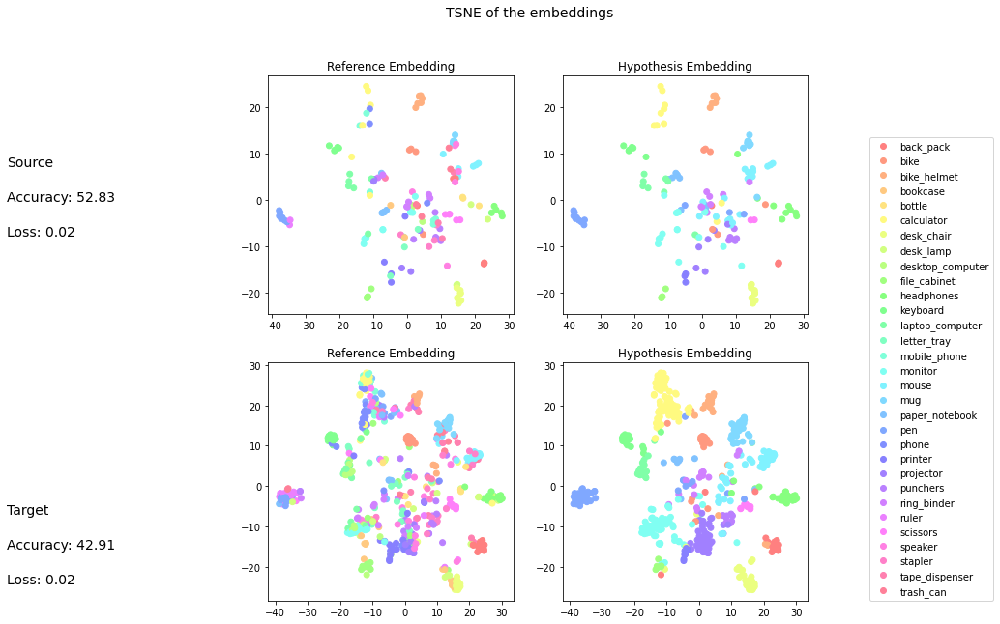

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

,precision,recall,f1-score,support
back_pack,1.00,0.67,0.80,6.00
bike,0.67,1.00,0.80,4.00
bike_helmet,1.00,1.00,1.00,6.00
bookcase,0.00,0.00,0.00,2.00
bottle,0.00,0.00,0.00,3.00
calculator,0.40,0.67,0.50,6.00
desk_chair,0.73,1.00,0.84,8.00
desk_lamp,0.00,0.00,0.00,4.00
desktop_computer,0.00,0.00,0.00,4.00
file_cabinet,1.00,1.00,1.00,4.00


In [ ]:
cost_function = get_ce_loss()
source_test_accuracy,target_test_accuracy,matrix_source,matrix_target,source_errors,target_errors = eval_plot_source_target(extractor,
                                                                                                                            classifier,
                                                                                                                            test_loader_w,
                                                                                                                            test_loader_a,
                                                                                                                            cost_function,
                                                                                                                            class_mapping,
                                                                                                                            layers=['identity'],
                                                                                                                            device='cuda:0')

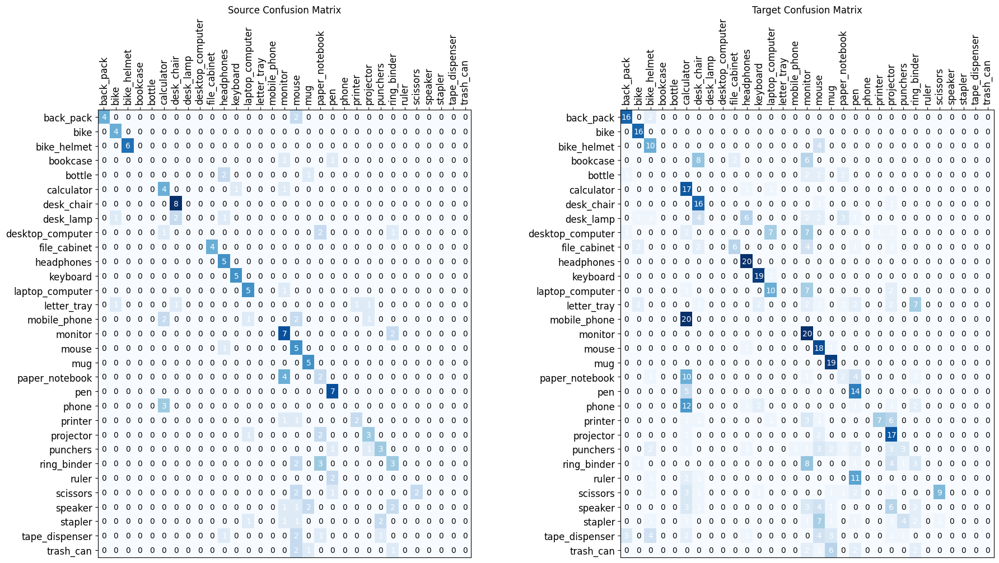

In [ ]:
confusion_matrix_plotter(matrix_source,matrix_target,class_mapping)

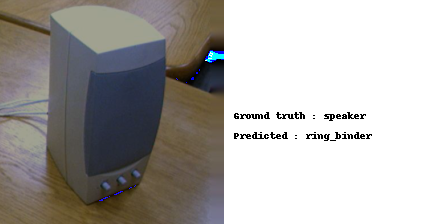

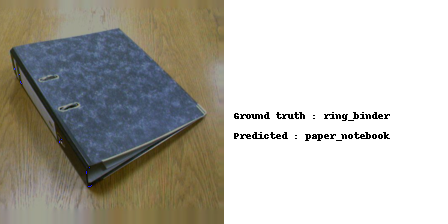

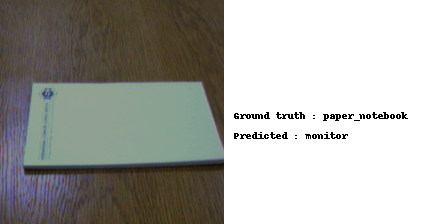

In [ ]:
show_error_images(test_loader_w,*source_errors,class_mapping,max_images=3)

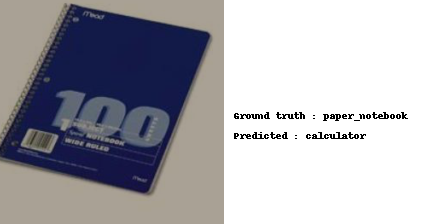

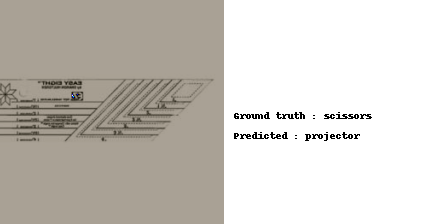

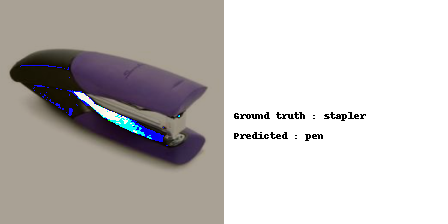

In [ ]:
show_error_images(test_loader_a,*target_errors,class_mapping,max_images=3)

## Results

The table below shows the result obtained applying the incremental method to the previous tested adversarial approaches. The gain in accuracy is significantly high for some methods. For example, if the starting model is DANN the gain in performance is +10.69, which is similar to the best result obtained in the standard adversarial approches showed before. As you can notice in the table, the approaches involving FGDA does not improve, this is due to the fact that FGDA already apply a self-labelling technique, and the combination of the two does not work well.
As final consideration, the models have been tested only on the scenario where amazon images are the source and the webcam images are the target. We did this, because the dataset office31 is highly unbalanced and in order to produce good results, this incremental method need a model that is confident, at least at the beginning, on a subset of the target data. So when we consider the webcam domain as source, the results provided by this incremental method are worst than the baseline

## Results table 

|Model                         |A $\rightarrow$ W| Gain | W $\rightarrow$ A| Gain |
|-----------------------       |-----------------| --------| --- | --- |
|Incremental DANN              |75.47| +10.69|23.40| -21.28 |
|Incremental DANN + DALN       |74.84| +2.51| 39.54| -0.18 |
|Incremental DANN + JREG       |71.70| -1.88| 35.99| -10.46 |
|Incremental DANN + RADA       |77.99| +13.21| 44.50| -1.24 |
|Incremental DANN + FGDA + DALN|70.44| -5.66| 39.54| -9.93 |
|Incremental DANN + RADA + SDAT|x| x| x| x |
|Incremental DANN + RADA + FGDA|61.64| -10.06| 42.91| -0.53 |